In [3]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['solar_activity'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-20 23:58:41,241] A new study created in memory with name: no-name-21fa0c99-a319-4ccd-ad00-40393e67b7d1
[I 2025-05-21 00:03:29,879] Trial 0 finished with value: 0.07387404590845108 and parameters: {'lr': 0.015524332975535508, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1616532554304882}. Best is trial 0 with value: 0.07387404590845108.


Cross Validation Accuracies:
[0.06769827753305435, 0.06608016788959503, 0.07001561671495438, 0.07967282086610794, 0.0859033465385437]
Mean Cross Validation Accuracy:
0.07387404590845108
Standard Deviation of Cross Validation Accuracy:
0.0076433237547454515


[I 2025-05-21 00:11:21,621] Trial 1 finished with value: 0.07908440828323364 and parameters: {'lr': 0.003325783779003345, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4538224002742036}. Best is trial 0 with value: 0.07387404590845108.


Cross Validation Accuracies:
[0.06521386653184891, 0.08703489601612091, 0.08700674027204514, 0.10403597354888916, 0.0521305650472641]
Mean Cross Validation Accuracy:
0.07908440828323364
Standard Deviation of Cross Validation Accuracy:
0.018261740345345685


[I 2025-05-21 00:16:12,034] Trial 2 finished with value: 0.5613399565219879 and parameters: {'lr': 0.0013126794553306273, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4517965034799992}. Best is trial 0 with value: 0.07387404590845108.


Cross Validation Accuracies:
[0.4873981773853302, 0.5718271732330322, 0.5493814945220947, 0.5852969884872437, 0.6127959489822388]
Mean Cross Validation Accuracy:
0.5613399565219879
Standard Deviation of Cross Validation Accuracy:
0.042289553722628104


[I 2025-05-21 00:20:25,352] Trial 3 finished with value: 0.053718775510787964 and parameters: {'lr': 0.029344103994693088, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.10596237524123678}. Best is trial 3 with value: 0.053718775510787964.


Cross Validation Accuracies:
[0.04536982625722885, 0.045690953731536865, 0.06268606334924698, 0.06392054259777069, 0.05092649161815643]
Mean Cross Validation Accuracy:
0.053718775510787964
Standard Deviation of Cross Validation Accuracy:
0.00808004985590797


[I 2025-05-21 00:25:00,923] Trial 4 finished with value: 0.05221516340970993 and parameters: {'lr': 0.6803308834070195, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.14175258524411977}. Best is trial 4 with value: 0.05221516340970993.


Cross Validation Accuracies:
[0.0446542389690876, 0.047669652849435806, 0.05587378889322281, 0.06205186992883682, 0.050826266407966614]
Mean Cross Validation Accuracy:
0.05221516340970993
Standard Deviation of Cross Validation Accuracy:
0.006162866461377507


[I 2025-05-21 00:33:05,187] Trial 5 finished with value: 0.05097220689058304 and parameters: {'lr': 0.010726536523698699, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19674752066258916}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.041854068636894226, 0.04566595330834389, 0.05632556974887848, 0.06266410648822784, 0.048351336270570755]
Mean Cross Validation Accuracy:
0.05097220689058304
Standard Deviation of Cross Validation Accuracy:
0.007530268855668256


[I 2025-05-21 00:38:58,112] Trial 6 finished with value: 0.05533843860030174 and parameters: {'lr': 0.4288648973580419, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.30745475641998055}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.05343715846538544, 0.04791872575879097, 0.05531175434589386, 0.06478908658027649, 0.05523546785116196]
Mean Cross Validation Accuracy:
0.05533843860030174
Standard Deviation of Cross Validation Accuracy:
0.005440460772175822


[I 2025-05-21 00:44:23,176] Trial 7 finished with value: 0.1665387272834778 and parameters: {'lr': 0.003806746084890382, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4820756013096701}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.18102459609508514, 0.17135611176490784, 0.14513100683689117, 0.18904009461402893, 0.14614182710647583]
Mean Cross Validation Accuracy:
0.1665387272834778
Standard Deviation of Cross Validation Accuracy:
0.01796487212180037


[I 2025-05-21 00:48:42,541] Trial 8 finished with value: 0.05360446348786354 and parameters: {'lr': 0.566274085312406, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.44983095173739496}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.044544391334056854, 0.05156449228525162, 0.0545550137758255, 0.06373224407434464, 0.053626175969839096]
Mean Cross Validation Accuracy:
0.05360446348786354
Standard Deviation of Cross Validation Accuracy:
0.006159908227066223


[I 2025-05-21 00:53:38,348] Trial 9 finished with value: 0.05203729271888733 and parameters: {'lr': 0.008862349098603494, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.32378264436947835}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.044947754591703415, 0.04638190567493439, 0.05644574016332626, 0.06382768601179123, 0.04858337715268135]
Mean Cross Validation Accuracy:
0.05203729271888733
Standard Deviation of Cross Validation Accuracy:
0.0071080555580822335


[I 2025-05-21 00:59:03,493] Trial 10 finished with value: 0.1865100681781769 and parameters: {'lr': 0.10742478359617455, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2193179670401441}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.20622287690639496, 0.16123712062835693, 0.19221912324428558, 0.18002577126026154, 0.1928454488515854]
Mean Cross Validation Accuracy:
0.1865100681781769
Standard Deviation of Cross Validation Accuracy:
0.015113524872482968


[I 2025-05-21 01:04:36,240] Trial 11 finished with value: 0.05107788145542145 and parameters: {'lr': 0.009809579758169413, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3138307382279395}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.043878473341464996, 0.04375145956873894, 0.05617889016866684, 0.06259516626596451, 0.04898541793227196]
Mean Cross Validation Accuracy:
0.05107788145542145
Standard Deviation of Cross Validation Accuracy:
0.007328771762695916


[I 2025-05-21 01:10:18,913] Trial 12 finished with value: 0.12709570527076722 and parameters: {'lr': 0.0776091947847699, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.24785008802921454}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.1449107974767685, 0.10324318706989288, 0.12303885817527771, 0.12626107037067413, 0.13802461326122284]
Mean Cross Validation Accuracy:
0.12709570527076722
Standard Deviation of Cross Validation Accuracy:
0.01430325689112692


[I 2025-05-21 01:13:47,510] Trial 13 finished with value: 0.05221505537629127 and parameters: {'lr': 0.007101902381075397, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3413669329079371}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.04403107985854149, 0.04332626238465309, 0.0558757521212101, 0.06323636323213577, 0.054605819284915924]
Mean Cross Validation Accuracy:
0.05221505537629127
Standard Deviation of Cross Validation Accuracy:
0.007570650905987741


[I 2025-05-21 01:17:40,305] Trial 14 finished with value: 0.07921741455793381 and parameters: {'lr': 0.04173608594218993, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.37913571686415665}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.06558915227651596, 0.06695466488599777, 0.1004486009478569, 0.07817734777927399, 0.08491730690002441]
Mean Cross Validation Accuracy:
0.07921741455793381
Standard Deviation of Cross Validation Accuracy:
0.012809670951799147


[I 2025-05-21 01:21:15,512] Trial 15 finished with value: 0.06271235495805741 and parameters: {'lr': 0.0013898927460065371, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.24225968039637602}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.04785239323973656, 0.06012542545795441, 0.058833979070186615, 0.09472832083702087, 0.052021656185388565]
Mean Cross Validation Accuracy:
0.06271235495805741
Standard Deviation of Cross Validation Accuracy:
0.016624473389836913


[I 2025-05-21 01:26:03,330] Trial 16 finished with value: 0.050674207508563995 and parameters: {'lr': 0.019888902295408864, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19824197325259713}. Best is trial 16 with value: 0.050674207508563995.


Cross Validation Accuracies:
[0.041707754135131836, 0.04333742707967758, 0.05747353658080101, 0.06355324387550354, 0.04729907587170601]
Mean Cross Validation Accuracy:
0.050674207508563995
Standard Deviation of Cross Validation Accuracy:
0.008458340266261013


[I 2025-05-21 01:32:38,117] Trial 17 finished with value: 0.10893734097480774 and parameters: {'lr': 0.023198789662977042, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19162922040371844}. Best is trial 16 with value: 0.050674207508563995.


Cross Validation Accuracies:
[0.10991870611906052, 0.12571465969085693, 0.08642857521772385, 0.10438673943281174, 0.11823802441358566]
Mean Cross Validation Accuracy:
0.10893734097480774
Standard Deviation of Cross Validation Accuracy:
0.013388776819231065


[I 2025-05-21 01:37:33,553] Trial 18 finished with value: 0.05255071073770523 and parameters: {'lr': 0.18577902978439112, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.26701619567690266}. Best is trial 16 with value: 0.050674207508563995.


Cross Validation Accuracies:
[0.043213456869125366, 0.04445834085345268, 0.05977211892604828, 0.06402755528688431, 0.05128208175301552]
Mean Cross Validation Accuracy:
0.05255071073770523
Standard Deviation of Cross Validation Accuracy:
0.0082237081256493


[I 2025-05-21 01:42:31,422] Trial 19 finished with value: 0.050671391934156415 and parameters: {'lr': 0.003786634333593054, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19620543896566228}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043001655489206314, 0.04448606073856354, 0.054981574416160583, 0.06251869350671768, 0.04836897552013397]
Mean Cross Validation Accuracy:
0.050671391934156415
Standard Deviation of Cross Validation Accuracy:
0.007229391787102405


[I 2025-05-21 01:48:10,484] Trial 20 finished with value: 0.05307486802339554 and parameters: {'lr': 0.0032310456277363175, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1231629610420311}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04586413875222206, 0.04785628616809845, 0.058151040226221085, 0.0637156143784523, 0.049787260591983795]
Mean Cross Validation Accuracy:
0.05307486802339554
Standard Deviation of Cross Validation Accuracy:
0.006768006841767526


[I 2025-05-21 01:52:00,716] Trial 21 finished with value: 0.05192755535244942 and parameters: {'lr': 0.005058627914826297, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.18501516959302794}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043922729790210724, 0.04604225978255272, 0.05628199875354767, 0.06454144418239594, 0.04884934425354004]
Mean Cross Validation Accuracy:
0.05192755535244942
Standard Deviation of Cross Validation Accuracy:
0.007566514237665614


[I 2025-05-21 01:56:06,390] Trial 22 finished with value: 0.10838790982961655 and parameters: {'lr': 0.017978863057151722, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.20197619769987543}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.06963451206684113, 0.1137394830584526, 0.10091357678174973, 0.142534077167511, 0.11511790007352829]
Mean Cross Validation Accuracy:
0.10838790982961655
Standard Deviation of Cross Validation Accuracy:
0.023654108908367492


[I 2025-05-21 02:00:26,190] Trial 23 finished with value: 0.29966929852962493 and parameters: {'lr': 0.049486224296511734, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.16522917153322395}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.3320649564266205, 0.2045888751745224, 0.353663831949234, 0.30979931354522705, 0.29822951555252075]
Mean Cross Validation Accuracy:
0.29966929852962493
Standard Deviation of Cross Validation Accuracy:
0.05120520554475582


[I 2025-05-21 02:05:31,509] Trial 24 finished with value: 0.05129842609167099 and parameters: {'lr': 0.0022650470510449765, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.27630102388783306}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04447760805487633, 0.04471172019839287, 0.05583149567246437, 0.06202320754528046, 0.04944809898734093]
Mean Cross Validation Accuracy:
0.05129842609167099
Standard Deviation of Cross Validation Accuracy:
0.0067661158822566216


[I 2025-05-21 02:12:03,319] Trial 25 finished with value: 0.8921590447425842 and parameters: {'lr': 0.013177522709896658, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.22253671709288997}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.8624765872955322, 0.8383123874664307, 0.7916740775108337, 0.8869822025299072, 1.0813499689102173]
Mean Cross Validation Accuracy:
0.8921590447425842
Standard Deviation of Cross Validation Accuracy:
0.09969728672554294


[I 2025-05-21 02:18:35,558] Trial 26 finished with value: 0.05263207778334618 and parameters: {'lr': 0.006174305087016394, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15620292058346807}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043911080807447433, 0.04556821286678314, 0.05856680870056152, 0.06372914463281631, 0.05138514190912247]
Mean Cross Validation Accuracy:
0.05263207778334618
Standard Deviation of Cross Validation Accuracy:
0.00756141188679564


[I 2025-05-21 02:24:40,707] Trial 27 finished with value: 0.05299435555934906 and parameters: {'lr': 0.0020650931830235556, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.37608538136614555}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04452531784772873, 0.04752706363797188, 0.06011021137237549, 0.06234264746308327, 0.05046653747558594]
Mean Cross Validation Accuracy:
0.05299435555934906
Standard Deviation of Cross Validation Accuracy:
0.007014723236852725


[I 2025-05-21 02:30:22,799] Trial 28 finished with value: 0.053193415701389316 and parameters: {'lr': 0.011893729235290355, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.28144627362183017}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04546767473220825, 0.04463589936494827, 0.05819536745548248, 0.06321270018815994, 0.054455436766147614]
Mean Cross Validation Accuracy:
0.053193415701389316
Standard Deviation of Cross Validation Accuracy:
0.007209943682392395


[I 2025-05-21 02:35:26,890] Trial 29 finished with value: 0.9853140592575074 and parameters: {'lr': 0.014974768704046331, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1342465578964518}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.9309341311454773, 1.0351715087890625, 1.0232640504837036, 1.0134927034378052, 0.923707902431488]
Mean Cross Validation Accuracy:
0.9853140592575074
Standard Deviation of Cross Validation Accuracy:
0.047900935765476264


[I 2025-05-21 02:41:39,171] Trial 30 finished with value: 0.0979040578007698 and parameters: {'lr': 0.05663401817198308, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1743239120140128}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.09757046401500702, 0.10640155524015427, 0.08927646279335022, 0.11371548473834991, 0.08255632221698761]
Mean Cross Validation Accuracy:
0.0979040578007698
Standard Deviation of Cross Validation Accuracy:
0.01124551779608591


[I 2025-05-21 02:45:07,930] Trial 31 finished with value: 0.05226919129490852 and parameters: {'lr': 0.009501088160489977, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3490904485386371}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043285202234983444, 0.04639621824026108, 0.05663338676095009, 0.06384310871362686, 0.051188040524721146]
Mean Cross Validation Accuracy:
0.05226919129490852
Standard Deviation of Cross Validation Accuracy:
0.007339952661951911


[I 2025-05-21 02:48:29,539] Trial 32 finished with value: 0.052954038977622984 and parameters: {'lr': 0.024080493341959466, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23315852545722124}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0484103225171566, 0.04566075652837753, 0.05877893790602684, 0.06246387958526611, 0.04945629835128784]
Mean Cross Validation Accuracy:
0.052954038977622984
Standard Deviation of Cross Validation Accuracy:
0.006487496181973426


[I 2025-05-21 02:52:04,597] Trial 33 finished with value: 0.06207257881760597 and parameters: {'lr': 0.004666822428957471, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2113798942500311}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.05683763325214386, 0.0592268668115139, 0.05982150137424469, 0.0661821961402893, 0.0682946965098381]
Mean Cross Validation Accuracy:
0.06207257881760597
Standard Deviation of Cross Validation Accuracy:
0.004385744740995878


[I 2025-05-21 02:56:20,647] Trial 34 finished with value: 0.05179336965084076 and parameters: {'lr': 0.0024410806320678755, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2583631918211632}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04565289244055748, 0.045477744191884995, 0.05502438172698021, 0.062494102865457535, 0.05031772702932358]
Mean Cross Validation Accuracy:
0.05179336965084076
Standard Deviation of Cross Validation Accuracy:
0.0063986754382578


[I 2025-05-21 03:01:10,106] Trial 35 finished with value: 0.051098570227622986 and parameters: {'lr': 0.034518863309777374, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2887494306906915}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043297380208969116, 0.04515424370765686, 0.05579446256160736, 0.06262483447790146, 0.04862193018198013]
Mean Cross Validation Accuracy:
0.051098570227622986
Standard Deviation of Cross Validation Accuracy:
0.007172635523688903


[I 2025-05-21 03:06:55,485] Trial 36 finished with value: 0.05274360477924347 and parameters: {'lr': 0.019346046358263362, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4084463150881136}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.044273022562265396, 0.047240570187568665, 0.05760999023914337, 0.06548389792442322, 0.049110542982816696]
Mean Cross Validation Accuracy:
0.05274360477924347
Standard Deviation of Cross Validation Accuracy:
0.007761830553392024


[I 2025-05-21 03:10:30,025] Trial 37 finished with value: 0.05109274387359619 and parameters: {'lr': 0.008548008765055922, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10962887327848561}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042564816772937775, 0.045111119747161865, 0.05645136535167694, 0.062289778143167496, 0.04904663935303688]
Mean Cross Validation Accuracy:
0.05109274387359619
Standard Deviation of Cross Validation Accuracy:
0.007304523421996006


[I 2025-05-21 03:15:21,613] Trial 38 finished with value: 0.06986216530203819 and parameters: {'lr': 0.0032886074800059627, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.3205100940737995}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.06784044206142426, 0.055281683802604675, 0.0931474044919014, 0.07110154628753662, 0.061939749866724014]
Mean Cross Validation Accuracy:
0.06986216530203819
Standard Deviation of Cross Validation Accuracy:
0.01283106309939299


[I 2025-05-21 03:21:33,675] Trial 39 finished with value: 0.051115934550762174 and parameters: {'lr': 0.01138068854398832, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15536627353140384}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04212162643671036, 0.04547997564077377, 0.056647028774023056, 0.06269394606351852, 0.04863709583878517]
Mean Cross Validation Accuracy:
0.051115934550762174
Standard Deviation of Cross Validation Accuracy:
0.007529270967918213


[I 2025-05-21 03:26:26,557] Trial 40 finished with value: 0.05242310613393784 and parameters: {'lr': 0.005134929323902792, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.31100904927194567}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04231565073132515, 0.04865733161568642, 0.060177747160196304, 0.06298550963401794, 0.047979291528463364]
Mean Cross Validation Accuracy:
0.05242310613393784
Standard Deviation of Cross Validation Accuracy:
0.007845865482285302


[I 2025-05-21 03:30:24,966] Trial 41 finished with value: 0.05114869102835655 and parameters: {'lr': 0.007793471458092996, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10027922946710649}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0426861010491848, 0.045239873230457306, 0.05641091242432594, 0.06273174285888672, 0.048674825578927994]
Mean Cross Validation Accuracy:
0.05114869102835655
Standard Deviation of Cross Validation Accuracy:
0.007409556409329397


[I 2025-05-21 03:34:13,998] Trial 42 finished with value: 0.05145261138677597 and parameters: {'lr': 0.028943382553566585, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11608376614142316}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043721746653318405, 0.045783981680870056, 0.056793924421072006, 0.06261290609836578, 0.0483504980802536]
Mean Cross Validation Accuracy:
0.05145261138677597
Standard Deviation of Cross Validation Accuracy:
0.00713588876337181


[I 2025-05-21 03:37:17,517] Trial 43 finished with value: 0.6398820877075195 and parameters: {'lr': 0.0011667967669798968, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.141784278465414}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.6389440894126892, 0.609154224395752, 0.6656836271286011, 0.6462313532829285, 0.639397144317627]
Mean Cross Validation Accuracy:
0.6398820877075195
Standard Deviation of Cross Validation Accuracy:
0.018173327732938043


[I 2025-05-21 03:41:11,658] Trial 44 finished with value: 0.051081998646259306 and parameters: {'lr': 0.007955810679971783, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19443344510352775}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042516350746154785, 0.045391906052827835, 0.05651072412729263, 0.062454141676425934, 0.04853687062859535]
Mean Cross Validation Accuracy:
0.051081998646259306
Standard Deviation of Cross Validation Accuracy:
0.007362361737155743


[I 2025-05-21 03:45:56,533] Trial 45 finished with value: 0.05127199217677116 and parameters: {'lr': 0.01642403963170496, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1879158044078066}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043027013540267944, 0.045263901352882385, 0.05636725574731827, 0.06305944919586182, 0.048642341047525406]
Mean Cross Validation Accuracy:
0.05127199217677116
Standard Deviation of Cross Validation Accuracy:
0.00742829384120322


[I 2025-05-21 03:50:50,416] Trial 46 finished with value: 0.05111916735768318 and parameters: {'lr': 0.0062389199443043915, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2263376445086637}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04256874695420265, 0.04544118791818619, 0.05643117055296898, 0.0626596212387085, 0.048495110124349594]
Mean Cross Validation Accuracy:
0.05111916735768318
Standard Deviation of Cross Validation Accuracy:
0.007397760062102797


[I 2025-05-21 03:57:37,661] Trial 47 finished with value: 0.053034707903862 and parameters: {'lr': 0.003711572931888908, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2046020240713431}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04527507349848747, 0.04677236080169678, 0.057058654725551605, 0.06603438407182693, 0.05003306642174721]
Mean Cross Validation Accuracy:
0.053034707903862
Standard Deviation of Cross Validation Accuracy:
0.007663191207531793


[I 2025-05-21 04:01:49,427] Trial 48 finished with value: 0.05280239805579186 and parameters: {'lr': 0.009880918571755985, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2497289173455265}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04249958693981171, 0.050197962671518326, 0.058122482150793076, 0.06273504346609116, 0.05045691505074501]
Mean Cross Validation Accuracy:
0.05280239805579186
Standard Deviation of Cross Validation Accuracy:
0.007005612474495123


[I 2025-05-21 04:05:18,463] Trial 49 finished with value: 0.4888059735298157 and parameters: {'lr': 0.0017099447769669894, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.17353695256563045}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.49011480808258057, 0.48879051208496094, 0.4903451204299927, 0.47787049412727356, 0.49690893292427063]
Mean Cross Validation Accuracy:
0.4888059735298157
Standard Deviation of Cross Validation Accuracy:
0.006153453027930276


[I 2025-05-21 04:08:18,165] Trial 50 finished with value: 0.05218746587634086 and parameters: {'lr': 0.024804677213068737, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2956173357130293}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.044346701353788376, 0.04495859891176224, 0.05667627975344658, 0.06303610652685165, 0.051919642835855484]
Mean Cross Validation Accuracy:
0.05218746587634086
Standard Deviation of Cross Validation Accuracy:
0.0070943398432542085


[I 2025-05-21 04:12:01,271] Trial 51 finished with value: 0.05123885795474052 and parameters: {'lr': 0.007830299257543692, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.143769695786021}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04276903346180916, 0.04553778097033501, 0.0565369687974453, 0.0626954585313797, 0.04865504801273346]
Mean Cross Validation Accuracy:
0.05123885795474052
Standard Deviation of Cross Validation Accuracy:
0.00735173387458806


[I 2025-05-21 04:16:00,363] Trial 52 finished with value: 0.05122939646244049 and parameters: {'lr': 0.013478854553690295, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.33721579427156906}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04277685657143593, 0.04531242325901985, 0.05659262835979462, 0.06264877319335938, 0.04881630092859268]
Mean Cross Validation Accuracy:
0.05122939646244049
Standard Deviation of Cross Validation Accuracy:
0.007368113108007313


[I 2025-05-21 04:21:01,387] Trial 53 finished with value: 0.0521443635225296 and parameters: {'lr': 0.004610024765419823, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11858140549185478}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04286988824605942, 0.045715633779764175, 0.05612802878022194, 0.06655174493789673, 0.04945652186870575]
Mean Cross Validation Accuracy:
0.0521443635225296
Standard Deviation of Cross Validation Accuracy:
0.008461810428609414


[I 2025-05-21 04:25:46,410] Trial 54 finished with value: 0.051056123524904254 and parameters: {'lr': 0.009365455663626954, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19139390712290272}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04226866364479065, 0.04520560801029205, 0.05669233947992325, 0.0625327080488205, 0.04858129844069481]
Mean Cross Validation Accuracy:
0.051056123524904254
Standard Deviation of Cross Validation Accuracy:
0.007497355063686941


[I 2025-05-21 04:29:55,593] Trial 55 finished with value: 0.057318984717130664 and parameters: {'lr': 0.2661554839888501, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.20007094893136557}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04681336507201195, 0.05685824155807495, 0.06327438354492188, 0.06766953319311142, 0.05197940021753311]
Mean Cross Validation Accuracy:
0.057318984717130664
Standard Deviation of Cross Validation Accuracy:
0.00750589261802416


[I 2025-05-21 04:33:59,770] Trial 56 finished with value: 0.052896414697170255 and parameters: {'lr': 0.019492465790707507, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2416576559870302}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042691200971603394, 0.04767657816410065, 0.058652784675359726, 0.06444296985864639, 0.05101853981614113]
Mean Cross Validation Accuracy:
0.052896414697170255
Standard Deviation of Cross Validation Accuracy:
0.007763739126324105


[I 2025-05-21 04:38:07,786] Trial 57 finished with value: 1.7390945911407472 and parameters: {'lr': 0.8962379891696303, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1744479095313076}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[1.8614718914031982, 0.9307683706283569, 2.446193218231201, 1.6561694145202637, 1.8008700609207153]
Mean Cross Validation Accuracy:
1.7390945911407472
Standard Deviation of Cross Validation Accuracy:
0.48560245971466215


[I 2025-05-21 04:45:02,253] Trial 58 finished with value: 0.39339337944984437 and parameters: {'lr': 0.006053150089756487, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2676351990645747}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.2539961636066437, 0.4044705629348755, 0.41551682353019714, 0.5580567121505737, 0.33492663502693176]
Mean Cross Validation Accuracy:
0.39339337944984437
Standard Deviation of Cross Validation Accuracy:
0.10057445788697914


[I 2025-05-21 04:49:46,100] Trial 59 finished with value: 0.05067396312952042 and parameters: {'lr': 0.010808013534690636, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.21074593516662452}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04294862598180771, 0.044675812125205994, 0.05518430471420288, 0.060580525547266006, 0.04998054727911949]
Mean Cross Validation Accuracy:
0.05067396312952042
Standard Deviation of Cross Validation Accuracy:
0.00655168123774624


[I 2025-05-21 04:54:27,755] Trial 60 finished with value: 0.05222513750195503 and parameters: {'lr': 0.0028470073951580117, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.21733680221615498}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0426219142973423, 0.04628616198897362, 0.057364895939826965, 0.06531836837530136, 0.04953434690833092]
Mean Cross Validation Accuracy:
0.05222513750195503
Standard Deviation of Cross Validation Accuracy:
0.008155776990361697


[I 2025-05-21 04:58:48,767] Trial 61 finished with value: 0.05231343656778335 and parameters: {'lr': 0.010173238112616247, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19503335500848237}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04509994760155678, 0.04439626634120941, 0.05807929113507271, 0.06479907035827637, 0.049192607402801514]
Mean Cross Validation Accuracy:
0.05231343656778335
Standard Deviation of Cross Validation Accuracy:
0.007919491299077928


[I 2025-05-21 05:03:01,902] Trial 62 finished with value: 0.05221983268857002 and parameters: {'lr': 0.012461480165159917, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1823238823247958}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04333619028329849, 0.04521537199616432, 0.05540817603468895, 0.06405295431613922, 0.05308647081255913]
Mean Cross Validation Accuracy:
0.05221983268857002
Standard Deviation of Cross Validation Accuracy:
0.007468881232952272


[I 2025-05-21 05:07:15,096] Trial 63 finished with value: 0.06784534454345703 and parameters: {'lr': 0.037550731876902055, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.23119863171785943}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04315154254436493, 0.08359787613153458, 0.060837507247924805, 0.080072320997715, 0.07156747579574585]
Mean Cross Validation Accuracy:
0.06784534454345703
Standard Deviation of Cross Validation Accuracy:
0.01463139847339715


[I 2025-05-21 05:11:26,874] Trial 64 finished with value: 0.05210520401597023 and parameters: {'lr': 0.006848685204490321, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.16244639108123685}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042589038610458374, 0.04524160921573639, 0.059672415256500244, 0.06410402059555054, 0.048918936401605606]
Mean Cross Validation Accuracy:
0.05210520401597023
Standard Deviation of Cross Validation Accuracy:
0.008355272876291014


[I 2025-05-21 05:16:12,692] Trial 65 finished with value: 0.05303057283163071 and parameters: {'lr': 0.01555914064011992, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2107435510997795}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04180166870355606, 0.04791552200913429, 0.05971194803714752, 0.06417792290449142, 0.051545802503824234]
Mean Cross Validation Accuracy:
0.05303057283163071
Standard Deviation of Cross Validation Accuracy:
0.008041899825841532


[I 2025-05-21 05:20:40,853] Trial 66 finished with value: 0.0518891915678978 and parameters: {'lr': 0.004205789129573437, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19161619882875774}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.044007573276758194, 0.045726992189884186, 0.05893568694591522, 0.06261395663022995, 0.04816174879670143]
Mean Cross Validation Accuracy:
0.0518891915678978
Standard Deviation of Cross Validation Accuracy:
0.007465388408231725


[I 2025-05-21 05:24:57,145] Trial 67 finished with value: 0.051464059948921205 and parameters: {'lr': 0.022034657264011583, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3606339742342332}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04227763041853905, 0.0459294430911541, 0.05678734555840492, 0.0627346932888031, 0.04959118738770485]
Mean Cross Validation Accuracy:
0.051464059948921205
Standard Deviation of Cross Validation Accuracy:
0.0074012791931085545


[I 2025-05-21 05:29:33,591] Trial 68 finished with value: 0.05114353522658348 and parameters: {'lr': 0.005777016756702183, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.24050872436164264}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0425758883357048, 0.0452645868062973, 0.05670608580112457, 0.06264428794384003, 0.0485268272459507]
Mean Cross Validation Accuracy:
0.05114353522658348
Standard Deviation of Cross Validation Accuracy:
0.0074568498763068446


[I 2025-05-21 05:34:09,390] Trial 69 finished with value: 0.08496112674474716 and parameters: {'lr': 0.009688557688376863, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1509936488919463}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.08812704682350159, 0.08114631474018097, 0.096891850233078, 0.07422825694084167, 0.08441216498613358]
Mean Cross Validation Accuracy:
0.08496112674474716
Standard Deviation of Cross Validation Accuracy:
0.007515502069326551


[I 2025-05-21 05:40:29,146] Trial 70 finished with value: 0.3057011216878891 and parameters: {'lr': 0.05259514181126559, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.21696835653558008}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.23957762122154236, 0.41799432039260864, 0.38497212529182434, 0.2223994880914688, 0.26356205344200134]
Mean Cross Validation Accuracy:
0.3057011216878891
Standard Deviation of Cross Validation Accuracy:
0.07997604020467573


[I 2025-05-21 05:44:31,179] Trial 71 finished with value: 0.051163019984960555 and parameters: {'lr': 0.008268070044453135, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16962675273105232}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042406000196933746, 0.04532299190759659, 0.056491706520318985, 0.06282997876405716, 0.0487644225358963]
Mean Cross Validation Accuracy:
0.051163019984960555
Standard Deviation of Cross Validation Accuracy:
0.007497431834704464


[I 2025-05-21 05:48:33,979] Trial 72 finished with value: 0.051120925694704056 and parameters: {'lr': 0.012312273552337664, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.25482760613144123}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04228052496910095, 0.04553113877773285, 0.05657128989696503, 0.06282667070627213, 0.048395004123449326]
Mean Cross Validation Accuracy:
0.051120925694704056
Standard Deviation of Cross Validation Accuracy:
0.007530736848305839


[I 2025-05-21 05:52:25,626] Trial 73 finished with value: 0.05101354271173477 and parameters: {'lr': 0.007197457498589799, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.12824849038332733}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04230708256363869, 0.04529150575399399, 0.056457821279764175, 0.06246861442923546, 0.04854268953204155]
Mean Cross Validation Accuracy:
0.05101354271173477
Standard Deviation of Cross Validation Accuracy:
0.007423046650414171


[I 2025-05-21 05:56:11,241] Trial 74 finished with value: 0.051103779673576356 and parameters: {'lr': 0.007219397819545133, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1282521286722716}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042590901255607605, 0.04539846256375313, 0.05664300546050072, 0.062426842749118805, 0.04845968633890152]
Mean Cross Validation Accuracy:
0.051103779673576356
Standard Deviation of Cross Validation Accuracy:
0.007360784626335325


[I 2025-05-21 05:59:54,828] Trial 75 finished with value: 0.050766167044639585 and parameters: {'lr': 0.02874513973691634, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20060103860926917}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04249891638755798, 0.04439564421772957, 0.05581478029489517, 0.062354400753974915, 0.0487670935690403]
Mean Cross Validation Accuracy:
0.050766167044639585
Standard Deviation of Cross Validation Accuracy:
0.0073851600595907785


[I 2025-05-21 06:04:47,611] Trial 76 finished with value: 0.131893128156662 and parameters: {'lr': 0.07324571199921642, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.49885116154668285}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.12778018414974213, 0.1327480971813202, 0.10938027501106262, 0.15865661203861237, 0.13090047240257263]
Mean Cross Validation Accuracy:
0.131893128156662
Standard Deviation of Cross Validation Accuracy:
0.015759094340336


[I 2025-05-21 06:09:39,420] Trial 77 finished with value: 0.05183955430984497 and parameters: {'lr': 0.030663242588586756, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.180362881799506}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04319358244538307, 0.0463288277387619, 0.058204904198646545, 0.06265921145677567, 0.04881124570965767]
Mean Cross Validation Accuracy:
0.05183955430984497
Standard Deviation of Cross Validation Accuracy:
0.007373930427991177


[I 2025-05-21 06:14:40,027] Trial 78 finished with value: 0.05268464908003807 and parameters: {'lr': 0.01737336151993094, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4200640685910999}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04449401795864105, 0.04499217867851257, 0.05904250219464302, 0.06364922970533371, 0.05124531686306]
Mean Cross Validation Accuracy:
0.05268464908003807
Standard Deviation of Cross Validation Accuracy:
0.007602322550266789


[I 2025-05-21 06:18:50,632] Trial 79 finished with value: 0.05124735087156296 and parameters: {'lr': 0.02540111322850021, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.30748676637822064}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04190654680132866, 0.04625461995601654, 0.05704112350940704, 0.06256900727748871, 0.04846545681357384]
Mean Cross Validation Accuracy:
0.05124735087156296
Standard Deviation of Cross Validation Accuracy:
0.007505526262378997


[I 2025-05-21 06:23:15,984] Trial 80 finished with value: 0.05324907973408699 and parameters: {'lr': 0.01423288647663265, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.20618707271835476}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04828152433037758, 0.047643695026636124, 0.05807075649499893, 0.06282111257314682, 0.0494283102452755]
Mean Cross Validation Accuracy:
0.05324907973408699
Standard Deviation of Cross Validation Accuracy:
0.006092086725463411


[I 2025-05-21 06:26:48,455] Trial 81 finished with value: 0.05132632404565811 and parameters: {'lr': 0.010345391577811822, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16254346020953475}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042536064982414246, 0.04558948054909706, 0.05713936313986778, 0.06258855015039444, 0.04877816140651703]
Mean Cross Validation Accuracy:
0.05132632404565811
Standard Deviation of Cross Validation Accuracy:
0.007447178269432048


[I 2025-05-21 06:30:20,869] Trial 82 finished with value: 0.051301445066928866 and parameters: {'lr': 0.02056439068612767, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1973627577626896}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042905330657958984, 0.045099008828401566, 0.05729204788804054, 0.06258288025856018, 0.048627957701683044]
Mean Cross Validation Accuracy:
0.051301445066928866
Standard Deviation of Cross Validation Accuracy:
0.0074735612568162715


[I 2025-05-21 06:33:56,536] Trial 83 finished with value: 0.05106395781040192 and parameters: {'lr': 0.005675927849509636, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2255116667664154}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04245680943131447, 0.04517800360918045, 0.05656364932656288, 0.062454596161842346, 0.048666730523109436]
Mean Cross Validation Accuracy:
0.05106395781040192
Standard Deviation of Cross Validation Accuracy:
0.007409013531796016


[I 2025-05-21 06:37:33,313] Trial 84 finished with value: 0.0946330964565277 and parameters: {'lr': 0.0037725304508546176, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22304498042051965}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.07953399419784546, 0.12619638442993164, 0.12833930552005768, 0.06644273549318314, 0.07265306264162064]
Mean Cross Validation Accuracy:
0.0946330964565277
Standard Deviation of Cross Validation Accuracy:
0.02697462104976705


[I 2025-05-21 06:41:26,687] Trial 85 finished with value: 0.05383219867944718 and parameters: {'lr': 0.005102306491675698, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23330051663361534}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042356085032224655, 0.045310478657484055, 0.056666914373636246, 0.06245546042919159, 0.062372054904699326]
Mean Cross Validation Accuracy:
0.05383219867944718
Standard Deviation of Cross Validation Accuracy:
0.008481111922338472


[I 2025-05-21 06:46:51,280] Trial 86 finished with value: 0.059154698997735976 and parameters: {'lr': 0.0030104937544528218, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.26384219691250127}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.05678686127066612, 0.05050002411007881, 0.06086030974984169, 0.06709486246109009, 0.060531437397003174]
Mean Cross Validation Accuracy:
0.059154698997735976
Standard Deviation of Cross Validation Accuracy:
0.005447215167317661


[I 2025-05-21 06:52:31,849] Trial 87 finished with value: 0.05114425048232078 and parameters: {'lr': 0.0055570904814673736, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27809813576533243}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042555782943964005, 0.045380886644124985, 0.05663175508379936, 0.06251572072505951, 0.04863710701465607]
Mean Cross Validation Accuracy:
0.05114425048232078
Standard Deviation of Cross Validation Accuracy:
0.007384943439039


[I 2025-05-21 06:58:33,798] Trial 88 finished with value: 0.05233125612139702 and parameters: {'lr': 0.011117549705580152, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.18247554242503614}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04125552996993065, 0.04741800203919411, 0.05577804893255234, 0.06522248685359955, 0.05198221281170845]
Mean Cross Validation Accuracy:
0.05233125612139702
Standard Deviation of Cross Validation Accuracy:
0.00806223067351106


[I 2025-05-21 07:02:41,005] Trial 89 finished with value: 0.07089330330491066 and parameters: {'lr': 0.045064062807841206, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3263621746840987}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04480963200330734, 0.07552135735750198, 0.09504293650388718, 0.08808794617652893, 0.051004644483327866]
Mean Cross Validation Accuracy:
0.07089330330491066
Standard Deviation of Cross Validation Accuracy:
0.019880624083427143


[I 2025-05-21 07:06:41,773] Trial 90 finished with value: 0.2899917662143707 and parameters: {'lr': 0.004247238081627003, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2105127726913175}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.3043126165866852, 0.3336889147758484, 0.25111839175224304, 0.25151342153549194, 0.3093254864215851]
Mean Cross Validation Accuracy:
0.2899917662143707
Standard Deviation of Cross Validation Accuracy:
0.033106019199355026


[I 2025-05-21 07:10:47,187] Trial 91 finished with value: 0.05129086598753929 and parameters: {'lr': 0.006875531894283323, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1498843450575688}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04275815561413765, 0.04553941264748573, 0.05676780641078949, 0.06257884204387665, 0.04881011322140694]
Mean Cross Validation Accuracy:
0.05129086598753929
Standard Deviation of Cross Validation Accuracy:
0.007341059541702684


[I 2025-05-21 07:14:48,553] Trial 92 finished with value: 0.05106589198112488 and parameters: {'lr': 0.008762822577779314, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1901755269674051}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04237811639904976, 0.045348115265369415, 0.05642509087920189, 0.06262335926294327, 0.04855477809906006]
Mean Cross Validation Accuracy:
0.05106589198112488
Standard Deviation of Cross Validation Accuracy:
0.007440056059787279


[I 2025-05-21 07:18:38,028] Trial 93 finished with value: 0.05106682777404785 and parameters: {'lr': 0.008817034685930359, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.18683896153771518}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04267627000808716, 0.04498543590307236, 0.056341830641031265, 0.0625835731625557, 0.04874702915549278]
Mean Cross Validation Accuracy:
0.05106682777404785
Standard Deviation of Cross Validation Accuracy:
0.007392257191593647


[I 2025-05-21 07:22:43,428] Trial 94 finished with value: 0.05104079470038414 and parameters: {'lr': 0.01458943178300617, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.17707535847001313}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04258827865123749, 0.04497753083705902, 0.056287601590156555, 0.06249142065644264, 0.048859141767024994]
Mean Cross Validation Accuracy:
0.05104079470038414
Standard Deviation of Cross Validation Accuracy:
0.007370395146573141


[I 2025-05-21 07:26:45,848] Trial 95 finished with value: 0.05126149877905846 and parameters: {'lr': 0.014810035958760936, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.13353686365218687}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043110426515340805, 0.04522302746772766, 0.05683703348040581, 0.0625641942024231, 0.04857281222939491]
Mean Cross Validation Accuracy:
0.05126149877905846
Standard Deviation of Cross Validation Accuracy:
0.007334434691613667


[I 2025-05-21 07:31:39,766] Trial 96 finished with value: 0.05121463835239411 and parameters: {'lr': 0.01726509837099257, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20140373442654796}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04237036034464836, 0.04615294560790062, 0.056359365582466125, 0.0624273382127285, 0.04876318201422691]
Mean Cross Validation Accuracy:
0.05121463835239411
Standard Deviation of Cross Validation Accuracy:
0.0072393988911467035


[I 2025-05-21 07:36:47,619] Trial 97 finished with value: 0.051184392720460894 and parameters: {'lr': 0.01240602506093688, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.17470629985841543}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04254767671227455, 0.045321423560380936, 0.056841667741537094, 0.06258177012205124, 0.04862942546606064]
Mean Cross Validation Accuracy:
0.051184392720460894
Standard Deviation of Cross Validation Accuracy:
0.007448491132404516


[I 2025-05-21 07:41:07,819] Trial 98 finished with value: 0.05175010338425636 and parameters: {'lr': 0.026978781100931392, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21547731245718568}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04259475693106651, 0.046335794031620026, 0.057243071496486664, 0.06310513615608215, 0.04947175830602646]
Mean Cross Validation Accuracy:
0.05175010338425636
Standard Deviation of Cross Validation Accuracy:
0.007448965547922642


[I 2025-05-21 07:46:42,347] Trial 99 finished with value: 0.47673025727272034 and parameters: {'lr': 0.002592284559183651, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1649184069958379}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.48520800471305847, 0.4774390161037445, 0.47744056582450867, 0.46600601077079773, 0.4775576889514923]
Mean Cross Validation Accuracy:
0.47673025727272034
Standard Deviation of Cross Validation Accuracy:
0.006141224392553863
Number of finished trials: 100
Best trial: {'lr': 0.003786634333593054, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19620543896566228}
Best hyperparameters:  {'lr': 0.003786634333593054, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19620543896566228}
Fold 1:
Epoch 1/100
84/84 [==============================] - 25s 166ms/step - loss: 0.1525 - val_loss: 0.2126
Epoch 2/100
84/84 [==============================] - 11s 128ms/step - loss: 0.0735 - val_loss: 0.2624
Epoch 3/100
84/84 [==============================] - 11s 133ms/step - loss: 0.0639 - val_loss: 0.2557
Epoch 4/100
84/84 [==============================] - 11s 130ms/step - loss: 0.0610 - val_lo

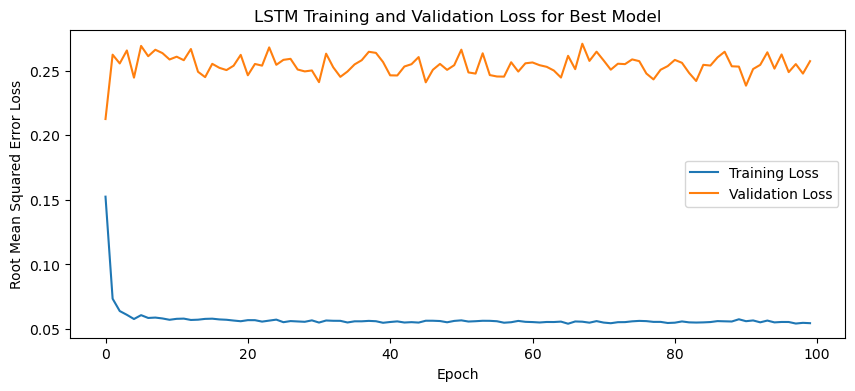

1/1 - 3s - loss: 0.0429 - 3s/epoch - 3s/step
Test Loss: 0.04292501509189606
1/1 [==============================] - 0s 63ms/step


IndexError: index 10 is out of bounds for axis 0 with size 10

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

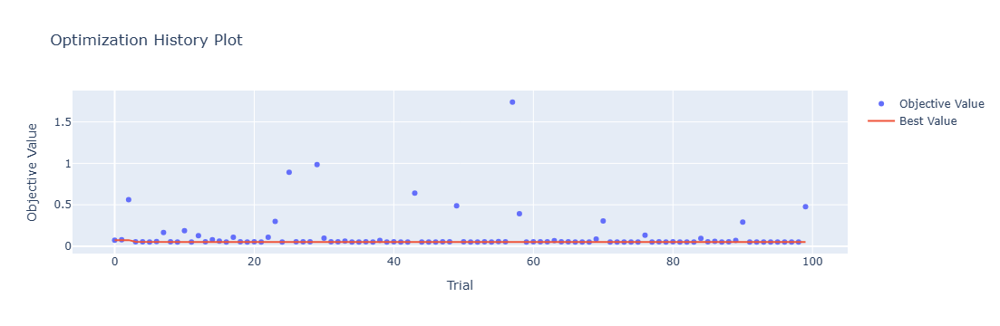

In [4]:
optuna.visualization.plot_optimization_history(study)

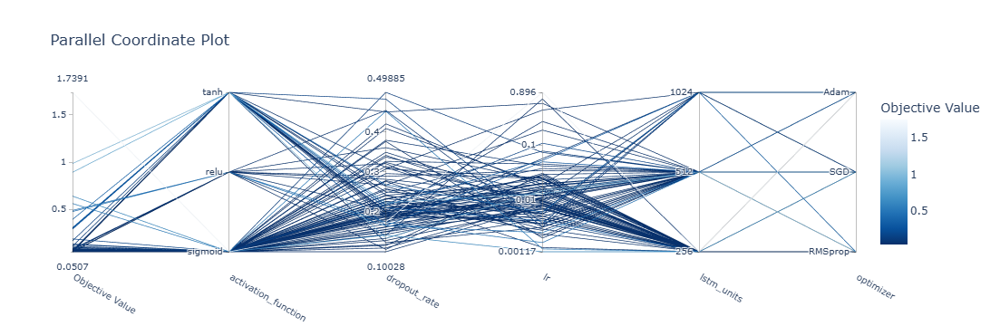

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

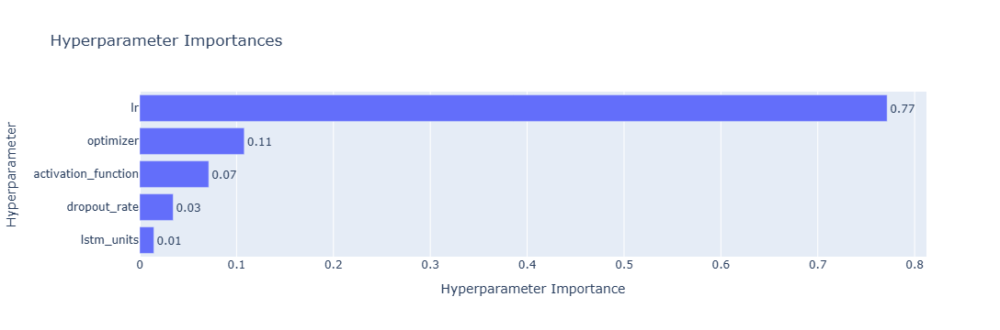

In [6]:
optuna.visualization.plot_param_importances(study)

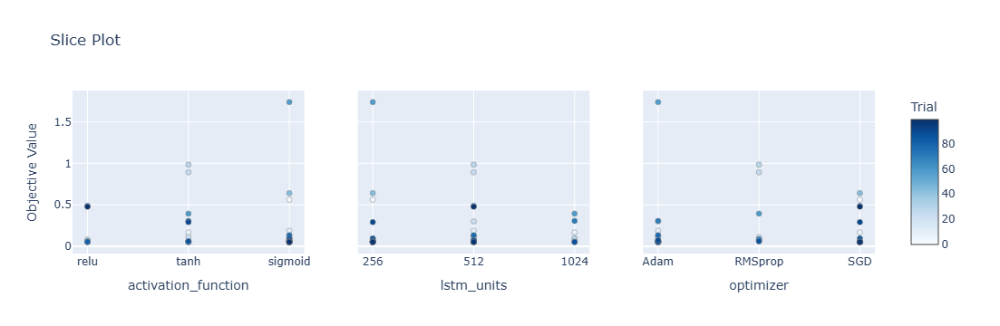

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

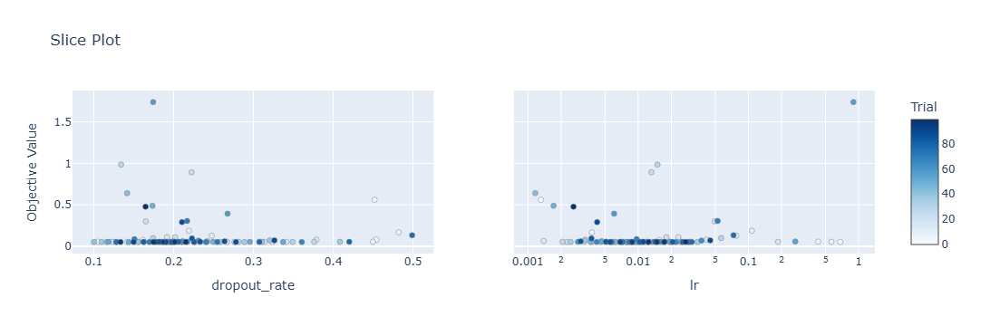

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 29s 135ms/step - loss: 0.1423 - accuracy: 0.2262 - mae: 0.1153 - rmse: 0.1423 - mape: inf - pearson: 0.5816 - val_loss: 0.0709 - val_accuracy: 0.4000 - val_mae: 0.0585 - val_rmse: 0.0709 - val_mape: 12.9066 - val_pearson: 0.8017
Epoch 2/100
84/84 [==============================] - 5s 55ms/step - loss: 0.0719 - accuracy: 0.5000 - mae: 0.0577 - rmse: 0.0719 - mape: inf - pearson: 0.8235 - val_loss: 0.0741 - val_accuracy: 0.4000 - val_mae: 0.0585 - val_rmse: 0.0741 - val_mape: 13.5708 - val_pearson: 0.7508
Epoch 3/100
84/84 [==============================] - 5s 59ms/step - loss: 0.0637 - accuracy: 0.4048 - mae: 0.0505 - rmse: 0.0637 - mape: inf - pearson: 0.8224 - val_loss: 0.0632 - val_accuracy: 0.4000 - val_mae: 0.0491 - val_rmse: 0.0632 - val_mape: 10.8689 - val_pearson: 0.8281
Epoch 4/100
84/84 [==============================] - 5s 63ms/step - loss: 0.0602 - accuracy: 0.5357 - mae: 0.0477 - rmse: 0.0602 - mape: inf - pearson: 0.8372

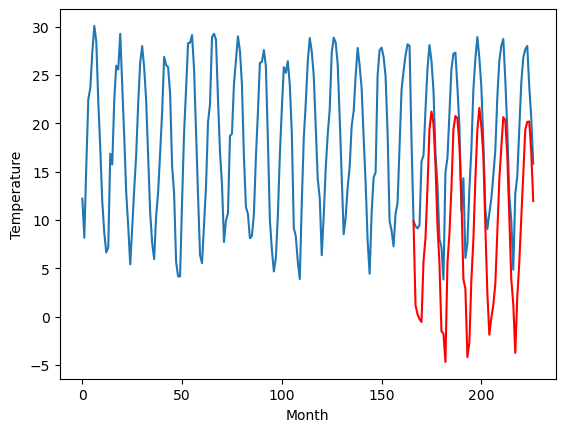

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		0.20		1.15
-1.85		-0.71		1.14
-2.23		-1.23		1.00
-1.48		-1.52		-0.04
4.35		4.74		0.39
4.84		7.14		2.30
7.61		12.39		4.78
11.36		18.41		7.05
11.84		20.24		8.40
12.47		18.97		6.50
9.49		14.78		5.29
6.86		8.48		1.62
3.44		4.50		1.06
-3.77		-2.48		1.29
-3.11		-2.73		0.38
-3.20		-5.66		-2.46
1.86		4.54		2.68
3.26		7.61		4.35
7.28		12.31		5.03
10.76		18.38		7.62
11.98		19.78		7.80
12.32		19.56		7.24
10.19		16.71		6.52
7.56		11.31		3.75
2.05		2.89		0.84
1.81		1.90		0.09
-4.87		-5.16		-0.29
-2.10		-3.66		-1.56
1.76		2.84		1.08
4.73		6.98		2.25
9.04		13.26		4.22
12.73		18.37		5.64
12.87		20.62		7.75
12.32		18.76		6.44
11.30		15.67		4.37
5.70		8.33		2.63
3.01		1.51		-1.50
-0.84		-2.85		-2.01
-0.05		-1.10		-1.05
1.05		0.24		-0.81
2.64		2.41		-0.23
4.79		7.74		2.95
7.97		13.19		5.22
11.05		16.52		5.47
12.88		19.67		6.79
14.47		19.34		4.87
11.09		15.65		4.56
5.98		9.34		3.36
0.74		2.88		2.14
-1.96	

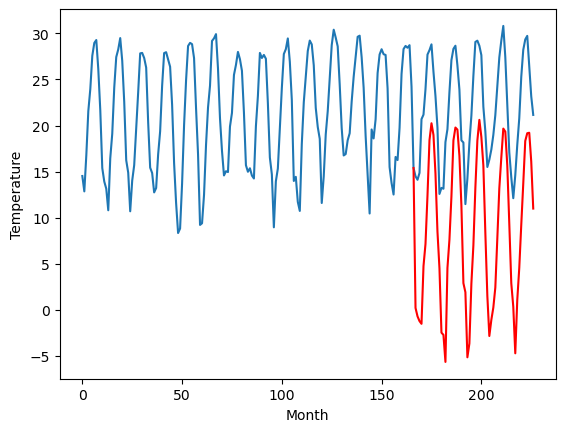

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.10		-1.18		1.92
-3.21		-2.09		1.12
-3.83		-2.61		1.22
-3.21		-2.90		0.31
3.04		3.36		0.32
2.80		5.76		2.96
6.49		11.01		4.52
10.21		17.03		6.82
12.58		18.86		6.28
11.82		17.59		5.77
8.43		13.40		4.97
4.71		7.10		2.39
-0.22		3.12		3.34
-7.22		-3.86		3.36
-6.40		-4.11		2.29
-5.54		-7.04		-1.50
0.44		3.16		2.72
2.08		6.23		4.15
6.06		10.93		4.87
10.20		17.00		6.80
11.96		18.40		6.44
12.24		18.18		5.94
8.67		15.33		6.66
4.79		9.93		5.14
-3.57		1.51		5.08
-1.39		0.52		1.91
-7.40		-6.54		0.86
-3.45		-5.04		-1.59
0.05		1.46		1.41
2.79		5.60		2.81
8.55		11.88		3.33
12.33		16.99		4.66
13.25		19.24		5.99
12.02		17.38		5.36
8.90		14.29		5.39
1.76		6.95		5.19
-0.72		0.13		0.85
-5.24		-4.23		1.01
-3.29		-2.48		0.81
-0.51		-1.14		-0.63
-0.53		1.03		1.56
2.54		6.36		3.82
5.95		11.81		5.86
9.27		15.14		5.87
12.37		18.29		5.92
11.98		17.96		5.98
8.53		14.27		5.74
2.55		7.96		5.41
-2.54		1.50		4.04
-5.57		-

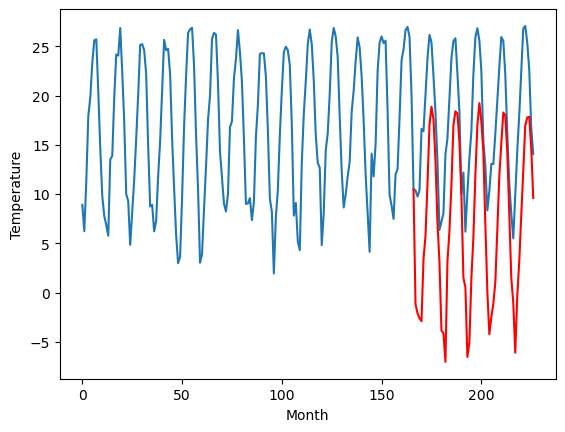

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.49		-2.38		0.11
-2.51		-3.29		-0.78
-2.47		-3.81		-1.34
-2.47		-4.10		-1.63
4.45		2.16		-2.29
4.53		4.56		0.03
7.42		9.81		2.39
10.33		15.83		5.50
11.30		17.66		6.36
11.64		16.39		4.75
9.31		12.20		2.89
5.25		5.90		0.65
2.41		1.92		-0.49
-5.05		-5.06		-0.01
-4.96		-5.31		-0.35
-6.53		-8.24		-1.71
1.38		1.96		0.58
3.17		5.03		1.86
7.14		9.73		2.59
10.42		15.80		5.38
11.05		17.20		6.15
11.10		16.98		5.88
8.59		14.13		5.54
6.28		8.73		2.45
-1.81		0.31		2.12
0.96		-0.68		-1.64
-6.39		-7.74		-1.35
-3.95		-6.24		-2.29
-0.16		0.26		0.42
4.63		4.40		-0.23
9.15		10.68		1.53
11.58		15.79		4.21
11.56		18.04		6.48
10.37		16.18		5.81
9.13		13.09		3.96
3.51		5.75		2.24
-0.60		-1.07		-0.47
-2.78		-5.43		-2.65
-1.34		-3.68		-2.34
-0.93		-2.34		-1.41
2.59		-0.17		-2.76
4.01		5.16		1.15
8.44		10.61		2.17
12.19		13.94		1.75
13.31		17.09		3.78
14.84		16.76		1.92
11.40		13.07		1.67
5.15		6.76		1.61
-0.71		0.30

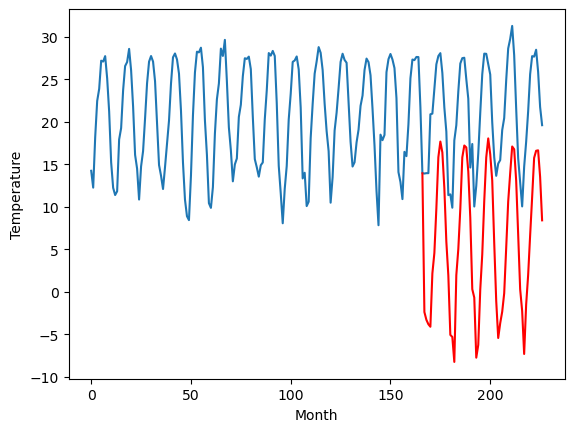

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.32		4.54		-0.78
3.27		3.63		0.36
4.01		3.11		-0.90
3.34		2.82		-0.52
11.09		9.08		-2.01
11.34		11.48		0.14
16.32		16.73		0.41
20.52		22.75		2.23
22.13		24.58		2.45
22.62		23.31		0.69
16.91		19.12		2.21
12.03		12.82		0.79
9.51		8.84		-0.67
3.04		1.86		-1.18
2.16		1.61		-0.55
-0.93		-1.32		-0.39
8.97		8.88		-0.09
10.90		11.95		1.05
14.76		16.65		1.89
19.96		22.72		2.76
20.39		24.12		3.73
21.15		23.90		2.75
19.14		21.05		1.91
14.79		15.65		0.86
7.22		7.23		0.01
9.55		6.24		-3.31
1.10		-0.82		-1.92
0.87		0.68		-0.19
7.36		7.18		-0.18
13.40		11.32		-2.08
18.11		17.60		-0.51
22.45		22.71		0.26
24.81		24.96		0.15
22.45		23.10		0.65
19.50		20.01		0.51
13.58		12.67		-0.91
6.65		5.85		-0.80
3.92		1.49		-2.43
4.89		3.24		-1.65
5.02		4.58		-0.44
9.74		6.75		-2.99
11.24		12.08		0.84
16.77		17.53		0.76
21.32		20.86		-0.46
24.31		24.01		-0.30
26.05		23.68		-2.37
21.57		19.99		-1.58
13.91		13.68		-0.23
7.5

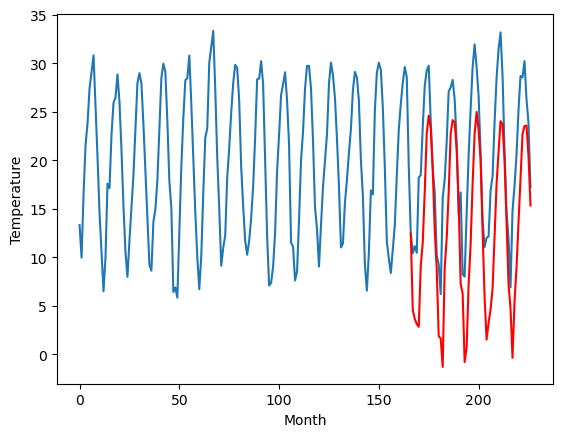

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.85		6.85		1.00
5.28		5.94		0.66
4.75		5.42		0.67
4.44		5.13		0.69
8.03		11.39		3.36
10.00		13.79		3.79
13.69		19.04		5.35
18.04		25.06		7.02
21.78		26.89		5.11
20.93		25.62		4.69
17.90		21.43		3.53
13.81		15.13		1.32
9.69		11.15		1.46
2.94		4.17		1.23
1.16		3.92		2.76
1.81		0.99		-0.82
6.71		11.19		4.48
10.08		14.26		4.18
13.59		18.96		5.37
18.16		25.03		6.87
20.15		26.43		6.28
20.63		26.21		5.58
17.62		23.36		5.74
14.02		17.96		3.94
5.85		9.54		3.69
6.90		8.55		1.65
0.52		1.49		0.97
4.13		2.99		-1.14
8.05		9.49		1.44
10.92		13.63		2.71
15.55		19.91		4.36
19.12		25.02		5.90
21.26		27.27		6.01
20.41		25.41		5.00
17.76		22.32		4.56
11.20		14.98		3.78
9.51		8.16		-1.35
2.99		3.80		0.81
4.68		5.55		0.87
6.17		6.89		0.72
7.08		9.06		1.98
11.76		14.39		2.63
13.28		19.84		6.56
17.10		23.17		6.07
20.93		26.32		5.39
20.45		25.99		5.54
16.93		22.30		5.37
12.58		15.99		3.41
7.14		9.53		2.39
5.00		6.98

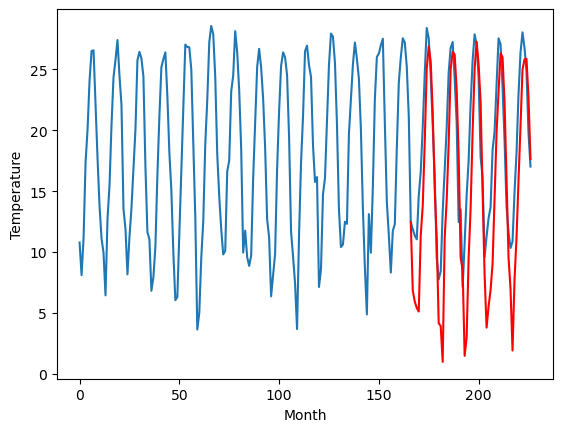

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.20		1.24		2.44
-1.56		0.33		1.89
-2.03		-0.19		1.84
-0.92		-0.48		0.44
4.50		5.78		1.28
5.74		8.18		2.44
8.08		13.43		5.35
13.33		19.45		6.12
16.40		21.28		4.88
15.37		20.01		4.64
11.48		15.82		4.34
7.48		9.52		2.04
3.30		5.54		2.24
-3.63		-1.44		2.19
-4.21		-1.69		2.52
-3.57		-4.62		-1.05
3.41		5.58		2.17
4.44		8.65		4.21
8.15		13.35		5.20
12.48		19.42		6.94
14.10		20.82		6.72
14.04		20.60		6.56
9.99		17.75		7.76
6.76		12.35		5.59
-1.89		3.93		5.82
0.05		2.94		2.89
-6.60		-4.12		2.48
-2.62		-2.62		0.00
1.72		3.88		2.16
4.64		8.02		3.38
9.71		14.30		4.59
13.62		19.41		5.79
14.72		21.66		6.94
13.43		19.80		6.37
10.37		16.71		6.34
3.43		9.37		5.94
1.20		2.55		1.35
-5.31		-1.81		3.50
-2.12		-0.06		2.06
0.88		1.28		0.40
1.36		3.45		2.09
4.92		8.78		3.86
7.61		14.23		6.62
10.96		17.56		6.60
14.67		20.71		6.04
13.98		20.38		6.40
10.47		16.69		6.22
5.26		10.38		5.12
-0.61		3.92		4.53
-2.90		1.37	

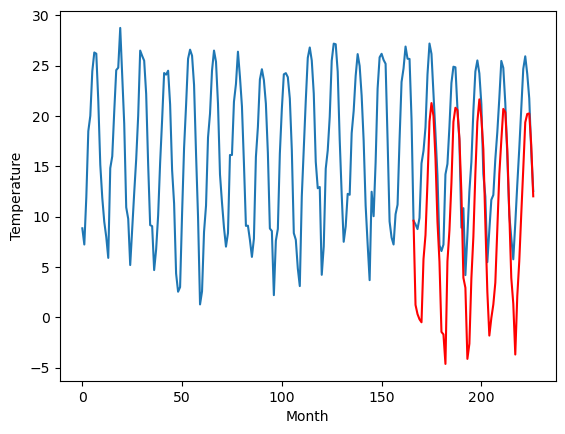

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.01		6.56		2.55
3.64		5.65		2.01
3.52		5.13		1.61
4.56		4.84		0.28
10.14		11.10		0.96
11.04		13.50		2.46
14.16		18.75		4.59
19.68		24.77		5.09
22.94		26.60		3.66
21.57		25.33		3.76
16.70		21.14		4.44
12.86		14.84		1.98
8.63		10.86		2.23
1.70		3.88		2.18
0.76		3.63		2.87
1.38		0.70		-0.68
7.90		10.90		3.00
11.53		13.97		2.44
14.55		18.67		4.12
19.34		24.74		5.40
21.46		26.14		4.68
21.41		25.92		4.51
16.90		23.07		6.17
13.05		17.67		4.62
3.55		9.25		5.70
5.61		8.26		2.65
-1.57		1.20		2.77
2.67		2.70		0.03
7.51		9.20		1.69
10.83		13.34		2.51
15.81		19.62		3.81
19.81		24.73		4.92
21.68		26.98		5.30
20.00		25.12		5.12
16.30		22.03		5.73
9.11		14.69		5.58
6.91		7.87		0.96
-0.26		3.51		3.77
2.91		5.26		2.35
5.88		6.60		0.72
6.56		8.77		2.21
11.18		14.10		2.92
13.47		19.55		6.08
17.22		22.88		5.66
21.36		26.03		4.67
20.22		25.70		5.48
16.46		22.01		5.55
11.07		15.70		4.63
4.62		9.24		4.62
3.03		6.69

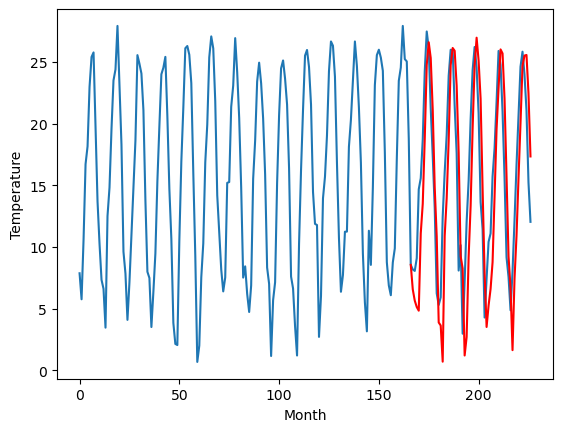

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.48		5.63		1.15
4.32		4.72		0.40
3.13		4.20		1.07
3.63		3.91		0.28
10.20		10.17		-0.03
12.48		12.57		0.09
17.36		17.82		0.46
23.29		23.84		0.55
26.03		25.67		-0.36
23.02		24.40		1.38
19.46		20.21		0.75
12.20		13.91		1.71
9.34		9.93		0.59
2.63		2.95		0.32
1.84		2.70		0.86
-2.43		-0.23		2.20
10.04		9.97		-0.07
12.64		13.04		0.40
17.33		17.74		0.41
23.52		23.81		0.29
24.09		25.21		1.12
24.03		24.99		0.96
20.29		22.14		1.85
16.33		16.74		0.41
6.29		8.32		2.03
8.09		7.33		-0.76
-0.42		0.27		0.69
1.62		1.77		0.15
8.84		8.27		-0.57
12.79		12.41		-0.38
19.63		18.69		-0.94
24.15		23.80		-0.35
26.48		26.05		-0.43
23.60		24.19		0.59
19.96		21.10		1.14
13.40		13.76		0.36
7.43		6.94		-0.49
2.14		2.58		0.44
4.70		4.33		-0.37
6.31		5.67		-0.64
8.13		7.84		-0.29
13.91		13.17		-0.74
19.50		18.62		-0.88
23.37		21.95		-1.42
24.86		25.10		0.24
23.60		24.77		1.17
20.43		21.08		0.65
14.83		14.77		-0.06
7.84		8.31

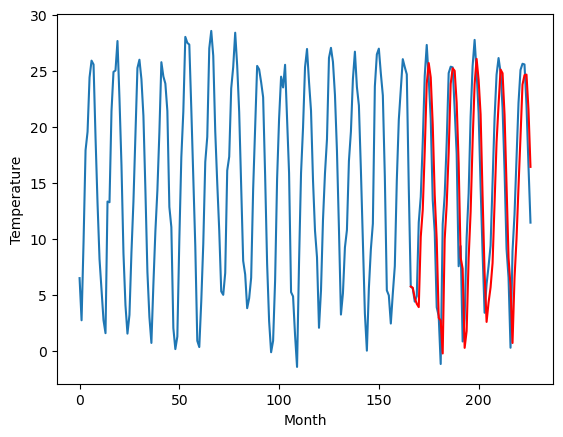

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.26		3.12		3.38
-0.08		2.21		2.29
-1.36		1.69		3.05
-2.23		1.40		3.63
4.96		7.66		2.70
6.62		10.06		3.44
11.71		15.31		3.60
18.69		21.33		2.64
21.32		23.16		1.84
18.94		21.89		2.95
15.27		17.70		2.43
8.88		11.40		2.52
5.20		7.42		2.22
-2.31		0.44		2.75
-3.90		0.19		4.09
-6.07		-2.74		3.33
4.68		7.46		2.78
7.74		10.53		2.79
12.21		15.23		3.02
18.69		21.30		2.61
19.70		22.70		3.00
20.30		22.48		2.18
16.44		19.63		3.19
11.97		14.23		2.26
1.31		5.81		4.50
2.54		4.82		2.28
-6.43		-2.24		4.19
-2.85		-0.74		2.11
4.13		5.76		1.63
6.86		9.90		3.04
15.03		16.18		1.15
18.93		21.29		2.36
20.96		23.54		2.58
19.05		21.68		2.63
15.32		18.59		3.27
8.28		11.25		2.97
3.26		4.43		1.17
-2.45		0.07		2.52
-0.56		1.82		2.38
1.48		3.16		1.68
1.82		5.33		3.51
8.10		10.66		2.56
13.06		16.11		3.05
16.90		19.44		2.54
19.73		22.59		2.86
18.93		22.26		3.33
16.32		18.57		2.25
9.74		12.26		2.52
3.24		5.80		2.56
0.81		3.2

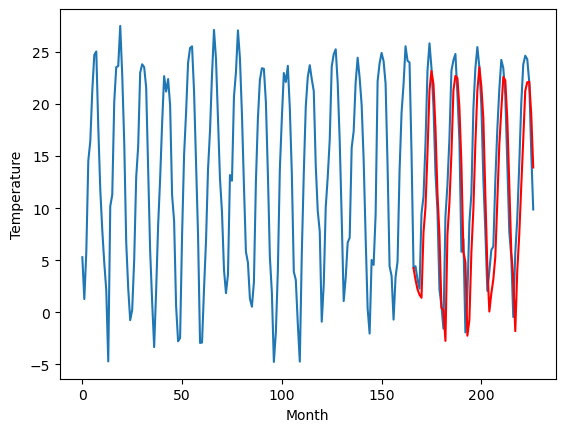

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.50		1.18		2.68
-2.17		0.27		2.44
-3.20		-0.25		2.95
-4.66		-0.54		4.12
1.48		5.72		4.24
4.13		8.12		3.99
10.56		13.37		2.81
18.52		19.39		0.87
21.68		21.22		-0.46
18.99		19.95		0.96
14.16		15.76		1.60
7.41		9.46		2.05
3.93		5.48		1.55
-3.10		-1.50		1.60
-4.71		-1.75		2.96
-9.02		-4.68		4.34
2.71		5.52		2.81
6.68		8.59		1.91
11.83		13.29		1.46
19.14		19.36		0.22
19.73		20.76		1.03
20.44		20.54		0.10
16.39		17.69		1.30
12.04		12.29		0.25
1.18		3.87		2.69
0.28		2.88		2.60
-8.67		-4.18		4.49
-5.43		-2.68		2.75
1.48		3.82		2.34
5.09		7.96		2.87
14.41		14.24		-0.17
19.17		19.35		0.18
20.28		21.60		1.32
19.16		19.74		0.58
15.32		16.65		1.33
8.08		9.31		1.23
3.05		2.49		-0.56
-3.13		-1.87		1.26
-2.00		-0.12		1.88
-1.59		1.22		2.81
0.27		3.39		3.12
7.12		8.72		1.60
12.14		14.17		2.03
17.65		17.50		-0.15
20.11		20.65		0.54
18.30		20.32		2.02
15.92		16.63		0.71
9.96		10.32		0.36
2.32		3.86		1.54
1.6

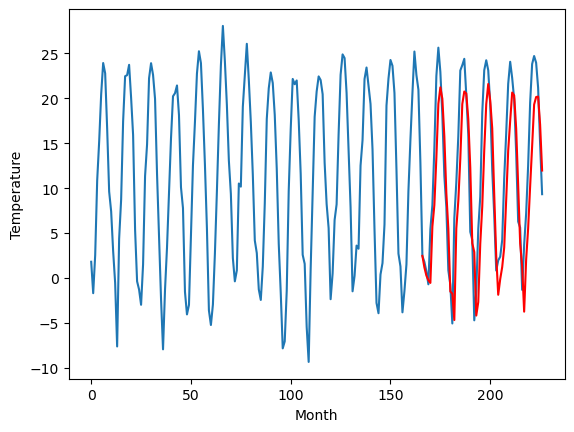

RangeIndex(start=1, stop=12, step=1)
[0.5800000000000001, -0.9500000000000002, -3.0999999999999996, -2.490000000000002, 5.320000000000001, 5.850000000000001, -1.200000000000001, 4.010000000000003, 4.48, -0.2599999999999998, -1.5000000000000018]
[1.182203388214111, 0.20220434188842784, -1.177795658111572, -2.3777956581115722, 4.542203388214112, 6.852204341888427, 1.2422043418884279, 6.562204341888428, 5.632203388214112, 3.1222033882141105, 1.182203388214111]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.58   1.182203
1                 1   -0.95   0.202204
2                 2   -3.10  -1.177796
3                 3   -2.49  -2.377796
4                 4    5.32   4.542203
5                 5    5.85   6.852204
6                 6   -1.20   1.242204
7                 7    4.01   6.562204
8                 8    4.48   5.632203
9                 9   -0.26   3.122203
10               10   -1.50   1.182203


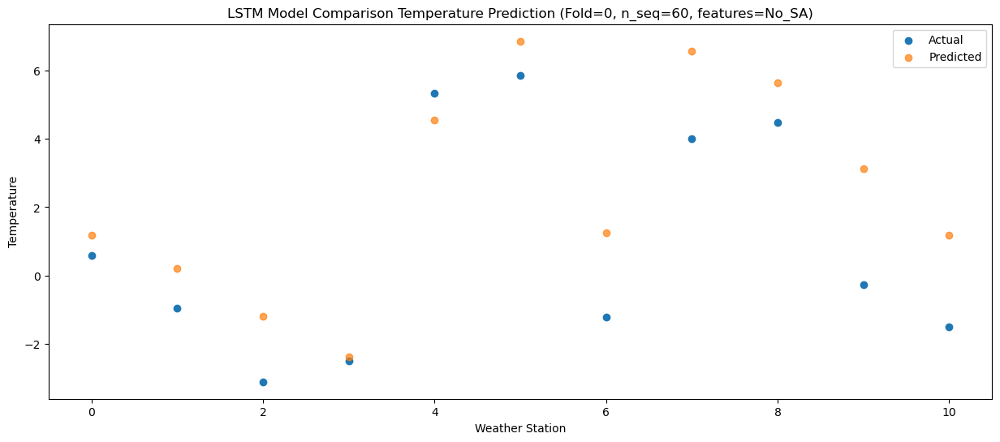

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.11   0.269317
1                 1   -1.85  -0.710683
2                 2   -3.21  -2.090683
3                 3   -2.51  -3.290683
4                 4    3.27   3.629317
5                 5    5.28   5.939317
6                 6   -1.56   0.329317
7                 7    3.64   5.649317
8                 8    4.32   4.719317
9                 9   -0.08   2.209317
10               10   -2.17   0.269317


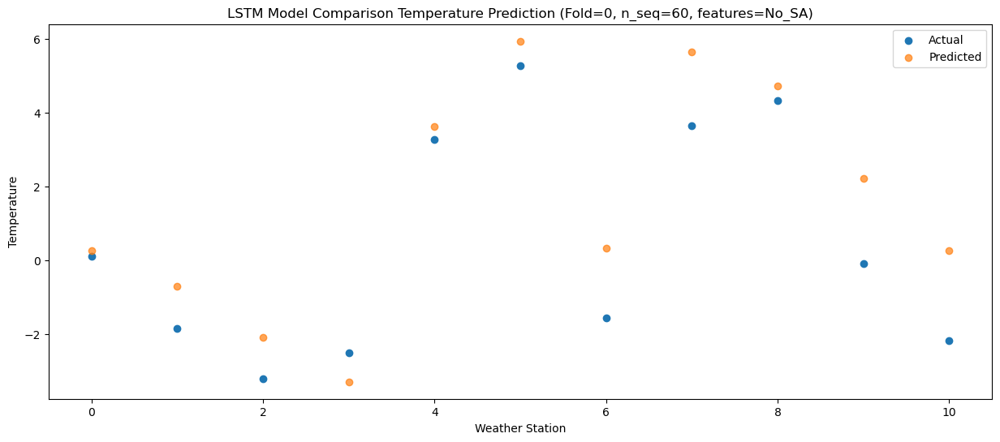

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.16  -0.249717
1                 1   -2.23  -1.229716
2                 2   -3.83  -2.609716
3                 3   -2.47  -3.809716
4                 4    4.01   3.110283
5                 5    4.75   5.420284
6                 6   -2.03  -0.189716
7                 7    3.52   5.130284
8                 8    3.13   4.200283
9                 9   -1.36   1.690283
10               10   -3.20  -0.249717


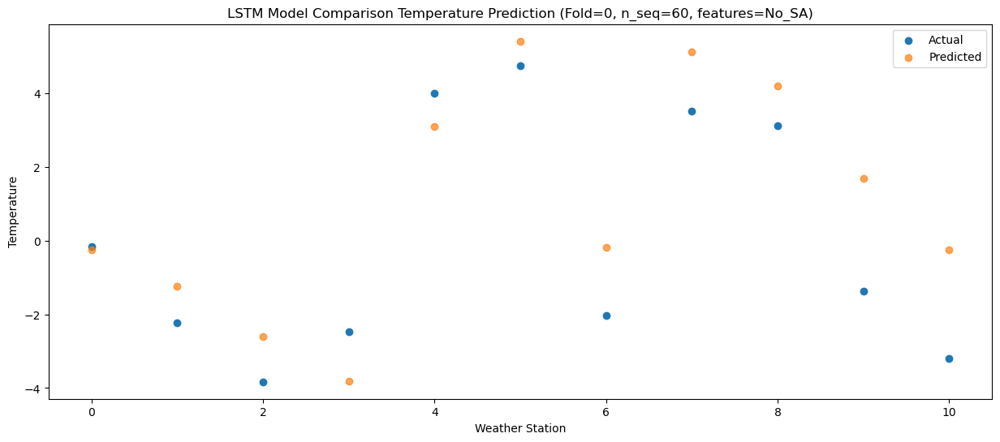

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.19  -0.544588
1                 1   -1.48  -1.524585
2                 2   -3.21  -2.904585
3                 3   -2.47  -4.104586
4                 4    3.34   2.815413
5                 5    4.44   5.125414
6                 6   -0.92  -0.484586
7                 7    4.56   4.835414
8                 8    3.63   3.905413
9                 9   -2.23   1.395413
10               10   -4.66  -0.544587


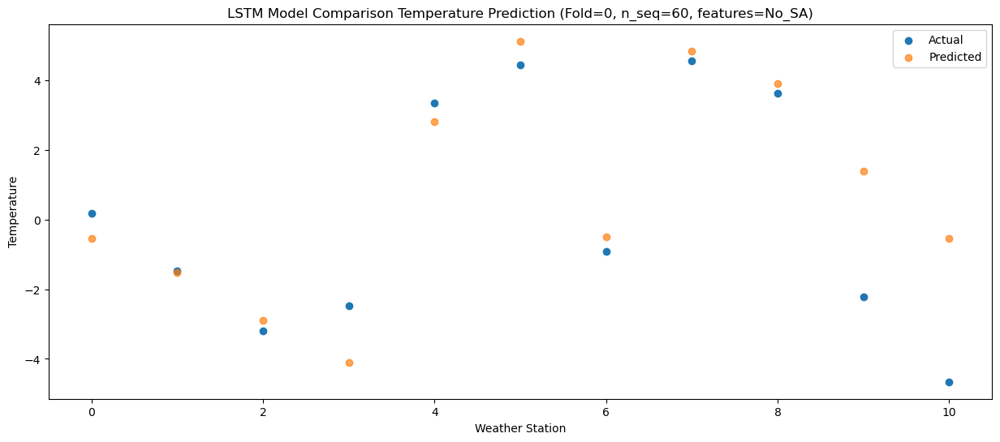

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.77   5.721100
1                 1    4.35   4.741103
2                 2    3.04   3.361103
3                 3    4.45   2.161102
4                 4   11.09   9.081101
5                 5    8.03  11.391102
6                 6    4.50   5.781102
7                 7   10.14  11.101102
8                 8   10.20  10.171101
9                 9    4.96   7.661101
10               10    1.48   5.721101


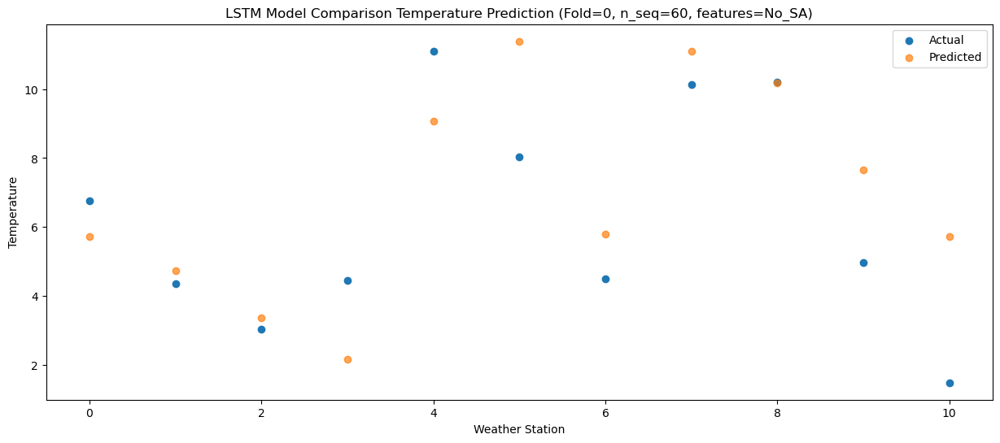

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    7.42   8.124410
1                 1    4.84   7.144413
2                 2    2.80   5.764413
3                 3    4.53   4.564412
4                 4   11.34  11.484411
5                 5   10.00  13.794412
6                 6    5.74   8.184412
7                 7   11.04  13.504412
8                 8   12.48  12.574411
9                 9    6.62  10.064411
10               10    4.13   8.124411


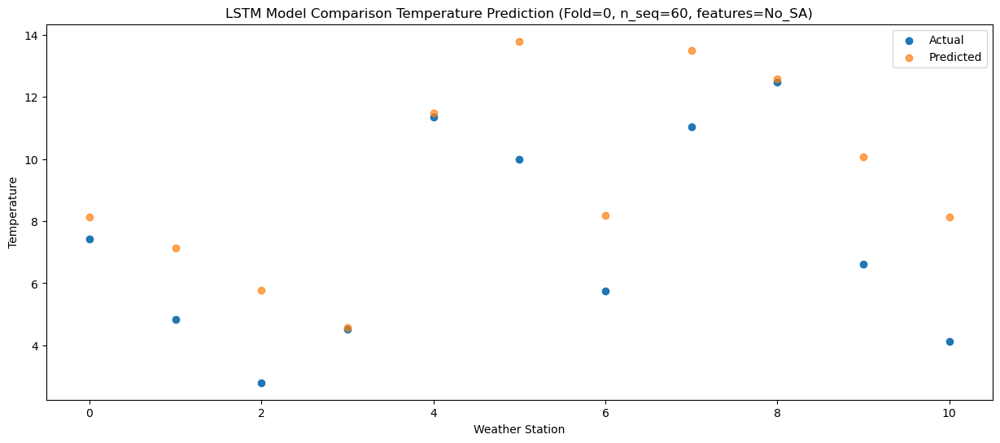

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.15  13.374830
1                 1    7.61  12.394835
2                 2    6.49  11.014835
3                 3    7.42   9.814832
4                 4   16.32  16.734831
5                 5   13.69  19.044832
6                 6    8.08  13.434832
7                 7   14.16  18.754832
8                 8   17.36  17.824831
9                 9   11.71  15.314831
10               10   10.56  13.374831


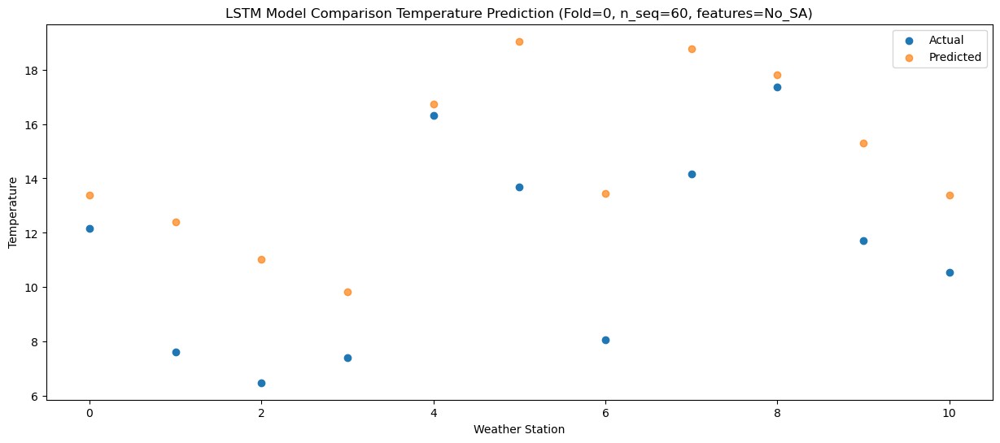

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   16.37  19.388634
1                 1   11.36  18.408639
2                 2   10.21  17.028639
3                 3   10.33  15.828636
4                 4   20.52  22.748635
5                 5   18.04  25.058636
6                 6   13.33  19.448636
7                 7   19.68  24.768636
8                 8   23.29  23.838635
9                 9   18.69  21.328635
10               10   18.52  19.388635


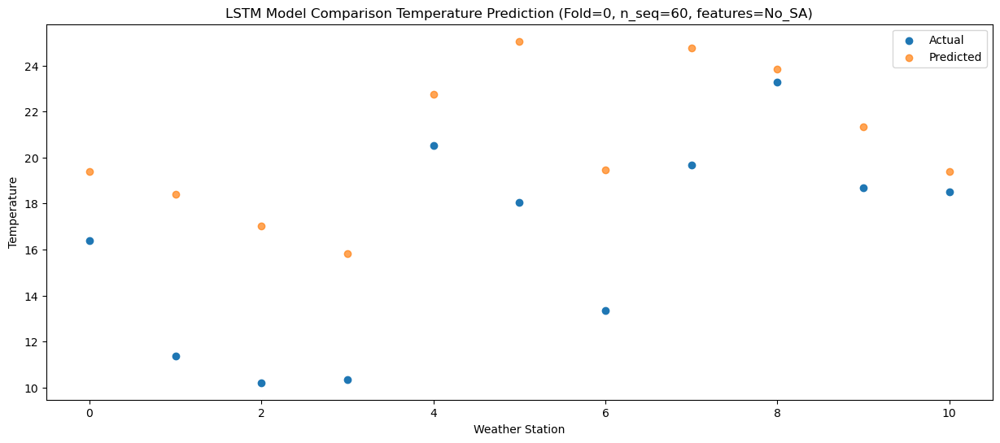

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.82  21.224517
1                 1   11.84  20.244522
2                 2   12.58  18.864522
3                 3   11.30  17.664519
4                 4   22.13  24.584518
5                 5   21.78  26.894519
6                 6   16.40  21.284519
7                 7   22.94  26.604517
8                 8   26.03  25.674518
9                 9   21.32  23.164516
10               10   21.68  21.224518


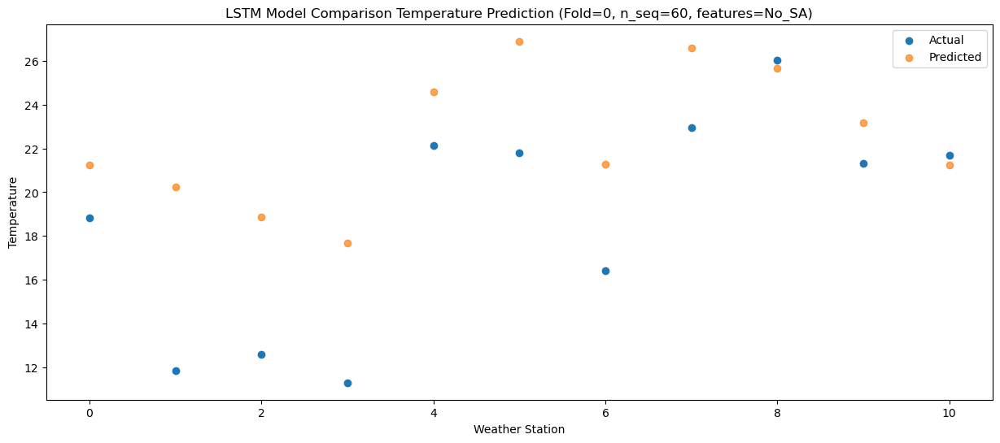

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.19  19.950776
1                 1   12.47  18.970780
2                 2   11.82  17.590780
3                 3   11.64  16.390777
4                 4   22.62  23.310776
5                 5   20.93  25.620777
6                 6   15.37  20.010777
7                 7   21.57  25.330775
8                 8   23.02  24.400776
9                 9   18.94  21.890774
10               10   18.99  19.950777


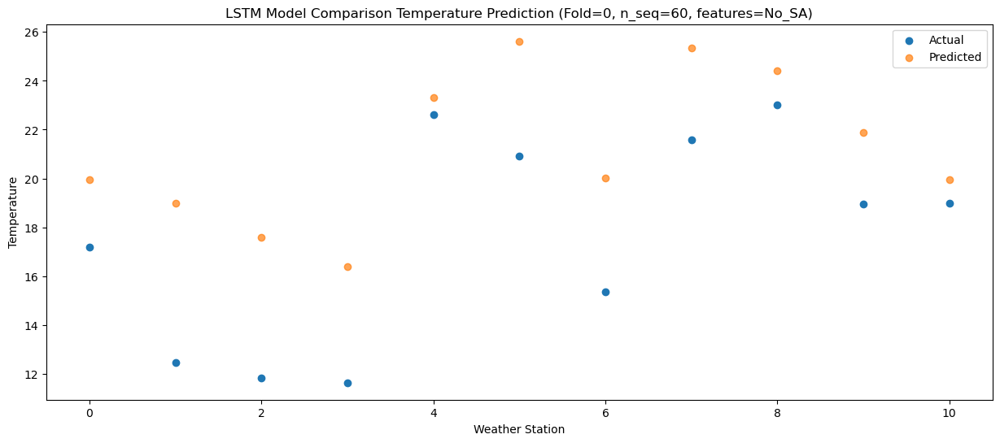

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.13  15.759660
1                 1    9.49  14.779663
2                 2    8.43  13.399663
3                 3    9.31  12.199661
4                 4   16.91  19.119660
5                 5   17.90  21.429661
6                 6   11.48  15.819661
7                 7   16.70  21.139658
8                 8   19.46  20.209660
9                 9   15.27  17.699658
10               10   14.16  15.759661


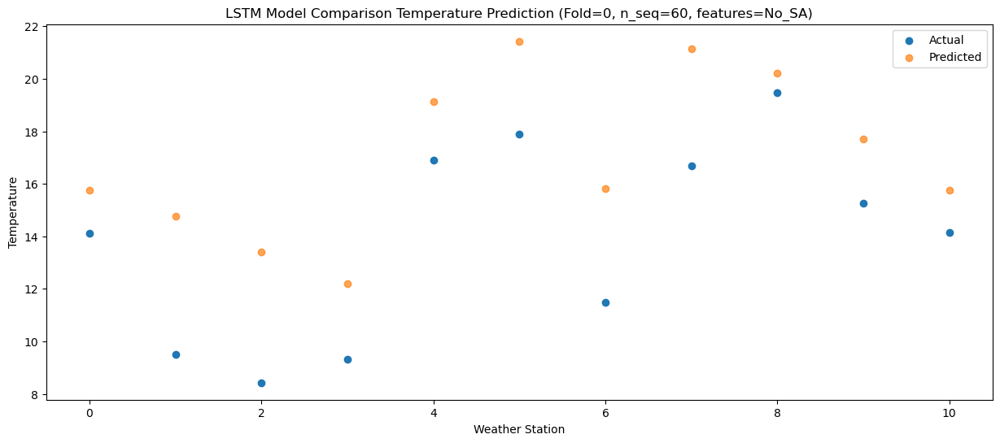

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   9.460225
1                 1    6.86   8.480229
2                 2    4.71   7.100229
3                 3    5.25   5.900226
4                 4   12.03  12.820225
5                 5   13.81  15.130226
6                 6    7.48   9.520226
7                 7   12.86  14.840224
8                 8   12.20  13.910225
9                 9    8.88  11.400223
10               10    7.41   9.460226


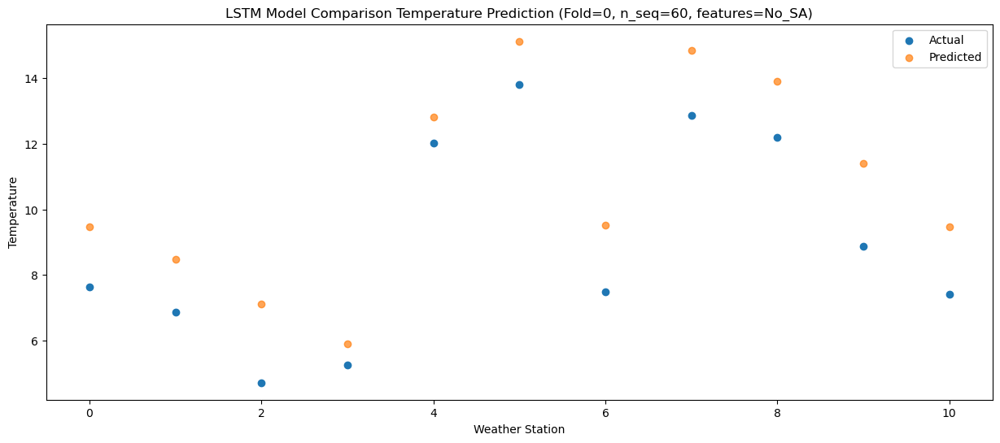

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.39   5.480163
1                 1    3.44   4.500166
2                 2   -0.22   3.120166
3                 3    2.41   1.920163
4                 4    9.51   8.840162
5                 5    9.69  11.150163
6                 6    3.30   5.540163
7                 7    8.63  10.860161
8                 8    9.34   9.930162
9                 9    5.20   7.420160
10               10    3.93   5.480163


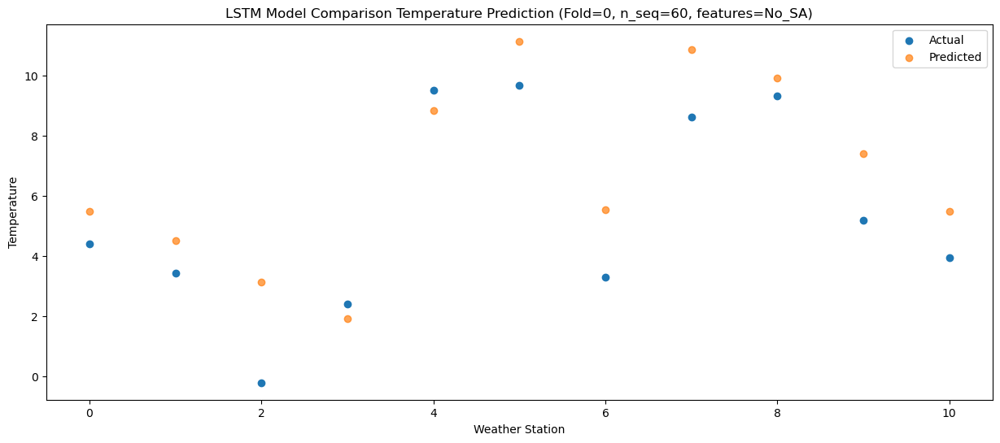

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -1.500924
1                 1   -3.77  -2.480920
2                 2   -7.22  -3.860920
3                 3   -5.05  -5.060923
4                 4    3.04   1.859076
5                 5    2.94   4.169077
6                 6   -3.63  -1.440923
7                 7    1.70   3.879075
8                 8    2.63   2.949076
9                 9   -2.31   0.439074
10               10   -3.10  -1.500923


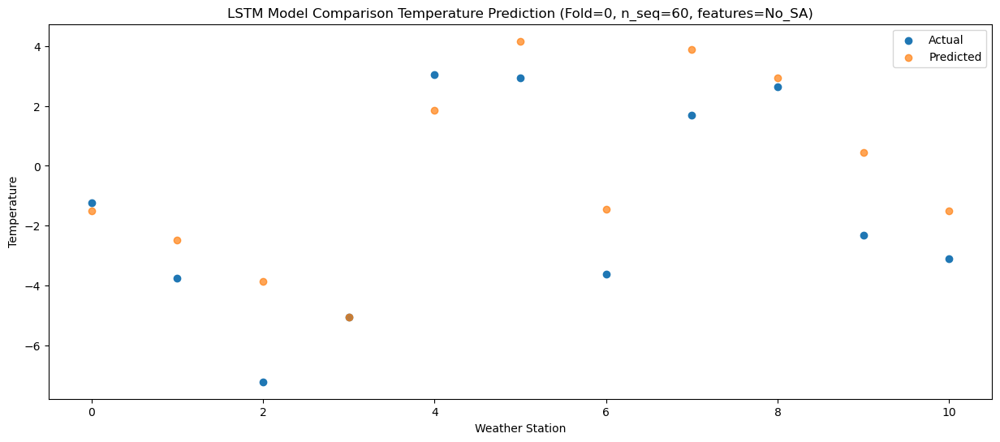

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.09  -1.746912
1                 1   -3.11  -2.726910
2                 2   -6.40  -4.106909
3                 3   -4.96  -5.306912
4                 4    2.16   1.613086
5                 5    1.16   3.923088
6                 6   -4.21  -1.686912
7                 7    0.76   3.633085
8                 8    1.84   2.703086
9                 9   -3.90   0.193084
10               10   -4.71  -1.746912


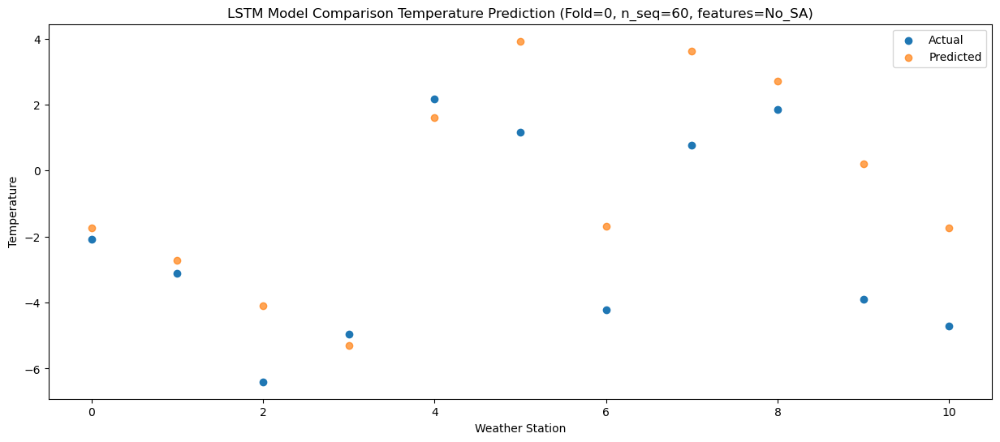

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -5.44  -4.679780
1                 1   -3.20  -5.659778
2                 2   -5.54  -7.039777
3                 3   -6.53  -8.239780
4                 4   -0.93  -1.319782
5                 5    1.81   0.990220
6                 6   -3.57  -4.619780
7                 7    1.38   0.700217
8                 8   -2.43  -0.229782
9                 9   -6.07  -2.739784
10               10   -9.02  -4.679780


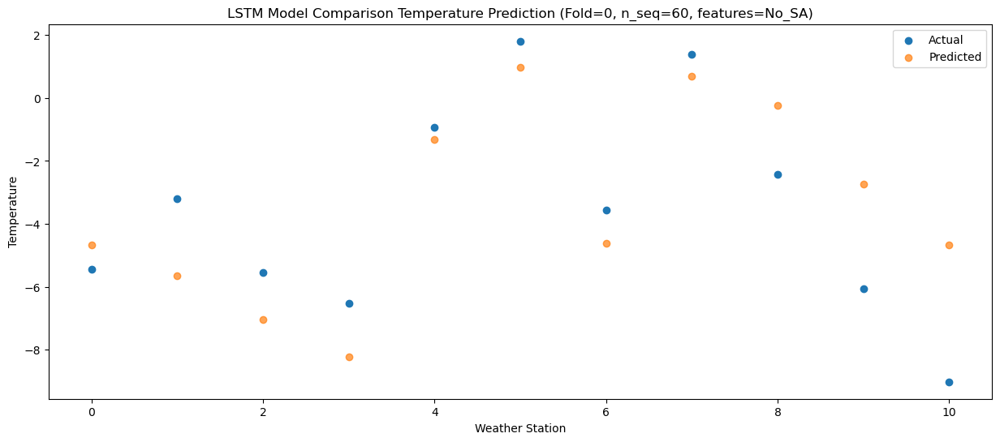

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.63   5.518890
1                 1    1.86   4.538893
2                 2    0.44   3.158894
3                 3    1.38   1.958891
4                 4    8.97   8.878889
5                 5    6.71  11.188891
6                 6    3.41   5.578891
7                 7    7.90  10.898888
8                 8   10.04   9.968889
9                 9    4.68   7.458887
10               10    2.71   5.518890


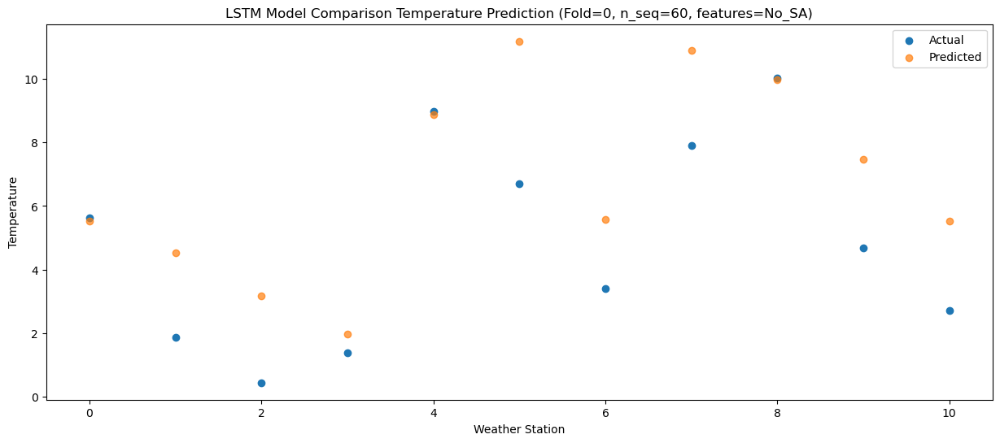

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.16   8.588587
1                 1    3.26   7.608590
2                 2    2.08   6.228591
3                 3    3.17   5.028588
4                 4   10.90  11.948586
5                 5   10.08  14.258588
6                 6    4.44   8.648588
7                 7   11.53  13.968585
8                 8   12.64  13.038586
9                 9    7.74  10.528584
10               10    6.68   8.588587


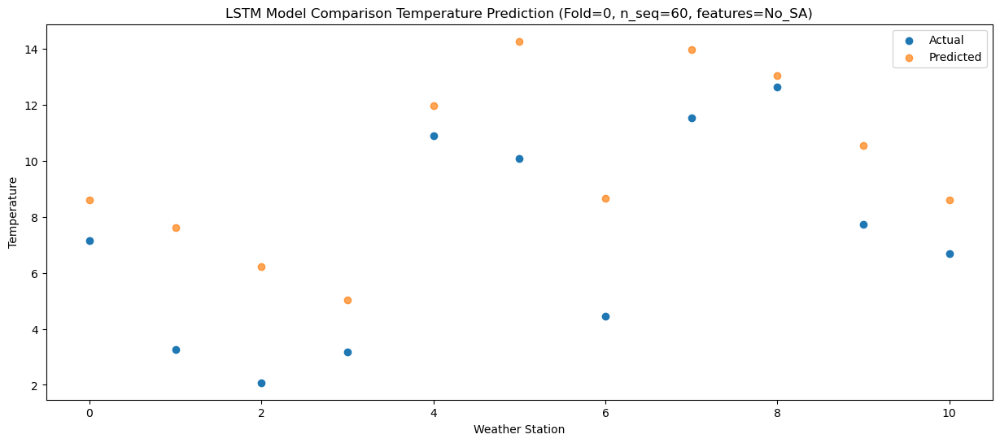

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   11.66  13.288663
1                 1    7.28  12.308666
2                 2    6.06  10.928667
3                 3    7.14   9.728664
4                 4   14.76  16.648662
5                 5   13.59  18.958664
6                 6    8.15  13.348664
7                 7   14.55  18.668661
8                 8   17.33  17.738662
9                 9   12.21  15.228660
10               10   11.83  13.288663


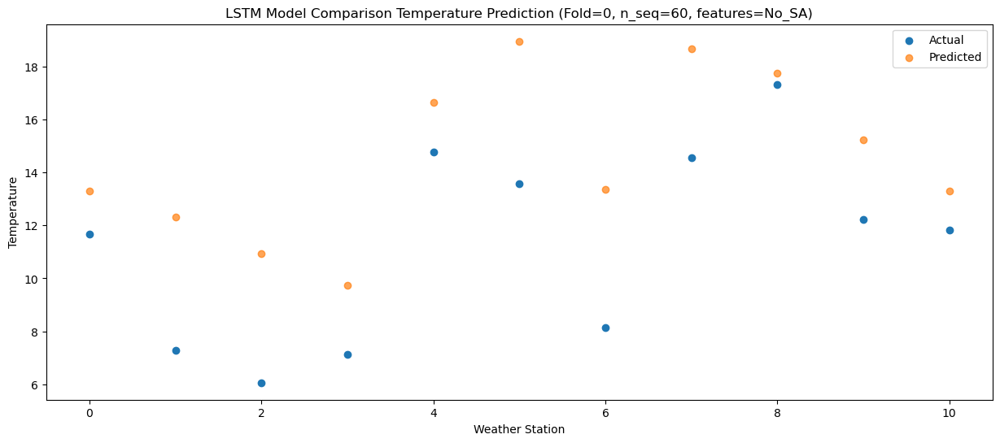

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.33  19.363154
1                 1   10.76  18.383157
2                 2   10.20  17.003158
3                 3   10.42  15.803155
4                 4   19.96  22.723153
5                 5   18.16  25.033155
6                 6   12.48  19.423155
7                 7   19.34  24.743152
8                 8   23.52  23.813153
9                 9   18.69  21.303151
10               10   19.14  19.363154


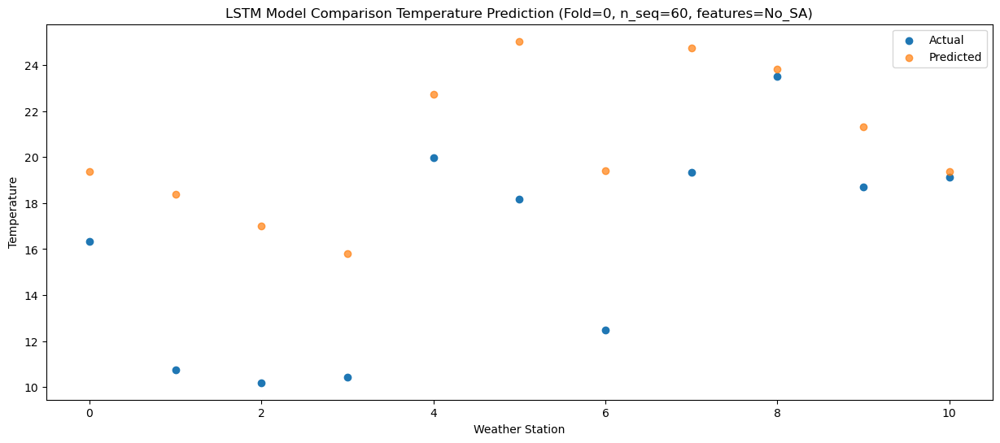

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.92  20.761031
1                 1   11.98  19.781034
2                 2   11.96  18.401035
3                 3   11.05  17.201032
4                 4   20.39  24.121030
5                 5   20.15  26.431032
6                 6   14.10  20.821032
7                 7   21.46  26.141029
8                 8   24.09  25.211030
9                 9   19.70  22.701028
10               10   19.73  20.761031


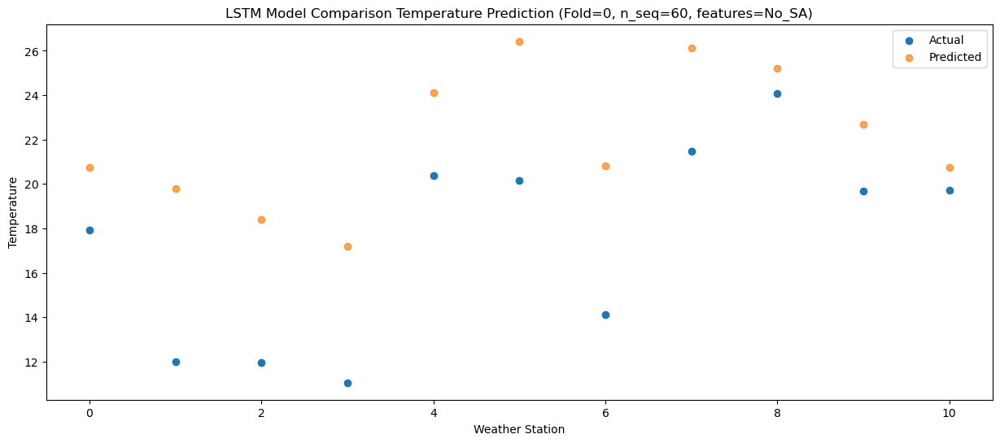

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.03  20.535113
1                 1   12.32  19.555116
2                 2   12.24  18.175117
3                 3   11.10  16.975114
4                 4   21.15  23.895112
5                 5   20.63  26.205114
6                 6   14.04  20.595114
7                 7   21.41  25.915111
8                 8   24.03  24.985112
9                 9   20.30  22.475110
10               10   20.44  20.535113


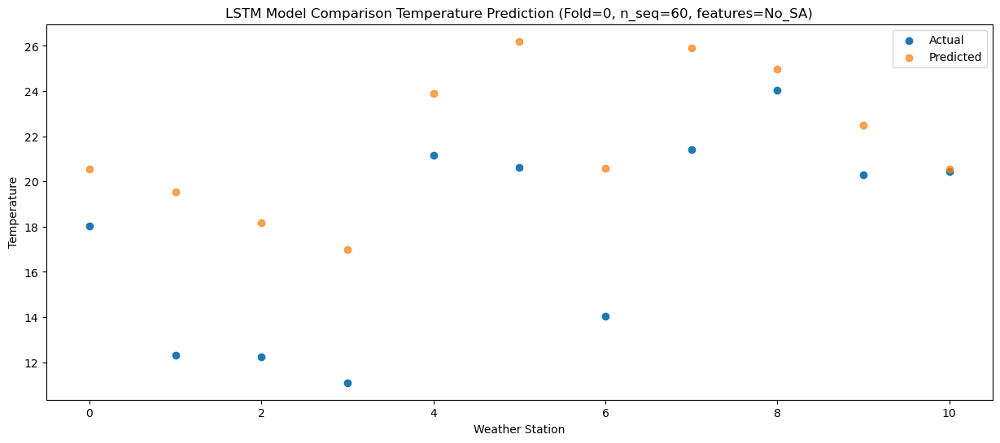

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.45  17.691393
1                 1   10.19  16.711396
2                 2    8.67  15.331397
3                 3    8.59  14.131394
4                 4   19.14  21.051392
5                 5   17.62  23.361394
6                 6    9.99  17.751394
7                 7   16.90  23.071391
8                 8   20.29  22.141392
9                 9   16.44  19.631390
10               10   16.39  17.691393


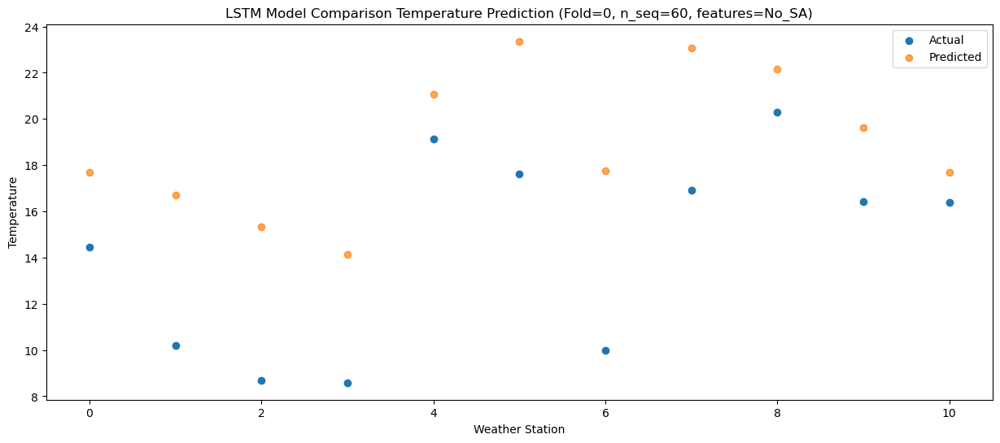

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.43  12.286378
1                 1    7.56  11.306381
2                 2    4.79   9.926382
3                 3    6.28   8.726379
4                 4   14.79  15.646377
5                 5   14.02  17.956379
6                 6    6.76  12.346379
7                 7   13.05  17.666376
8                 8   16.33  16.736377
9                 9   11.97  14.226375
10               10   12.04  12.286378


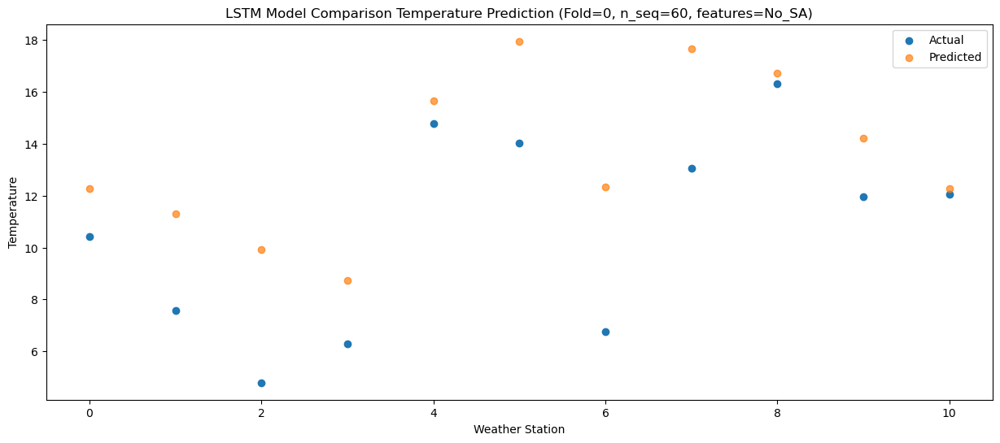

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.67   3.870964
1                 1    2.05   2.890967
2                 2   -3.57   1.510968
3                 3   -1.81   0.310965
4                 4    7.22   7.230963
5                 5    5.85   9.540965
6                 6   -1.89   3.930965
7                 7    3.55   9.250961
8                 8    6.29   8.320963
9                 9    1.31   5.810961
10               10    1.18   3.870964


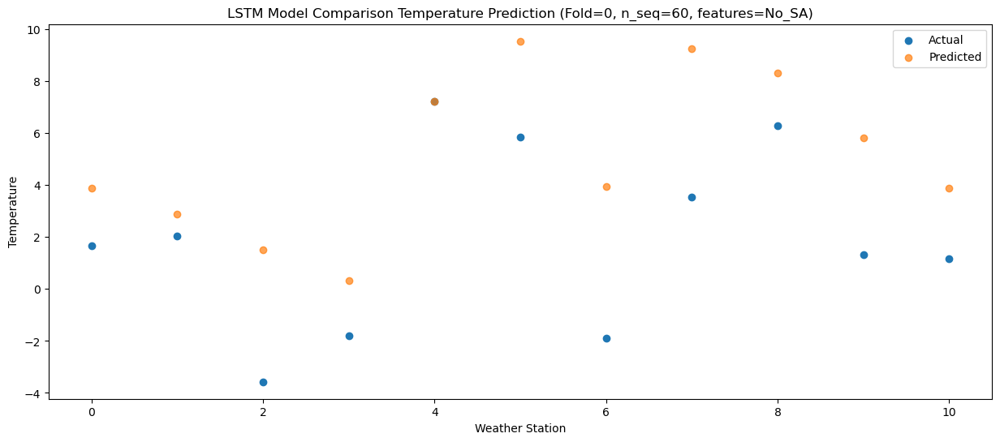

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    5.05   2.884150
1                 1    1.81   1.904153
2                 2   -1.39   0.524154
3                 3    0.96  -0.675849
4                 4    9.55   6.244149
5                 5    6.90   8.554151
6                 6    0.05   2.944151
7                 7    5.61   8.264147
8                 8    8.09   7.334149
9                 9    2.54   4.824147
10               10    0.28   2.884150


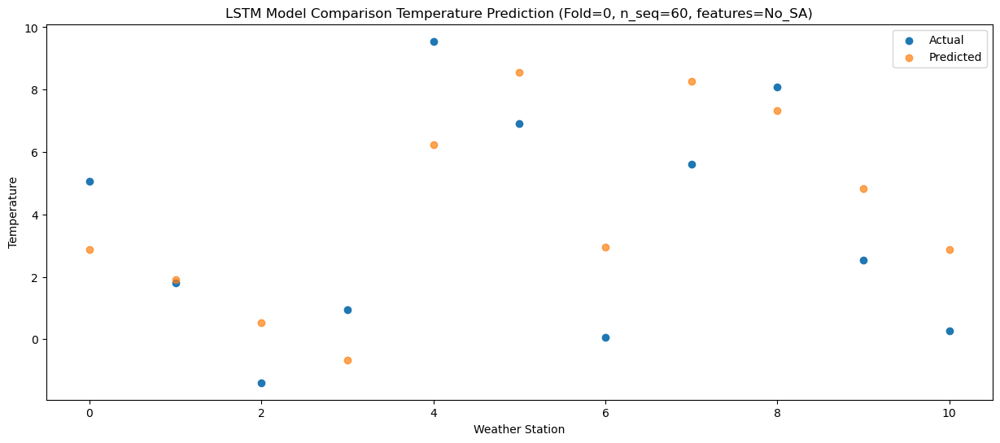

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -4.179385
1                 1   -4.87  -5.159383
2                 2   -7.40  -6.539382
3                 3   -6.39  -7.739385
4                 4    1.10  -0.819386
5                 5    0.52   1.490615
6                 6   -6.60  -4.119385
7                 7   -1.57   1.200612
8                 8   -0.42   0.270614
9                 9   -6.43  -2.239388
10               10   -8.67  -4.179385


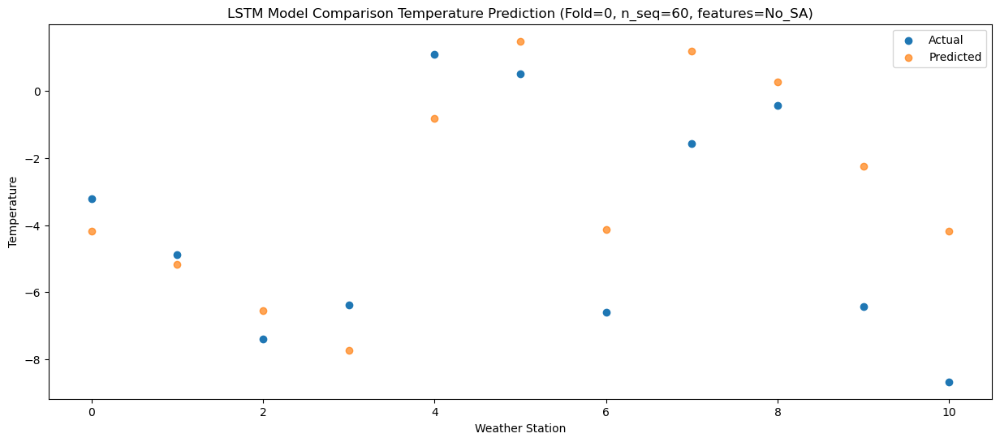

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.68  -2.676652
1                 1   -2.10  -3.656649
2                 2   -3.45  -5.036648
3                 3   -3.95  -6.236651
4                 4    0.87   0.683347
5                 5    4.13   2.993349
6                 6   -2.62  -2.616651
7                 7    2.67   2.703345
8                 8    1.62   1.773347
9                 9   -2.85  -0.736655
10               10   -5.43  -2.676652


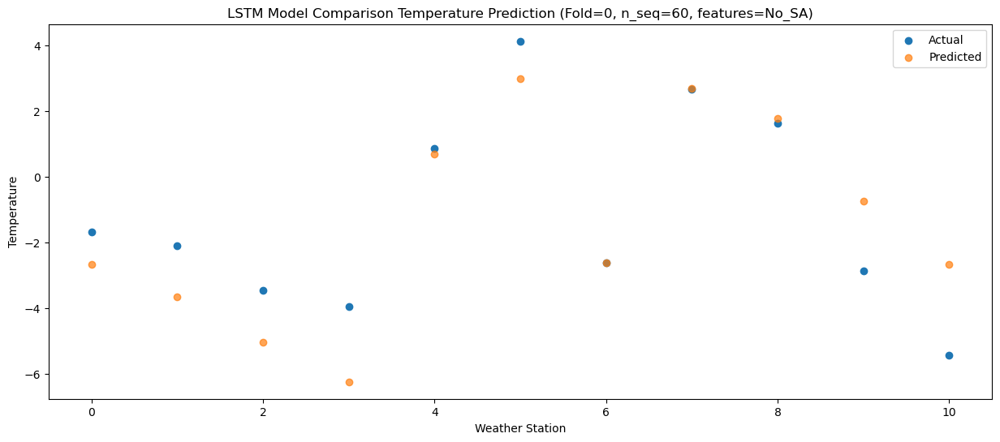

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.90   3.818008
1                 1    1.76   2.838010
2                 2    0.05   1.458011
3                 3   -0.16   0.258009
4                 4    7.36   7.178007
5                 5    8.05   9.488009
6                 6    1.72   3.878009
7                 7    7.51   9.198005
8                 8    8.84   8.268007
9                 9    4.13   5.758005
10               10    1.48   3.818008


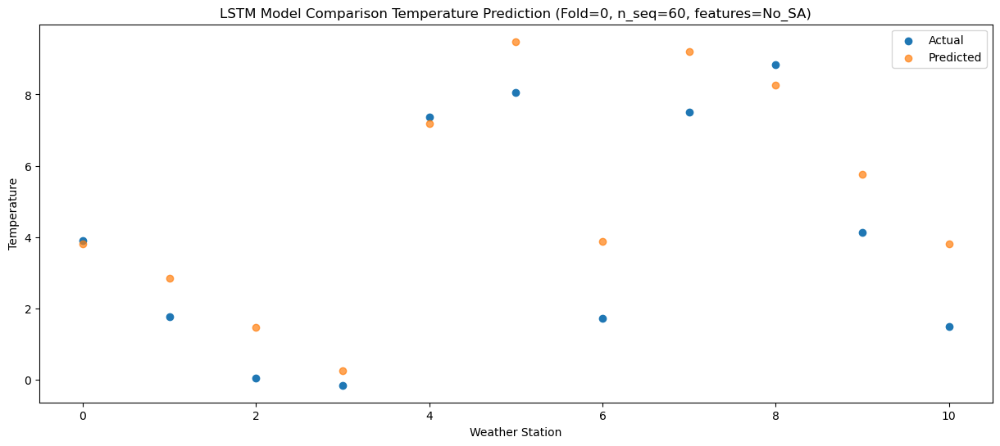

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    8.03   7.956972
1                 1    4.73   6.976975
2                 2    2.79   5.596976
3                 3    4.63   4.396973
4                 4   13.40  11.316971
5                 5   10.92  13.626973
6                 6    4.64   8.016973
7                 7   10.83  13.336969
8                 8   12.79  12.406971
9                 9    6.86   9.896969
10               10    5.09   7.956972


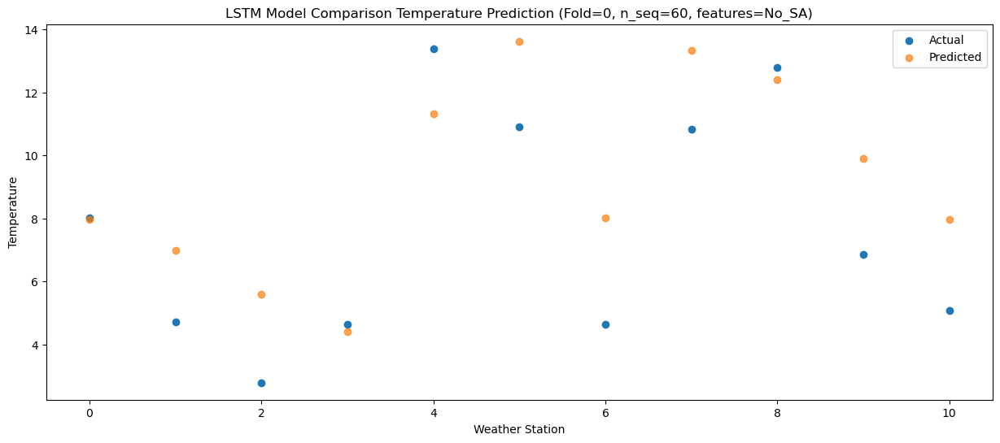

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.22  14.239684
1                 1    9.04  13.259687
2                 2    8.55  11.879688
3                 3    9.15  10.679685
4                 4   18.11  17.599683
5                 5   15.55  19.909685
6                 6    9.71  14.299685
7                 7   15.81  19.619681
8                 8   19.63  18.689683
9                 9   15.03  16.179681
10               10   14.41  14.239684


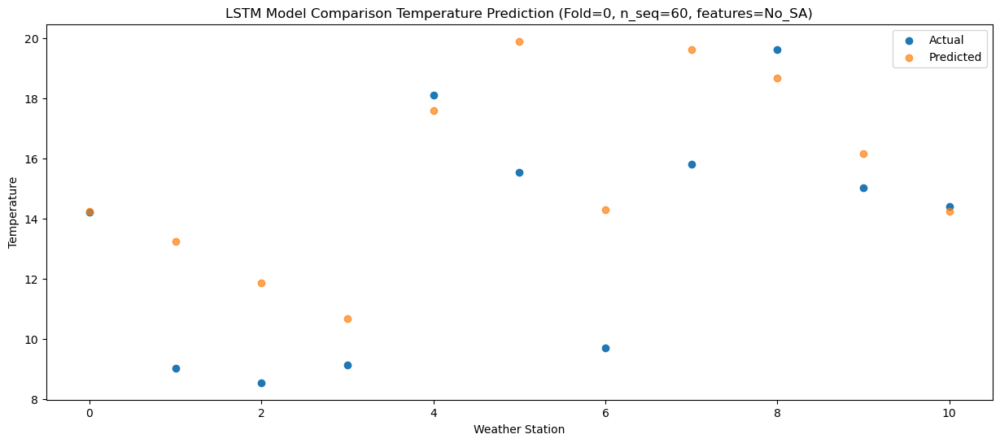

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   17.43  19.353428
1                 1   12.73  18.373431
2                 2   12.33  16.993432
3                 3   11.58  15.793429
4                 4   22.45  22.713427
5                 5   19.12  25.023429
6                 6   13.62  19.413429
7                 7   19.81  24.733425
8                 8   24.15  23.803427
9                 9   18.93  21.293423
10               10   19.17  19.353428


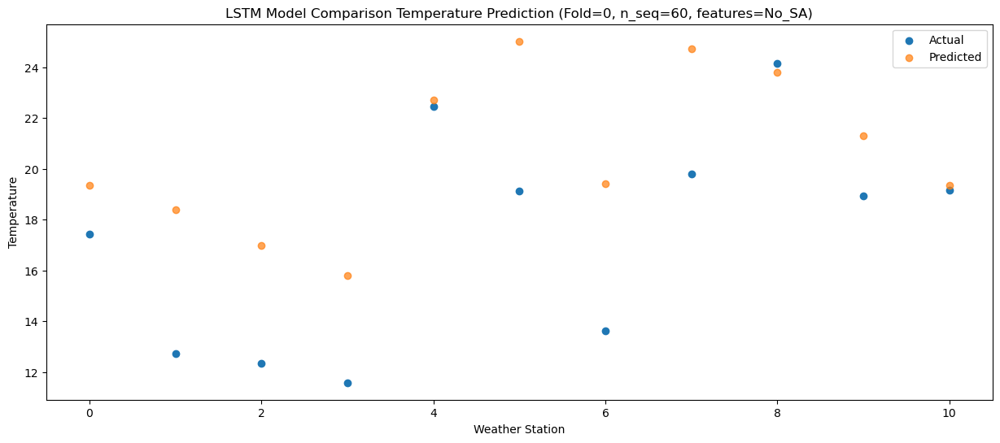

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   19.65  21.595554
1                 1   12.87  20.615557
2                 2   13.25  19.235558
3                 3   11.56  18.035555
4                 4   24.81  24.955551
5                 5   21.26  27.265555
6                 6   14.72  21.655555
7                 7   21.68  26.975551
8                 8   26.48  26.045553
9                 9   20.96  23.535547
10               10   20.28  21.595552


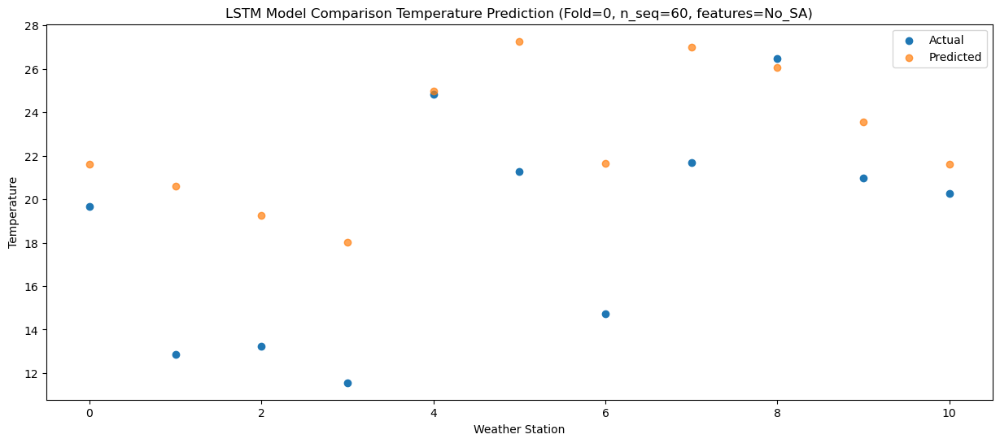

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.47  19.735366
1                 1   12.32  18.755368
2                 2   12.02  17.375369
3                 3   10.37  16.175366
4                 4   22.45  23.095362
5                 5   20.41  25.405366
6                 6   13.43  19.795366
7                 7   20.00  25.115362
8                 8   23.60  24.185364
9                 9   19.05  21.675358
10               10   19.16  19.735363


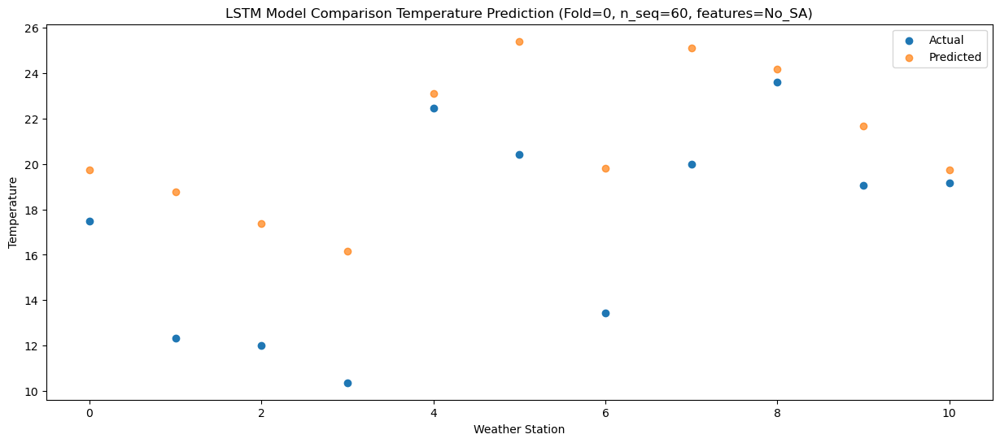

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   14.50  16.647605
1                 1   11.30  15.667607
2                 2    8.90  14.287608
3                 3    9.13  13.087605
4                 4   19.50  20.007600
5                 5   17.76  22.317605
6                 6   10.37  16.707605
7                 7   16.30  22.027602
8                 8   19.96  21.097604
9                 9   15.32  18.587597
10               10   15.32  16.647602


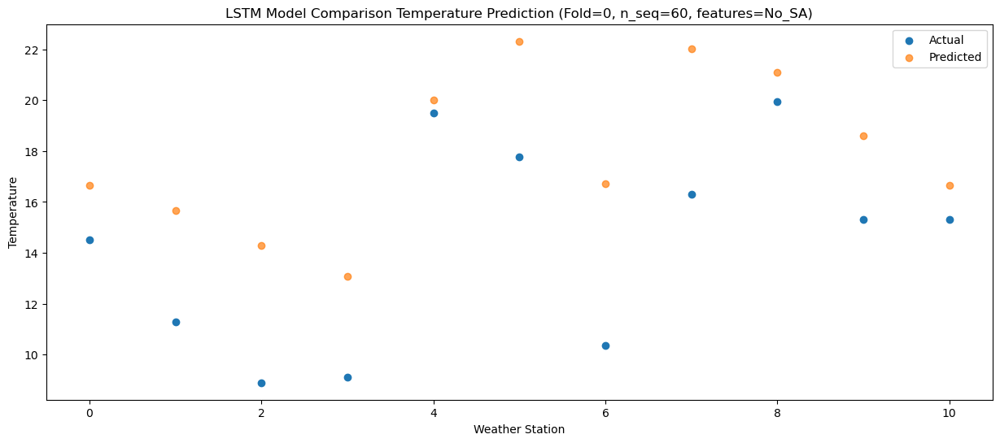

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    8.82   9.305530
1                 1    5.70   8.325533
2                 2    1.76   6.945534
3                 3    3.51   5.745531
4                 4   13.58  12.665526
5                 5   11.20  14.975531
6                 6    3.43   9.365531
7                 7    9.11  14.685527
8                 8   13.40  13.755529
9                 9    8.28  11.245522
10               10    8.08   9.305527


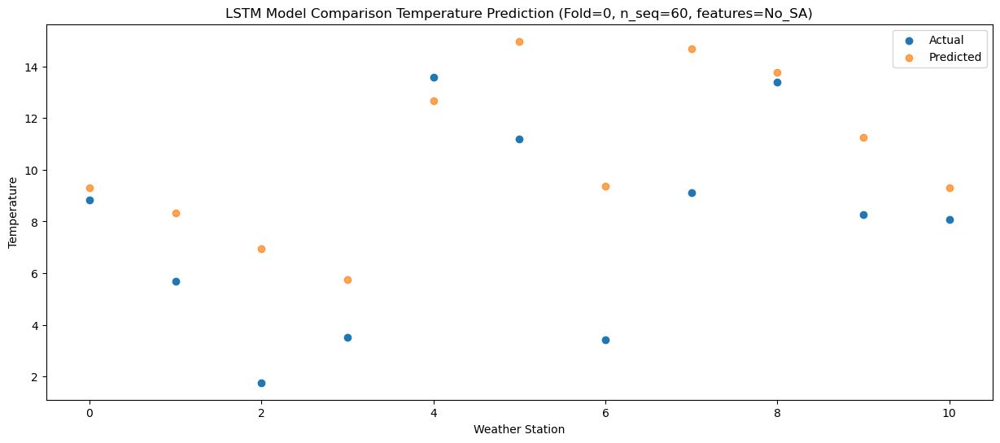

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.87   2.486078
1                 1    3.01   1.506081
2                 2   -0.72   0.126082
3                 3   -0.60  -1.073921
4                 4    6.65   5.846074
5                 5    9.51   8.156079
6                 6    1.20   2.546079
7                 7    6.91   7.866076
8                 8    7.43   6.936078
9                 9    3.26   4.426071
10               10    3.05   2.486076


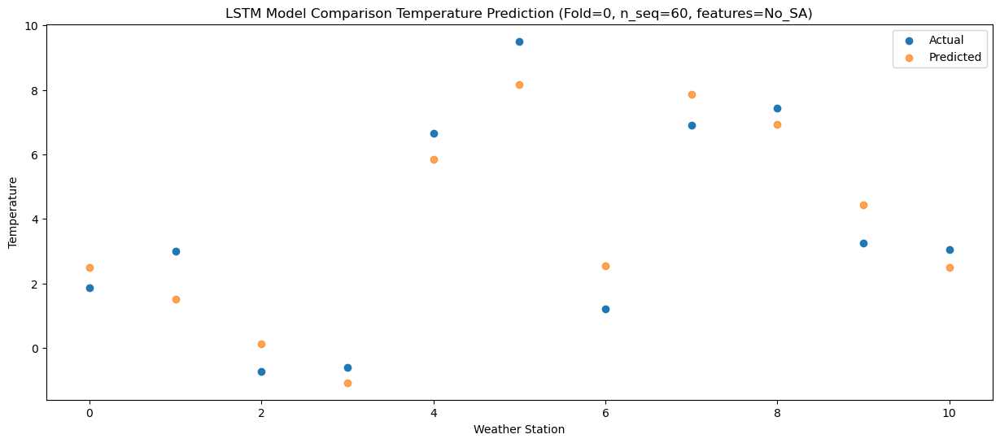

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -0.22  -1.865460
1                 1   -0.84  -2.845457
2                 2   -5.24  -4.225456
3                 3   -2.78  -5.425459
4                 4    3.92   1.494536
5                 5    2.99   3.804541
6                 6   -5.31  -1.805459
7                 7   -0.26   3.514538
8                 8    2.14   2.584540
9                 9   -2.45   0.074533
10               10   -3.13  -1.865462


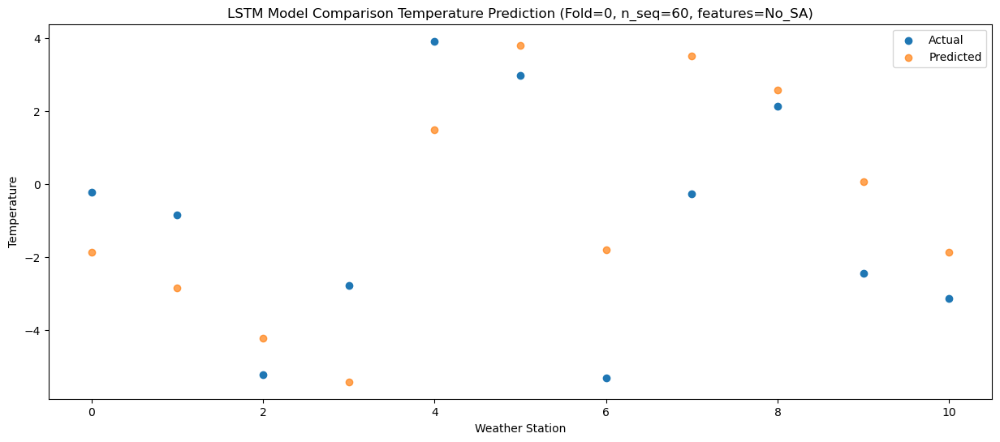

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.42  -0.121075
1                 1   -0.05  -1.101073
2                 2   -3.29  -2.481072
3                 3   -1.34  -3.681074
4                 4    4.89   3.238920
5                 5    4.68   5.548926
6                 6   -2.12  -0.061074
7                 7    2.91   5.258923
8                 8    4.70   4.328925
9                 9   -0.56   1.818918
10               10   -2.00  -0.121077


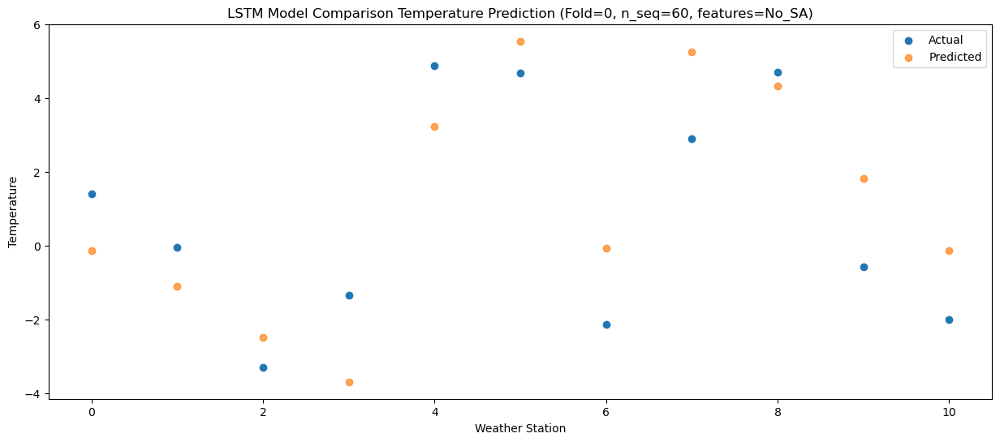

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.95   1.221966
1                 1    1.05   0.241969
2                 2   -0.51  -1.138030
3                 3   -0.93  -2.338033
4                 4    5.02   4.581962
5                 5    6.17   6.891967
6                 6    0.88   1.281967
7                 7    5.88   6.601964
8                 8    6.31   5.671966
9                 9    1.48   3.161959
10               10   -1.59   1.221964


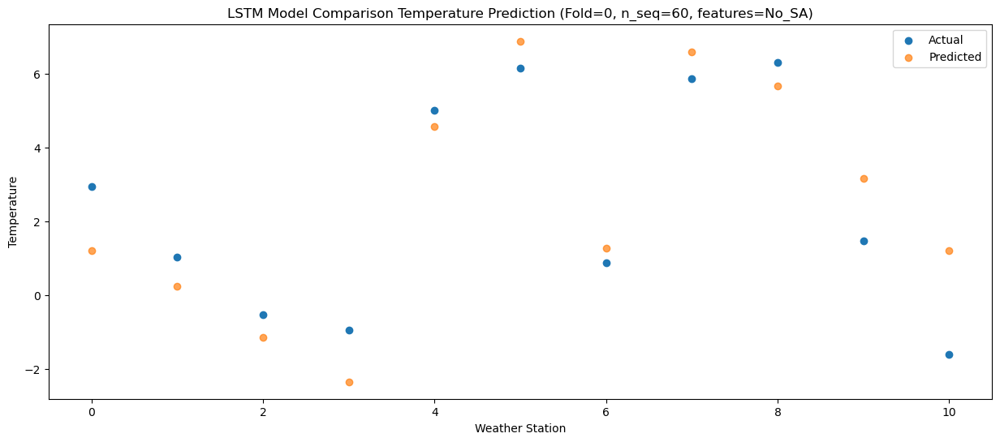

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    5.32   3.392660
1                 1    2.64   2.412663
2                 2   -0.53   1.032664
3                 3    2.59  -0.167339
4                 4    9.74   6.752656
5                 5    7.08   9.062661
6                 6    1.36   3.452661
7                 7    6.56   8.772658
8                 8    8.13   7.842660
9                 9    1.82   5.332653
10               10    0.27   3.392658


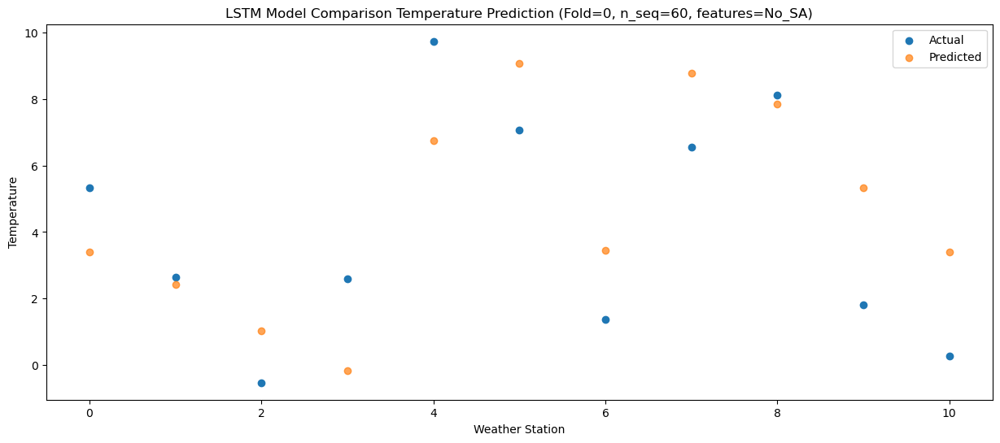

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.94   8.721568
1                 1    4.79   7.741571
2                 2    2.54   6.361572
3                 3    4.01   5.161569
4                 4   11.24  12.081564
5                 5   11.76  14.391569
6                 6    4.92   8.781569
7                 7   11.18  14.101566
8                 8   13.91  13.171568
9                 9    8.10  10.661561
10               10    7.12   8.721566


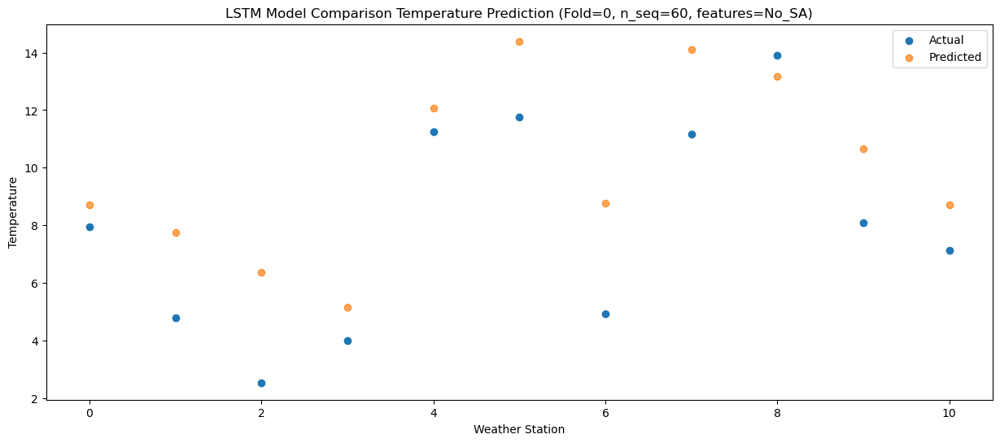

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.41  14.167074
1                 1    7.97  13.187077
2                 2    5.95  11.807078
3                 3    8.44  10.607075
4                 4   16.77  17.527070
5                 5   13.28  19.837075
6                 6    7.61  14.227075
7                 7   13.47  19.547072
8                 8   19.50  18.617074
9                 9   13.06  16.107067
10               10   12.14  14.167072


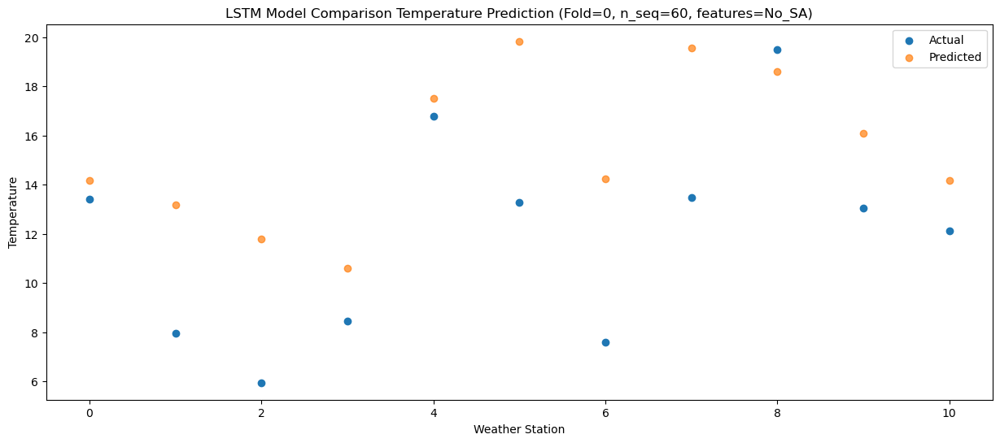

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   17.19  17.500418
1                 1   11.05  16.520421
2                 2    9.27  15.140422
3                 3   12.19  13.940419
4                 4   21.32  20.860414
5                 5   17.10  23.170419
6                 6   10.96  17.560419
7                 7   17.22  22.880416
8                 8   23.37  21.950418
9                 9   16.90  19.440411
10               10   17.65  17.500416


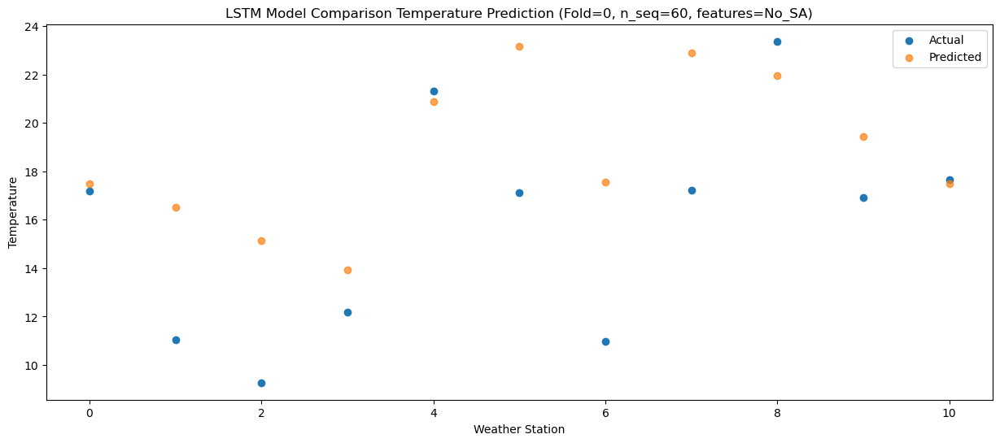

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.73  20.645554
1                 1   12.88  19.665556
2                 2   12.37  18.285557
3                 3   13.31  17.085555
4                 4   24.31  24.005549
5                 5   20.93  26.315555
6                 6   14.67  20.705555
7                 7   21.36  26.025551
8                 8   24.86  25.095554
9                 9   19.73  22.585546
10               10   20.11  20.645551


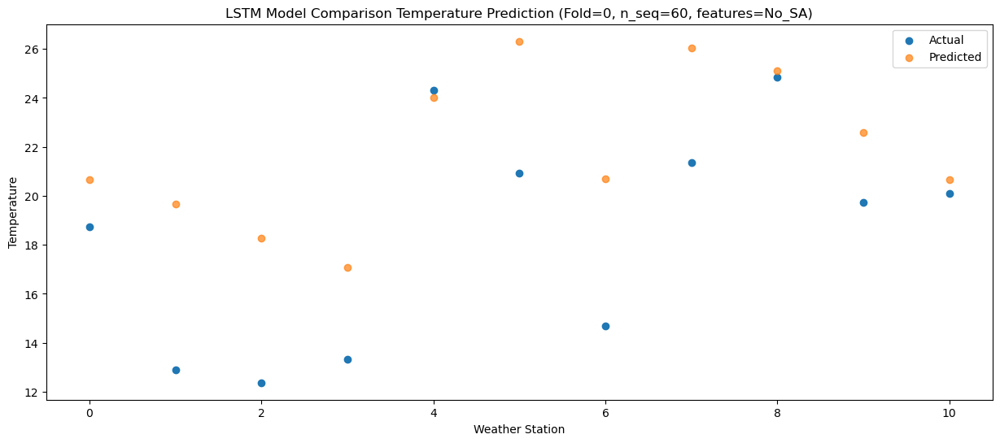

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   19.45  20.318717
1                 1   14.47  19.338719
2                 2   11.98  17.958720
3                 3   14.84  16.758717
4                 4   26.05  23.678712
5                 5   20.45  25.988717
6                 6   13.98  20.378717
7                 7   20.22  25.698714
8                 8   23.60  24.768716
9                 9   18.93  22.258709
10               10   18.30  20.318714


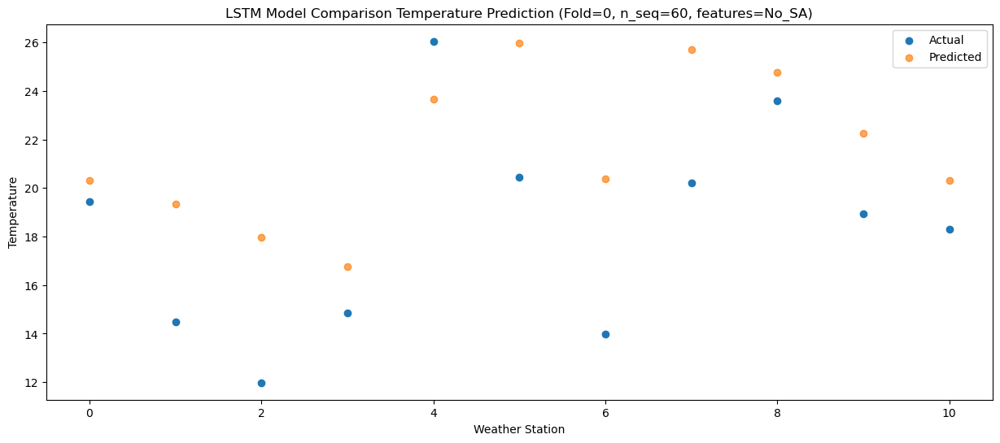

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   15.22  16.625356
1                 1   11.09  15.645359
2                 2    8.53  14.265360
3                 3   11.40  13.065358
4                 4   21.57  19.985352
5                 5   16.93  22.295358
6                 6   10.47  16.685358
7                 7   16.46  22.005355
8                 8   20.43  21.075356
9                 9   16.32  18.565349
10               10   15.92  16.625354


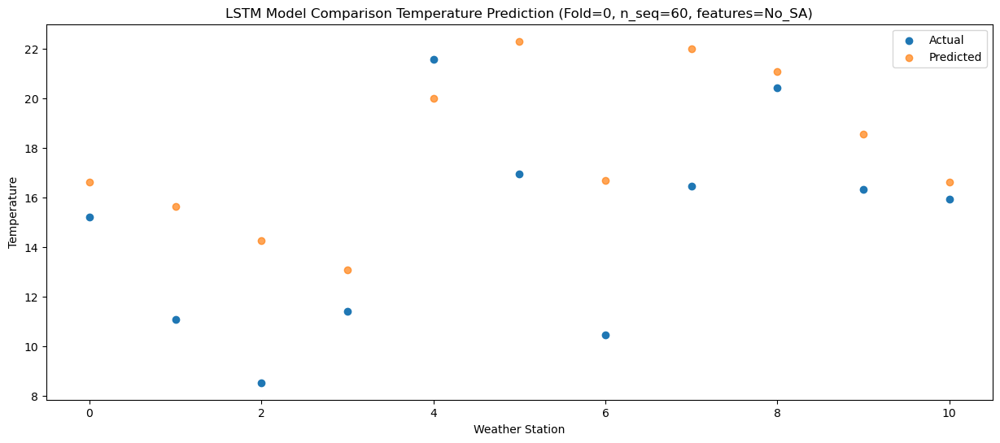

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   10.16  10.317717
1                 1    5.98   9.337721
2                 2    2.55   7.957721
3                 3    5.15   6.757719
4                 4   13.91  13.677713
5                 5   12.58  15.987719
6                 6    5.26  10.377719
7                 7   11.07  15.697716
8                 8   14.83  14.767717
9                 9    9.74  12.257709
10               10    9.96  10.317715


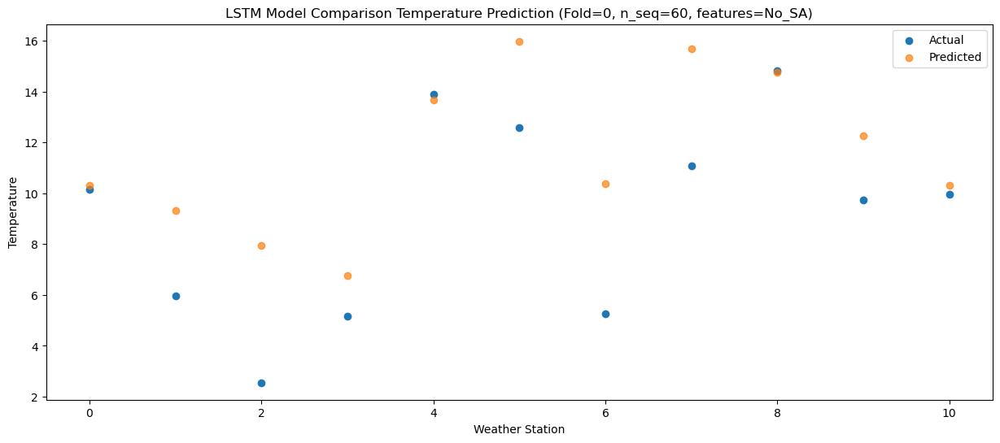

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.30   3.860530
1                 1    0.74   2.880534
2                 2   -2.54   1.500534
3                 3   -0.71   0.300532
4                 4    7.55   7.220526
5                 5    7.14   9.530532
6                 6   -0.61   3.920532
7                 7    4.62   9.240529
8                 8    7.84   8.310530
9                 9    3.24   5.800522
10               10    2.32   3.860528


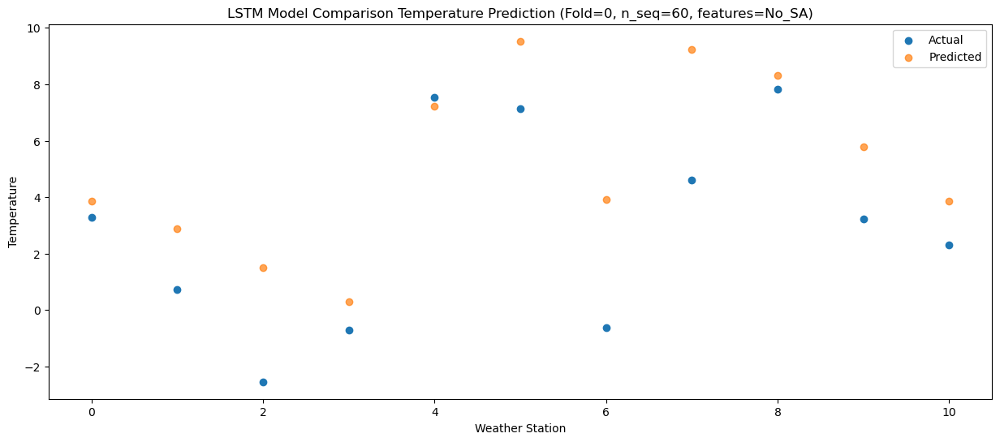

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.70   1.306115
1                 1   -1.96   0.326119
2                 2   -5.57  -1.053881
3                 3   -3.50  -2.253883
4                 4    4.76   4.666110
5                 5    5.00   6.976117
6                 6   -2.90   1.366117
7                 7    3.03   6.686114
8                 8    5.28   5.756115
9                 9    0.81   3.246107
10               10    1.64   1.306113


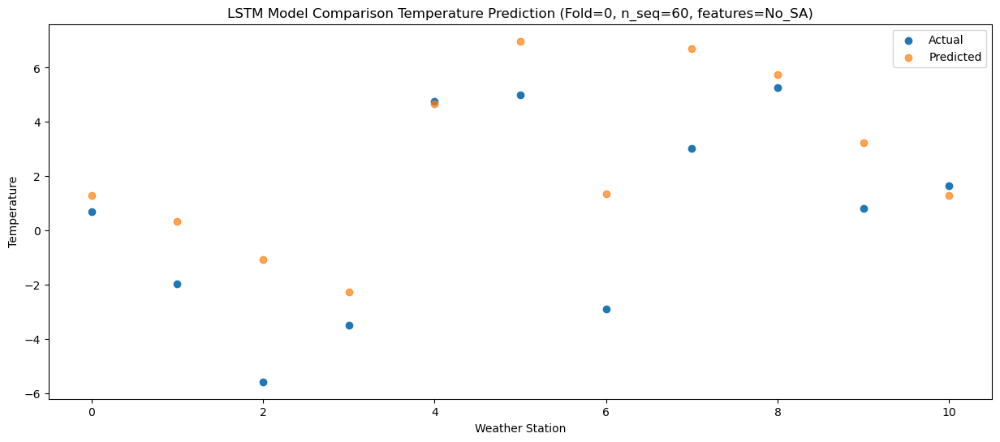

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.42  -3.745538
1                 1   -4.23  -4.725534
2                 2   -8.08  -6.105534
3                 3   -6.38  -7.305536
4                 4   -0.22  -0.385543
5                 5    3.73   1.924464
6                 6   -5.03  -3.685536
7                 7    0.33   1.634461
8                 8   -0.98   0.704462
9                 9   -4.95  -1.805546
10               10   -5.28  -3.745540


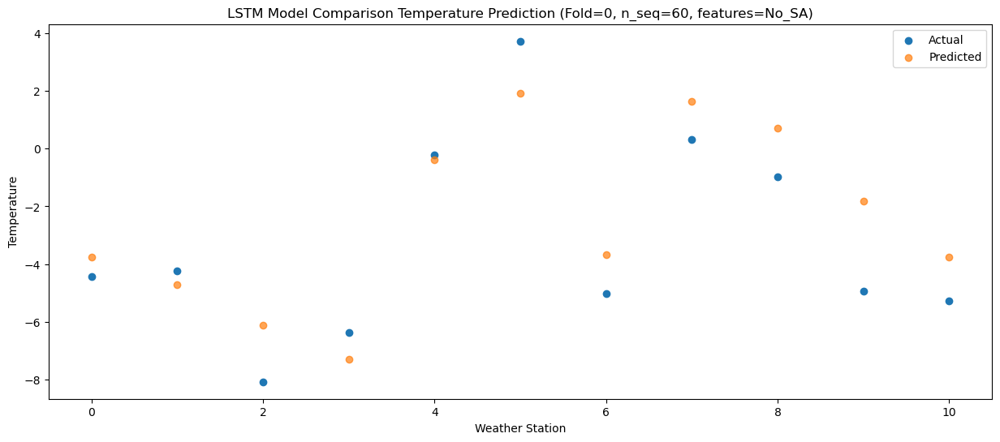

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    3.46   2.051345
1                 1   -1.73   1.071348
2                 2   -3.57  -0.308652
3                 3   -1.73  -1.508654
4                 4    7.65   5.411339
5                 5    4.25   7.721346
6                 6   -1.47   2.111346
7                 7    3.47   7.431343
8                 8    7.64   6.501345
9                 9    1.19   3.991337
10               10   -0.27   2.051342


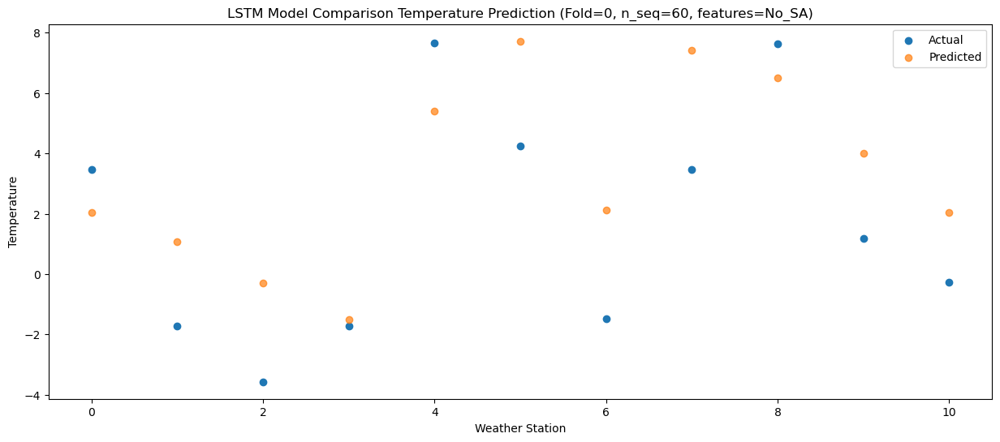

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    5.21   5.528595
1                 1    1.57   4.548599
2                 2    0.81   3.168599
3                 3    1.21   1.968597
4                 4   10.20   8.888590
5                 5    8.30  11.198597
6                 6    2.37   5.588597
7                 7    7.62  10.908594
8                 8   10.92   9.978595
9                 9    4.51   7.468587
10               10    3.23   5.528593


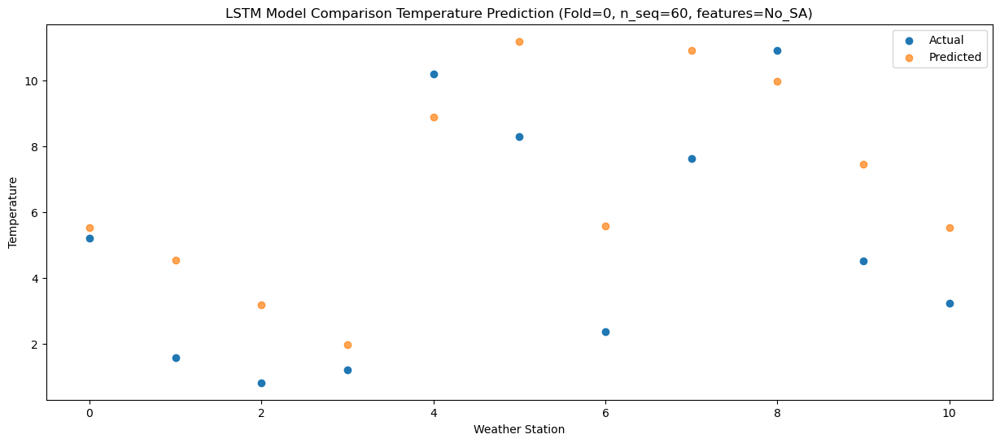

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.98  10.200024
1                 1    4.45   9.220028
2                 2    4.50   7.840028
3                 3    4.78   6.640026
4                 4   13.47  13.560019
5                 5   11.52  15.870026
6                 6    5.96  10.260026
7                 7   12.10  15.580023
8                 8   15.80  14.650024
9                 9    9.73  12.140016
10               10    8.57  10.200022


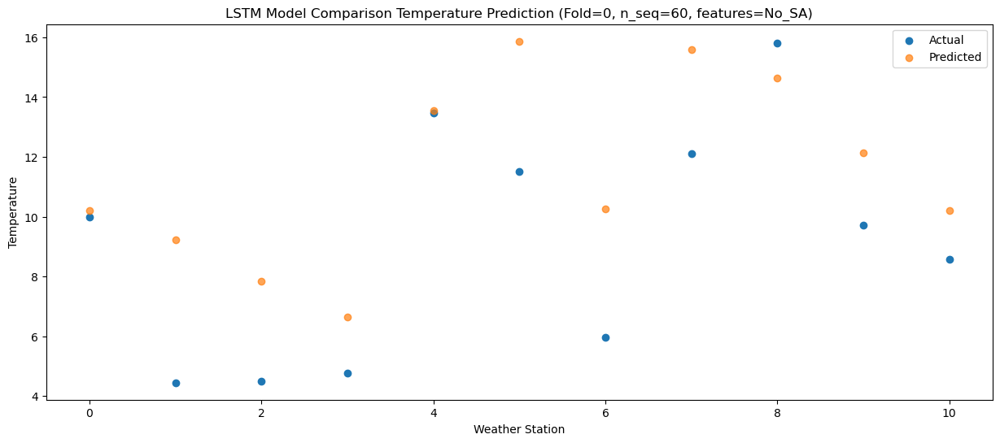

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.89  14.666667
1                 1    8.94  13.686671
2                 2    8.98  12.306671
3                 3    9.17  11.106669
4                 4   18.05  18.026662
5                 5   16.33  20.336669
6                 6    9.96  14.726669
7                 7   16.06  20.046666
8                 8   20.87  19.116667
9                 9   15.53  16.606659
10               10   15.54  14.666665


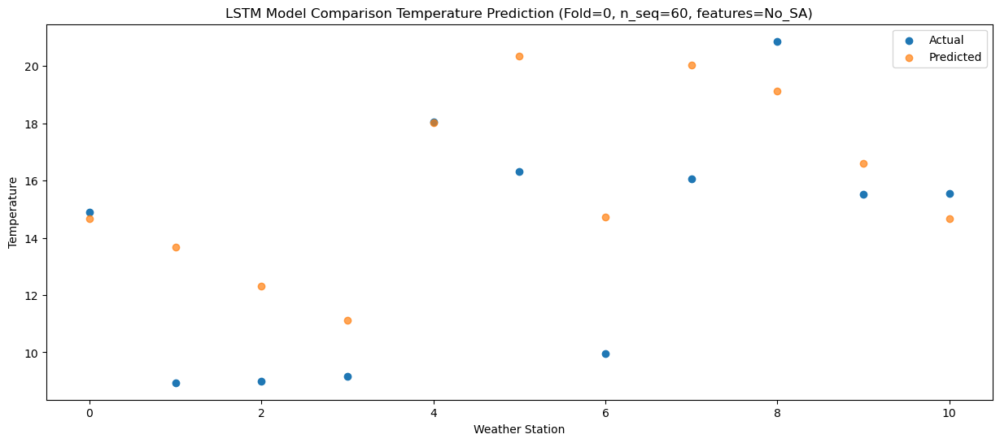

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.50  19.306267
1                 1   11.87  18.326269
2                 2   13.22  16.946269
3                 3   11.29  15.746267
4                 4   21.55  22.666262
5                 5   19.76  24.976267
6                 6   13.87  19.366267
7                 7   20.08  24.686264
8                 8   23.80  23.756267
9                 9   19.29  21.246257
10               10   19.86  19.306263


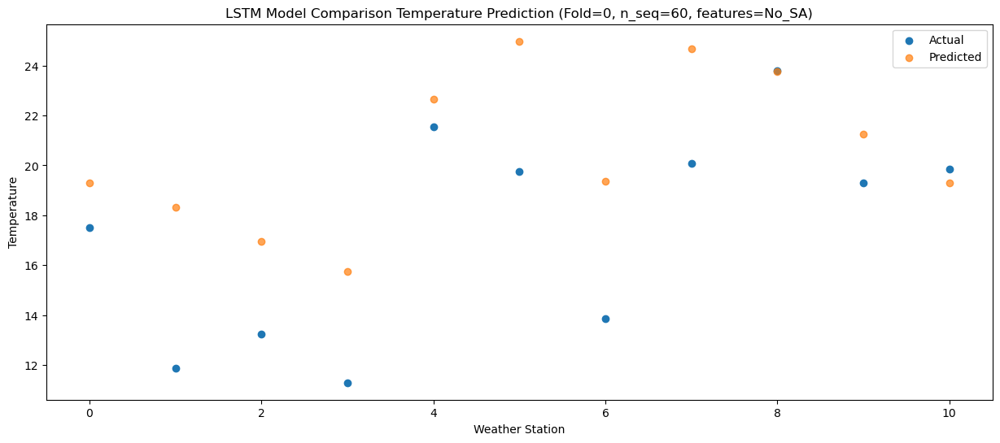

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.38  20.143263
1                 1   13.00  19.163264
2                 2   13.49  17.783264
3                 3   11.23  16.583262
4                 4   21.41  23.503257
5                 5   21.42  25.813262
6                 6   15.13  20.203262
7                 7   21.30  25.523259
8                 8   24.35  24.593262
9                 9   20.13  22.083253
10               10   20.75  20.143259


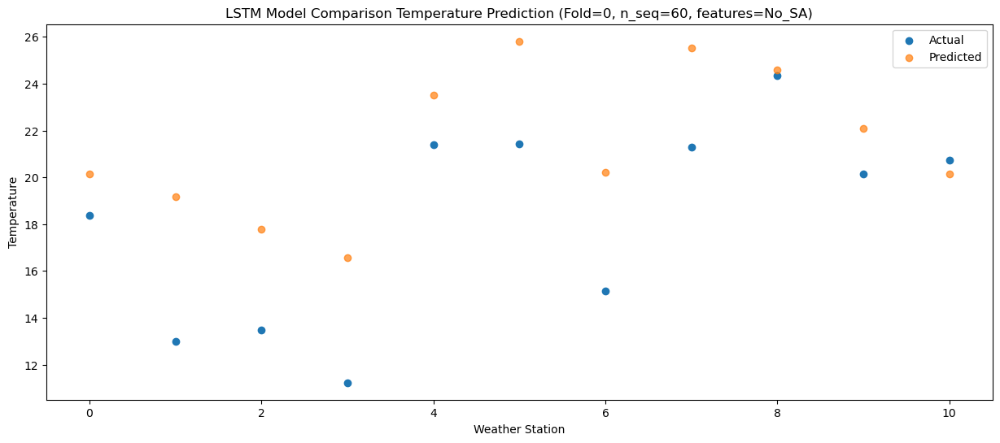

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.72  20.195229
1                 1   13.39  19.215231
2                 2   11.81  17.835231
3                 3   12.04  16.635229
4                 4   23.09  23.555224
5                 5   20.15  25.865229
6                 6   13.38  20.255229
7                 7   19.46  25.575226
8                 8   24.29  24.645229
9                 9   19.80  22.135219
10               10   20.00  20.195225


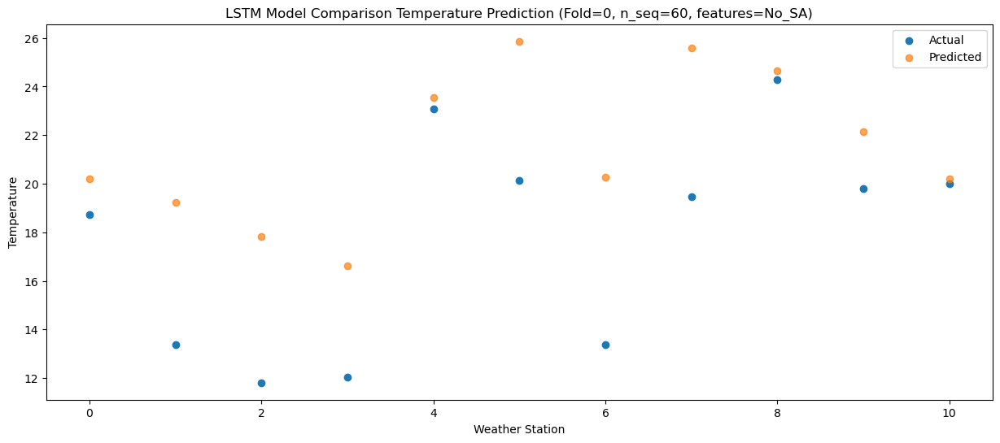

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.58  17.073530
1                 1   10.15  16.093532
2                 2    9.04  14.713532
3                 3    9.45  13.513530
4                 4   19.17  20.433524
5                 5   18.21  22.743530
6                 6   10.95  17.133530
7                 7   16.53  22.453527
8                 8   20.67  21.523530
9                 9   17.61  19.013520
10               10   17.22  17.073526


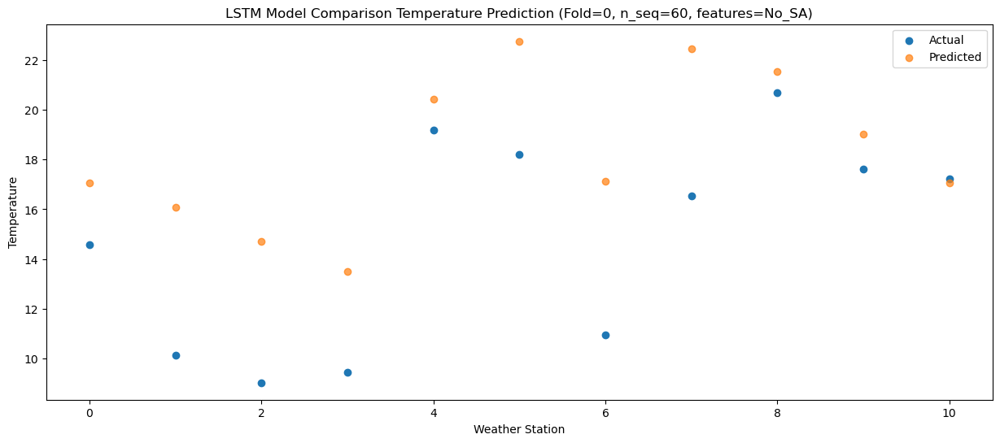

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   11.31  11.964546
1                 1    6.83  10.984548
2                 2    3.14   9.604548
3                 3    5.31   8.404546
4                 4   16.72  15.324540
5                 5   13.18  17.634546
6                 6    5.68  12.024546
7                 7   10.70  17.344543
8                 8   15.24  16.414546
9                 9   10.87  13.904536
10               10   10.99  11.964542


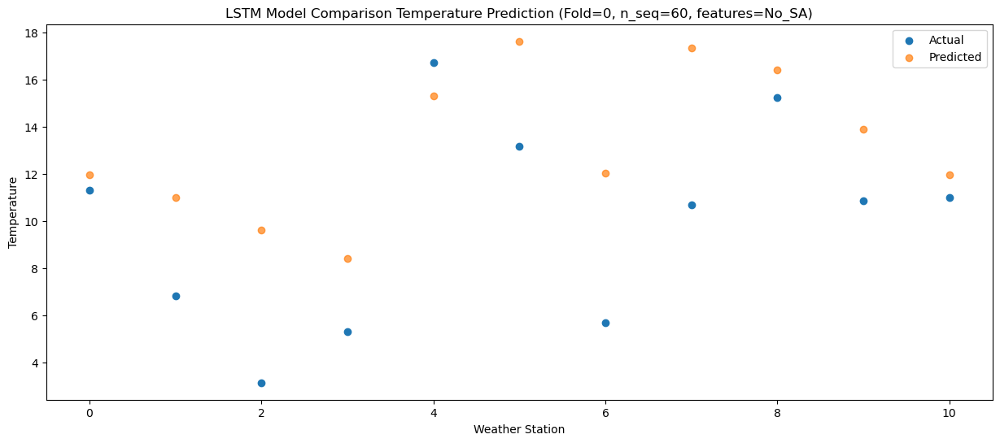

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (1, 1, 512)               4767744   
                                                                 
 dropout_10 (Dropout)        (1, 1, 512)               0         
                                                                 
 lstm_11 (LSTM)              (1, 512)                  2099200   
                                                                 
 dropout_11 (Dropout)        (1, 512)                  0         
                                                                 
 dense_15 (Dense)            (1, 256)                  131328    
                                                                 
 dense_16 (Dense)            (1, 128)                  32896     
                                                                 
 dense_17 (Dense)            (1, 60)                  

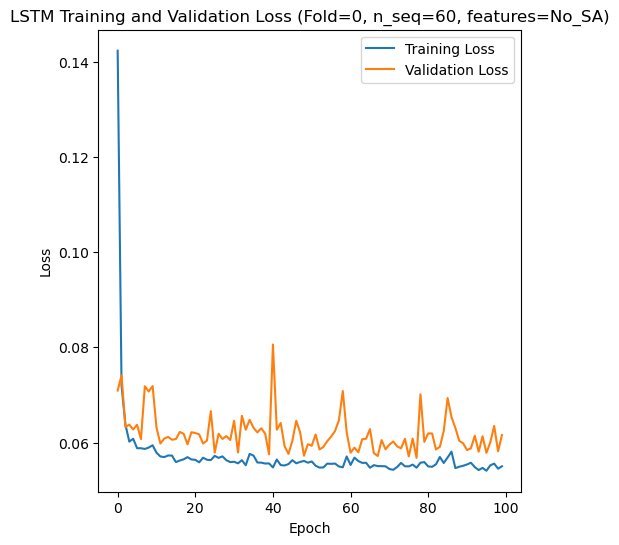

Epoch 1/100
84/84 [==============================] - 14s 105ms/step - loss: 0.1407 - accuracy: 0.2500 - mae: 0.1149 - rmse: 0.1407 - mape: inf - pearson: 0.5940 - val_loss: 0.0711 - val_accuracy: 0.2000 - val_mae: 0.0557 - val_rmse: 0.0711 - val_mape: 13.1803 - val_pearson: 0.8104
Epoch 2/100
84/84 [==============================] - 5s 62ms/step - loss: 0.0749 - accuracy: 0.4762 - mae: 0.0599 - rmse: 0.0749 - mape: inf - pearson: 0.8107 - val_loss: 0.0697 - val_accuracy: 0.0000e+00 - val_mae: 0.0556 - val_rmse: 0.0697 - val_mape: 12.0717 - val_pearson: 0.8288
Epoch 3/100
84/84 [==============================] - 5s 55ms/step - loss: 0.0633 - accuracy: 0.4881 - mae: 0.0501 - rmse: 0.0633 - mape: inf - pearson: 0.8268 - val_loss: 0.0655 - val_accuracy: 0.0000e+00 - val_mae: 0.0505 - val_rmse: 0.0655 - val_mape: 11.3589 - val_pearson: 0.8276
Epoch 4/100
84/84 [==============================] - 4s 47ms/step - loss: 0.0609 - accuracy: 0.4286 - mae: 0.0480 - rmse: 0.0609 - mape: inf - pearson

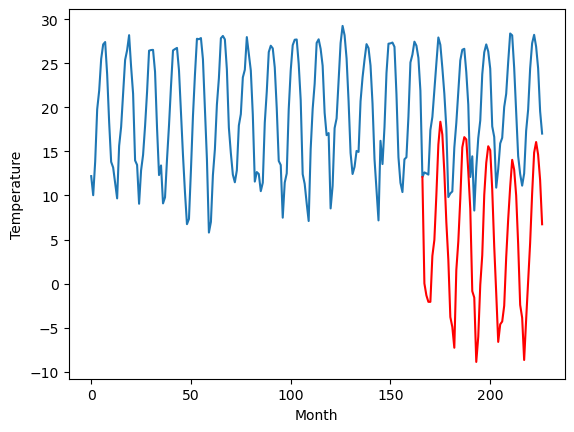

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.99		-1.42		-0.43
-1.90		-2.78		-0.88
-3.01		-3.51		-0.50
-2.92		-3.51		-0.59
3.08		1.70		-1.38
4.30		3.52		-0.78
7.65		8.62		0.97
12.00		14.35		2.35
15.37		16.95		1.58
13.96		15.49		1.53
10.42		11.19		0.77
6.70		5.53		-1.17
2.60		1.26		-1.34
-4.29		-5.24		-0.95
-4.49		-6.37		-1.88
-3.83		-8.72		-4.89
2.94		0.09		-2.85
5.08		3.35		-1.73
8.81		8.22		-0.59
12.95		14.04		1.09
14.33		15.20		0.87
14.60		14.94		0.34
10.86		11.30		0.44
7.08		7.06		-0.02
-0.58		-2.29		-1.71
1.05		-3.03		-4.08
-5.68		-10.33		-4.65
-1.45		-7.47		-6.02
2.12		-1.60		-3.72
5.12		1.78		-3.34
11.00		8.63		-2.37
14.97		12.28		-2.69
15.47		14.16		-1.31
14.01		13.71		-0.30
10.92		9.24		-1.68
4.58		2.77		-1.81
1.58		-2.51		-4.09
-4.23		-8.06		-3.83
-2.04		-6.07		-4.03
1.33		-5.74		-7.07
2.10		-3.96		-6.06
5.37		1.54		-3.83
8.65		5.88		-2.77
11.84		9.56		-2.28
15.44		12.62		-2.82
14.90		11.48		-3.42
11.39		8.57		-2.82
6.38		3.

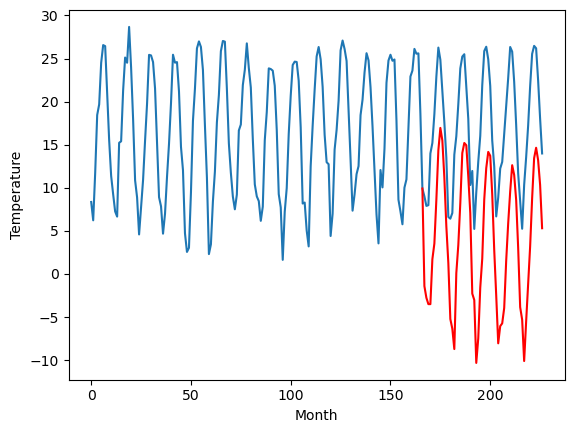

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.90		-0.18		0.72
-0.47		-1.54		-1.07
-1.00		-2.27		-1.27
-0.72		-2.27		-1.55
6.38		2.94		-3.44
5.41		4.76		-0.65
9.56		9.86		0.30
13.79		15.59		1.80
15.26		18.19		2.93
15.25		16.73		1.48
12.45		12.43		-0.02
8.10		6.77		-1.33
3.30		2.50		-0.80
-3.76		-4.00		-0.24
-3.34		-5.13		-1.79
-2.85		-7.48		-4.63
4.21		1.33		-2.88
5.61		4.59		-1.02
9.73		9.46		-0.27
13.61		15.28		1.67
14.38		16.44		2.06
15.04		16.18		1.14
12.02		12.54		0.52
8.24		8.30		0.06
0.50		-1.05		-1.55
3.10		-1.79		-4.89
-3.79		-9.09		-5.30
-0.44		-6.23		-5.79
3.56		-0.36		-3.92
7.15		3.02		-4.13
12.51		9.87		-2.64
15.48		13.52		-1.96
16.19		15.40		-0.79
14.58		14.95		0.37
12.19		10.48		-1.71
5.50		4.01		-1.49
2.18		-1.27		-3.45
-0.98		-6.82		-5.84
0.02		-4.83		-4.85
2.61		-4.50		-7.11
4.04		-2.72		-6.76
6.73		2.78		-3.95
9.97		7.12		-2.85
13.72		10.80		-2.92
16.09		13.86		-2.23
16.53		12.72		-3.81
13.57		9.81		-3.76
7.53		4.26	

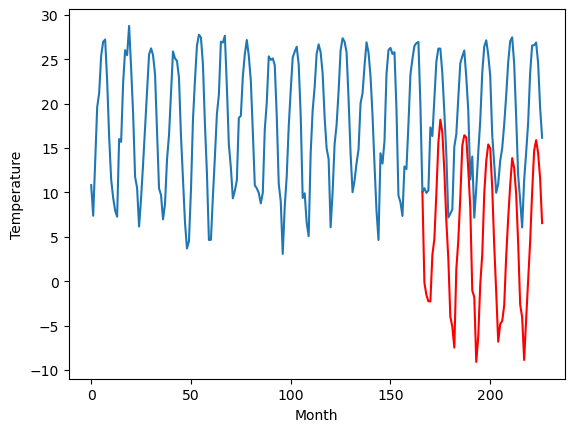

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.19		-1.15		-2.34
-0.23		-2.51		-2.28
0.52		-3.24		-3.76
-0.01		-3.24		-3.23
7.63		1.97		-5.66
7.51		3.79		-3.72
11.26		8.89		-2.37
14.04		14.62		0.58
15.69		17.22		1.53
15.93		15.76		-0.17
12.52		11.46		-1.06
7.98		5.80		-2.18
5.08		1.53		-3.55
-1.10		-4.97		-3.87
-1.20		-6.10		-4.90
-2.79		-8.45		-5.66
4.58		0.36		-4.22
6.92		3.62		-3.30
10.81		8.49		-2.32
14.70		14.31		-0.39
14.58		15.47		0.89
15.55		15.21		-0.34
12.54		11.57		-0.97
9.85		7.33		-2.52
2.69		-2.02		-4.71
6.06		-2.76		-8.82
-1.99		-10.06		-8.07
-2.46		-7.20		-4.74
3.38		-1.33		-4.71
9.38		2.05		-7.33
13.81		8.90		-4.91
16.81		12.55		-4.26
17.75		14.43		-3.32
16.11		13.98		-2.13
13.34		9.51		-3.83
7.78		3.04		-4.74
2.73		-2.24		-4.97
0.64		-7.79		-8.43
1.35		-5.80		-7.15
2.35		-5.47		-7.82
6.18		-3.69		-9.87
7.02		1.81		-5.21
11.61		6.15		-5.46
15.76		9.83		-5.93
17.48		12.89		-4.59
19.45		11.75		-7.70
16.37		8.84		-7.53
9.11

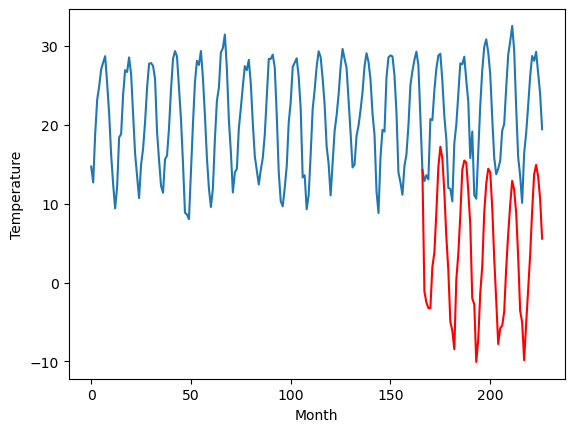

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.60		3.09		-2.51
3.71		1.73		-1.98
4.52		1.00		-3.52
4.14		1.00		-3.14
12.18		6.21		-5.97
11.92		8.03		-3.89
15.72		13.13		-2.59
18.75		18.86		0.11
20.79		21.46		0.67
21.03		20.00		-1.03
17.45		15.70		-1.75
12.51		10.04		-2.47
9.41		5.77		-3.64
3.05		-0.73		-3.78
3.04		-1.86		-4.90
1.34		-4.21		-5.55
8.95		4.60		-4.35
11.25		7.86		-3.39
15.37		12.73		-2.64
18.84		18.55		-0.29
18.93		19.71		0.78
19.90		19.45		-0.45
16.32		15.81		-0.51
13.28		11.57		-1.71
5.73		2.22		-3.51
9.61		1.48		-8.13
1.13		-5.82		-6.95
0.82		-2.96		-3.78
6.60		2.91		-3.69
12.87		6.29		-6.58
17.49		13.14		-4.35
20.86		16.79		-4.07
21.95		18.67		-3.28
19.94		18.22		-1.72
16.76		13.75		-3.01
11.37		7.28		-4.09
6.37		2.00		-4.37
4.35		-3.55		-7.90
4.83		-1.56		-6.39
6.01		-1.23		-7.24
9.83		0.55		-9.28
10.79		6.05		-4.74
15.43		10.39		-5.04
20.32		14.07		-6.25
22.27		17.13		-5.14
23.70		15.99		-7.71
19.85		13.08		-6.77
12.4

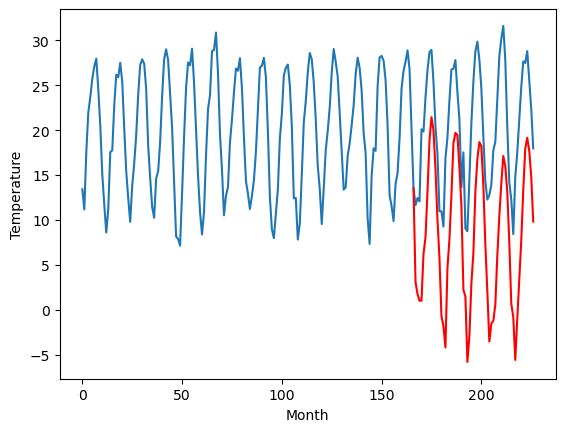

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.73		-0.76		-3.49
0.70		-2.12		-2.82
0.04		-2.85		-2.89
-0.48		-2.85		-2.37
6.87		2.36		-4.51
9.66		4.18		-5.48
14.85		9.28		-5.57
17.57		15.01		-2.56
20.27		17.61		-2.66
20.12		16.15		-3.97
12.59		11.85		-0.74
9.75		6.19		-3.56
6.03		1.92		-4.11
-0.72		-4.58		-3.86
-2.23		-5.71		-3.48
-1.85		-8.06		-6.21
5.49		0.75		-4.74
7.76		4.01		-3.75
13.35		8.88		-4.47
17.62		14.70		-2.92
16.96		15.86		-1.10
16.37		15.60		-0.77
16.01		11.96		-4.05
11.69		7.72		-3.97
5.22		-1.63		-6.85
5.48		-2.37		-7.85
-1.84		-9.67		-7.83
-1.95		-6.81		-4.86
5.00		-0.94		-5.94
11.91		2.44		-9.47
17.31		9.29		-8.02
19.37		12.94		-6.43
20.29		14.82		-5.47
17.44		14.37		-3.07
14.39		9.90		-4.49
8.31		3.43		-4.88
1.35		-1.85		-3.20
0.23		-7.40		-7.63
0.69		-5.41		-6.10
0.83		-5.08		-5.91
5.89		-3.30		-9.19
9.05		2.20		-6.85
13.66		6.54		-7.12
20.35		10.22		-10.13
21.45		13.28		-8.17
20.64		12.14		-8.50
18.36		9.23		-9.13

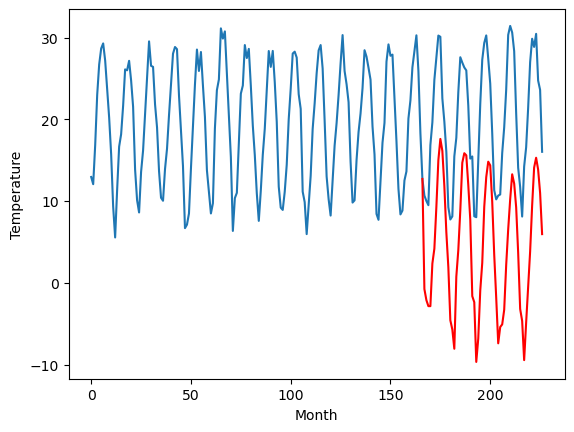

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.75		1.71		-0.04
1.02		0.35		-0.67
0.21		-0.38		-0.59
0.28		-0.38		-0.66
5.95		4.83		-1.12
7.58		6.65		-0.93
10.36		11.75		1.39
15.03		17.48		2.45
18.21		20.08		1.87
16.58		18.62		2.04
13.16		14.32		1.16
9.67		8.66		-1.01
5.52		4.39		-1.13
-1.69		-2.11		-0.42
-1.89		-3.24		-1.35
-1.11		-5.59		-4.48
5.17		3.22		-1.95
7.74		6.48		-1.26
11.51		11.35		-0.16
15.52		17.17		1.65
16.88		18.33		1.45
17.14		18.07		0.93
13.81		14.43		0.62
9.86		10.19		0.33
2.26		0.84		-1.42
3.78		0.10		-3.68
-2.61		-7.20		-4.59
1.20		-4.34		-5.54
5.04		1.53		-3.51
7.80		4.91		-2.89
13.72		11.76		-1.96
17.30		15.41		-1.89
18.04		17.29		-0.75
16.54		16.84		0.30
13.65		12.37		-1.28
7.31		5.90		-1.41
4.42		0.62		-3.80
-1.59		-4.93		-3.34
0.54		-2.94		-3.48
4.13		-2.61		-6.74
4.80		-0.83		-5.63
8.06		4.67		-3.39
11.06		9.01		-2.05
14.34		12.69		-1.65
17.79		15.75		-2.04
17.37		14.61		-2.76
14.20		11.70		-2.50
9.19		6.15		-3

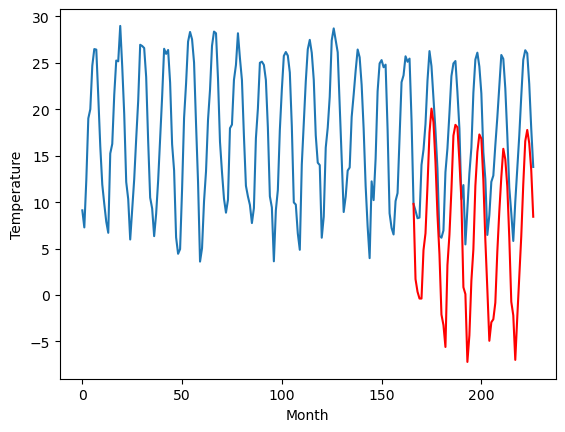

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.51		5.60		-0.91
5.89		4.24		-1.65
5.04		3.51		-1.53
5.72		3.51		-2.21
12.64		8.72		-3.92
13.78		10.54		-3.24
18.28		15.64		-2.64
23.84		21.37		-2.47
26.38		23.97		-2.41
24.36		22.51		-1.85
21.06		18.21		-2.85
14.29		12.55		-1.74
10.62		8.28		-2.34
4.02		1.78		-2.24
3.71		0.65		-3.06
0.71		-1.70		-2.41
12.03		7.11		-4.92
13.74		10.37		-3.37
18.40		15.24		-3.16
24.48		21.06		-3.42
25.47		22.22		-3.25
26.69		21.96		-4.73
22.98		18.32		-4.66
17.78		14.08		-3.70
8.48		4.73		-3.75
10.89		3.99		-6.90
2.06		-3.31		-5.37
4.11		-0.45		-4.56
10.06		5.42		-4.64
15.25		8.80		-6.45
20.72		15.65		-5.07
24.78		19.30		-5.48
28.91		21.18		-7.73
26.04		20.73		-5.31
22.20		16.26		-5.94
15.53		9.79		-5.74
8.93		4.51		-4.42
5.19		-1.04		-6.23
6.38		0.95		-5.43
7.88		1.28		-6.60
10.71		3.06		-7.65
15.11		8.56		-6.55
20.46		12.90		-7.56
24.27		16.58		-7.69
26.57		19.64		-6.93
27.07		18.50		-8.57
23.45		15.59		-7.8

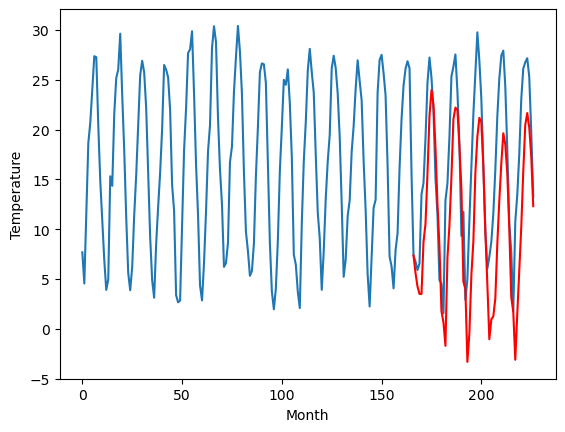

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.17		4.31		-1.86
4.32		2.95		-1.37
4.50		2.22		-2.28
3.99		2.22		-1.77
11.82		7.43		-4.39
13.20		9.25		-3.95
19.31		14.35		-4.96
24.42		20.08		-4.34
26.96		22.68		-4.28
26.03		21.22		-4.81
19.38		16.92		-2.46
13.20		11.26		-1.94
10.32		6.99		-3.33
3.64		0.49		-3.15
3.29		-0.64		-3.93
-1.49		-2.99		-1.50
11.07		5.82		-5.25
12.87		9.08		-3.79
17.68		13.95		-3.73
23.71		19.77		-3.94
25.22		20.93		-4.29
25.61		20.67		-4.94
23.10		17.03		-6.07
16.85		12.79		-4.06
9.10		3.44		-5.66
8.29		2.70		-5.59
0.67		-4.60		-5.27
1.65		-1.74		-3.39
8.90		4.13		-4.77
16.01		7.51		-8.50
21.37		14.36		-7.01
25.66		18.01		-7.65
29.81		19.89		-9.92
27.14		19.44		-7.70
23.31		14.97		-8.34
15.08		8.50		-6.58
7.23		3.22		-4.01
3.60		-2.33		-5.93
4.46		-0.34		-4.80
4.83		-0.01		-4.84
9.26		1.77		-7.49
13.59		7.27		-6.32
19.28		11.61		-7.67
24.21		15.29		-8.92
27.09		18.35		-8.74
28.90		17.21		-11.69
24.26		14.30		-9.9

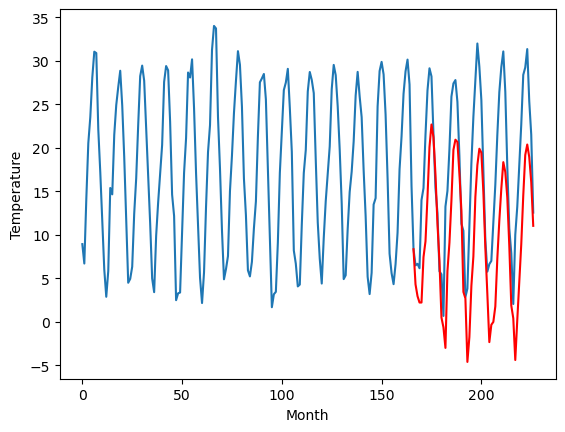

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.70		3.84		-4.86
7.34		2.48		-4.86
6.89		1.75		-5.14
5.65		1.75		-3.90
13.61		6.96		-6.65
15.92		8.78		-7.14
22.45		13.88		-8.57
28.83		19.61		-9.22
30.41		22.21		-8.20
29.18		20.75		-8.43
22.43		16.45		-5.98
15.83		10.79		-5.04
12.65		6.52		-6.13
5.38		0.02		-5.36
5.49		-1.11		-6.60
1.12		-3.46		-4.58
11.83		5.35		-6.48
15.59		8.61		-6.98
20.14		13.48		-6.66
27.25		19.30		-7.95
27.92		20.46		-7.46
27.77		20.20		-7.57
25.82		16.56		-9.26
18.38		12.32		-6.06
12.13		2.97		-9.16
10.52		2.23		-8.29
3.60		-5.07		-8.67
3.66		-2.21		-5.87
10.59		3.66		-6.93
17.07		7.04		-10.03
22.52		13.89		-8.63
27.09		17.54		-9.55
30.69		19.42		-11.27
27.86		18.97		-8.89
25.45		14.50		-10.95
16.91		8.03		-8.88
7.92		2.75		-5.17
5.57		-2.80		-8.37
5.85		-0.81		-6.66
7.00		-0.48		-7.48
10.73		1.30		-9.43
16.08		6.80		-9.28
21.19		11.14		-10.05
24.42		14.82		-9.60
29.04		17.88		-11.16
29.44		16.74		-12.70
25.92		13

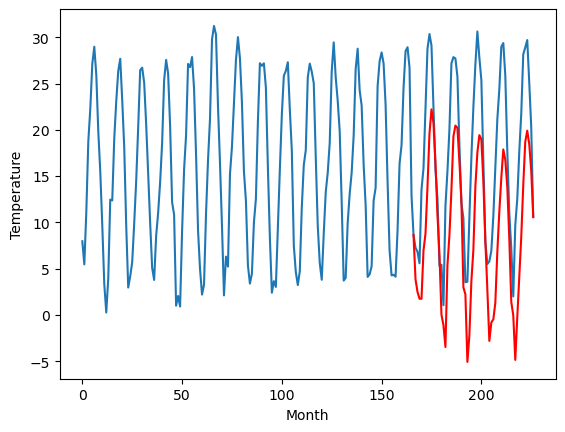

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.40		0.01		0.41
-3.21		-1.35		1.86
-2.87		-2.08		0.79
-2.13		-2.08		0.05
2.19		3.13		0.94
3.82		4.95		1.13
9.28		10.05		0.77
16.60		15.78		-0.82
20.47		18.38		-2.09
18.28		16.92		-1.36
13.75		12.62		-1.13
8.21		6.96		-1.25
4.01		2.69		-1.32
-3.00		-3.81		-0.81
-4.84		-4.94		-0.10
-5.80		-7.29		-1.49
1.42		1.52		0.10
6.07		4.78		-1.29
10.61		9.65		-0.96
16.70		15.47		-1.23
18.93		16.63		-2.30
18.71		16.37		-2.34
15.01		12.73		-2.28
10.59		8.49		-2.10
1.27		-0.86		-2.13
0.50		-1.60		-2.10
-6.52		-8.90		-2.38
-2.62		-6.04		-3.42
1.94		-0.17		-2.11
5.29		3.21		-2.08
12.27		10.06		-2.21
16.66		13.71		-2.95
20.60		15.59		-5.01
20.06		15.14		-4.92
15.15		10.67		-4.48
7.05		4.20		-2.85
3.54		-1.08		-4.62
-3.61		-6.63		-3.02
-0.65		-4.64		-3.99
-0.97		-4.31		-3.34
0.15		-2.53		-2.68
7.37		2.97		-4.40
9.93		7.31		-2.62
14.30		10.99		-3.31
19.44		14.05		-5.39
17.70		12.91		-4.79
14.51		10.00		-4.51
9

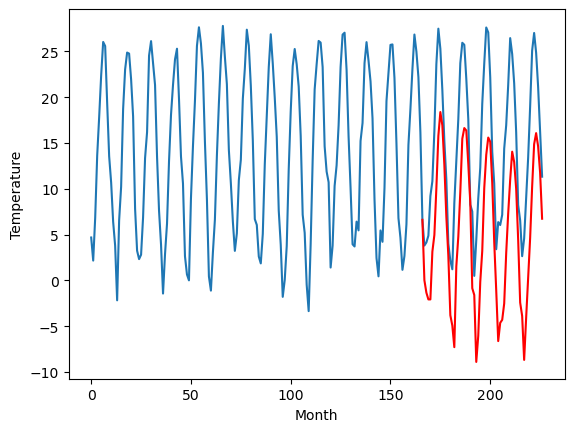

RangeIndex(start=1, stop=12, step=1)
[-0.6800000000000015, -0.9899999999999993, -0.9000000000000021, 1.1899999999999986, 5.599999999999998, 2.730000000000003, 1.7500000000000018, 6.510000000000002, 6.17, 8.7, -0.40000000000000036]
[0.010254020690917187, -1.4197459793090816, -0.17974597930908232, -1.149745979309082, 3.0902540206909173, -0.7597459793090824, 1.7102540206909183, 5.600254020690919, 4.310254020690918, 3.8402540206909173, 0.010254020690917187]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.68   0.010254
1                 1   -0.99  -1.419746
2                 2   -0.90  -0.179746
3                 3    1.19  -1.149746
4                 4    5.60   3.090254
5                 5    2.73  -0.759746
6                 6    1.75   1.710254
7                 7    6.51   5.600254
8                 8    6.17   4.310254
9                 9    8.70   3.840254
10               10   -0.40   0.010254


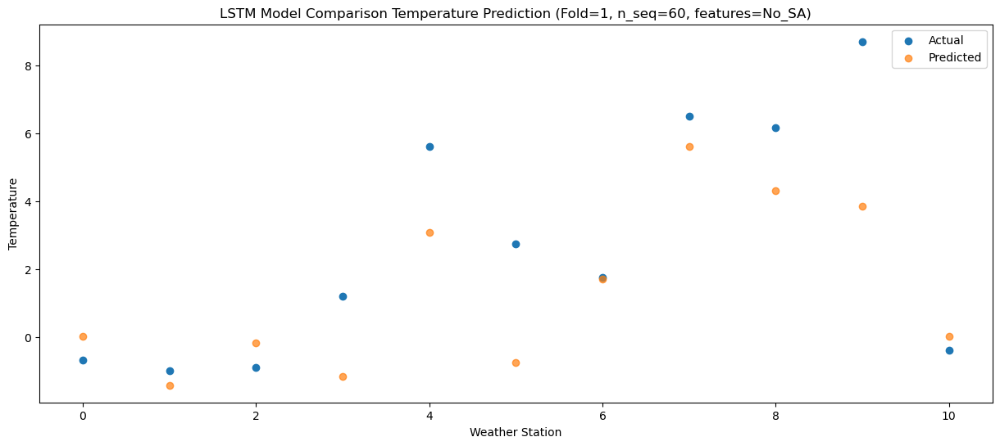

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.15  -1.345612
1                 1   -1.90  -2.775612
2                 2   -0.47  -1.535612
3                 3   -0.23  -2.505612
4                 4    3.71   1.734388
5                 5    0.70  -2.115612
6                 6    1.02   0.354388
7                 7    5.89   4.244388
8                 8    4.32   2.954389
9                 9    7.34   2.484389
10               10   -3.21  -1.345613


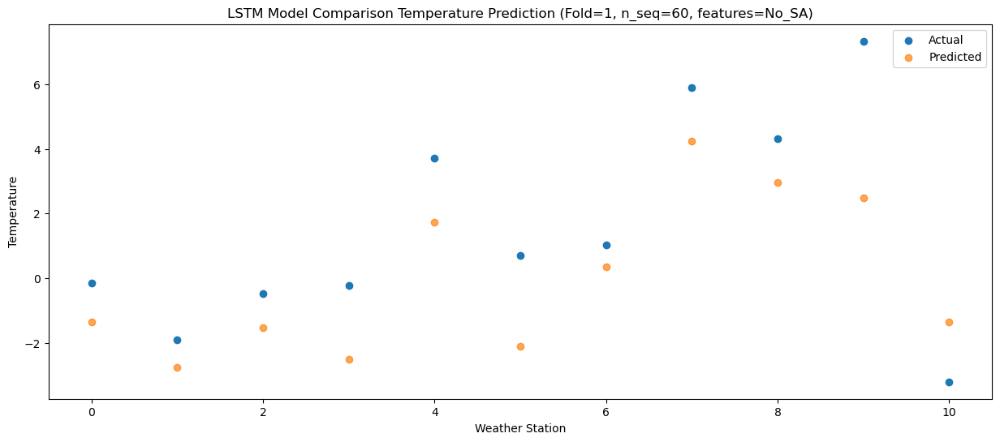

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -2.079663
1                 1   -3.01  -3.509663
2                 2   -1.00  -2.269663
3                 3    0.52  -3.239663
4                 4    4.52   1.000337
5                 5    0.04  -2.849663
6                 6    0.21  -0.379663
7                 7    5.04   3.510337
8                 8    4.50   2.220338
9                 9    6.89   1.750338
10               10   -2.87  -2.079664


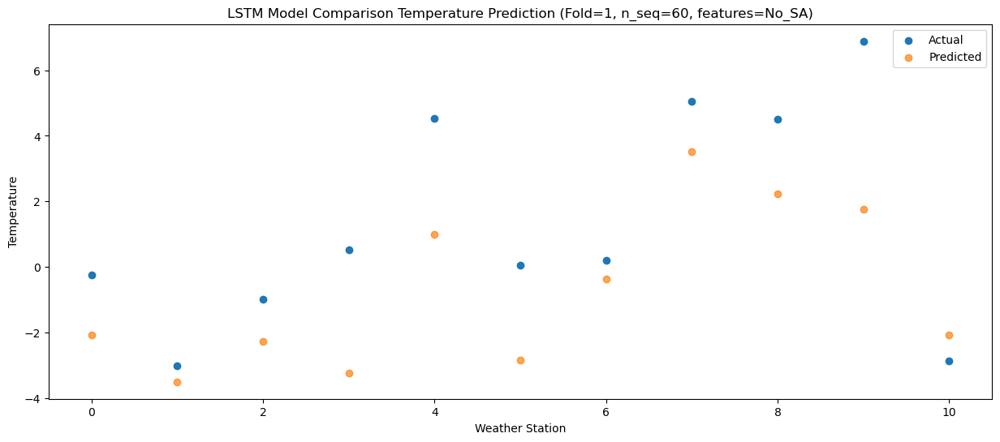

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.40  -2.082027
1                 1   -2.92  -3.512027
2                 2   -0.72  -2.272027
3                 3   -0.01  -3.242029
4                 4    4.14   0.997971
5                 5   -0.48  -2.852027
6                 6    0.28  -0.382029
7                 7    5.72   3.507973
8                 8    3.99   2.217974
9                 9    5.65   1.747974
10               10   -2.13  -2.082028


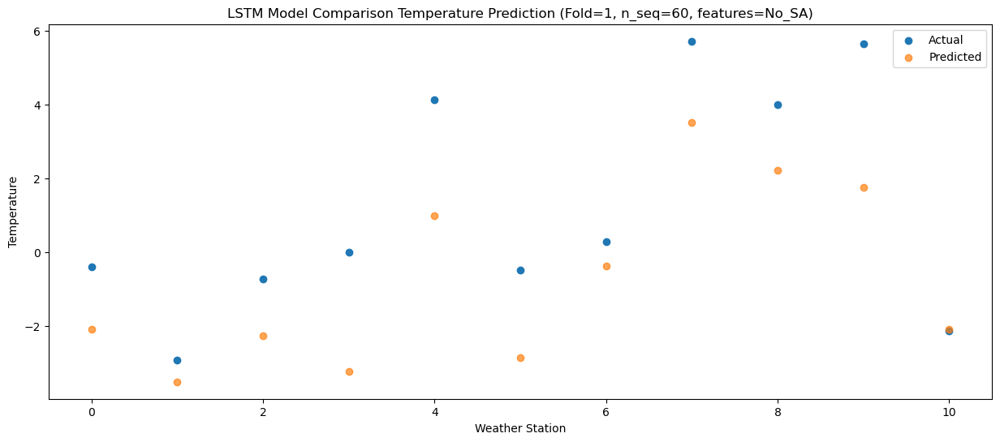

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.66   3.134098
1                 1    3.08   1.704098
2                 2    6.38   2.944100
3                 3    7.63   1.974098
4                 4   12.18   6.214098
5                 5    6.87   2.364100
6                 6    5.95   4.834098
7                 7   12.64   8.724100
8                 8   11.82   7.434101
9                 9   13.61   6.964101
10               10    2.19   3.134099


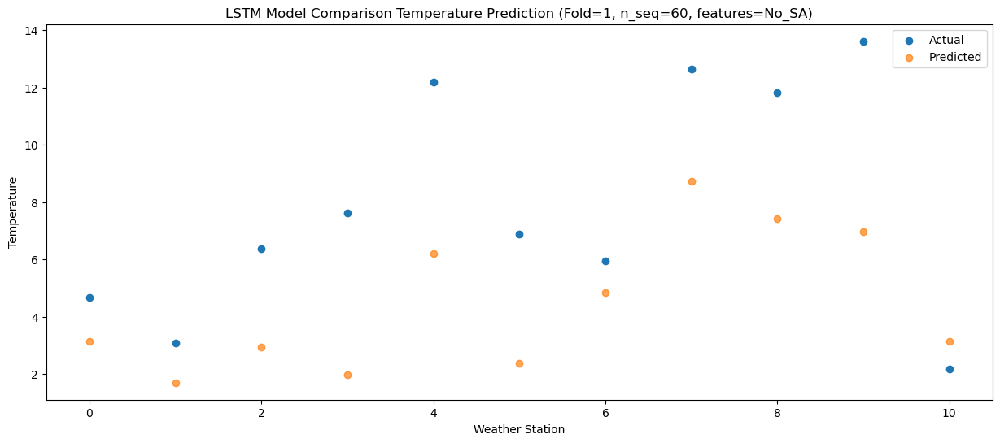

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.15   4.949069
1                 1    4.30   3.519069
2                 2    5.41   4.759071
3                 3    7.51   3.789069
4                 4   11.92   8.029069
5                 5    9.66   4.179071
6                 6    7.58   6.649067
7                 7   13.78  10.539069
8                 8   13.20   9.249070
9                 9   15.92   8.779070
10               10    3.82   4.949070


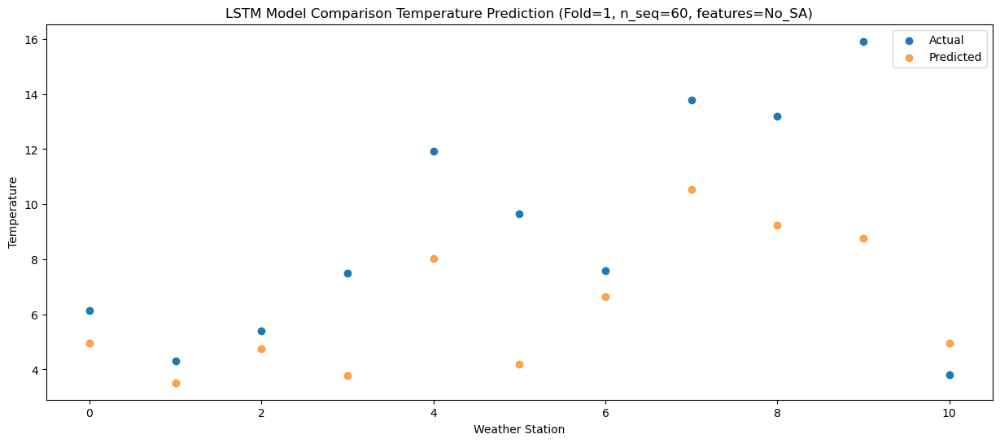

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    9.23  10.051988
1                 1    7.65   8.621988
2                 2    9.56   9.861990
3                 3   11.26   8.891988
4                 4   15.72  13.131988
5                 5   14.85   9.281990
6                 6   10.36  11.751986
7                 7   18.28  15.641988
8                 8   19.31  14.351989
9                 9   22.45  13.881989
10               10    9.28  10.051989


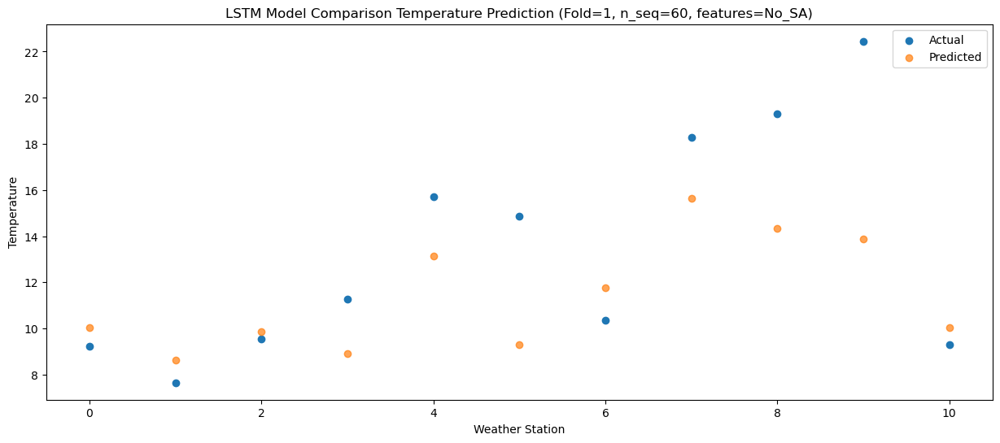

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.23  15.775226
1                 1   12.00  14.345226
2                 2   13.79  15.585226
3                 3   14.04  14.615224
4                 4   18.75  18.855224
5                 5   17.57  15.005226
6                 6   15.03  17.475222
7                 7   23.84  21.365224
8                 8   24.42  20.075225
9                 9   28.83  19.605225
10               10   16.60  15.775227


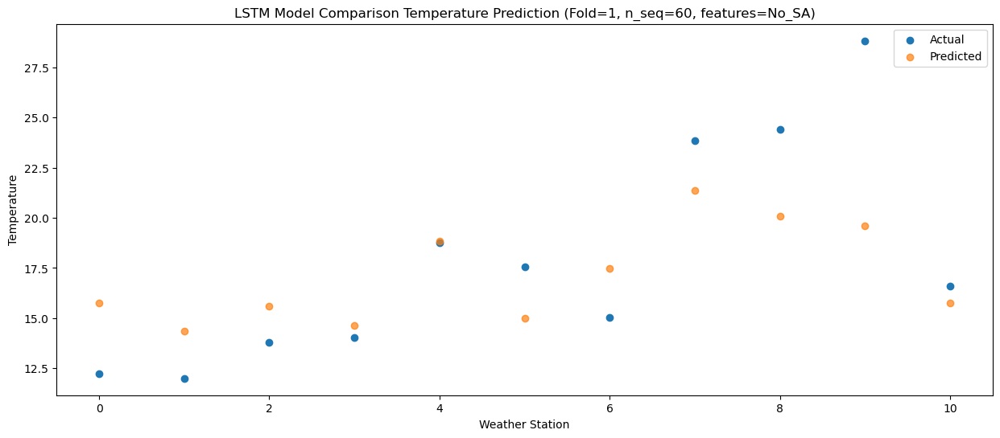

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.18  18.375609
1                 1   15.37  16.945609
2                 2   15.26  18.185609
3                 3   15.69  17.215607
4                 4   20.79  21.455607
5                 5   20.27  17.605609
6                 6   18.21  20.075605
7                 7   26.38  23.965607
8                 8   26.96  22.675608
9                 9   30.41  22.205608
10               10   20.47  18.375610


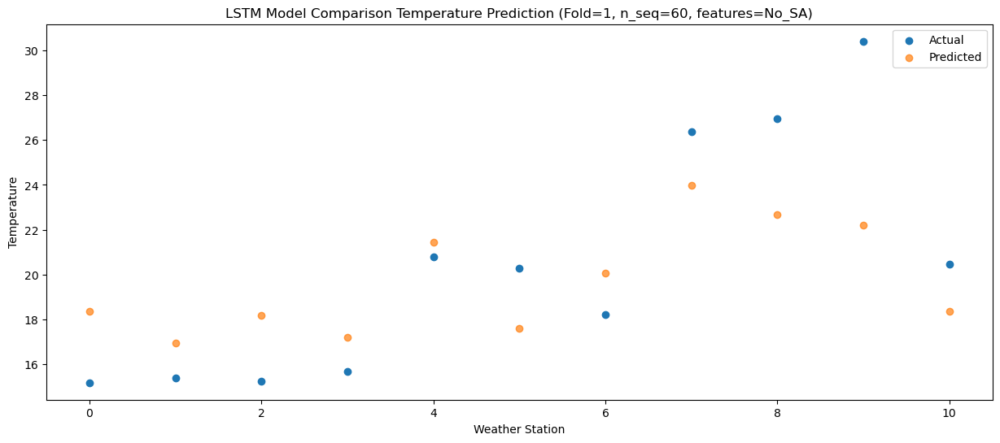

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   14.34  16.915308
1                 1   13.96  15.485308
2                 2   15.25  16.725308
3                 3   15.93  15.755306
4                 4   21.03  19.995306
5                 5   20.12  16.145308
6                 6   16.58  18.615304
7                 7   24.36  22.505306
8                 8   26.03  21.215307
9                 9   29.18  20.745307
10               10   18.28  16.915309


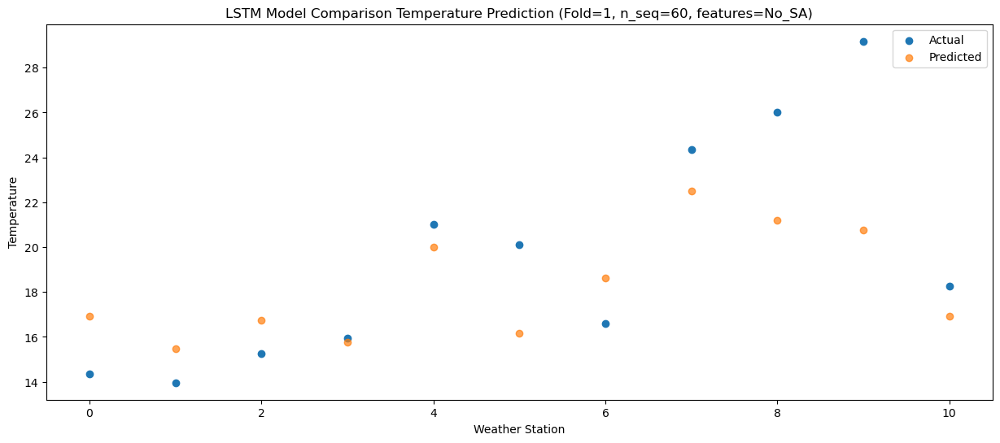

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.72  12.621278
1                 1   10.42  11.191278
2                 2   12.45  12.431278
3                 3   12.52  11.461276
4                 4   17.45  15.701276
5                 5   12.59  11.851278
6                 6   13.16  14.321274
7                 7   21.06  18.211276
8                 8   19.38  16.921277
9                 9   22.43  16.451277
10               10   13.75  12.621279


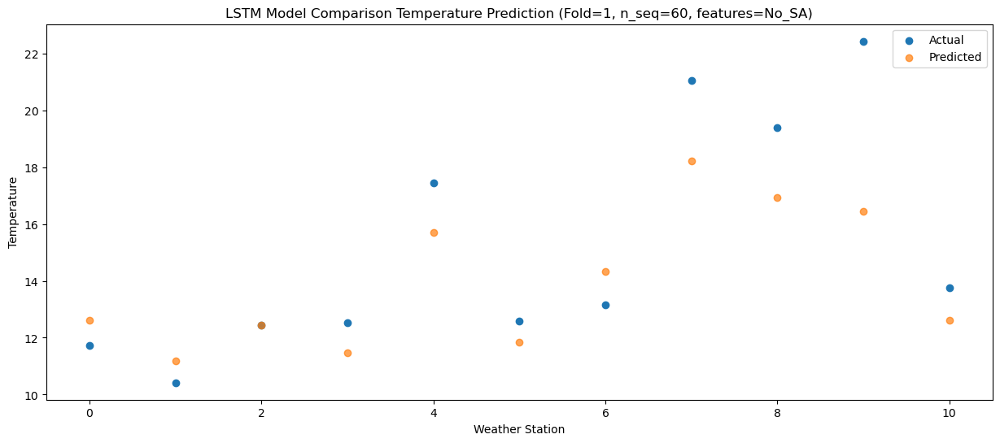

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    8.79   6.959228
1                 1    6.70   5.529228
2                 2    8.10   6.769228
3                 3    7.98   5.799226
4                 4   12.51  10.039226
5                 5    9.75   6.189228
6                 6    9.67   8.659224
7                 7   14.29  12.549226
8                 8   13.20  11.259227
9                 9   15.83  10.789227
10               10    8.21   6.959229


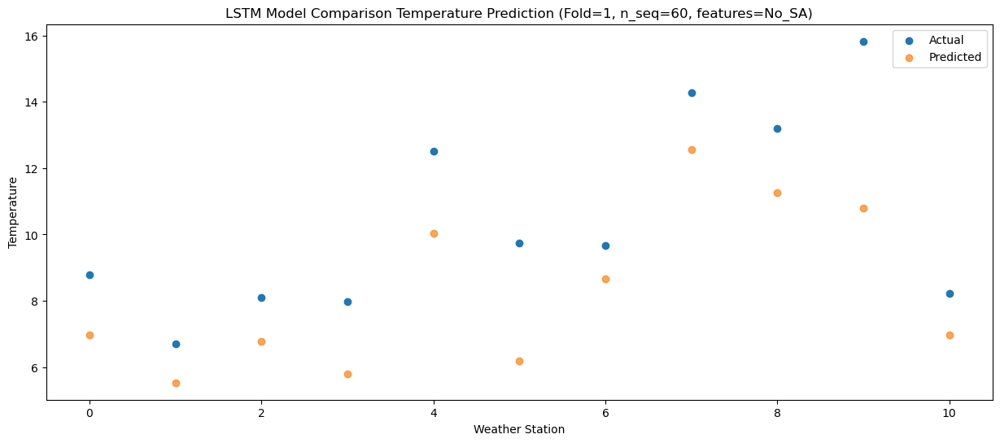

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.89   2.686981
1                 1    2.60   1.256981
2                 2    3.30   2.496981
3                 3    5.08   1.526979
4                 4    9.41   5.766979
5                 5    6.03   1.916981
6                 6    5.52   4.386976
7                 7   10.62   8.276979
8                 8   10.32   6.986980
9                 9   12.65   6.516980
10               10    4.01   2.686982


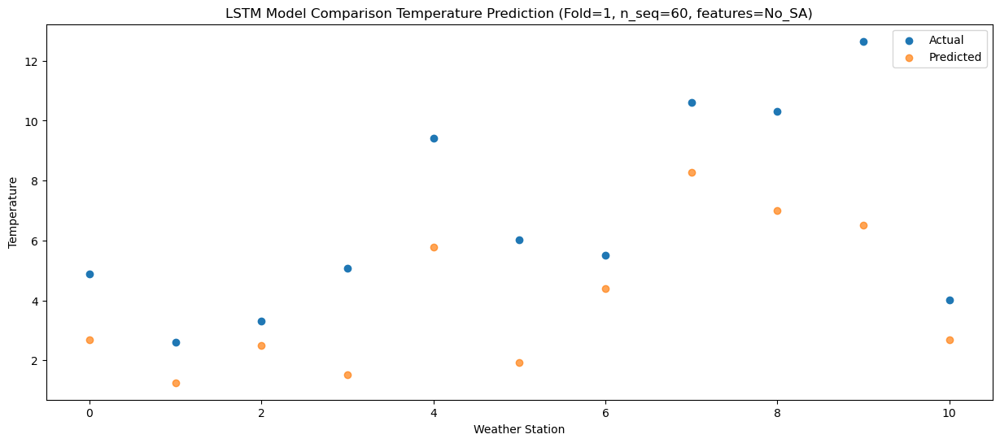

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -3.807108
1                 1   -4.29  -5.237108
2                 2   -3.76  -3.997108
3                 3   -1.10  -4.967110
4                 4    3.05  -0.727110
5                 5   -0.72  -4.577108
6                 6   -1.69  -2.107113
7                 7    4.02   1.782890
8                 8    3.64   0.492891
9                 9    5.38   0.022891
10               10   -3.00  -3.807107


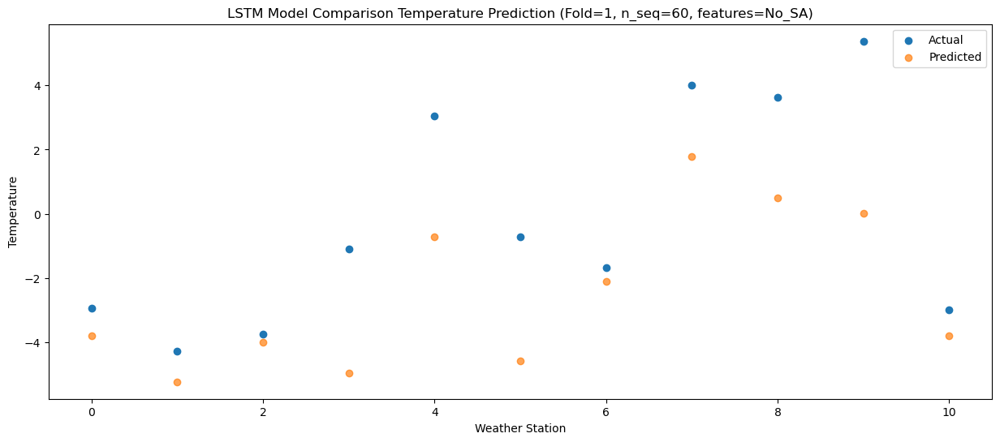

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.53  -4.937382
1                 1   -4.49  -6.367382
2                 2   -3.34  -5.127382
3                 3   -1.20  -6.097384
4                 4    3.04  -1.857384
5                 5   -2.23  -5.707382
6                 6   -1.89  -3.237387
7                 7    3.71   0.652616
8                 8    3.29  -0.637383
9                 9    5.49  -1.107383
10               10   -4.84  -4.937381


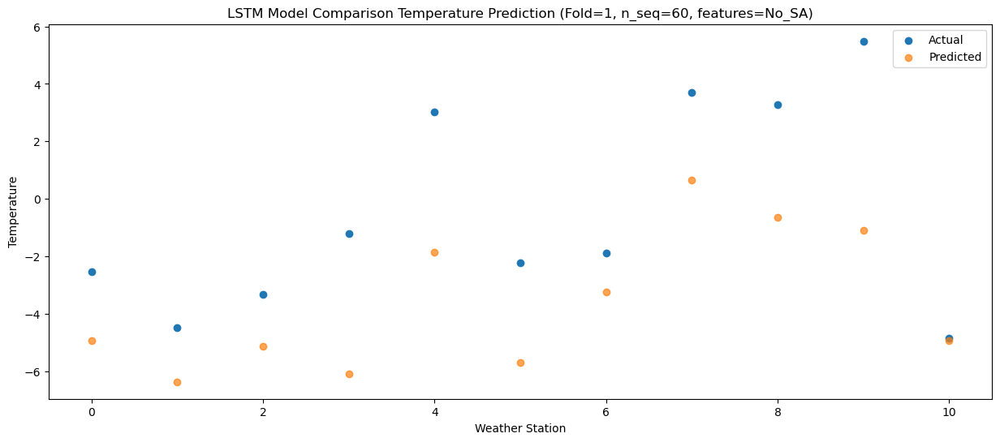

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -7.294195
1                 1   -3.83  -8.724195
2                 2   -2.85  -7.484195
3                 3   -2.79  -8.454196
4                 4    1.34  -4.214196
5                 5   -1.85  -8.064194
6                 6   -1.11  -5.594199
7                 7    0.71  -1.704195
8                 8   -1.49  -2.994195
9                 9    1.12  -3.464195
10               10   -5.80  -7.294194


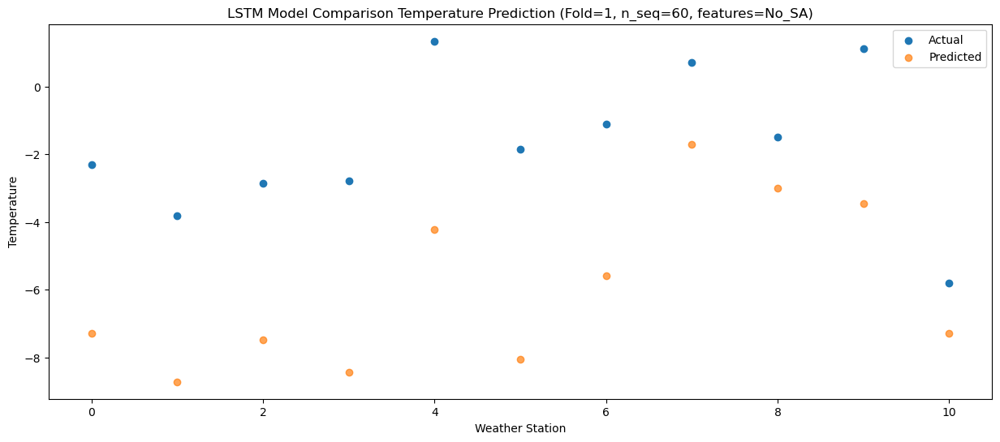

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.67   1.522707
1                 1    2.94   0.092707
2                 2    4.21   1.332708
3                 3    4.58   0.362707
4                 4    8.95   4.602707
5                 5    5.49   0.752709
6                 6    5.17   3.222704
7                 7   12.03   7.112706
8                 8   11.07   5.822708
9                 9   11.83   5.352708
10               10    1.42   1.522709


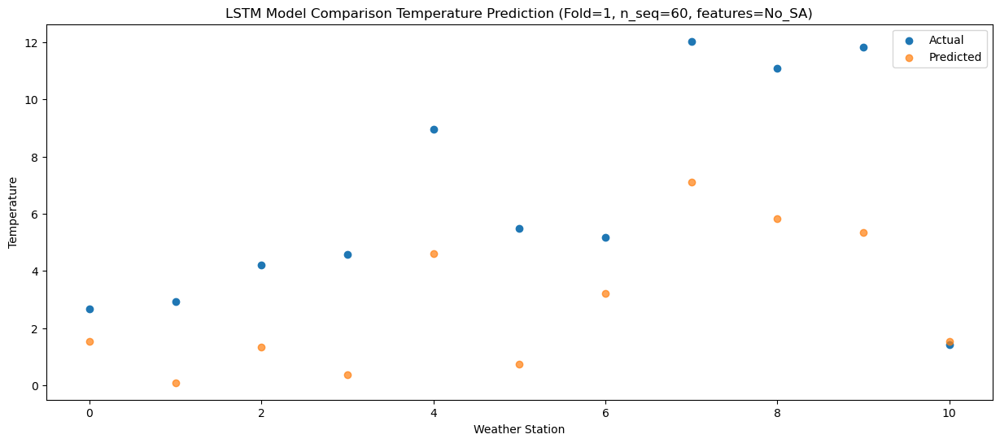

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    5.48   4.783133
1                 1    5.08   3.353133
2                 2    5.61   4.593135
3                 3    6.92   3.623134
4                 4   11.25   7.863134
5                 5    7.76   4.013136
6                 6    7.74   6.483131
7                 7   13.74  10.373135
8                 8   12.87   9.083137
9                 9   15.59   8.613135
10               10    6.07   4.783136


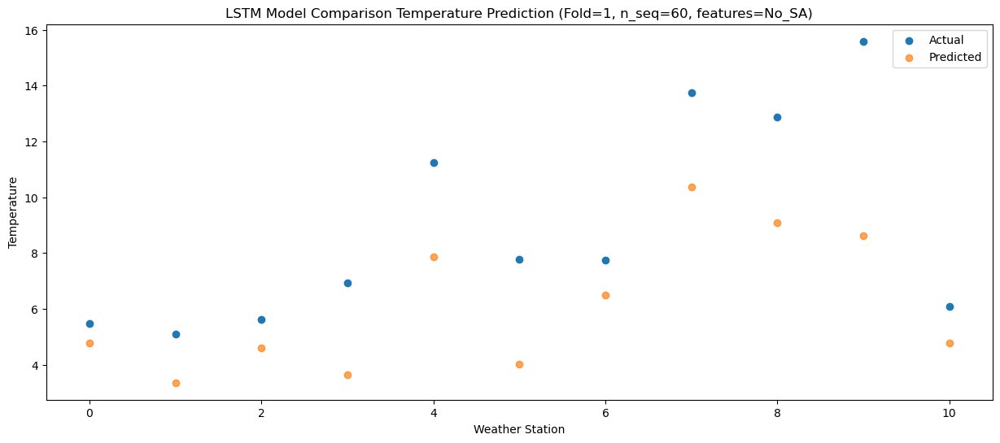

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    9.09   9.654702
1                 1    8.81   8.224702
2                 2    9.73   9.464706
3                 3   10.81   8.494705
4                 4   15.37  12.734705
5                 5   13.35   8.884707
6                 6   11.51  11.354702
7                 7   18.40  15.244706
8                 8   17.68  13.954708
9                 9   20.14  13.484706
10               10   10.61   9.654707


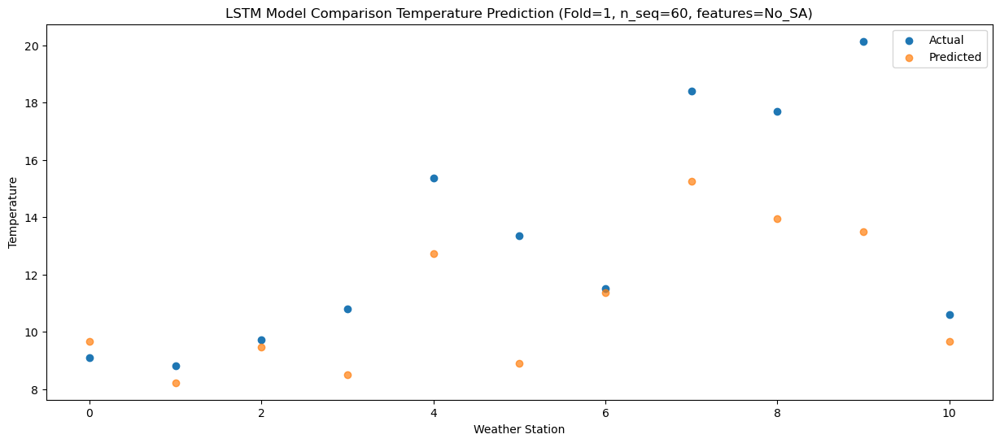

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.58  15.465517
1                 1   12.95  14.035517
2                 2   13.61  15.275523
3                 3   14.70  14.305522
4                 4   18.84  18.545522
5                 5   17.62  14.695524
6                 6   15.52  17.165519
7                 7   24.48  21.055521
8                 8   23.71  19.765525
9                 9   27.25  19.295523
10               10   16.70  15.465524


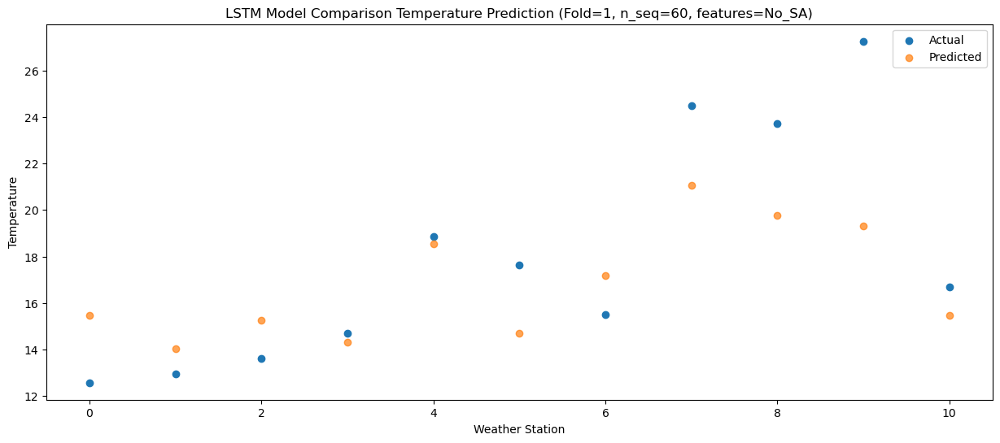

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   13.78  16.627195
1                 1   14.33  15.197195
2                 2   14.38  16.437201
3                 3   14.58  15.467200
4                 4   18.93  19.707200
5                 5   16.96  15.857202
6                 6   16.88  18.327197
7                 7   25.47  22.217199
8                 8   25.22  20.927203
9                 9   27.92  20.457201
10               10   18.93  16.627202


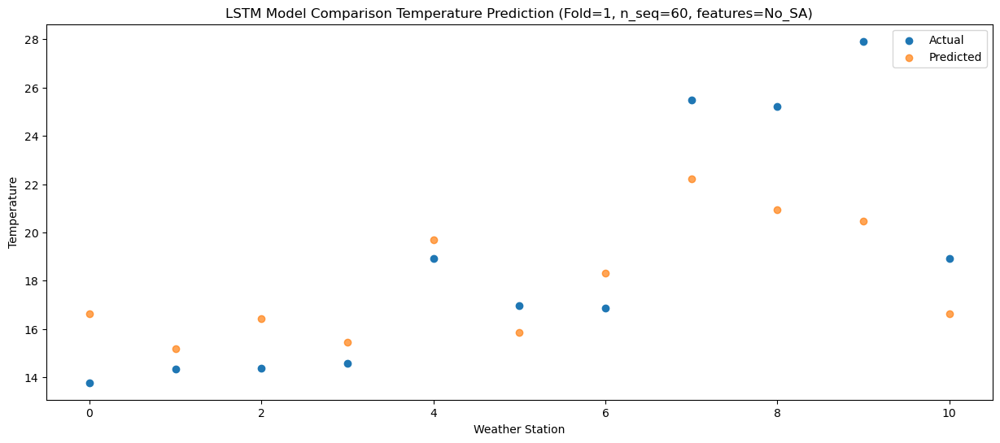

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   13.89  16.367625
1                 1   14.60  14.937625
2                 2   15.04  16.177630
3                 3   15.55  15.207629
4                 4   19.90  19.447629
5                 5   16.37  15.597631
6                 6   17.14  18.067626
7                 7   26.69  21.957628
8                 8   25.61  20.667632
9                 9   27.77  20.197630
10               10   18.71  16.367631


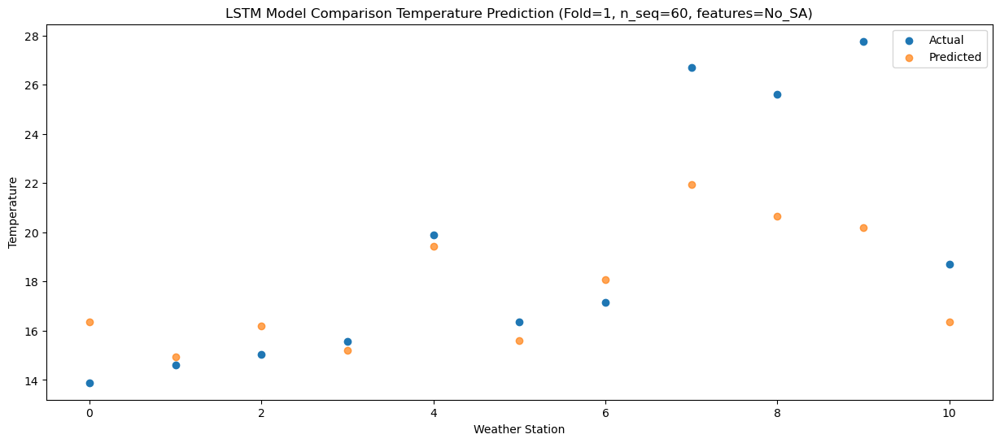

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   11.24  12.728729
1                 1   10.86  11.298729
2                 2   12.02  12.538735
3                 3   12.54  11.568734
4                 4   16.32  15.808734
5                 5   16.01  11.958736
6                 6   13.81  14.428731
7                 7   22.98  18.318733
8                 8   23.10  17.028736
9                 9   25.82  16.558735
10               10   15.01  12.728736


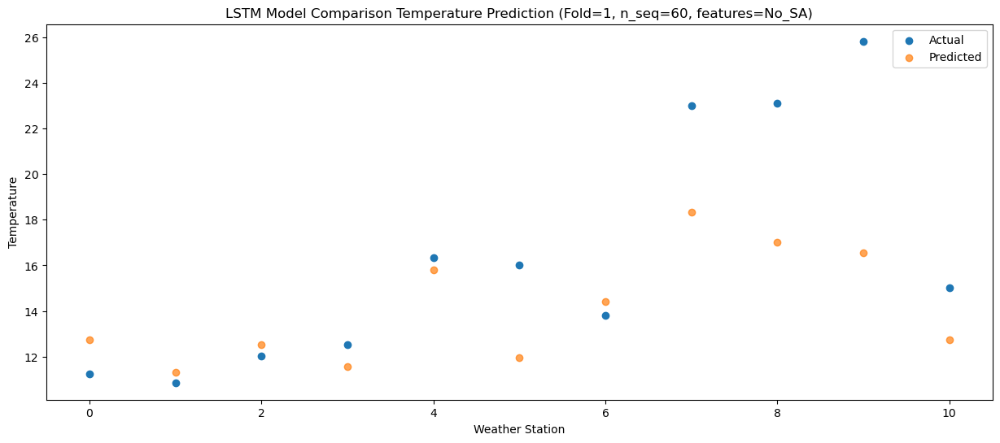

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.54   8.488403
1                 1    7.08   7.058403
2                 2    8.24   8.298409
3                 3    9.85   7.328408
4                 4   13.28  11.568408
5                 5   11.69   7.718410
6                 6    9.86  10.188405
7                 7   17.78  14.078407
8                 8   16.85  12.788411
9                 9   18.38  12.318409
10               10   10.59   8.488410


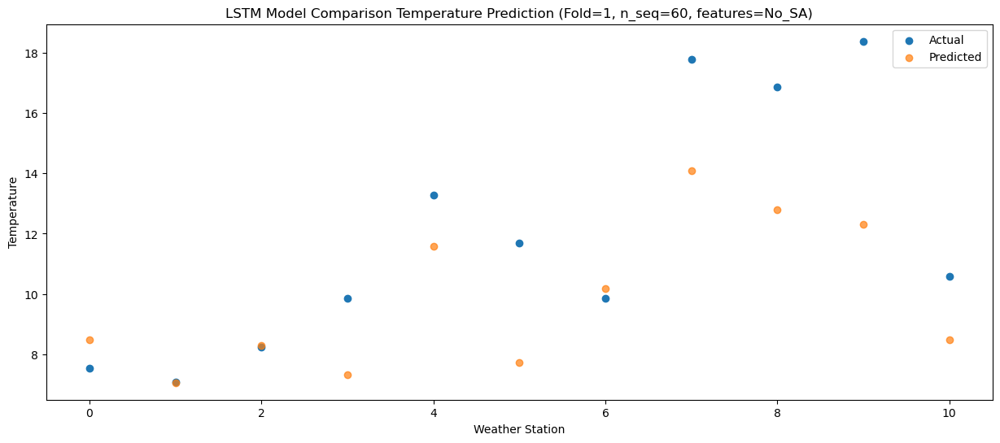

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -0.67  -0.863177
1                 1   -0.58  -2.293177
2                 2    0.50  -1.053171
3                 3    2.69  -2.023172
4                 4    5.73   2.216828
5                 5    5.22  -1.633170
6                 6    2.26   0.836825
7                 7    8.48   4.726826
8                 8    9.10   3.436830
9                 9   12.13   2.966829
10               10    1.27  -0.863170


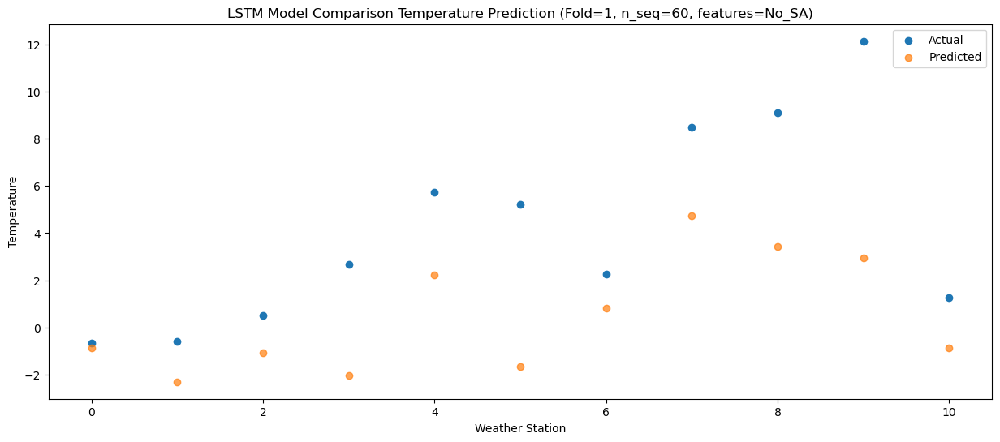

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.68  -1.599161
1                 1    1.05  -3.029163
2                 2    3.10  -1.789157
3                 3    6.06  -2.759158
4                 4    9.61   1.480842
5                 5    5.48  -2.369156
6                 6    3.78   0.100839
7                 7   10.89   3.990840
8                 8    8.29   2.700844
9                 9   10.52   2.230843
10               10    0.50  -1.599156


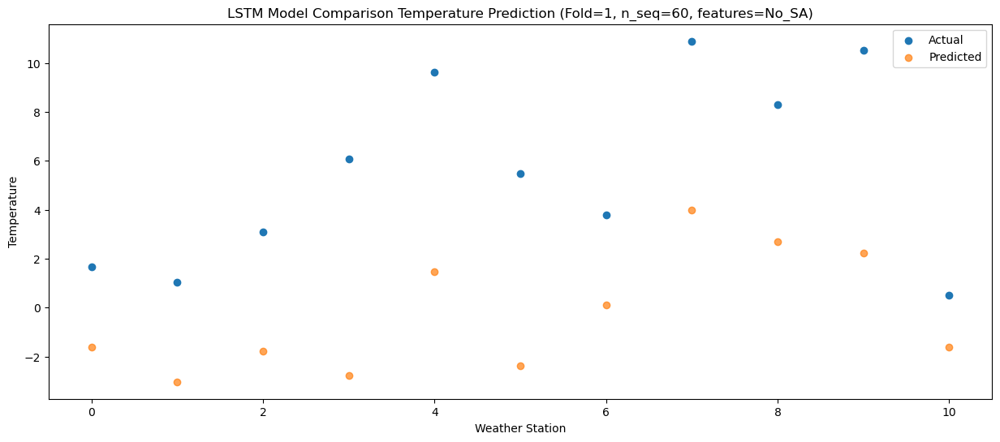

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.48  -8.904804
1                 1   -5.68 -10.334805
2                 2   -3.79  -9.094799
3                 3   -1.99 -10.064800
4                 4    1.13  -5.824800
5                 5   -1.84  -9.674798
6                 6   -2.61  -7.204803
7                 7    2.06  -3.314802
8                 8    0.67  -4.604798
9                 9    3.60  -5.074799
10               10   -6.52  -8.904798


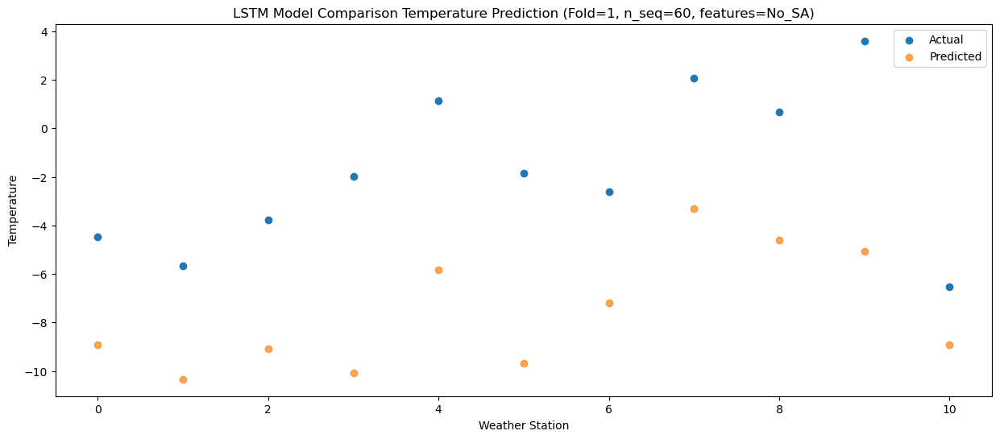

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.36  -6.037306
1                 1   -1.45  -7.467307
2                 2   -0.44  -6.227302
3                 3   -2.46  -7.197303
4                 4    0.82  -2.957303
5                 5   -1.95  -6.807301
6                 6    1.20  -4.337306
7                 7    4.11  -0.447307
8                 8    1.65  -1.737301
9                 9    3.66  -2.207302
10               10   -2.62  -6.037301


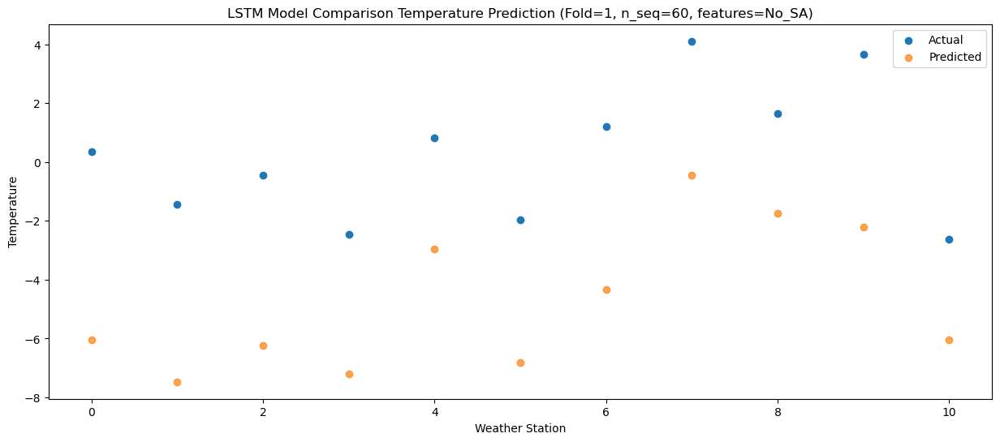

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.75  -0.166106
1                 1    2.12  -1.596109
2                 2    3.56  -0.356103
3                 3    3.38  -1.326104
4                 4    6.60   2.913896
5                 5    5.00  -0.936102
6                 6    5.04   1.533893
7                 7   10.06   5.423892
8                 8    8.90   4.133898
9                 9   10.59   3.663897
10               10    1.94  -0.166102


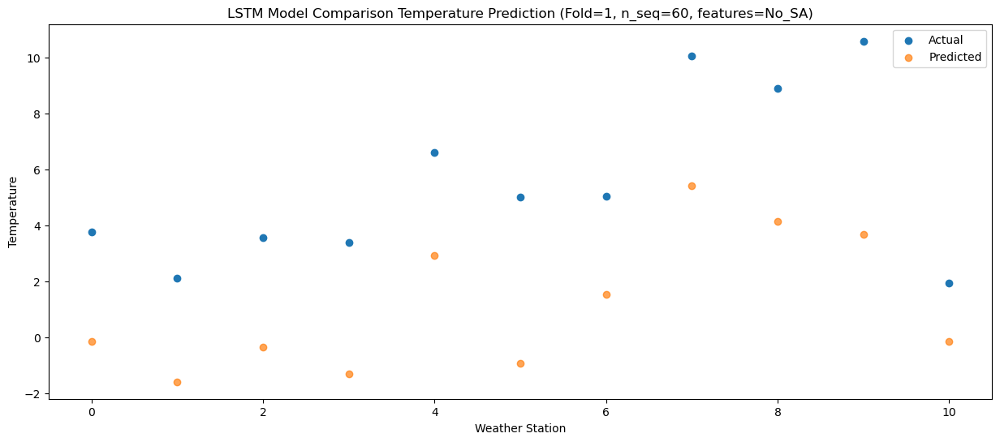

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    5.74   3.214223
1                 1    5.12   1.784220
2                 2    7.15   3.024228
3                 3    9.38   2.054227
4                 4   12.87   6.294227
5                 5   11.91   2.444229
6                 6    7.80   4.914224
7                 7   15.25   8.804223
8                 8   16.01   7.514229
9                 9   17.07   7.044228
10               10    5.29   3.214227


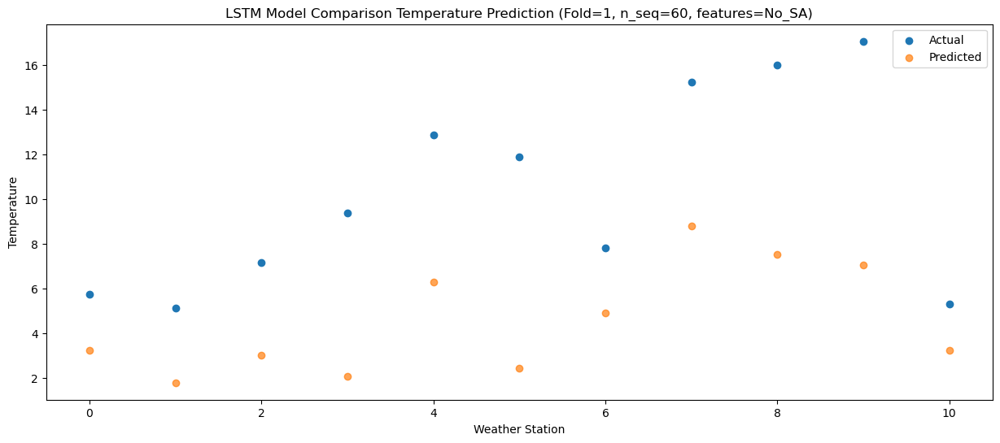

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.99  10.064777
1                 1   11.00   8.634774
2                 2   12.51   9.874782
3                 3   13.81   8.904781
4                 4   17.49  13.144781
5                 5   17.31   9.294783
6                 6   13.72  11.764778
7                 7   20.72  15.654779
8                 8   21.37  14.364784
9                 9   22.52  13.894782
10               10   12.27  10.064781


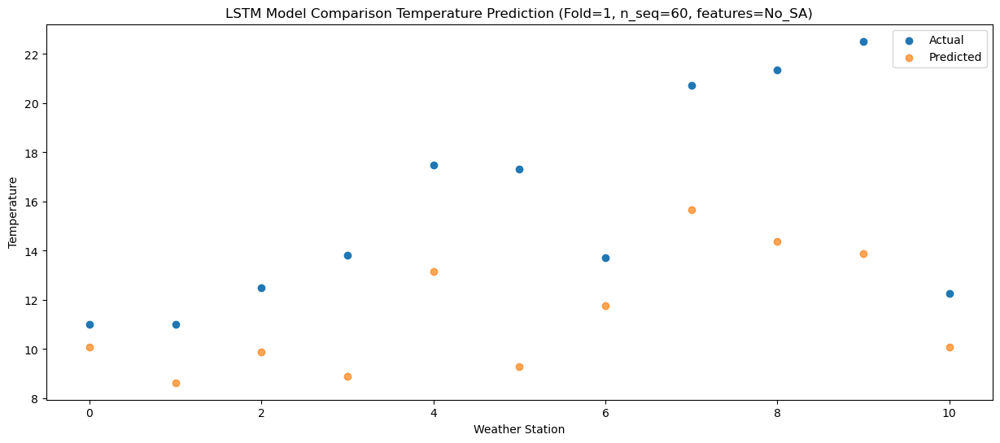

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.49  13.706787
1                 1   14.97  12.276785
2                 2   15.48  13.516792
3                 3   16.81  12.546791
4                 4   20.86  16.786791
5                 5   19.37  12.936793
6                 6   17.30  15.406788
7                 7   24.78  19.296789
8                 8   25.66  18.006795
9                 9   27.09  17.536792
10               10   16.66  13.706791


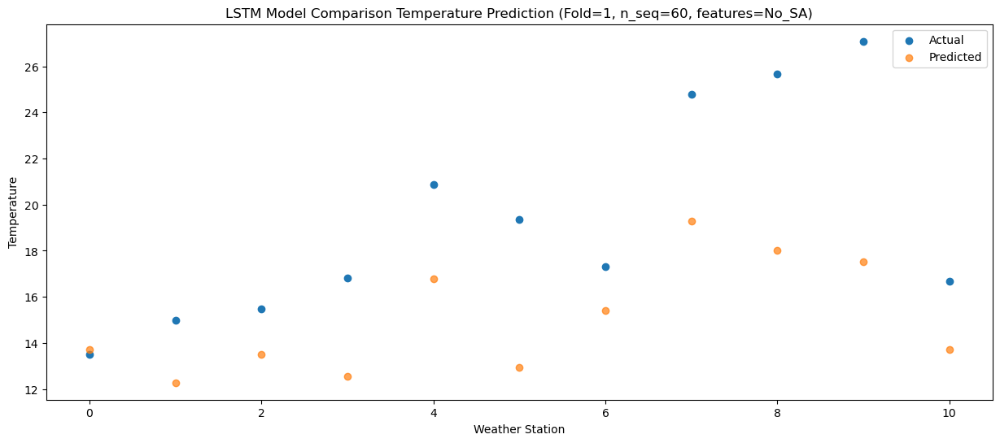

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   14.39  15.591149
1                 1   15.47  14.161146
2                 2   16.19  15.401151
3                 3   17.75  14.431152
4                 4   21.95  18.671152
5                 5   20.29  14.821154
6                 6   18.04  17.291149
7                 7   28.91  21.181150
8                 8   29.81  19.891154
9                 9   30.69  19.421153
10               10   20.60  15.591152


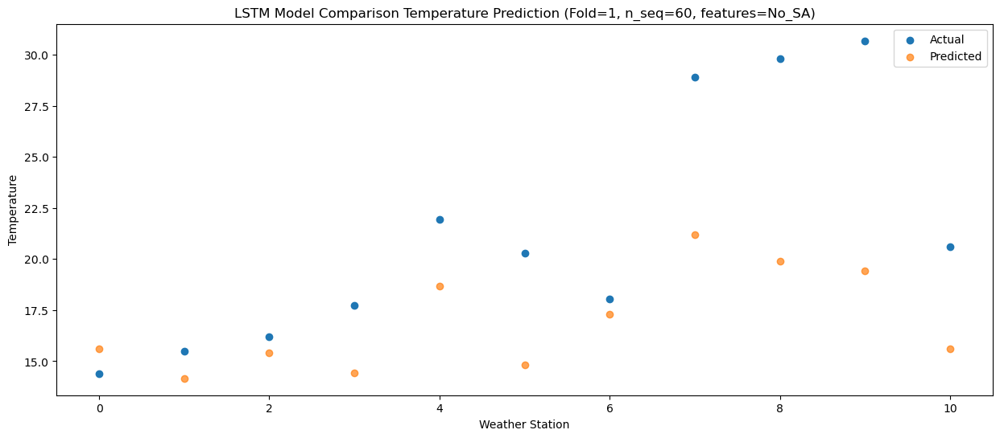

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.59  15.137428
1                 1   14.01  13.707425
2                 2   14.58  14.947431
3                 3   16.11  13.977432
4                 4   19.94  18.217432
5                 5   17.44  14.367434
6                 6   16.54  16.837429
7                 7   26.04  20.727430
8                 8   27.14  19.437434
9                 9   27.86  18.967433
10               10   20.06  15.137432


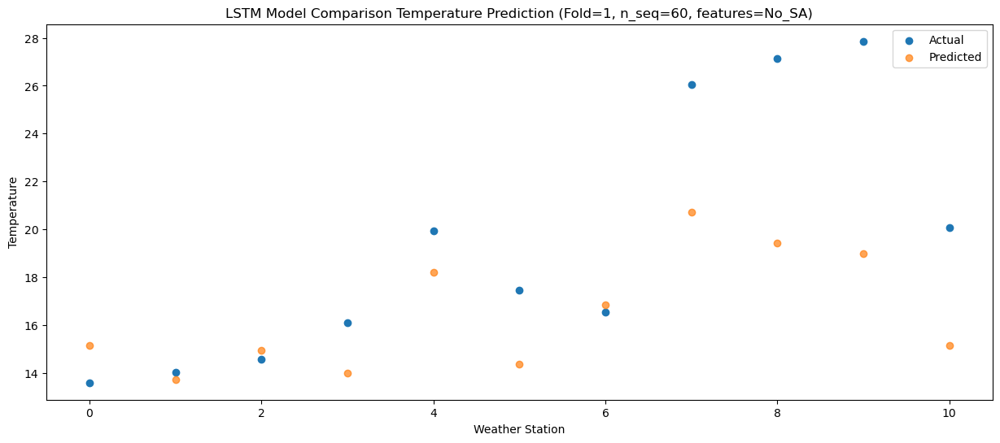

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   11.63  10.666293
1                 1   10.92   9.236290
2                 2   12.19  10.476295
3                 3   13.34   9.506296
4                 4   16.76  13.746296
5                 5   14.39   9.896298
6                 6   13.65  12.366293
7                 7   22.20  16.256294
8                 8   23.31  14.966298
9                 9   25.45  14.496297
10               10   15.15  10.666296


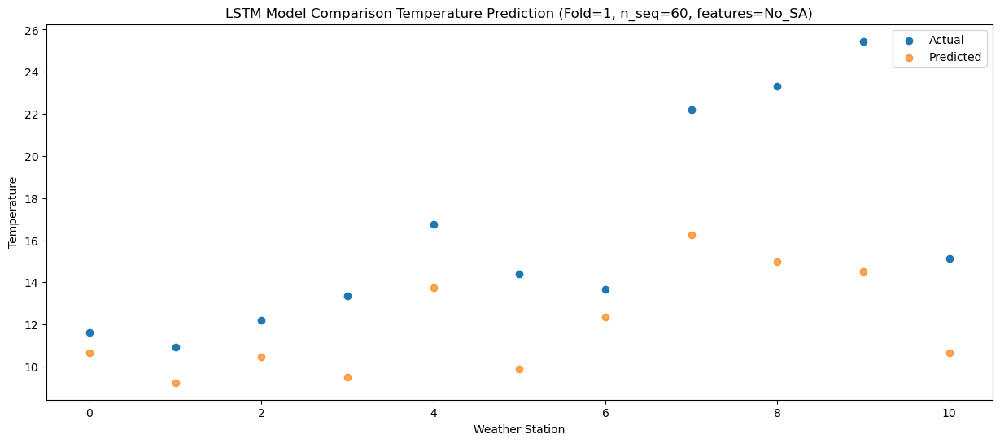

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.08   4.199183
1                 1    4.58   2.769180
2                 2    5.50   4.009185
3                 3    7.78   3.039186
4                 4   11.37   7.279186
5                 5    8.31   3.429188
6                 6    7.31   5.899183
7                 7   15.53   9.789184
8                 8   15.08   8.499188
9                 9   16.91   8.029187
10               10    7.05   4.199186


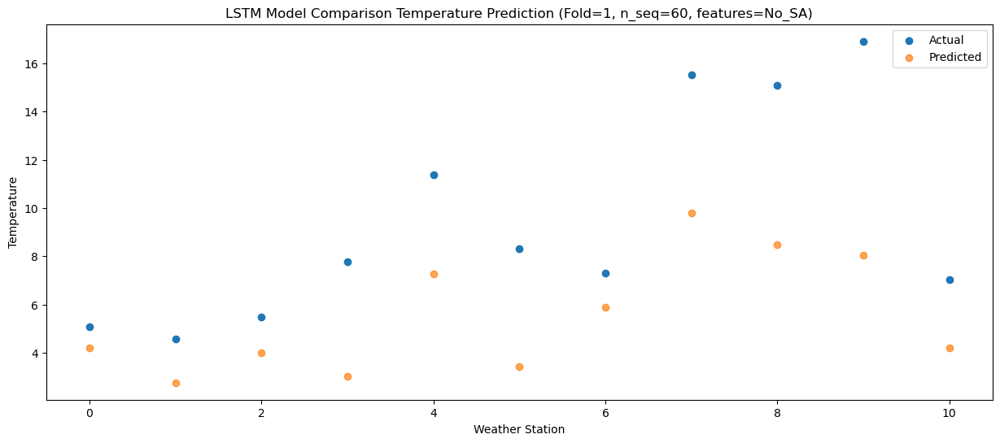

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.88  -1.084626
1                 1    1.58  -2.514629
2                 2    2.18  -1.274624
3                 3    2.73  -2.244623
4                 4    6.37   1.995377
5                 5    1.35  -1.854621
6                 6    4.42   0.615374
7                 7    8.93   4.505375
8                 8    7.23   3.215379
9                 9    7.92   2.745378
10               10    3.54  -1.084623


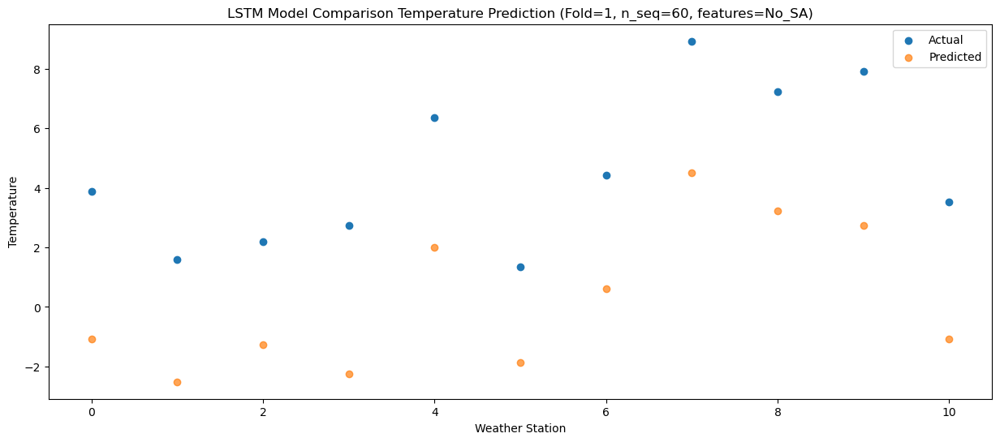

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.88  -6.630114
1                 1   -4.23  -8.060118
2                 2   -0.98  -6.820112
3                 3    0.64  -7.790111
4                 4    4.35  -3.550111
5                 5    0.23  -7.400110
6                 6   -1.59  -4.930115
7                 7    5.19  -1.040114
8                 8    3.60  -2.330110
9                 9    5.57  -2.800110
10               10   -3.61  -6.630112


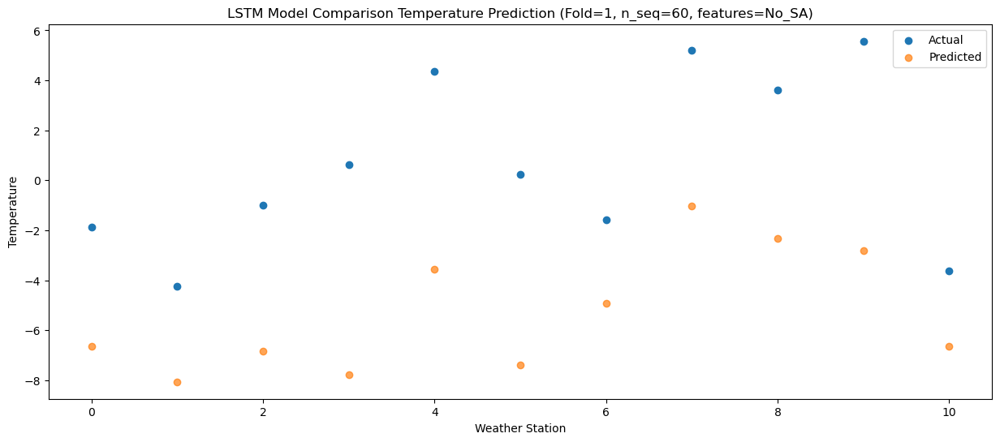

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.23  -4.637182
1                 1   -2.04  -6.067186
2                 2    0.02  -4.827181
3                 3    1.35  -5.797180
4                 4    4.83  -1.557180
5                 5    0.69  -5.407179
6                 6    0.54  -2.937183
7                 7    6.38   0.952817
8                 8    4.46  -0.337179
9                 9    5.85  -0.807179
10               10   -0.65  -4.637181


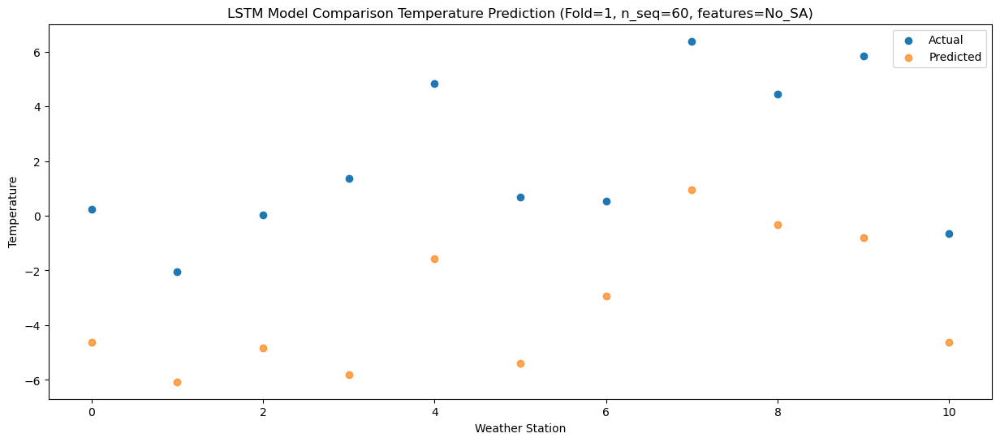

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    3.14  -4.310354
1                 1    1.33  -5.740358
2                 2    2.61  -4.500353
3                 3    2.35  -5.470352
4                 4    6.01  -1.230352
5                 5    0.83  -5.080351
6                 6    4.13  -2.610356
7                 7    7.88   1.279645
8                 8    4.83  -0.010351
9                 9    7.00  -0.480351
10               10   -0.97  -4.310353


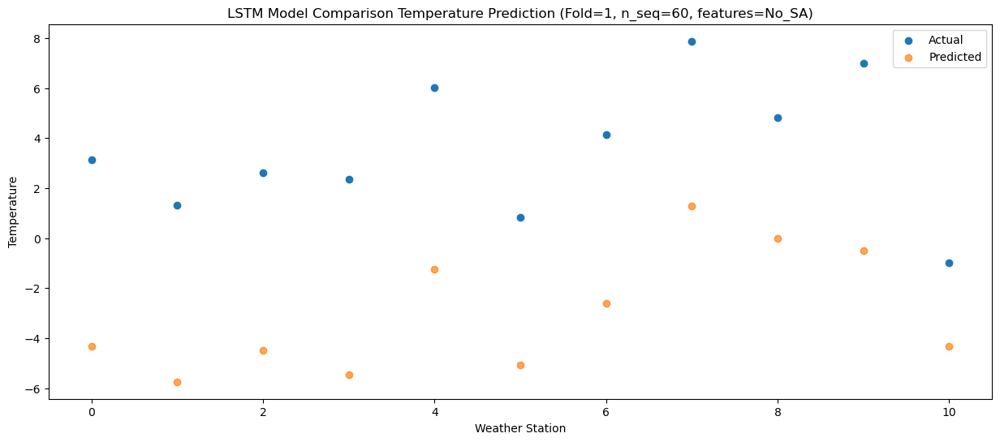

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.78  -2.528165
1                 1    2.10  -3.958169
2                 2    4.04  -2.718163
3                 3    6.18  -3.688162
4                 4    9.83   0.551838
5                 5    5.89  -3.298161
6                 6    4.80  -0.828166
7                 7   10.71   3.061835
8                 8    9.26   1.771839
9                 9   10.73   1.301839
10               10    0.15  -2.528163


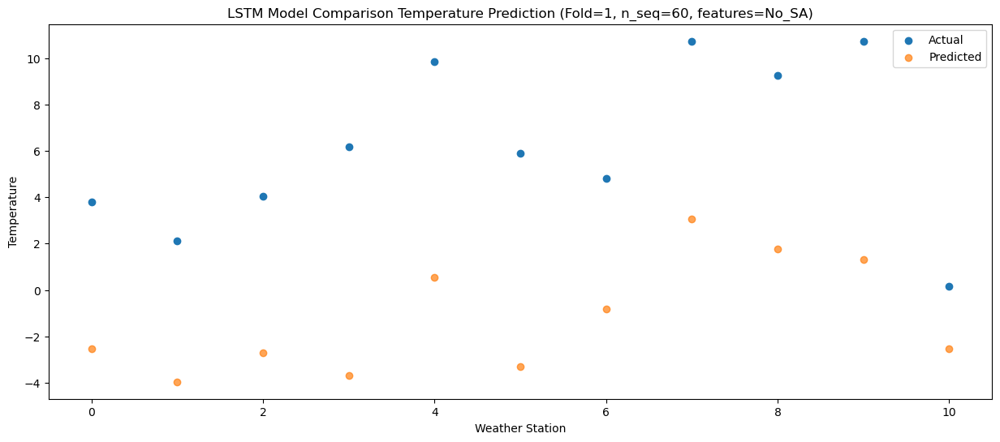

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.28   2.968319
1                 1    5.37   1.538313
2                 2    6.73   2.778318
3                 3    7.02   1.808320
4                 4   10.79   6.048320
5                 5    9.05   2.198321
6                 6    8.06   4.668316
7                 7   15.11   8.558316
8                 8   13.59   7.268320
9                 9   16.08   6.798320
10               10    7.37   2.968318


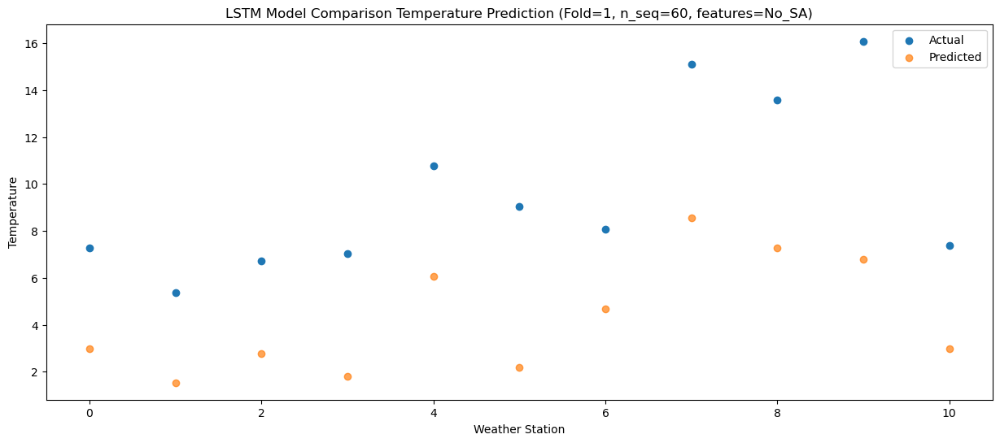

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.78   7.310362
1                 1    8.65   5.880356
2                 2    9.97   7.120362
3                 3   11.61   6.150363
4                 4   15.43  10.390363
5                 5   13.66   6.540364
6                 6   11.06   9.010359
7                 7   20.46  12.900360
8                 8   19.28  11.610364
9                 9   21.19  11.140364
10               10    9.93   7.310362


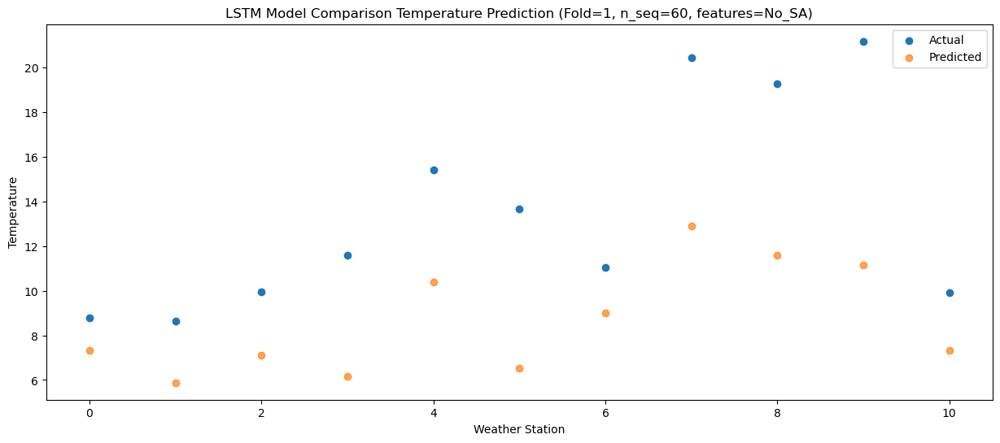

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   12.40  10.987486
1                 1   11.84   9.557480
2                 2   13.72  10.797486
3                 3   15.76   9.827487
4                 4   20.32  14.067487
5                 5   20.35  10.217488
6                 6   14.34  12.687483
7                 7   24.27  16.577484
8                 8   24.21  15.287487
9                 9   24.42  14.817488
10               10   14.30  10.987486


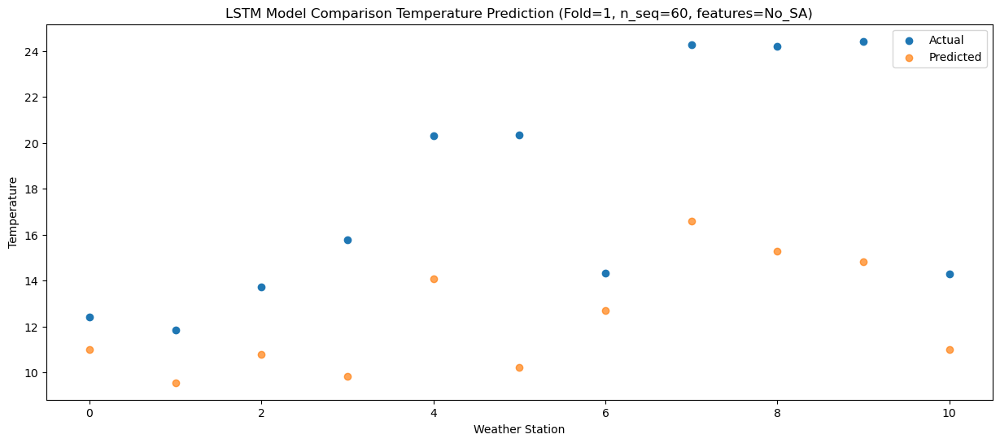

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.63  14.047965
1                 1   15.44  12.617957
2                 2   16.09  13.857962
3                 3   17.48  12.887963
4                 4   22.27  17.127963
5                 5   21.45  13.277964
6                 6   17.79  15.747960
7                 7   26.57  19.637960
8                 8   27.09  18.347964
9                 9   29.04  17.877966
10               10   19.44  14.047962


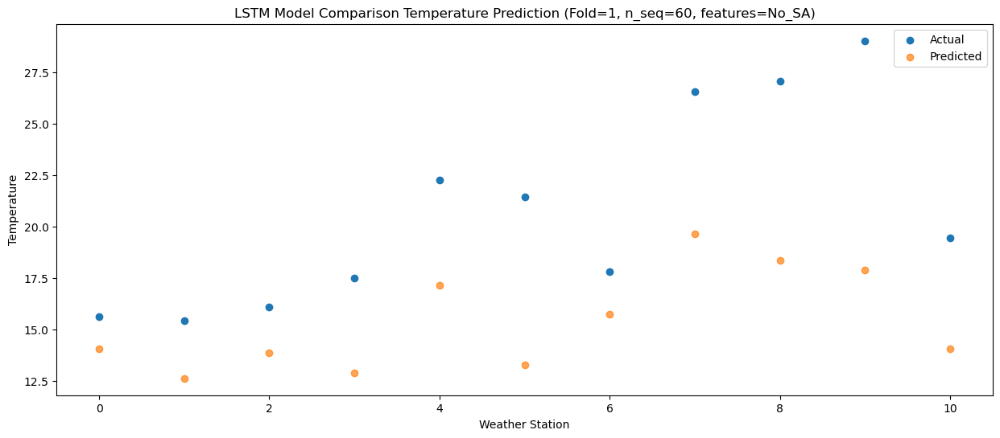

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.42  12.913954
1                 1   14.90  11.483946
2                 2   16.53  12.723951
3                 3   19.45  11.753952
4                 4   23.70  15.993952
5                 5   20.64  12.143953
6                 6   17.37  14.613949
7                 7   27.07  18.503949
8                 8   28.90  17.213953
9                 9   29.44  16.743955
10               10   17.70  12.913951


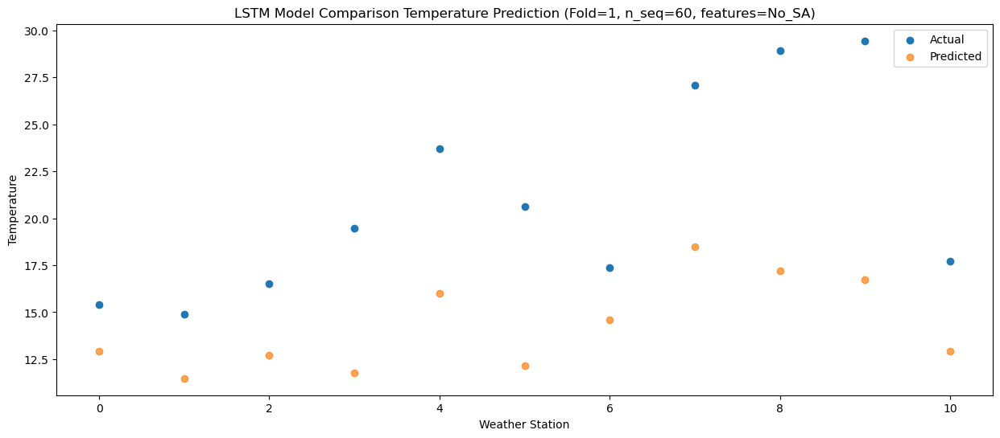

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.73   9.997199
1                 1   11.39   8.567191
2                 2   13.57   9.807197
3                 3   16.37   8.837198
4                 4   19.85  13.077198
5                 5   18.36   9.227199
6                 6   14.20  11.697194
7                 7   23.45  15.587195
8                 8   24.26  14.297198
9                 9   25.92  13.827201
10               10   14.51   9.997197


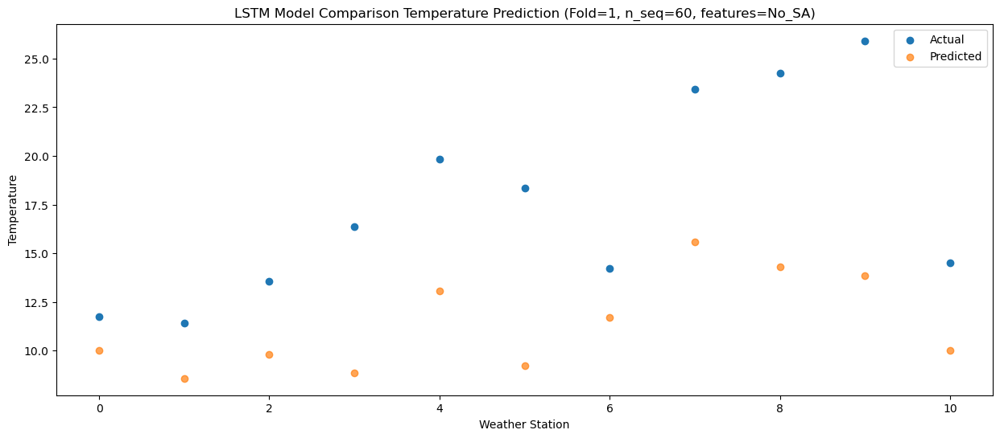

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.85   4.445243
1                 1    6.38   3.015235
2                 2    7.53   4.255241
3                 3    9.11   3.285243
4                 4   12.45   7.525243
5                 5   10.76   3.675244
6                 6    9.19   6.145239
7                 7   17.14  10.035239
8                 8   15.68   8.745243
9                 9   17.82   8.275245
10               10    9.16   4.445241


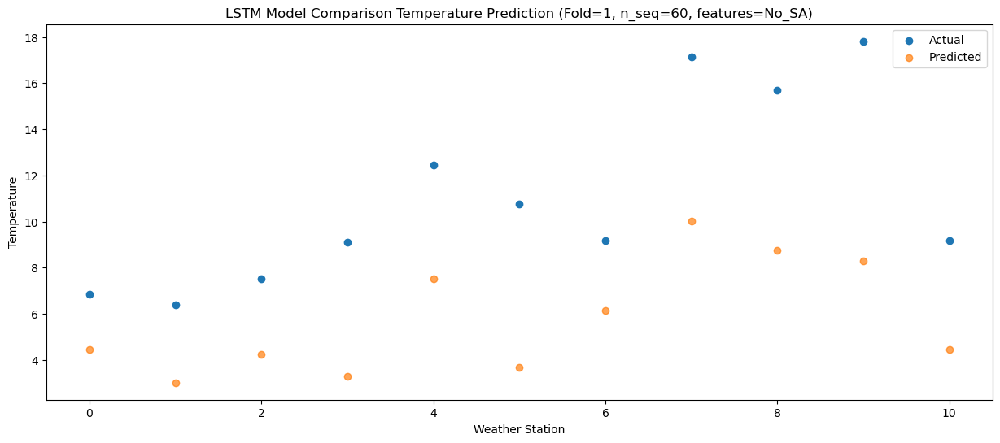

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.70  -2.428820
1                 1    0.76  -3.858829
2                 2    0.97  -2.618821
3                 3    2.83  -3.588820
4                 4    6.25   0.651180
5                 5    4.10  -3.198819
6                 6    3.50  -0.728824
7                 7    9.74   3.161177
8                 8    8.56   1.871181
9                 9   11.07   1.401183
10               10    1.22  -2.428821


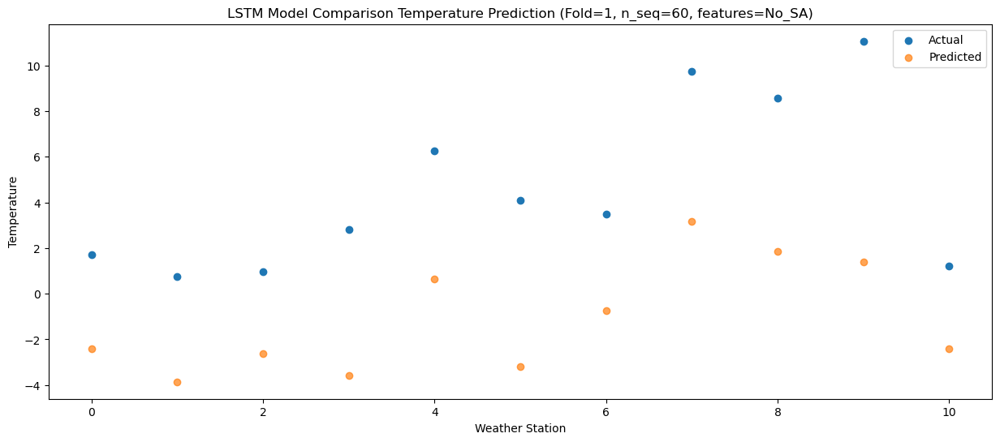

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.33  -3.889165
1                 1   -2.38  -5.319174
2                 2   -1.81  -4.079166
3                 3    0.43  -5.049166
4                 4    4.35  -0.809166
5                 5    1.74  -4.659165
6                 6    0.76  -2.189170
7                 7    6.82   1.700832
8                 8    5.71   0.410836
9                 9    7.24  -0.059162
10               10   -0.47  -3.889167


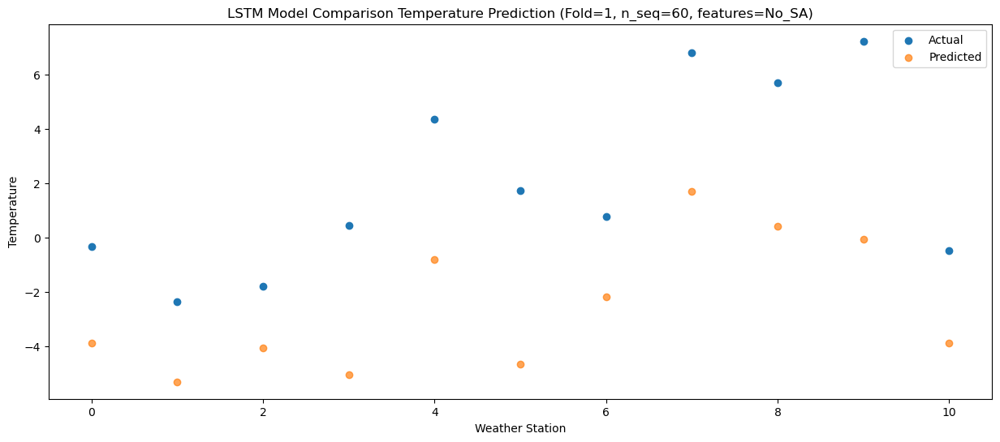

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -8.685463
1                 1   -5.66 -10.115472
2                 2   -4.89  -8.875465
3                 3   -2.99  -9.845465
4                 4    0.50  -5.605465
5                 5   -1.87  -9.455464
6                 6   -2.24  -6.985468
7                 7    0.89  -3.095467
8                 8   -0.12  -4.385463
9                 9    2.07  -4.855461
10               10   -4.37  -8.685466


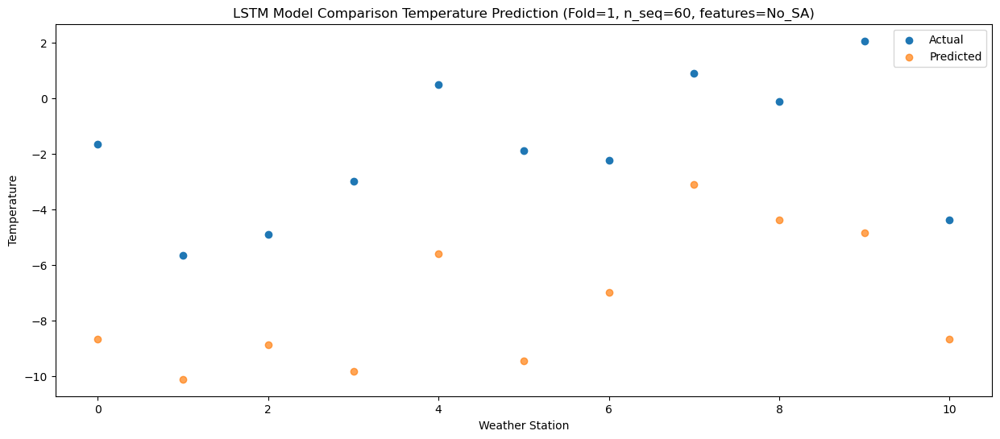

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.27  -4.088881
1                 1   -0.58  -5.518890
2                 2    0.45  -4.278882
3                 3    3.32  -5.248882
4                 4    6.87  -1.008882
5                 5    4.25  -4.858881
6                 6    1.97  -2.388886
7                 7    9.89   1.501116
8                 8    7.83   0.211120
9                 9    9.78  -0.258878
10               10   -2.42  -4.088883


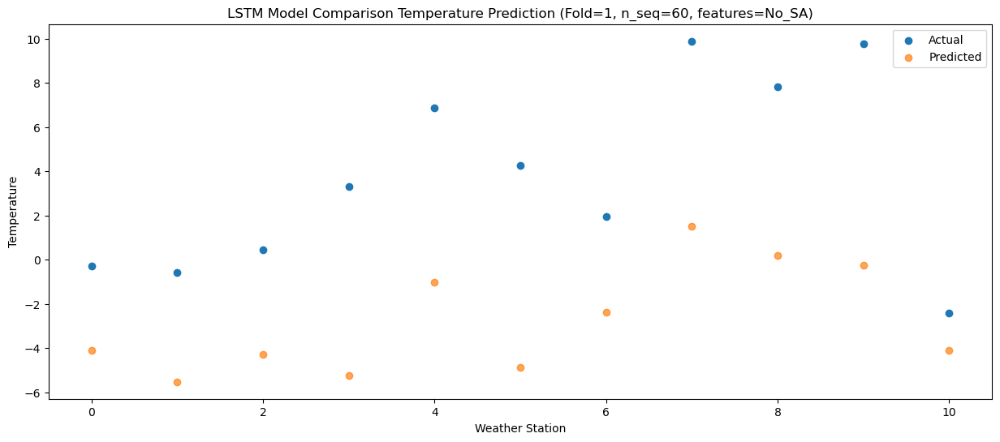

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.58   0.255855
1                 1    2.64  -1.174154
2                 2    3.55   0.065854
3                 3    5.83  -0.904146
4                 4    9.61   3.335854
5                 5    6.60  -0.514145
6                 6    5.63   1.955850
7                 7   12.61   5.845852
8                 8   11.07   4.555856
9                 9   12.61   4.085858
10               10    1.98   0.255853


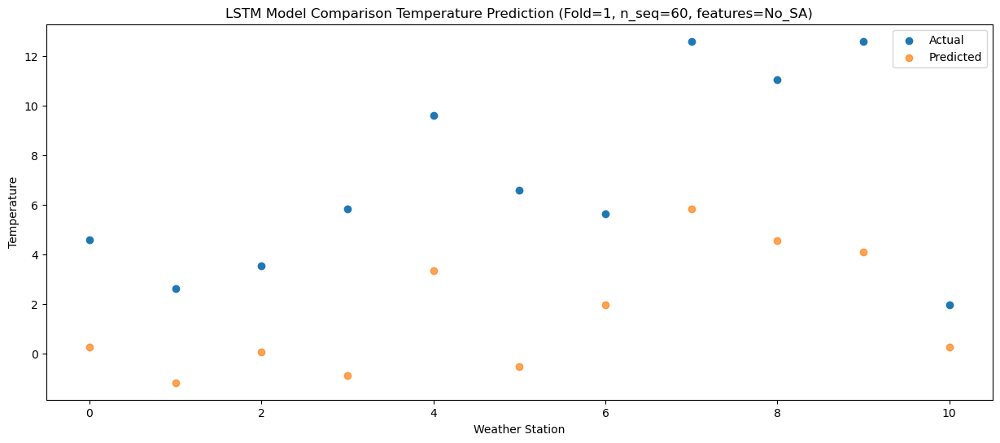

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.98   4.619306
1                 1    6.31   3.189297
2                 2    6.89   4.429305
3                 3    9.31   3.459305
4                 4   13.17   7.699305
5                 5   11.40   3.849306
6                 6    9.10   6.319301
7                 7   16.65  10.209303
8                 8   15.75   8.919307
9                 9   17.68   8.449309
10               10    6.37   4.619304


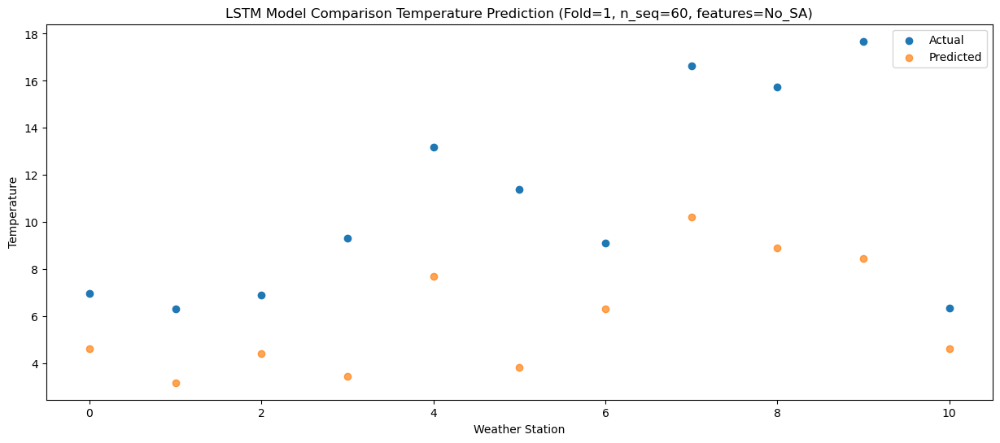

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.65  10.203705
1                 1   10.88   8.773697
2                 2   12.50  10.013704
3                 3   13.01   9.043704
4                 4   16.87  13.283704
5                 5   17.02   9.433705
6                 6   13.34  11.903700
7                 7   22.19  15.793702
8                 8   20.51  14.503706
9                 9   21.82  14.033708
10               10   11.96  10.203703


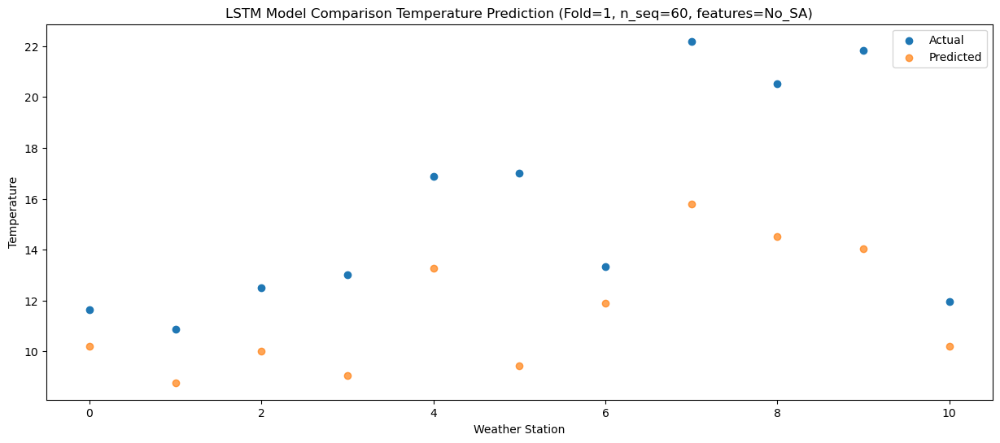

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   14.52  14.869763
1                 1   14.64  13.439754
2                 2   15.61  14.679762
3                 3   15.64  13.709762
4                 4   19.76  17.949762
5                 5   19.88  14.099763
6                 6   17.27  16.569758
7                 7   25.26  20.459760
8                 8   26.21  19.169764
9                 9   28.23  18.699766
10               10   18.07  14.869761


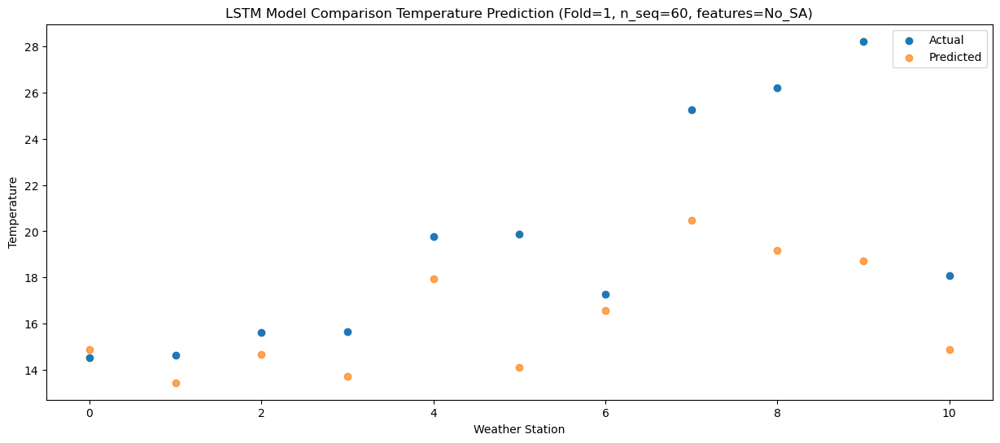

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   15.48  16.075137
1                 1   15.57  14.645128
2                 2   15.63  15.885136
3                 3   15.03  14.915136
4                 4   19.57  19.155136
5                 5   18.88  15.305137
6                 6   18.30  17.775132
7                 7   25.90  21.665133
8                 8   27.06  20.375137
9                 9   28.96  19.905139
10               10   20.00  16.075135


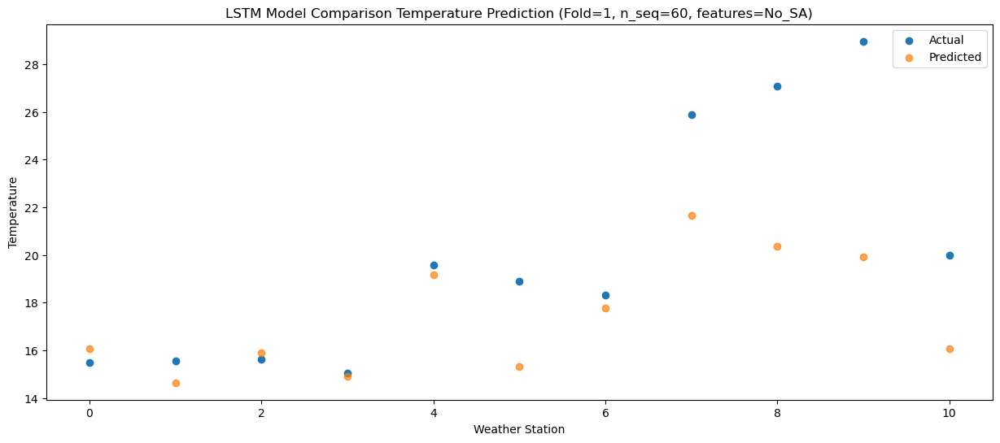

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   14.13  14.632684
1                 1   15.29  13.202675
2                 2   15.94  14.442683
3                 3   16.16  13.472683
4                 4   20.89  17.712683
5                 5   20.48  13.862684
6                 6   17.97  16.332679
7                 7   26.31  20.222680
8                 8   29.17  18.932684
9                 9   29.76  18.462686
10               10   17.85  14.632682


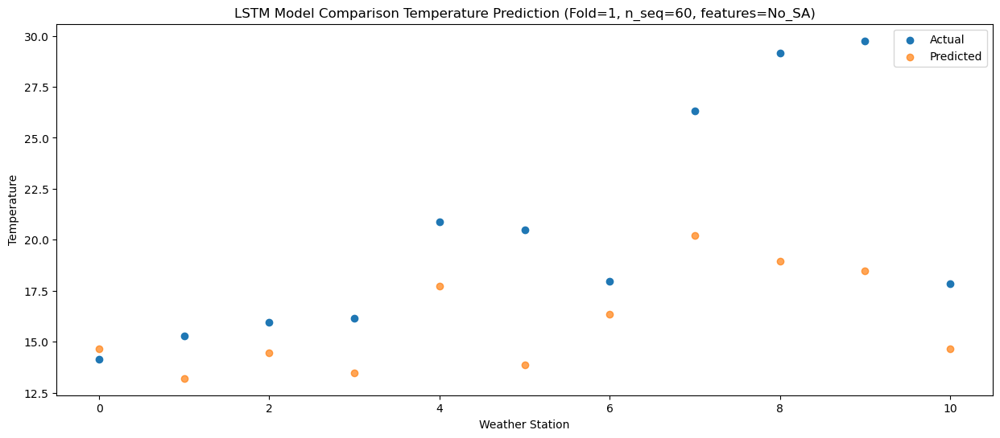

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.69  11.753105
1                 1   11.57  10.323097
2                 2   13.63  11.563105
3                 3   13.56  10.593105
4                 4   17.60  14.833105
5                 5   14.77  10.983106
6                 6   14.67  13.453101
7                 7   24.44  17.343102
8                 8   23.20  16.053106
9                 9   25.20  15.583108
10               10   14.12  11.753104


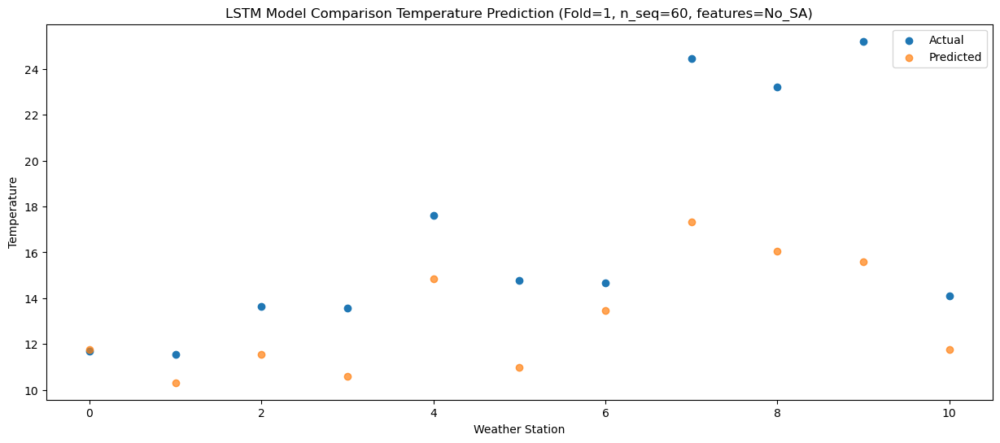

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    6.81   6.729833
1                 1    7.12   5.299825
2                 2    8.63   6.539833
3                 3   10.87   5.569833
4                 4   14.45   9.809833
5                 5   13.62   5.959834
6                 6    9.87   8.429829
7                 7   18.97  12.319830
8                 8   19.34  11.029834
9                 9   20.35  10.559836
10               10    9.25   6.729831


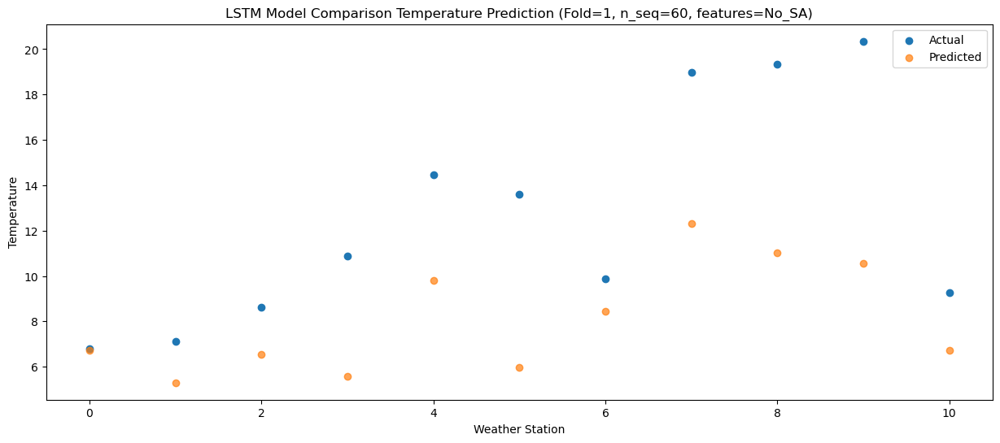

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_12 (LSTM)              (1, 1, 512)               4767744   
                                                                 
 dropout_12 (Dropout)        (1, 1, 512)               0         
                                                                 
 lstm_13 (LSTM)              (1, 512)                  2099200   
                                                                 
 dropout_13 (Dropout)        (1, 512)                  0         
                                                                 
 dense_18 (Dense)            (1, 256)                  131328    
                                                                 
 dense_19 (Dense)            (1, 128)                  32896     
                                                                 
 dense_20 (Dense)            (1, 60)                  

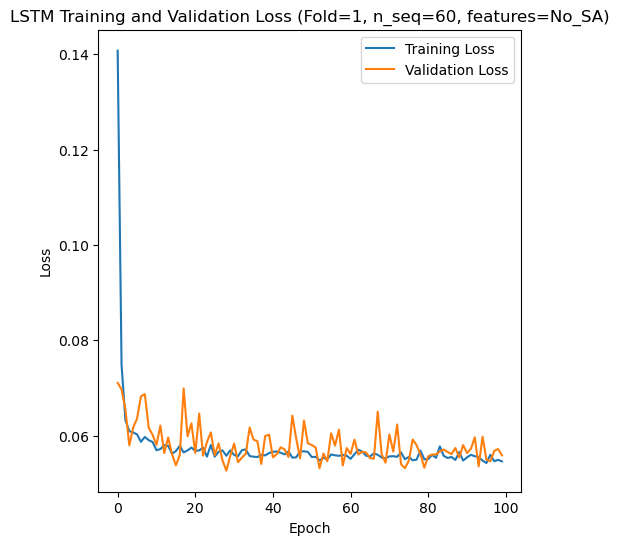

Epoch 1/100
84/84 [==============================] - 17s 68ms/step - loss: 0.1435 - accuracy: 0.2619 - mae: 0.1171 - rmse: 0.1435 - mape: inf - pearson: 0.5945 - val_loss: 0.0606 - val_accuracy: 0.6000 - val_mae: 0.0478 - val_rmse: 0.0606 - val_mape: 11.4093 - val_pearson: 0.8679
Epoch 2/100
84/84 [==============================] - 3s 30ms/step - loss: 0.0728 - accuracy: 0.5000 - mae: 0.0587 - rmse: 0.0728 - mape: inf - pearson: 0.8063 - val_loss: 0.0495 - val_accuracy: 0.6000 - val_mae: 0.0387 - val_rmse: 0.0495 - val_mape: 8.5181 - val_pearson: 0.9030
Epoch 3/100
84/84 [==============================] - 2s 28ms/step - loss: 0.0619 - accuracy: 0.5476 - mae: 0.0493 - rmse: 0.0619 - mape: inf - pearson: 0.8375 - val_loss: 0.0590 - val_accuracy: 0.6000 - val_mae: 0.0474 - val_rmse: 0.0590 - val_mape: 10.5669 - val_pearson: 0.8904
Epoch 4/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0612 - accuracy: 0.5000 - mae: 0.0484 - rmse: 0.0612 - mape: inf - pearson: 0.8401 -

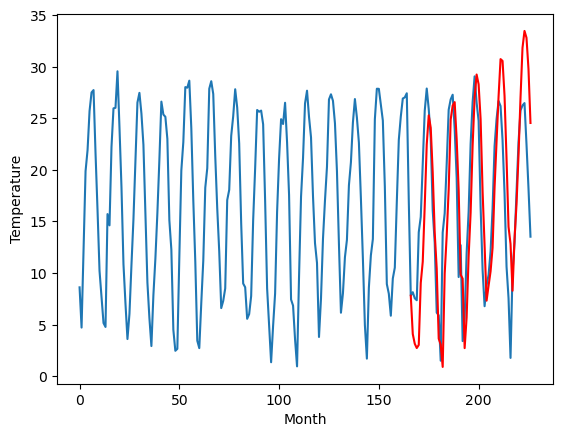

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.57		-1.28		-2.85
-0.71		-2.23		-1.52
-0.95		-2.64		-1.69
-1.68		-2.34		-0.66
6.33		3.66		-2.67
8.56		5.72		-2.84
15.36		11.17		-4.19
22.56		17.08		-5.48
22.59		19.91		-2.68
21.26		18.71		-2.55
15.13		14.37		-0.76
8.14		8.53		0.39
5.02		5.06		0.04
-1.61		-1.73		-0.12
-1.69		-2.30		-0.61
-5.73		-4.47		1.26
4.46		4.57		0.11
8.22		8.25		0.03
13.40		12.73		-0.67
20.65		19.50		-1.15
21.34		20.86		-0.48
22.10		21.19		-0.91
19.86		17.61		-2.25
11.60		12.69		1.09
4.89		4.47		-0.42
2.50		4.08		1.58
-2.19		-2.65		-0.46
-2.20		0.34		2.54
4.78		6.26		1.48
11.46		10.48		-0.98
17.26		16.98		-0.28
21.06		21.64		0.58
24.30		23.87		-0.43
21.99		22.93		0.94
19.23		19.55		0.32
10.85		12.52		1.67
0.86		7.28		6.42
-1.85		1.95		3.80
-2.10		3.40		5.50
-0.50		4.79		5.29
3.57		7.07		3.50
9.43		12.93		3.50
14.92		17.38		2.46
17.53		21.72		4.19
21.63		25.36		3.73
22.12		25.19		3.07
19.25		21.79		2.54
10.21		15.72		5.5

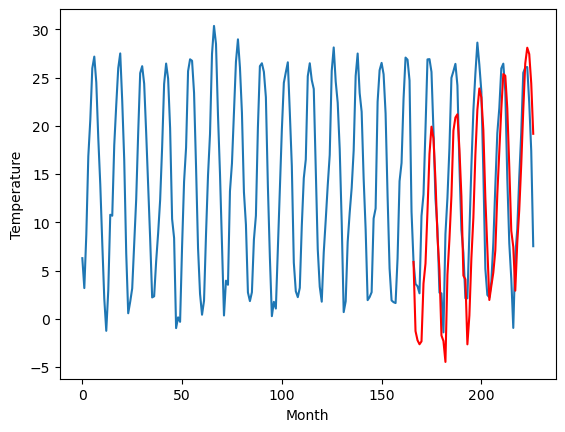

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.66		3.99		-1.67
4.54		3.04		-1.50
3.39		2.63		-0.76
4.43		2.93		-1.50
8.05		8.93		0.88
9.44		10.99		1.55
10.75		16.44		5.69
13.34		22.35		9.01
13.98		25.18		11.20
13.67		23.98		10.31
12.41		19.64		7.23
11.14		13.80		2.66
7.72		10.33		2.61
0.73		3.54		2.81
1.39		2.97		1.58
4.12		0.80		-3.32
5.93		9.84		3.91
7.74		13.52		5.78
11.32		18.00		6.68
12.54		24.77		12.23
13.33		26.13		12.80
13.38		26.46		13.08
12.10		22.88		10.78
10.96		17.96		7.00
4.11		9.74		5.63
5.01		9.35		4.34
0.75		2.62		1.87
3.08		5.61		2.53
6.55		11.53		4.98
8.36		15.75		7.39
11.12		22.25		11.13
12.93		26.91		13.98
13.11		29.14		16.03
12.54		28.20		15.66
11.13		24.82		13.69
8.50		17.79		9.29
6.74		12.55		5.81
2.64		7.22		4.58
2.44		8.67		6.23
5.50		10.06		4.56
6.52		12.34		5.82
9.06		18.20		9.14
10.04		22.65		12.61
12.45		26.99		14.54
14.36		30.63		16.27
14.54		30.46		15.92
12.59		27.06		14.47
9.01		20.99		11.98
5.03		14.38	

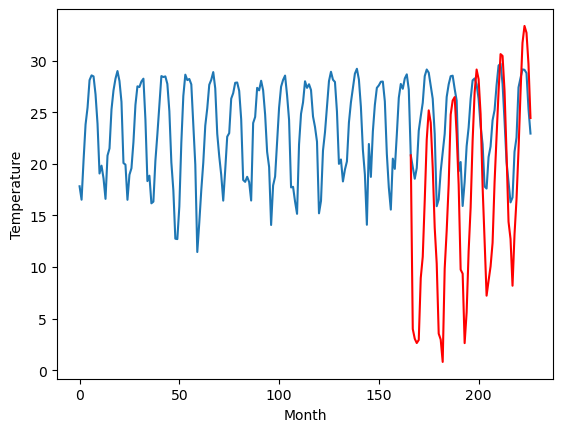

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.01		0.52		0.53
-3.07		-0.43		2.64
-2.80		-0.84		1.96
-2.65		-0.54		2.11
0.90		5.46		4.56
2.13		7.52		5.39
8.02		12.97		4.95
14.08		18.88		4.80
18.36		21.71		3.35
16.51		20.51		4.00
11.93		16.17		4.24
6.71		10.33		3.62
2.75		6.86		4.11
-4.08		0.07		4.15
-7.16		-0.50		6.66
-7.14		-2.67		4.47
-3.03		6.37		9.40
1.47		10.05		8.58
6.73		14.53		7.80
12.30		21.30		9.00
14.30		22.66		8.36
15.36		22.99		7.63
12.19		19.41		7.22
8.36		14.49		6.13
0.28		6.27		5.99
-1.64		5.88		7.52
-7.79		-0.85		6.94
-5.47		2.14		7.61
-1.61		8.06		9.67
2.83		12.28		9.45
8.17		18.78		10.61
12.41		23.44		11.03
17.03		25.67		8.64
16.95		24.73		7.78
11.91		21.35		9.44
6.47		14.32		7.85
2.67		9.08		6.41
-3.50		3.75		7.25
-2.21		5.20		7.41
-4.09		6.59		10.68
-1.65		8.87		10.52
4.07		14.73		10.66
7.70		19.18		11.48
11.49		23.52		12.03
17.06		27.16		10.10
15.05		26.99		11.94
12.63		23.59		10.96
7.61		17.52		9.91
-0.37		10.91		

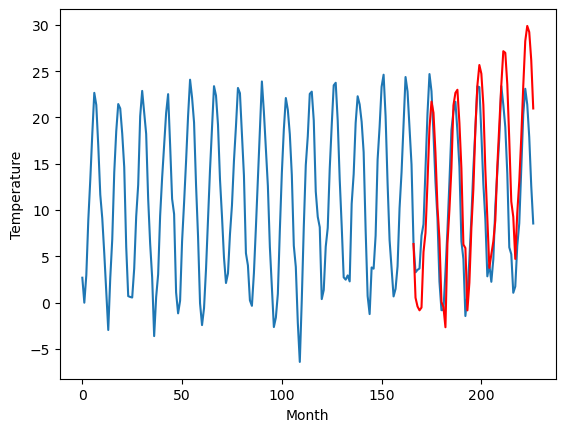

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.32		0.56		0.88
0.03		-0.39		-0.42
0.37		-0.80		-1.17
1.01		-0.50		-1.51
7.70		5.50		-2.20
7.17		7.56		0.39
10.14		13.01		2.87
13.18		18.92		5.74
13.92		21.75		7.83
14.29		20.55		6.26
11.94		16.21		4.27
8.25		10.37		2.12
4.13		6.90		2.77
-2.17		0.11		2.28
-1.82		-0.46		1.36
-2.56		-2.63		-0.07
4.77		6.41		1.64
5.64		10.09		4.45
10.11		14.57		4.46
13.59		21.34		7.75
14.18		22.70		8.52
14.35		23.03		8.68
11.81		19.45		7.64
9.07		14.53		5.46
0.80		6.31		5.51
4.21		5.92		1.71
-3.52		-0.81		2.71
-0.38		2.18		2.56
3.38		8.10		4.72
7.18		12.32		5.14
12.34		18.82		6.48
14.93		23.48		8.55
14.76		25.71		10.95
13.94		24.77		10.83
11.97		21.39		9.42
5.78		14.36		8.58
2.71		9.12		6.41
0.20		3.79		3.59
1.37		5.24		3.87
3.50		6.63		3.13
5.33		8.91		3.58
7.25		14.77		7.52
11.28		19.22		7.94
14.93		23.56		8.63
16.37		27.20		10.83
17.67		27.03		9.36
13.24		23.63		10.39
7.08		17.56		10.48
1.97		10.95		8.98
-0

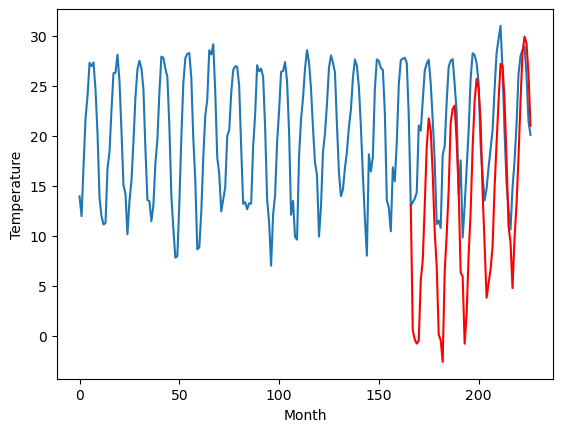

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.39		-1.77		-1.38
-1.82		-2.72		-0.90
-1.45		-3.13		-1.68
-2.21		-2.83		-0.62
5.88		3.17		-2.71
5.85		5.23		-0.62
9.69		10.68		0.99
13.30		16.59		3.29
15.00		19.42		4.42
15.30		18.22		2.92
10.90		13.88		2.98
6.43		8.04		1.61
3.75		4.57		0.82
-2.36		-2.22		0.14
-2.95		-2.79		0.16
-5.30		-4.96		0.34
3.08		4.08		1.00
5.20		7.76		2.56
9.24		12.24		3.00
13.79		19.01		5.22
13.87		20.37		6.50
14.98		20.70		5.72
12.24		17.12		4.88
8.94		12.20		3.26
1.30		3.98		2.68
4.54		3.59		-0.95
-3.89		-3.14		0.75
-4.27		-0.15		4.12
1.85		5.77		3.92
8.00		9.99		1.99
12.60		16.49		3.89
16.32		21.15		4.83
17.68		23.38		5.70
14.96		22.44		7.48
12.30		19.06		6.76
6.73		12.03		5.30
0.85		6.79		5.94
-1.38		1.46		2.84
-0.62		2.91		3.53
0.57		4.30		3.73
4.37		6.58		2.21
5.29		12.44		7.15
10.37		16.89		6.52
15.29		21.23		5.94
17.45		24.87		7.42
19.15		24.70		5.55
14.67		21.30		6.63
6.78		15.23		8.45
0.50		8.62		8.12
-1.

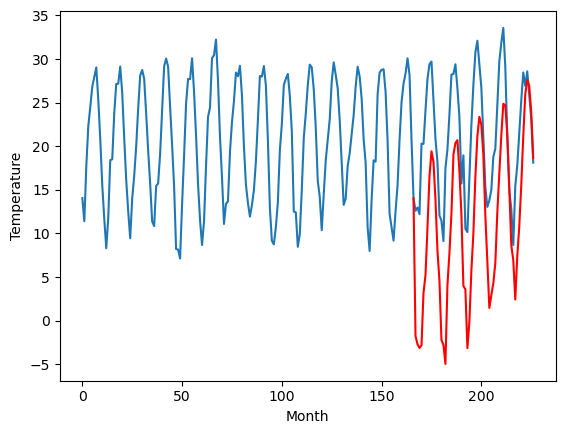

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
10.42		9.77		-0.65
8.61		8.82		0.21
8.96		8.41		-0.55
8.40		8.71		0.31
16.05		14.71		-1.34
16.36		16.77		0.41
21.26		22.22		0.96
26.00		28.13		2.13
27.18		30.96		3.78
27.41		29.76		2.35
21.47		25.42		3.95
15.99		19.58		3.59
13.50		16.11		2.61
7.04		9.32		2.28
6.34		8.75		2.41
3.23		6.58		3.35
13.60		15.62		2.02
15.30		19.30		4.00
19.38		23.78		4.40
24.94		30.55		5.61
25.83		31.91		6.08
26.39		32.24		5.85
24.12		28.66		4.54
19.61		23.74		4.13
11.64		15.52		3.88
13.93		15.13		1.20
5.45		8.40		2.95
5.28		11.39		6.11
11.86		17.31		5.45
18.13		21.53		3.40
23.15		28.03		4.88
27.86		32.69		4.83
30.65		34.92		4.27
27.84		33.98		6.14
24.01		30.60		6.59
17.63		23.57		5.94
10.96		18.33		7.37
8.34		13.00		4.66
9.22		14.45		5.23
9.41		15.84		6.43
14.06		18.12		4.06
15.88		23.98		8.10
21.62		28.43		6.81
25.77		32.77		7.00
28.33		36.41		8.08
30.67		36.24		5.57
25.89		32.84		6.95
17.17		26.77		9.60
11.83		20

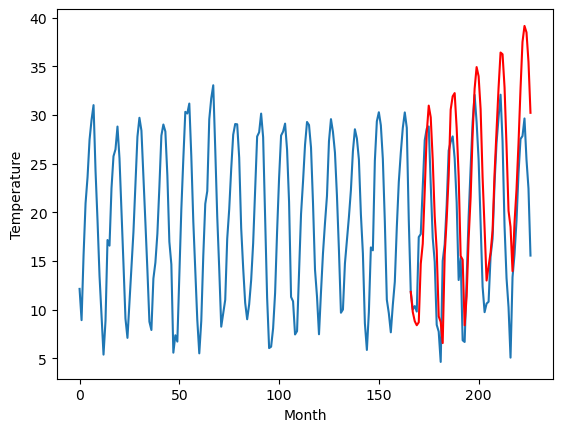

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.43		-5.37		-1.94
-7.96		-6.32		1.64
-6.71		-6.73		-0.02
-5.90		-6.43		-0.53
-1.40		-0.43		0.97
3.58		1.63		-1.95
9.87		7.08		-2.79
13.39		12.99		-0.40
15.49		15.82		0.33
15.93		14.62		-1.31
9.68		10.28		0.60
4.08		4.44		0.36
-1.48		0.97		2.45
-9.13		-5.82		3.31
-8.59		-6.39		2.20
-5.67		-8.56		-2.89
-2.57		0.48		3.05
4.09		4.16		0.07
9.10		8.64		-0.46
14.09		15.41		1.32
12.89		16.77		3.88
12.37		17.10		4.73
10.19		13.52		3.33
3.63		8.60		4.97
-1.77		0.38		2.15
-5.12		-0.01		5.11
-8.12		-6.74		1.38
-7.15		-3.75		3.40
-2.09		2.17		4.26
5.10		6.39		1.29
9.80		12.89		3.09
13.66		17.55		3.89
14.80		19.78		4.98
11.78		18.84		7.06
10.05		15.46		5.41
1.84		8.43		6.59
-5.05		3.19		8.24
-7.22		-2.14		5.08
-7.93		-0.69		7.24
-6.72		0.70		7.42
-2.02		2.98		5.00
3.62		8.84		5.22
8.27		13.29		5.02
12.93		17.63		4.70
17.68		21.27		3.59
14.68		21.10		6.42
12.02		17.70		5.68
5.28		11.63		6.35
-1.83		5.02		

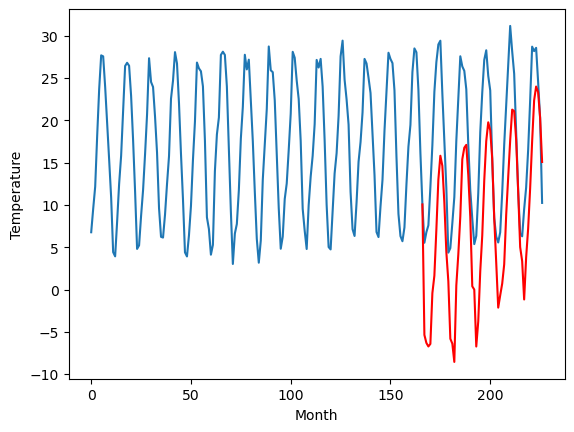

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.34		5.89		-3.45
5.80		4.94		-0.86
6.34		4.53		-1.81
8.45		4.83		-3.62
8.52		10.83		2.31
11.73		12.89		1.16
15.78		18.34		2.56
17.07		24.25		7.18
19.48		27.08		7.60
21.88		25.88		4.00
20.28		21.54		1.26
17.04		15.70		-1.34
10.32		12.23		1.91
8.27		5.44		-2.83
8.21		4.87		-3.34
7.29		2.70		-4.59
6.89		11.74		4.85
10.75		15.42		4.67
12.97		19.90		6.93
17.21		26.67		9.46
20.19		28.03		7.84
19.79		28.36		8.57
18.01		24.78		6.77
13.03		19.86		6.83
11.77		11.64		-0.13
5.26		11.25		5.99
7.67		4.52		-3.15
8.54		7.51		-1.03
10.33		13.43		3.10
12.45		17.65		5.20
13.41		24.15		10.74
18.33		28.81		10.48
19.14		31.04		11.90
21.18		30.10		8.92
20.77		26.72		5.95
14.50		19.69		5.19
8.27		14.45		6.18
5.57		9.12		3.55
5.23		10.57		5.34
4.91		11.96		7.05
5.92		14.24		8.32
9.76		20.10		10.34
10.97		24.55		13.58
12.93		28.89		15.96
19.85		32.53		12.68
19.48		32.36		12.88
15.98		28.96		12.98
14.39		22.89		8.50
1

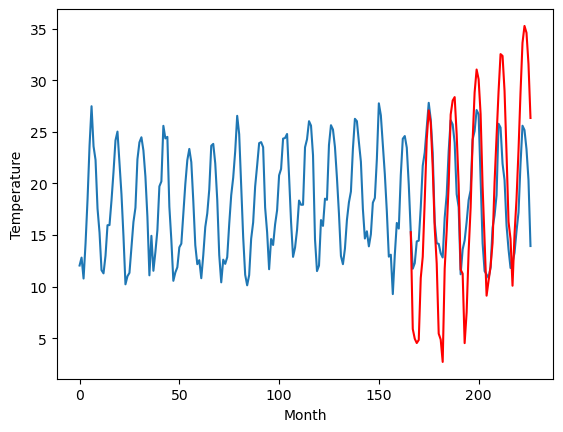

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		6.00		1.95
3.64		5.05		1.41
3.35		4.64		1.29
4.39		4.94		0.55
9.62		10.94		1.32
10.92		13.00		2.08
13.52		18.45		4.93
18.81		24.36		5.55
21.80		27.19		5.39
20.80		25.99		5.19
16.77		21.65		4.88
12.85		15.81		2.96
8.24		12.34		4.10
1.24		5.55		4.31
0.83		4.98		4.15
1.33		2.81		1.48
8.21		11.85		3.64
11.00		15.53		4.53
15.02		20.01		4.99
19.31		26.78		7.47
20.88		28.14		7.26
20.97		28.47		7.50
16.86		24.89		8.03
13.58		19.97		6.39
4.67		11.75		7.08
6.59		11.36		4.77
0.11		4.63		4.52
4.13		7.62		3.49
8.24		13.54		5.30
11.53		17.76		6.23
16.38		24.26		7.88
20.14		28.92		8.78
21.58		31.15		9.57
20.20		30.21		10.01
16.89		26.83		9.94
9.58		19.80		10.22
7.46		14.56		7.10
0.93		9.23		8.30
4.13		10.68		6.55
7.15		12.07		4.92
7.60		14.35		6.75
11.12		20.21		9.09
13.90		24.66		10.76
17.56		29.00		11.44
21.15		32.64		11.49
20.60		32.47		11.87
16.64		29.07		12.43
11.35		23.00		11.65
5.45		16.39		10

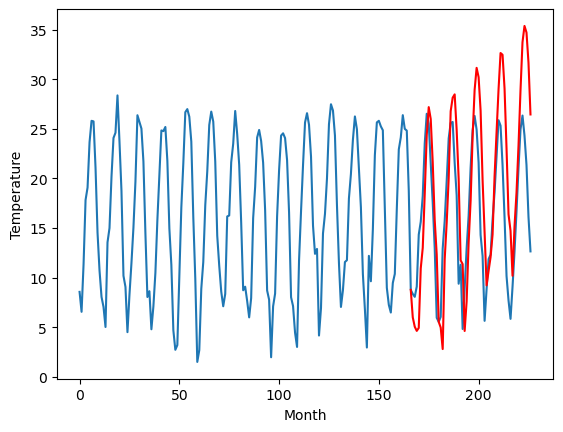

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		4.09		2.44
2.25		3.14		0.89
1.81		2.73		0.92
1.61		3.03		1.42
7.65		9.03		1.38
8.08		11.09		3.01
12.12		16.54		4.42
17.49		22.45		4.96
20.78		25.28		4.50
19.52		24.08		4.56
15.57		19.74		4.17
10.91		13.90		2.99
5.86		10.43		4.57
-1.20		3.64		4.84
-0.87		3.07		3.94
0.48		0.90		0.42
6.69		9.94		3.25
8.66		13.62		4.96
13.57		18.10		4.53
18.98		24.87		5.89
20.29		26.23		5.94
20.37		26.56		6.19
15.88		22.98		7.10
12.12		18.06		5.94
1.90		9.84		7.94
4.00		9.45		5.45
-2.87		2.72		5.59
1.72		5.71		3.99
6.27		11.63		5.36
9.43		15.85		6.42
15.67		22.35		6.68
19.32		27.01		7.69
20.67		29.24		8.57
19.42		28.30		8.88
15.27		24.92		9.65
7.99		17.89		9.90
5.54		12.65		7.11
0.08		7.32		7.24
2.00		8.77		6.77
4.79		10.16		5.37
5.32		12.44		7.12
10.21		18.30		8.09
13.56		22.75		9.19
16.47		27.09		10.62
20.02		30.73		10.71
19.31		30.56		11.25
16.53		27.16		10.63
10.48		21.09		10.61
4.27		14.48		10.21
1.42

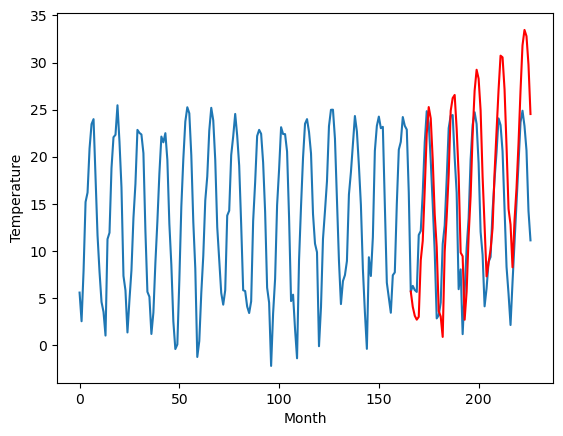

RangeIndex(start=1, stop=12, step=1)
[2.9200000000000017, 1.5699999999999985, 5.66, -0.009999999999999787, -0.3200000000000003, -0.39000000000000057, 10.42, -3.430000000000002, 9.339999999999996, 4.050000000000001, 1.6500000000000021]
[4.089090957641602, -1.2809090423583989, 3.9890909576416007, 0.5190909576416018, 0.559090957641601, -1.7709090423583982, 9.769090957641602, -5.370909042358399, 5.889090957641601, 5.999090957641602, 4.089090957641602]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.92   4.089091
1                 1    1.57  -1.280909
2                 2    5.66   3.989091
3                 3   -0.01   0.519091
4                 4   -0.32   0.559091
5                 5   -0.39  -1.770909
6                 6   10.42   9.769091
7                 7   -3.43  -5.370909
8                 8    9.34   5.889091
9                 9    4.05   5.999091
10               10    1.65   4.089091


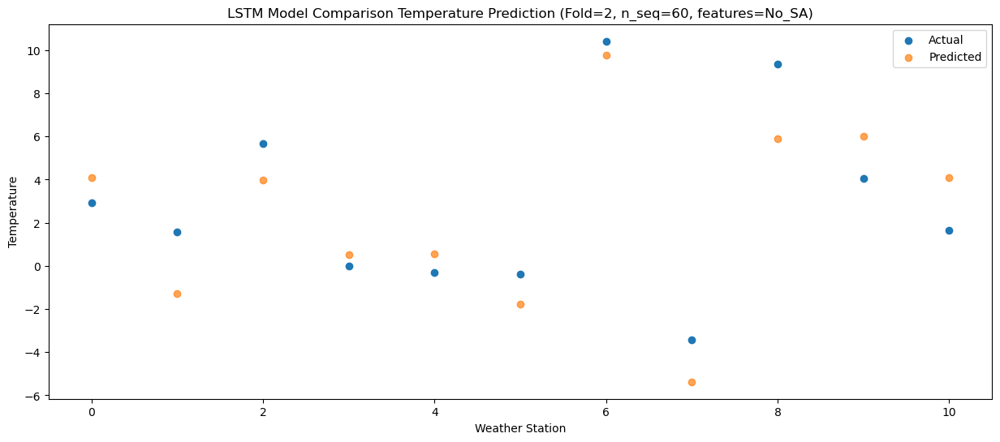

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    3.26   3.143128
1                 1   -0.71  -2.226872
2                 2    4.54   3.043128
3                 3   -3.07  -0.426872
4                 4    0.03  -0.386872
5                 5   -1.82  -2.716872
6                 6    8.61   8.823128
7                 7   -7.96  -6.316872
8                 8    5.80   4.943128
9                 9    3.64   5.053128
10               10    2.25   3.143128


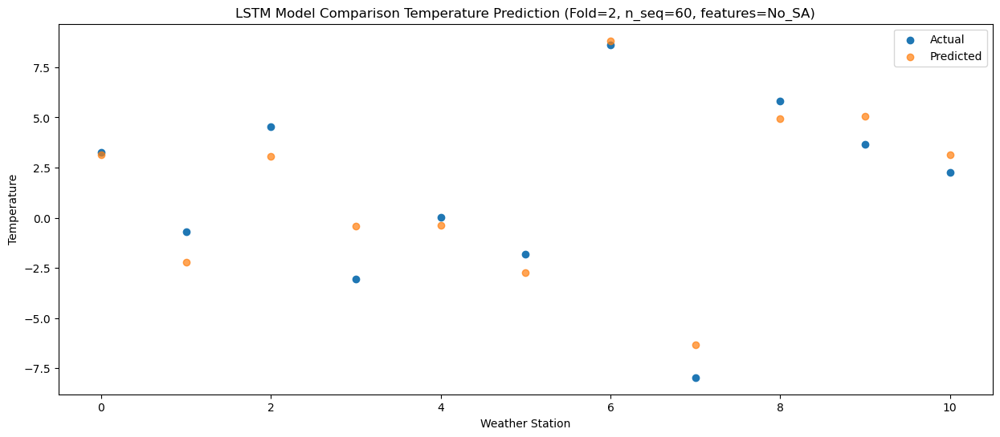

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    2.67   2.727534
1                 1   -0.95  -2.642466
2                 2    3.39   2.627534
3                 3   -2.80  -0.842466
4                 4    0.37  -0.802466
5                 5   -1.45  -3.132466
6                 6    8.96   8.407533
7                 7   -6.71  -6.732466
8                 8    6.34   4.527534
9                 9    3.35   4.637534
10               10    1.81   2.727534


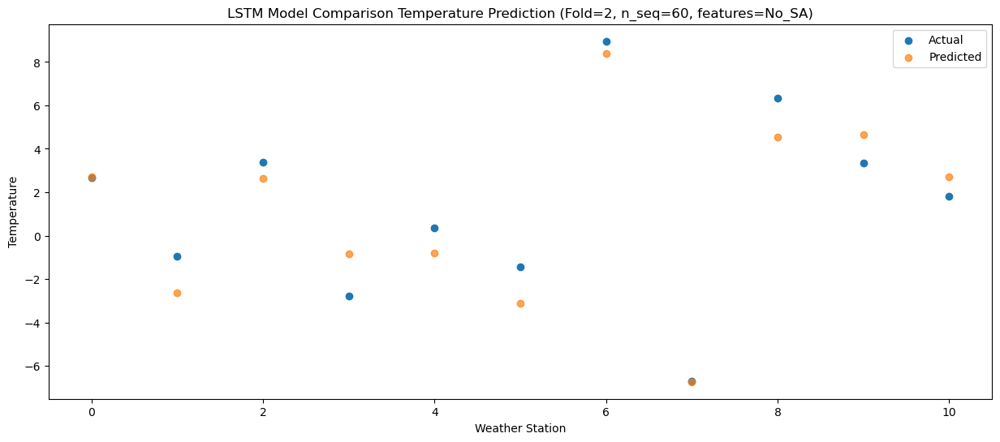

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    2.48   3.026893
1                 1   -1.68  -2.343107
2                 2    4.43   2.926893
3                 3   -2.65  -0.543107
4                 4    1.01  -0.503107
5                 5   -2.21  -2.833107
6                 6    8.40   8.706892
7                 7   -5.90  -6.433107
8                 8    8.45   4.826893
9                 9    4.39   4.936893
10               10    1.61   3.026893


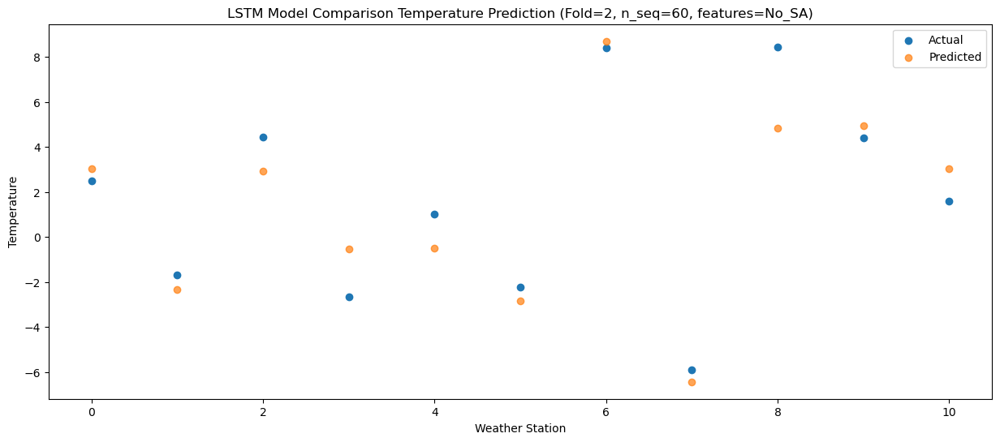

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    9.07   9.029632
1                 1    6.33   3.659632
2                 2    8.05   8.929632
3                 3    0.90   5.459632
4                 4    7.70   5.499632
5                 5    5.88   3.169632
6                 6   16.05  14.709631
7                 7   -1.40  -0.430368
8                 8    8.52  10.829632
9                 9    9.62  10.939634
10               10    7.65   9.029632


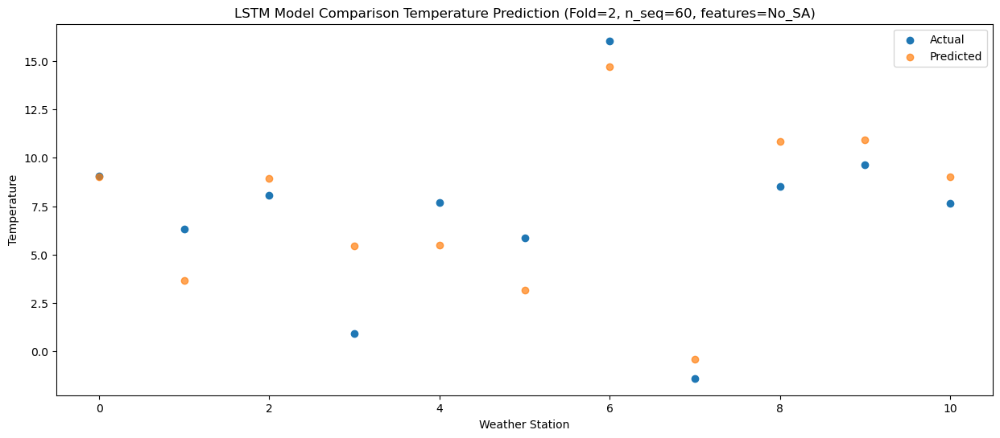

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   10.55  11.089199
1                 1    8.56   5.719199
2                 2    9.44  10.989196
3                 3    2.13   7.519196
4                 4    7.17   7.559196
5                 5    5.85   5.229199
6                 6   16.36  16.769198
7                 7    3.58   1.629196
8                 8   11.73  12.889196
9                 9   10.92  12.999198
10               10    8.08  11.089196


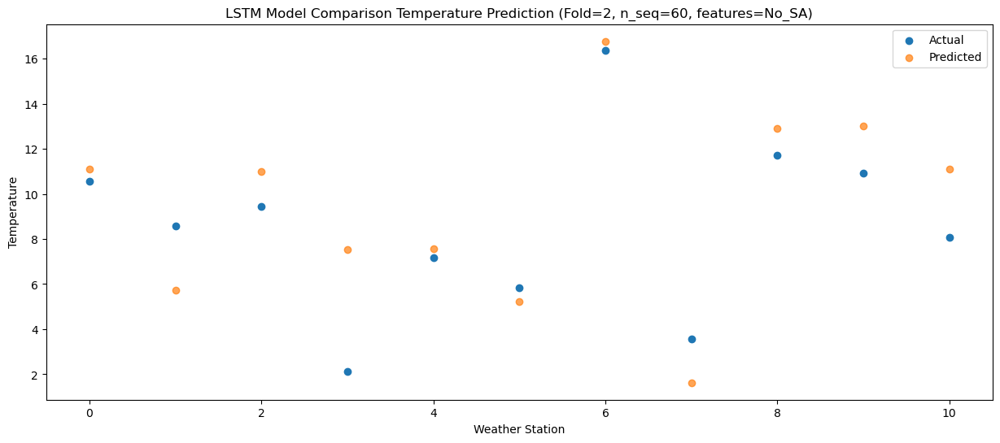

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   15.84  16.540917
1                 1   15.36  11.170917
2                 2   10.75  16.440915
3                 3    8.02  12.970915
4                 4   10.14  13.010915
5                 5    9.69  10.680917
6                 6   21.26  22.220916
7                 7    9.87   7.080915
8                 8   15.78  18.340915
9                 9   13.52  18.450917
10               10   12.12  16.540915


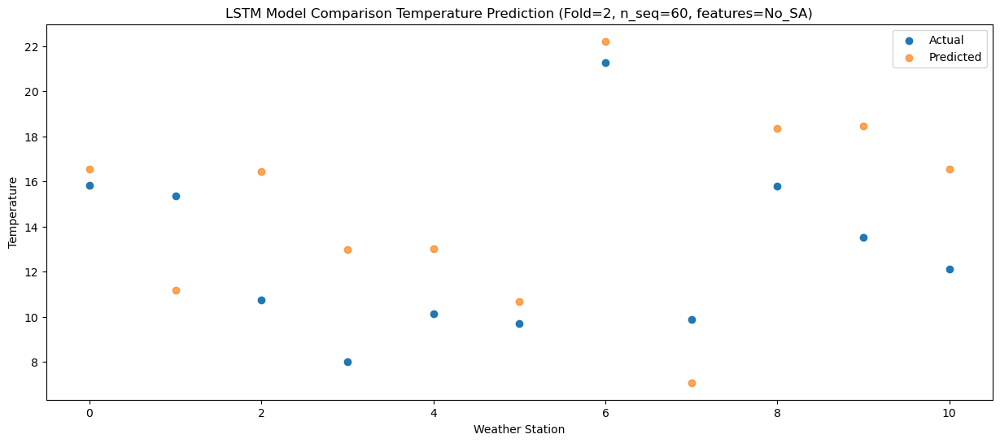

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   20.84  22.449663
1                 1   22.56  17.079663
2                 2   13.34  22.349660
3                 3   14.08  18.879660
4                 4   13.18  18.919660
5                 5   13.30  16.589663
6                 6   26.00  28.129662
7                 7   13.39  12.989660
8                 8   17.07  24.249660
9                 9   18.81  24.359662
10               10   17.49  22.449660


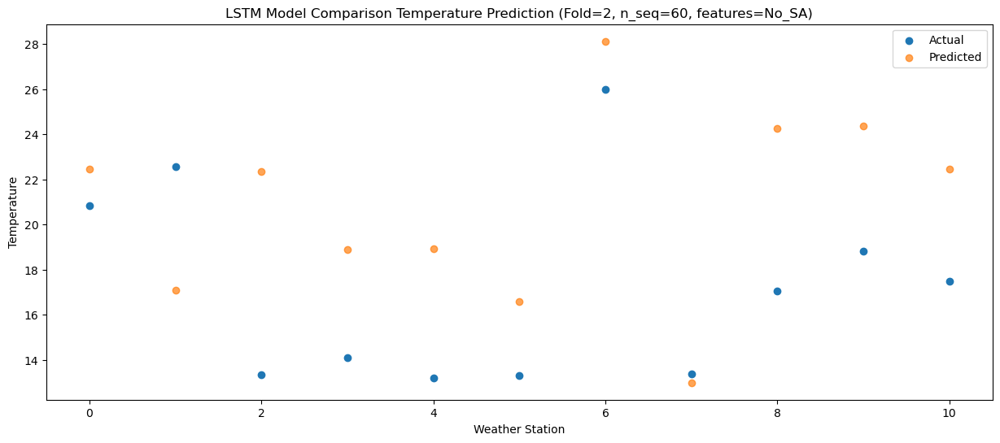

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   23.00  25.278949
1                 1   22.59  19.908949
2                 2   13.98  25.178947
3                 3   18.36  21.708947
4                 4   13.92  21.748947
5                 5   15.00  19.418949
6                 6   27.18  30.958948
7                 7   15.49  15.818947
8                 8   19.48  27.078947
9                 9   21.80  27.188948
10               10   20.78  25.278947


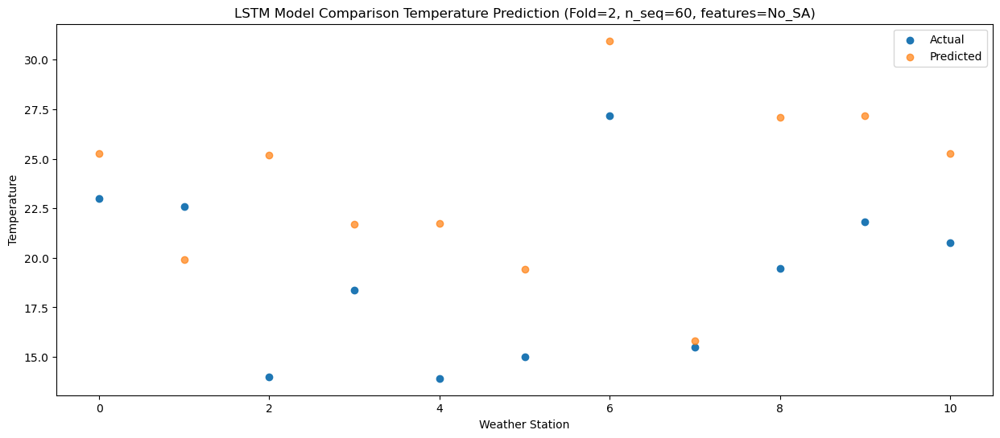

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   21.02  24.081467
1                 1   21.26  18.711466
2                 2   13.67  23.981464
3                 3   16.51  20.511464
4                 4   14.29  20.551464
5                 5   15.30  18.221466
6                 6   27.41  29.761465
7                 7   15.93  14.621464
8                 8   21.88  25.881464
9                 9   20.80  25.991466
10               10   19.52  24.081464


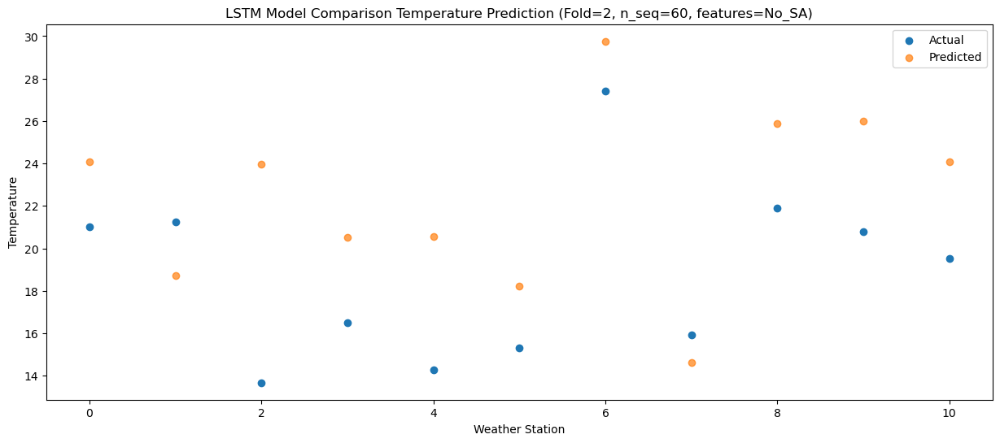

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   18.18  19.740352
1                 1   15.13  14.370351
2                 2   12.41  19.640350
3                 3   11.93  16.170349
4                 4   11.94  16.210349
5                 5   10.90  13.880351
6                 6   21.47  25.420350
7                 7    9.68  10.280350
8                 8   20.28  21.540350
9                 9   16.77  21.650352
10               10   15.57  19.740350


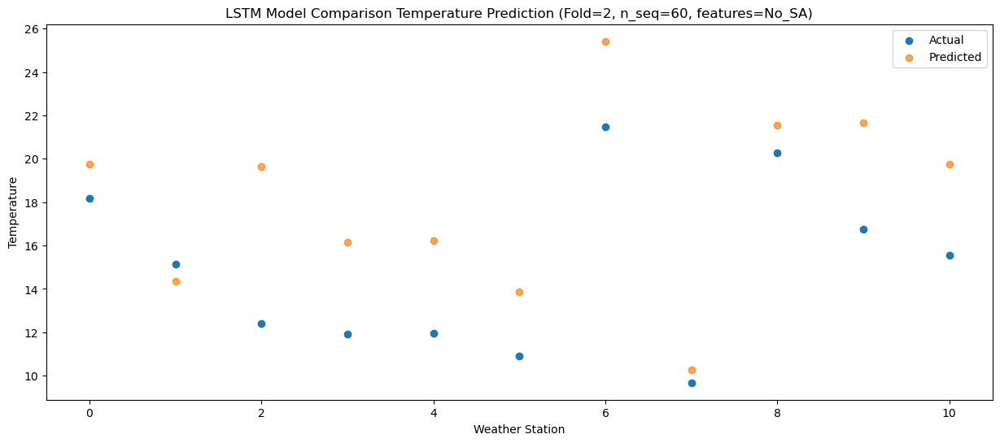

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   11.17  13.901184
1                 1    8.14   8.531183
2                 2   11.14  13.801182
3                 3    6.71  10.331181
4                 4    8.25  10.371181
5                 5    6.43   8.041183
6                 6   15.99  19.581182
7                 7    4.08   4.441182
8                 8   17.04  15.701182
9                 9   12.85  15.811184
10               10   10.91  13.901182


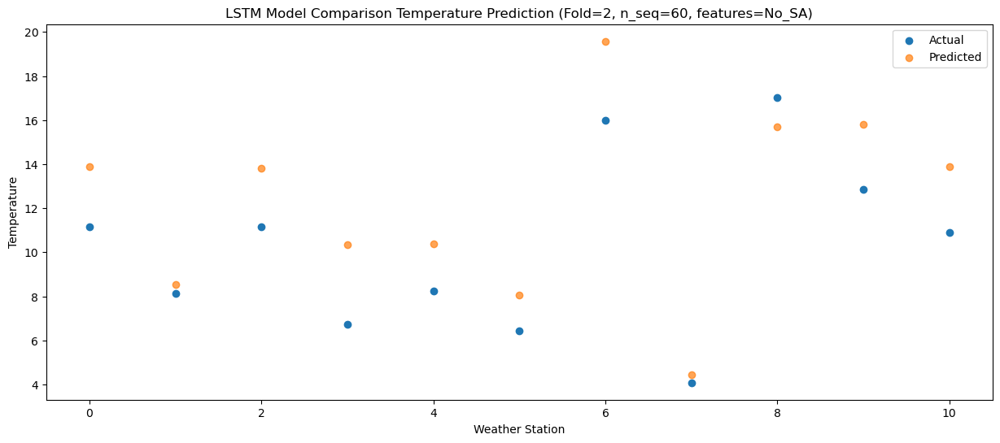

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    8.04  10.429826
1                 1    5.02   5.059825
2                 2    7.72  10.329824
3                 3    2.75   6.859823
4                 4    4.13   6.899823
5                 5    3.75   4.569825
6                 6   13.50  16.109824
7                 7   -1.48   0.969824
8                 8   10.32  12.229824
9                 9    8.24  12.339825
10               10    5.86  10.429824


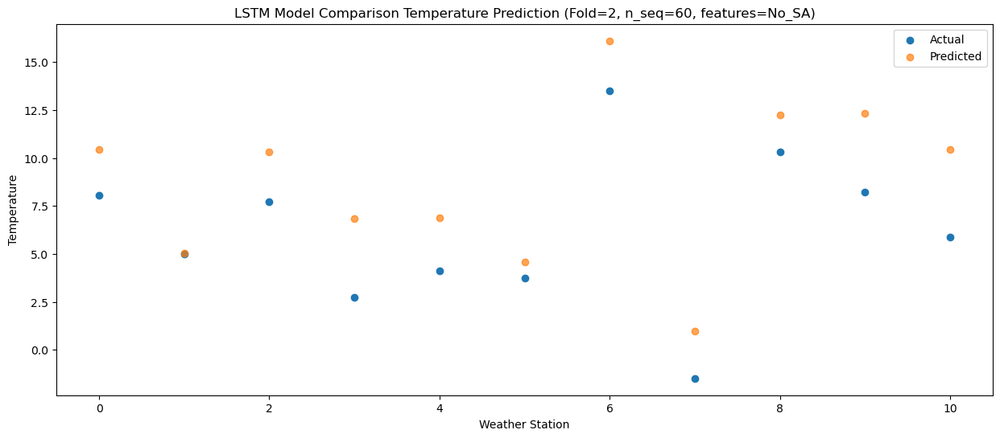

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.28   3.637470
1                 1   -1.61  -1.732531
2                 2    0.73   3.537468
3                 3   -4.08   0.067467
4                 4   -2.17   0.107467
5                 5   -2.36  -2.222531
6                 6    7.04   9.317468
7                 7   -9.13  -5.822532
8                 8    8.27   5.437467
9                 9    1.24   5.547469
10               10   -1.20   3.637468


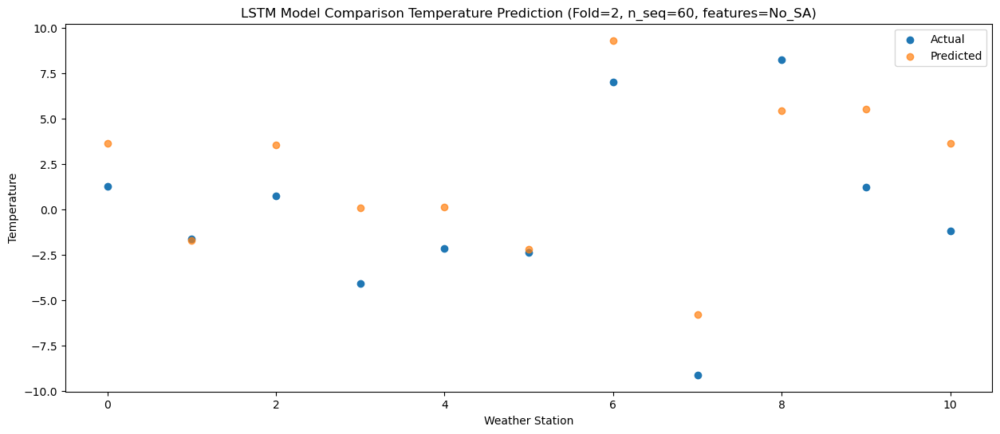

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.02   3.066217
1                 1   -1.69  -2.303784
2                 2    1.39   2.966216
3                 3   -7.16  -0.503785
4                 4   -1.82  -0.463785
5                 5   -2.95  -2.793784
6                 6    6.34   8.746215
7                 7   -8.59  -6.393784
8                 8    8.21   4.866215
9                 9    0.83   4.976218
10               10   -0.87   3.066216


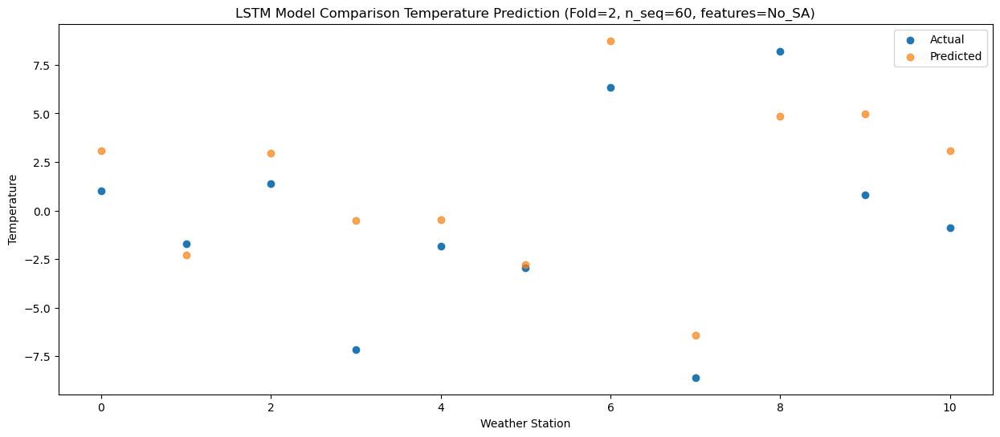

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.38   0.897196
1                 1   -5.73  -4.472805
2                 2    4.12   0.797196
3                 3   -7.14  -2.672806
4                 4   -2.56  -2.632806
5                 5   -5.30  -4.962805
6                 6    3.23   6.577194
7                 7   -5.67  -8.562805
8                 8    7.29   2.697194
9                 9    1.33   2.807197
10               10    0.48   0.897195


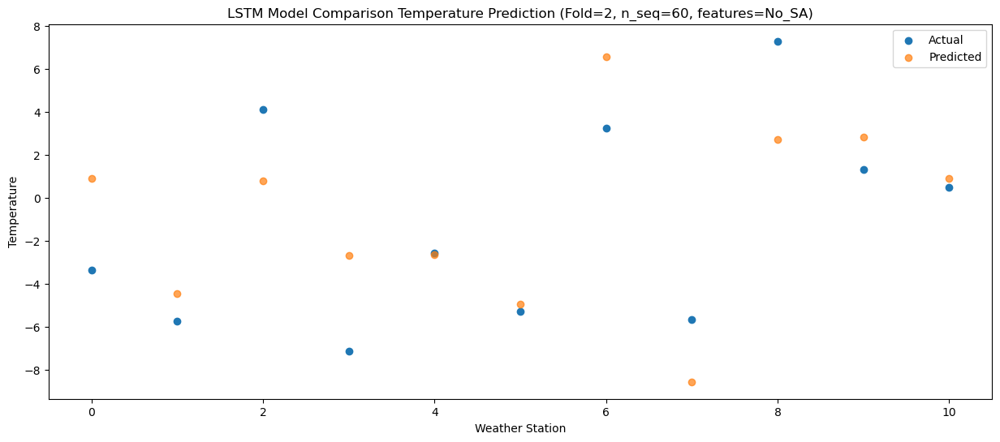

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    9.04   9.941799
1                 1    4.46   4.571798
2                 2    5.93   9.841801
3                 3   -3.03   6.371799
4                 4    4.77   6.411797
5                 5    3.08   4.081798
6                 6   13.60  15.621797
7                 7   -2.57   0.481800
8                 8    6.89  11.741799
9                 9    8.21  11.851802
10               10    6.69   9.941800


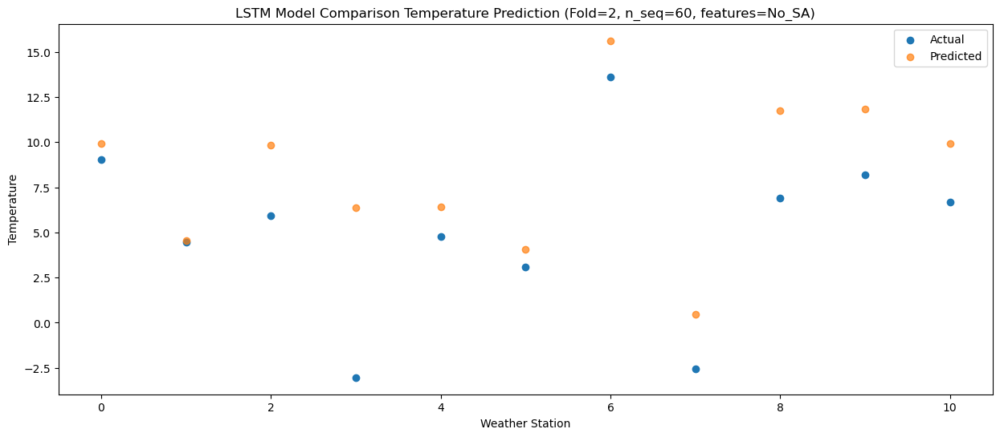

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   10.91  13.619320
1                 1    8.22   8.249319
2                 2    7.74  13.519322
3                 3    1.47  10.049320
4                 4    5.64  10.089320
5                 5    5.20   7.759319
6                 6   15.30  19.299318
7                 7    4.09   4.159321
8                 8   10.75  15.419320
9                 9   11.00  15.529323
10               10    8.66  13.619321


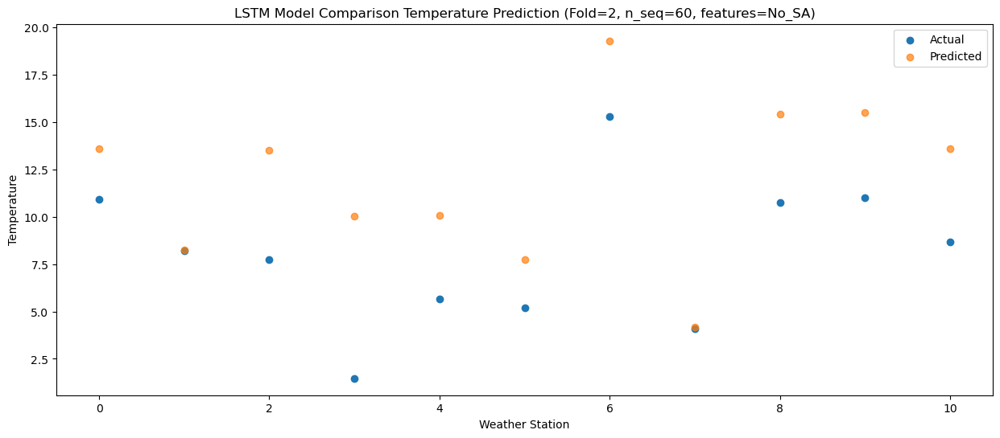

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   15.69  18.100862
1                 1   13.40  12.730862
2                 2   11.32  18.000864
3                 3    6.73  14.530860
4                 4   10.11  14.570862
5                 5    9.24  12.240862
6                 6   19.38  23.780862
7                 7    9.10   8.640863
8                 8   12.97  19.900862
9                 9   15.02  20.010863
10               10   13.57  18.100863


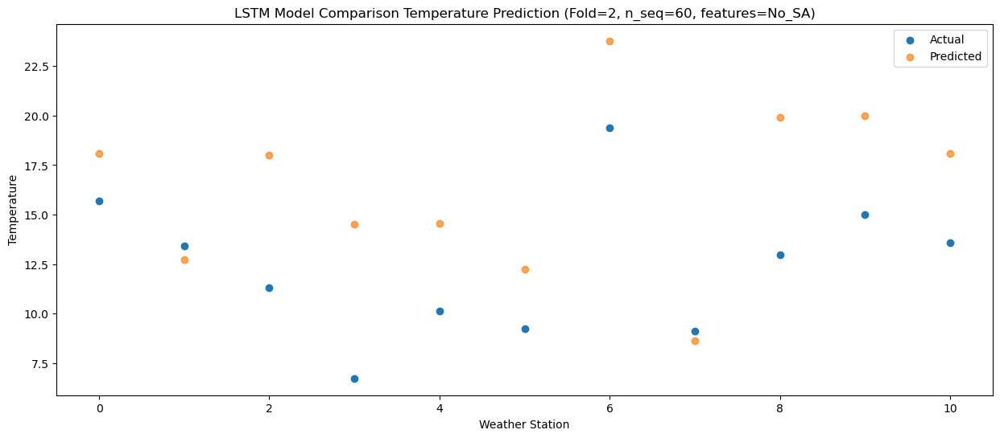

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   20.94  24.868823
1                 1   20.65  19.498822
2                 2   12.54  24.768825
3                 3   12.30  21.298821
4                 4   13.59  21.338823
5                 5   13.79  19.008822
6                 6   24.94  30.548823
7                 7   14.09  15.408824
8                 8   17.21  26.668823
9                 9   19.31  26.778824
10               10   18.98  24.868824


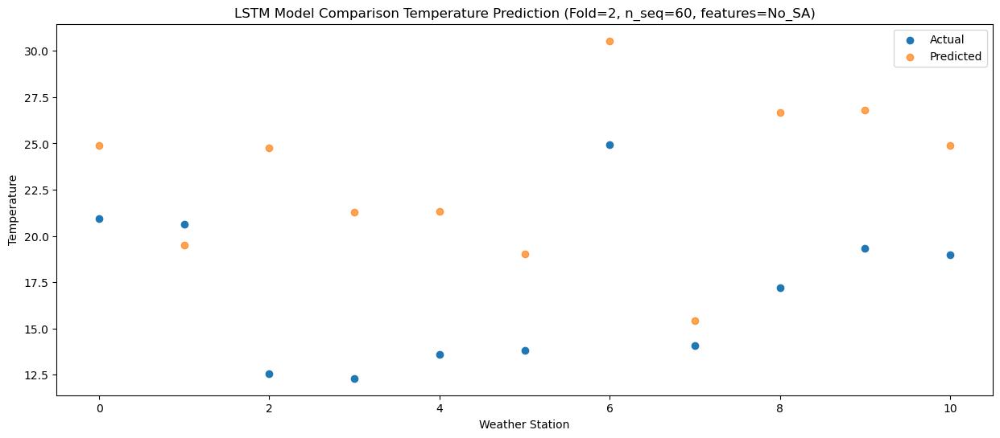

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   21.95  26.229247
1                 1   21.34  20.859248
2                 2   13.33  26.129251
3                 3   14.30  22.659245
4                 4   14.18  22.699249
5                 5   13.87  20.369248
6                 6   25.83  31.909249
7                 7   12.89  16.769250
8                 8   20.19  28.029247
9                 9   20.88  28.139250
10               10   20.29  26.229250


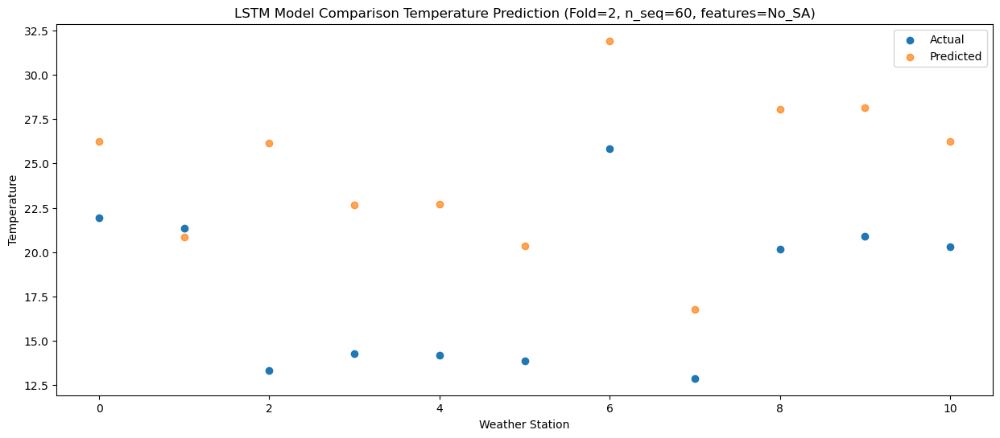

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   22.40  26.564899
1                 1   22.10  21.194900
2                 2   13.38  26.464902
3                 3   15.36  22.994896
4                 4   14.35  23.034901
5                 5   14.98  20.704898
6                 6   26.39  32.244901
7                 7   12.37  17.104901
8                 8   19.79  28.364898
9                 9   20.97  28.474901
10               10   20.37  26.564901


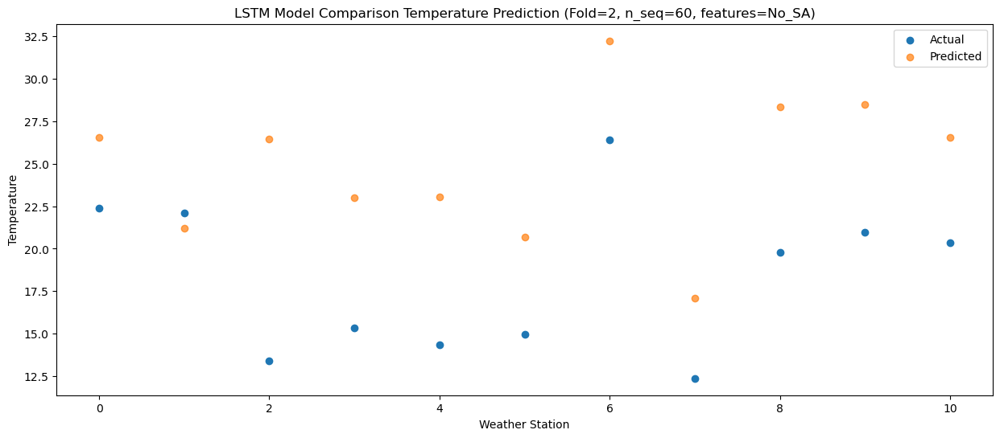

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.10  22.975689
1                 1   19.86  17.605690
2                 2   12.10  22.875692
3                 3   12.19  19.405685
4                 4   11.81  19.445690
5                 5   12.24  17.115688
6                 6   24.12  28.655690
7                 7   10.19  13.515691
8                 8   18.01  24.775687
9                 9   16.86  24.885691
10               10   15.88  22.975691


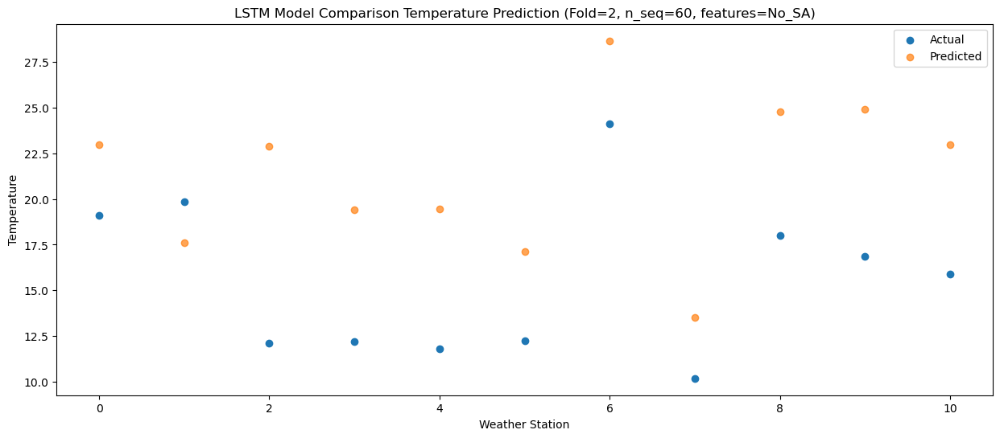

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   14.35  18.062784
1                 1   11.60  12.692785
2                 2   10.96  17.962788
3                 3    8.36  14.492781
4                 4    9.07  14.532786
5                 5    8.94  12.202783
6                 6   19.61  23.742786
7                 7    3.63   8.602786
8                 8   13.03  19.862783
9                 9   13.58  19.972786
10               10   12.12  18.062786


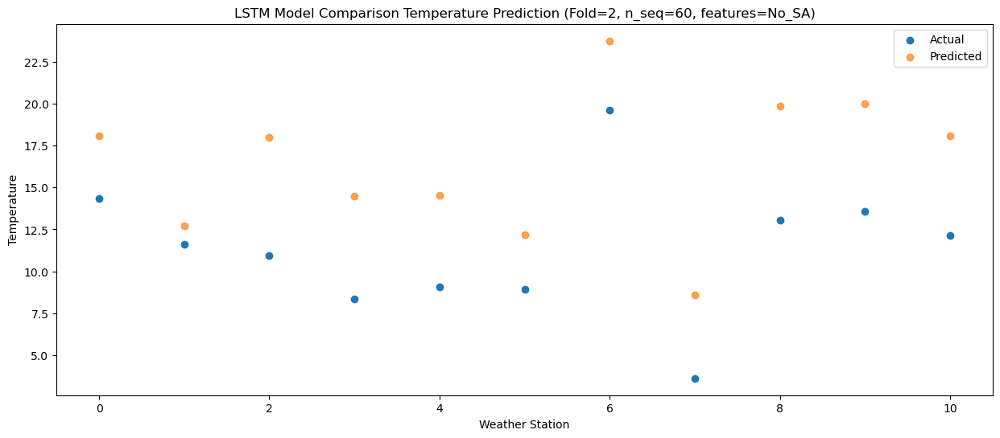

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    4.73   9.839951
1                 1    4.89   4.469952
2                 2    4.11   9.739956
3                 3    0.28   6.269948
4                 4    0.80   6.309953
5                 5    1.30   3.979950
6                 6   11.64  15.519953
7                 7   -1.77   0.379954
8                 8   11.77  11.639950
9                 9    4.67  11.749954
10               10    1.90   9.839954


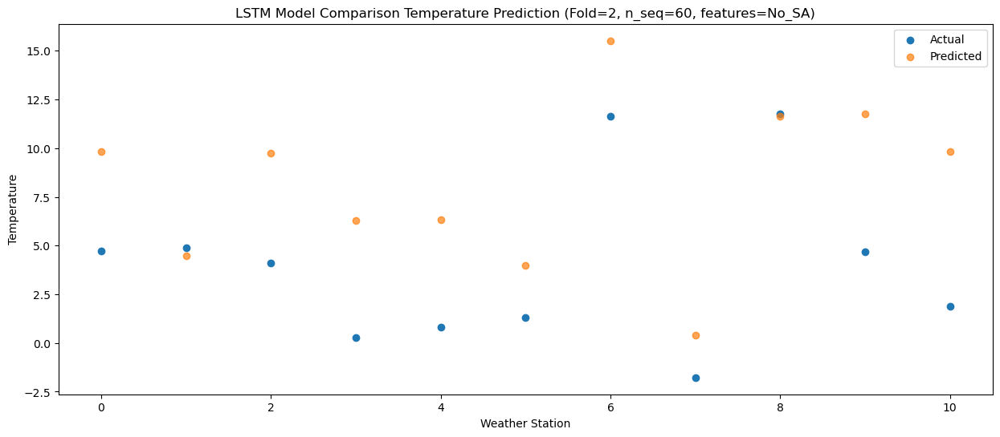

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    7.82   9.453330
1                 1    2.50   4.083331
2                 2    5.01   9.353336
3                 3   -1.64   5.883327
4                 4    4.21   5.923332
5                 5    4.54   3.593329
6                 6   13.93  15.133332
7                 7   -5.12  -0.006666
8                 8    5.26  11.253329
9                 9    6.59  11.363333
10               10    4.00   9.453334


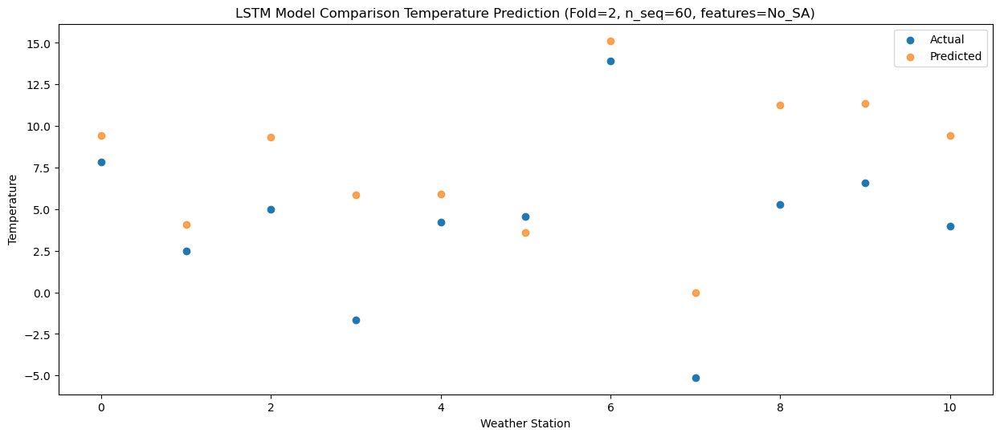

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.48   2.718596
1                 1   -2.19  -2.651403
2                 2    0.75   2.618601
3                 3   -7.79  -0.851407
4                 4   -3.52  -0.811402
5                 5   -3.89  -3.141405
6                 6    5.45   8.398598
7                 7   -8.12  -6.741401
8                 8    7.67   4.518594
9                 9    0.11   4.628598
10               10   -2.87   2.718599


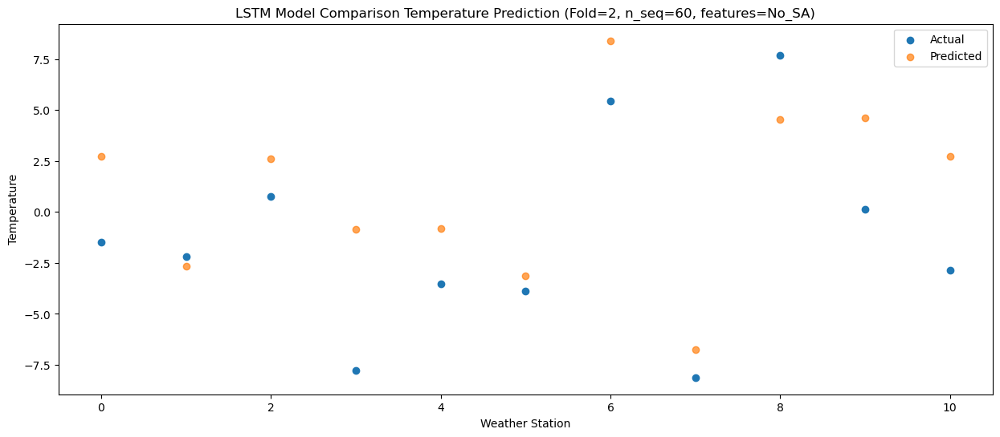

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.76   5.707182
1                 1   -2.20   0.337183
2                 2    3.08   5.607188
3                 3   -5.47   2.137179
4                 4   -0.38   2.177184
5                 5   -4.27  -0.152819
6                 6    5.28  11.387184
7                 7   -7.15  -3.752815
8                 8    8.54   7.507181
9                 9    4.13   7.617184
10               10    1.72   5.707185


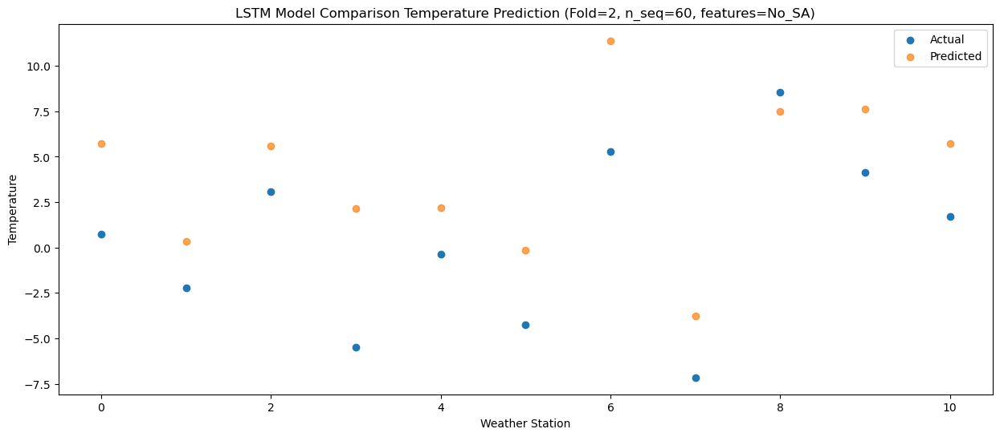

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    7.05  11.628514
1                 1    4.78   6.258511
2                 2    6.55  11.528518
3                 3   -1.61   8.058507
4                 4    3.38   8.098512
5                 5    1.85   5.768509
6                 6   11.86  17.308516
7                 7   -2.09   2.168514
8                 8   10.33  13.428511
9                 9    8.24  13.538513
10               10    6.27  11.628514


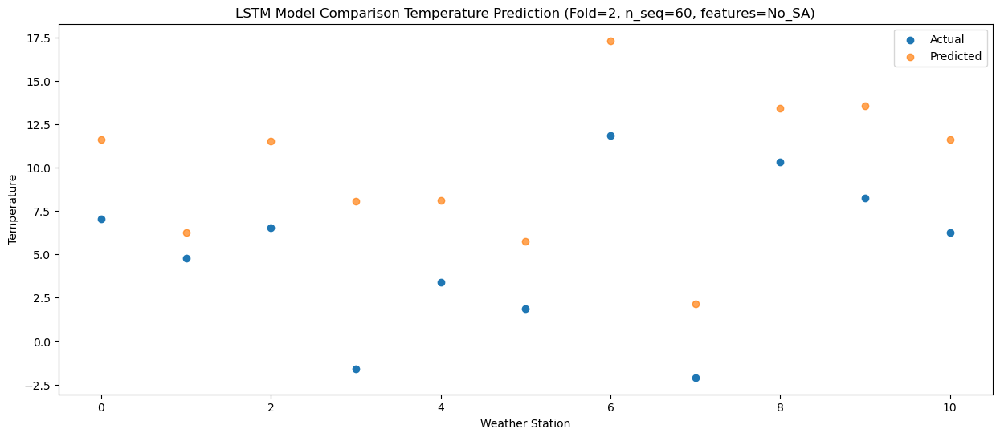

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   11.08  15.849661
1                 1   11.46  10.479658
2                 2    8.36  15.749667
3                 3    2.83  12.279654
4                 4    7.18  12.319659
5                 5    8.00   9.989656
6                 6   18.13  21.529663
7                 7    5.10   6.389661
8                 8   12.45  17.649658
9                 9   11.53  17.759660
10               10    9.43  15.849661


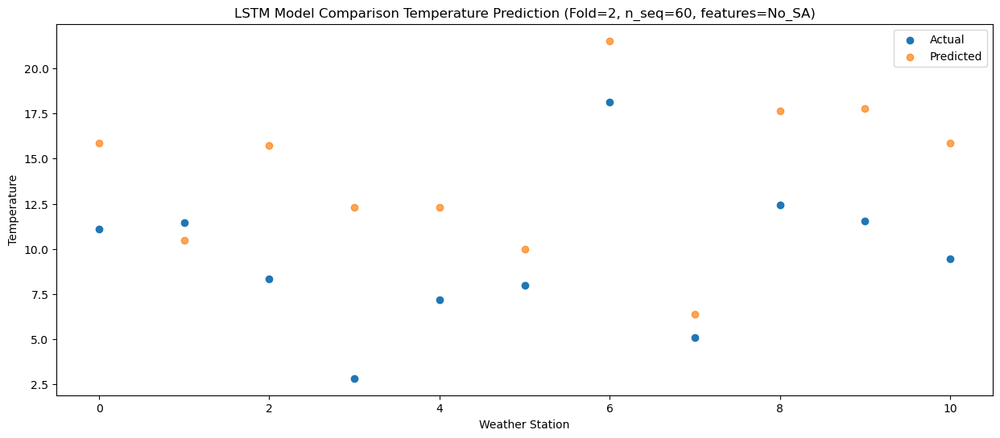

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   17.63  22.349924
1                 1   17.26  16.979921
2                 2   11.12  22.249930
3                 3    8.17  18.779917
4                 4   12.34  18.819922
5                 5   12.60  16.489919
6                 6   23.15  28.029926
7                 7    9.80  12.889924
8                 8   13.41  24.149921
9                 9   16.38  24.259923
10               10   15.67  22.349924


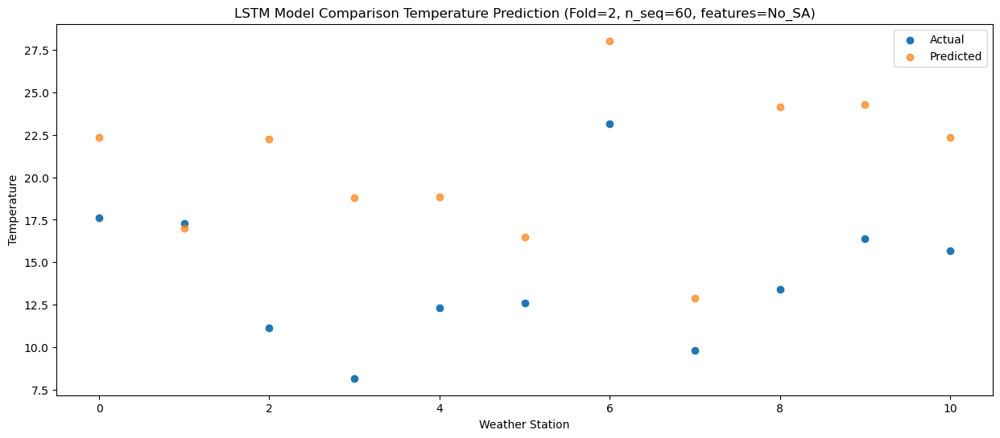

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   21.68  27.013158
1                 1   21.06  21.643155
2                 2   12.93  26.913164
3                 3   12.41  23.443151
4                 4   14.93  23.483156
5                 5   16.32  21.153153
6                 6   27.86  32.693160
7                 7   13.66  17.553158
8                 8   18.33  28.813155
9                 9   20.14  28.923157
10               10   19.32  27.013158


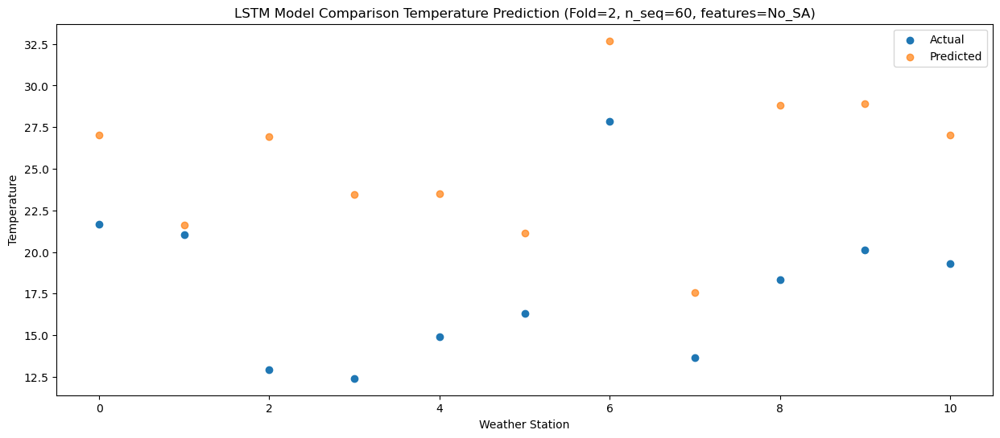

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.18  29.236439
1                 1   24.30  23.866437
2                 2   13.11  29.136445
3                 3   17.03  25.666432
4                 4   14.76  25.706437
5                 5   17.68  23.376435
6                 6   30.65  34.916441
7                 7   14.80  19.776439
8                 8   19.14  31.036438
9                 9   21.58  31.146438
10               10   20.67  29.236439


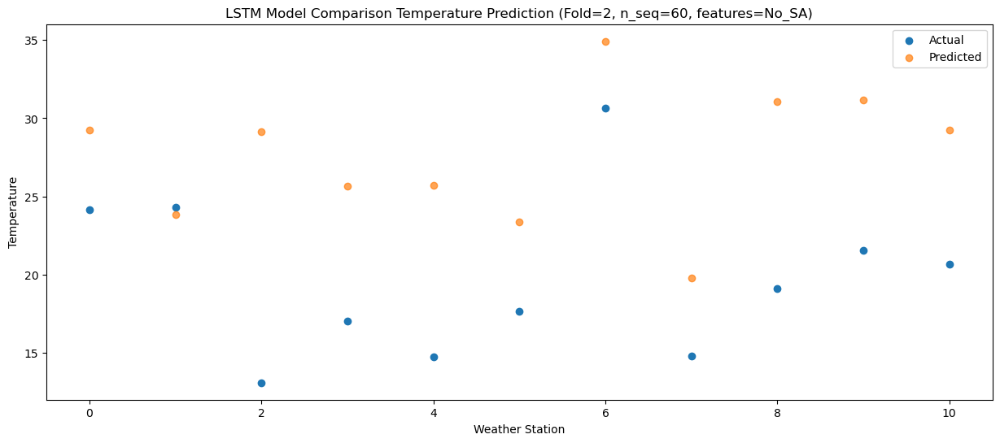

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   21.63  28.297839
1                 1   21.99  22.927836
2                 2   12.54  28.197845
3                 3   16.95  24.727832
4                 4   13.94  24.767837
5                 5   14.96  22.437834
6                 6   27.84  33.977841
7                 7   11.78  18.837839
8                 8   21.18  30.097838
9                 9   20.20  30.207838
10               10   19.42  28.297839


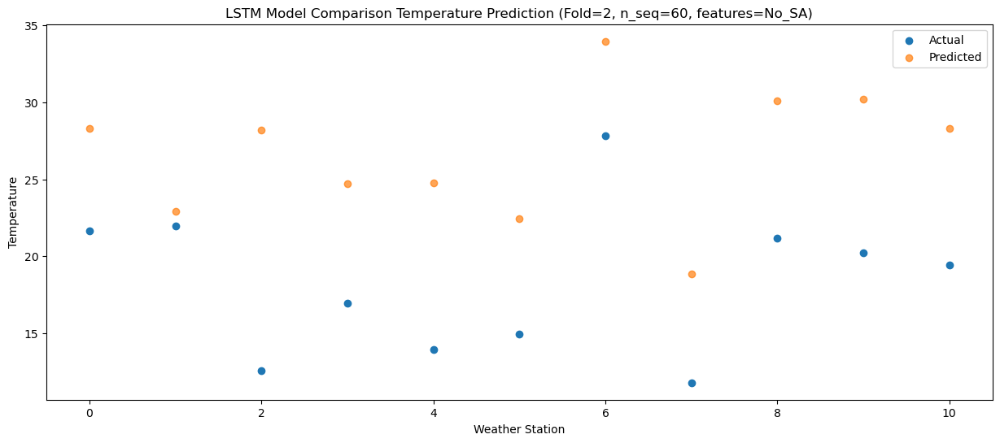

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.88  24.918337
1                 1   19.23  19.548335
2                 2   11.13  24.818343
3                 3   11.91  21.348331
4                 4   11.97  21.388336
5                 5   12.30  19.058333
6                 6   24.01  30.598339
7                 7   10.05  15.458337
8                 8   20.77  26.718338
9                 9   16.89  26.828336
10               10   15.27  24.918337


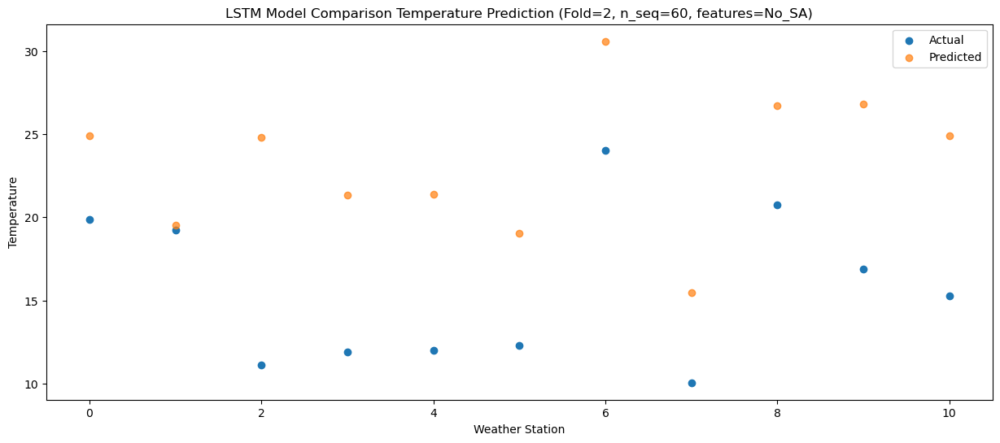

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.54  17.892264
1                 1   10.85  12.522261
2                 2    8.50  17.792270
3                 3    6.47  14.322258
4                 4    5.78  14.362263
5                 5    6.73  12.032260
6                 6   17.63  23.572265
7                 7    1.84   8.432264
8                 8   14.50  19.692264
9                 9    9.58  19.802263
10               10    7.99  17.892264


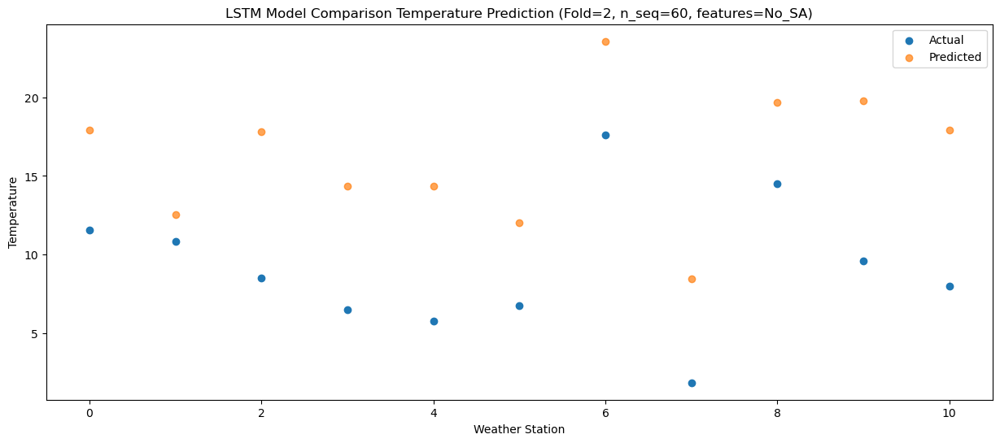

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    5.41  12.654624
1                 1    0.86   7.284620
2                 2    6.74  12.554630
3                 3    2.67   9.084617
4                 4    2.71   9.124622
5                 5    0.85   6.794619
6                 6   10.96  18.334625
7                 7   -5.05   3.194624
8                 8    8.27  14.454623
9                 9    7.46  14.564623
10               10    5.54  12.654624


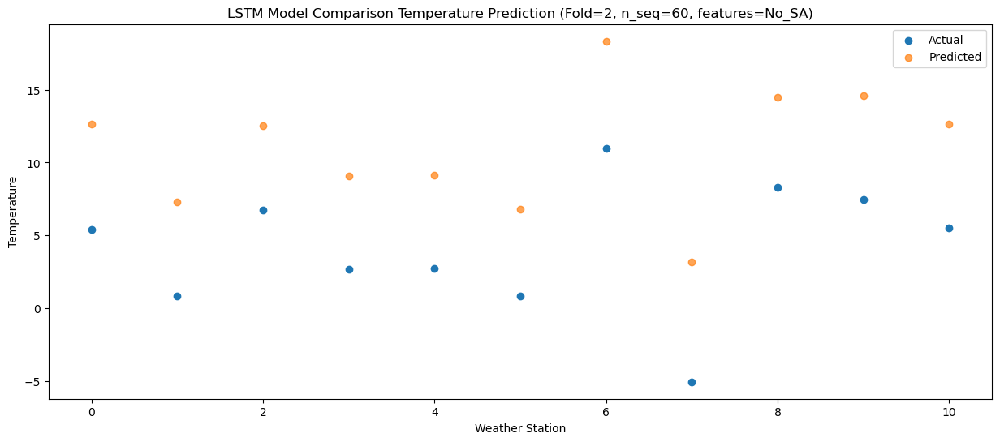

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.90   7.317576
1                 1   -1.85   1.947572
2                 2    2.64   7.217581
3                 3   -3.50   3.747569
4                 4    0.20   3.787574
5                 5   -1.38   1.457571
6                 6    8.34  12.997577
7                 7   -7.22  -2.142425
8                 8    5.57   9.117575
9                 9    0.93   9.227574
10               10    0.08   7.317575


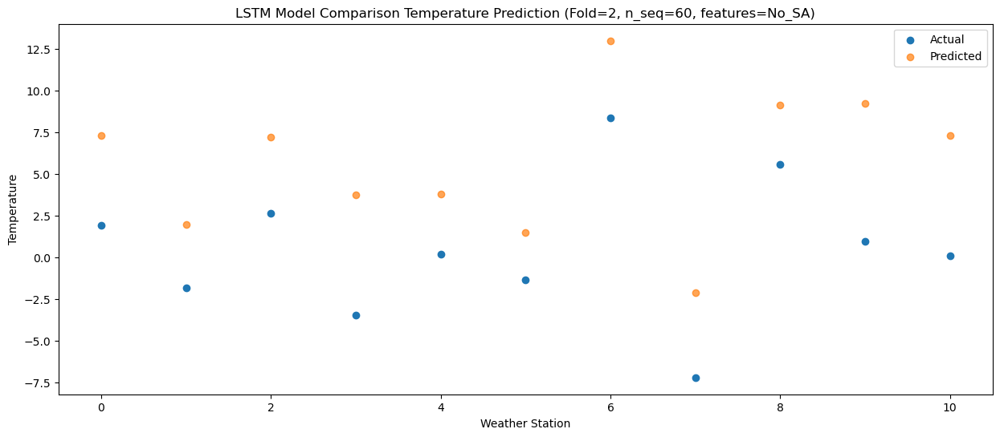

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    3.92   8.774771
1                 1   -2.10   3.404769
2                 2    2.44   8.674778
3                 3   -2.21   5.204766
4                 4    1.37   5.244771
5                 5   -0.62   2.914768
6                 6    9.22  14.454774
7                 7   -7.93  -0.685228
8                 8    5.23  10.574772
9                 9    4.13  10.684771
10               10    2.00   8.774772


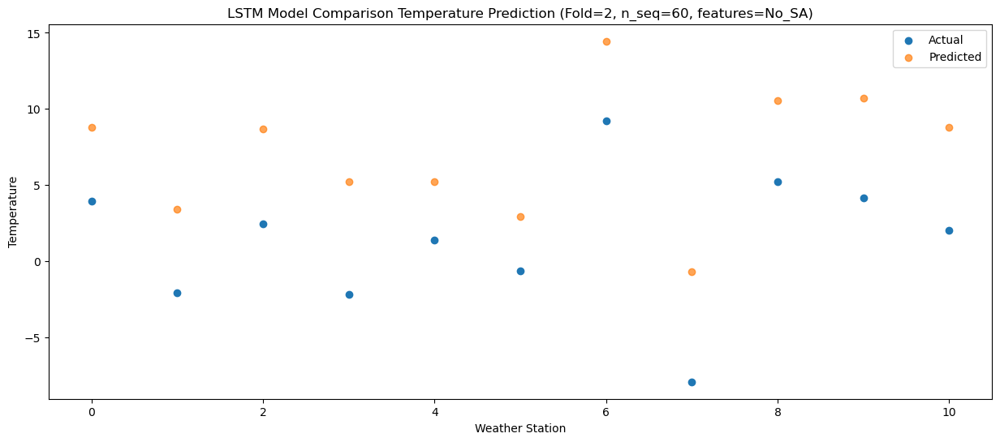

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    4.94  10.163295
1                 1   -0.50   4.793295
2                 2    5.50  10.063305
3                 3   -4.09   6.593292
4                 4    3.50   6.633297
5                 5    0.57   4.303294
6                 6    9.41  15.843300
7                 7   -6.72   0.703299
8                 8    4.91  11.963298
9                 9    7.15  12.073298
10               10    4.79  10.163299


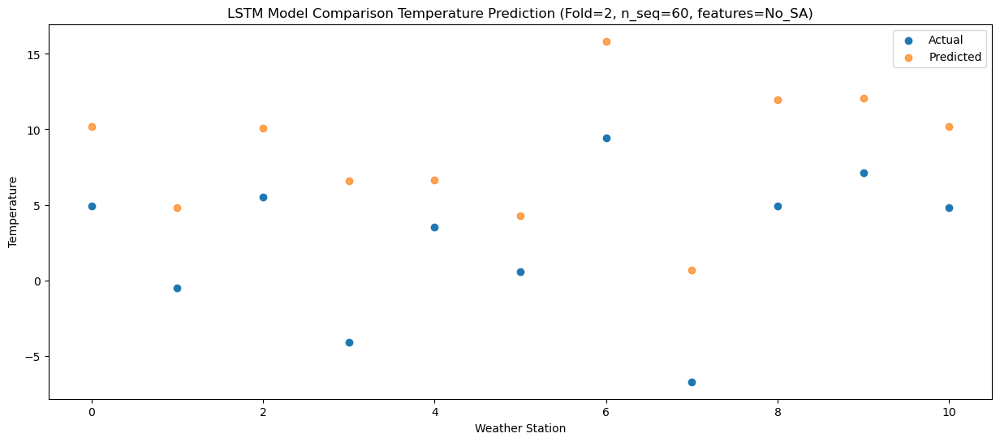

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    7.21  12.438398
1                 1    3.57   7.068398
2                 2    6.52  12.338407
3                 3   -1.65   8.868395
4                 4    5.33   8.908400
5                 5    4.37   6.578397
6                 6   14.06  18.118403
7                 7   -2.02   2.978401
8                 8    5.92  14.238401
9                 9    7.60  14.348400
10               10    5.32  12.438401


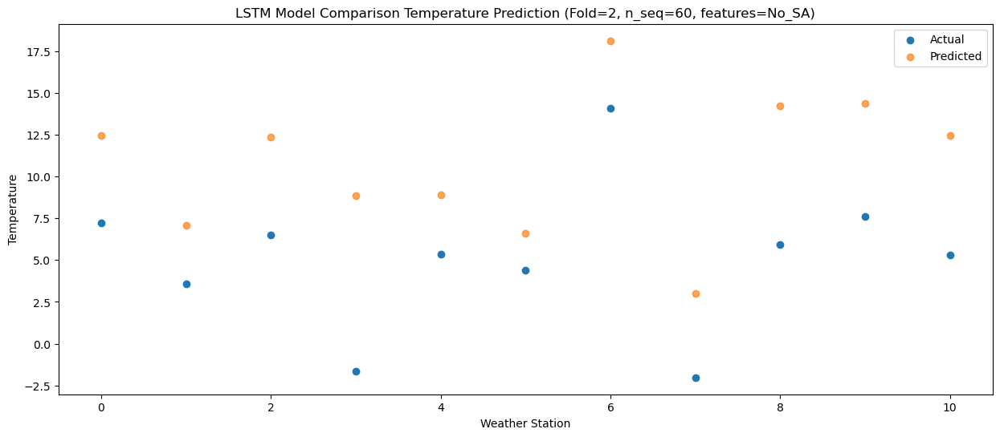

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   11.36  18.299477
1                 1    9.43  12.929478
2                 2    9.06  18.199487
3                 3    4.07  14.729474
4                 4    7.25  14.769479
5                 5    5.29  12.439477
6                 6   15.88  23.979482
7                 7    3.62   8.839481
8                 8    9.76  20.099478
9                 9   11.12  20.209480
10               10   10.21  18.299481


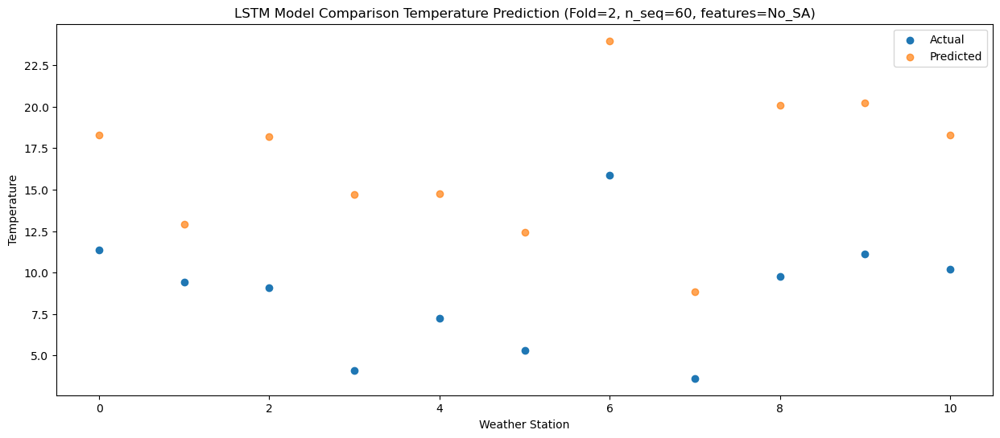

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   17.41  22.748957
1                 1   14.92  17.378959
2                 2   10.04  22.648969
3                 3    7.70  19.178956
4                 4   11.28  19.218961
5                 5   10.37  16.888957
6                 6   21.62  28.428964
7                 7    8.27  13.288963
8                 8   10.97  24.548959
9                 9   13.90  24.658962
10               10   13.56  22.748963


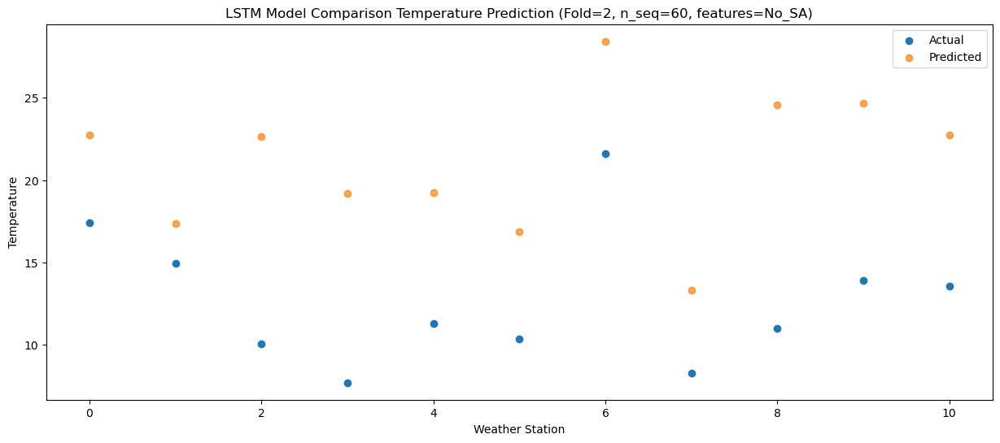

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   20.04  27.094926
1                 1   17.53  21.724928
2                 2   12.45  26.994938
3                 3   11.49  23.524925
4                 4   14.93  23.564930
5                 5   15.29  21.234925
6                 6   25.77  32.774933
7                 7   12.93  17.634932
8                 8   12.93  28.894927
9                 9   17.56  29.004931
10               10   16.47  27.094932


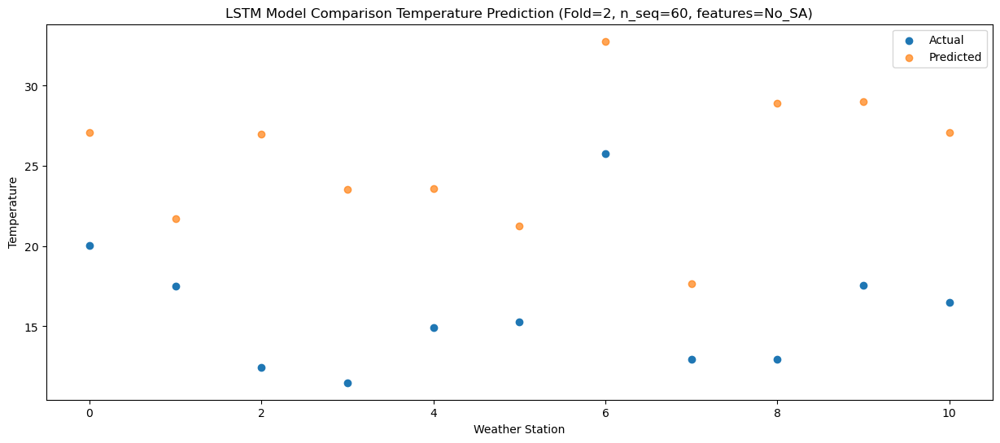

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   21.79  30.731922
1                 1   21.63  25.361926
2                 2   14.36  30.631936
3                 3   17.06  27.161923
4                 4   16.37  27.201928
5                 5   17.45  24.871923
6                 6   28.33  36.411929
7                 7   17.68  21.271928
8                 8   19.85  32.531923
9                 9   21.15  32.641927
10               10   20.02  30.731928


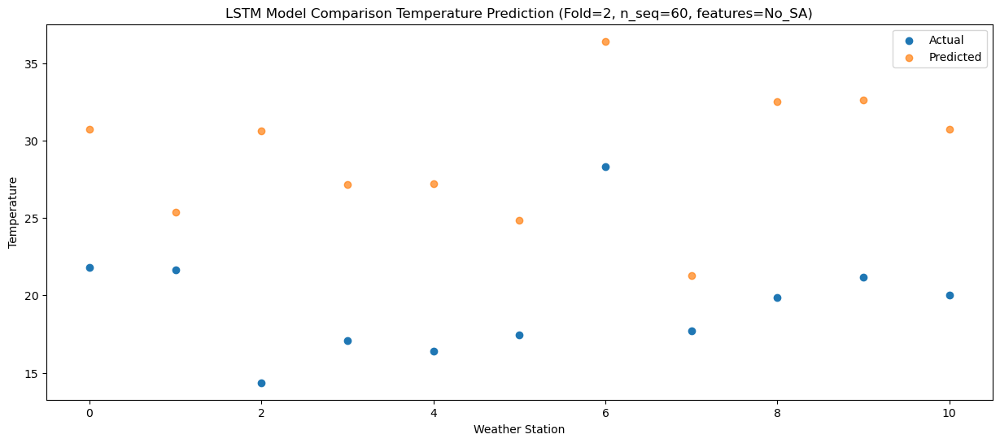

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   21.30  30.556721
1                 1   22.12  25.186725
2                 2   14.54  30.456733
3                 3   15.05  26.986721
4                 4   17.67  27.026726
5                 5   19.15  24.696722
6                 6   30.67  36.236728
7                 7   14.68  21.096726
8                 8   19.48  32.356721
9                 9   20.60  32.466725
10               10   19.31  30.556726


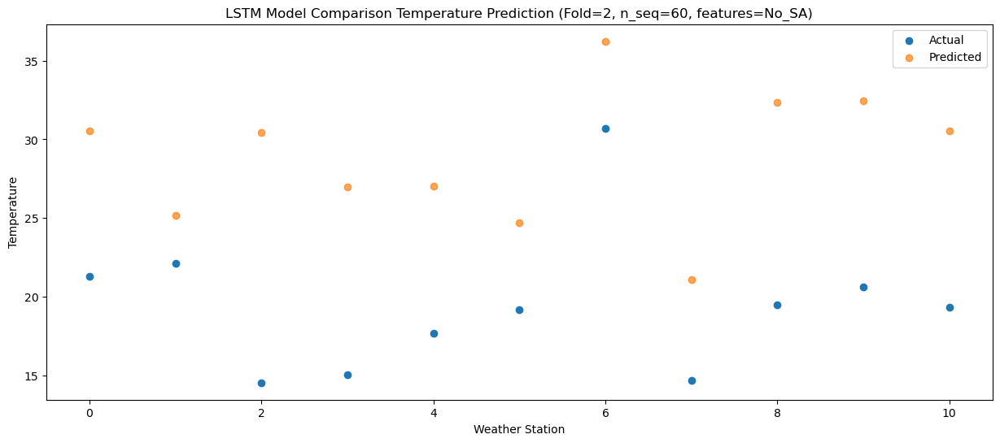

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   18.01  27.159982
1                 1   19.25  21.789985
2                 2   12.59  27.059994
3                 3   12.63  23.589981
4                 4   13.24  23.629986
5                 5   14.67  21.299983
6                 6   25.89  32.839988
7                 7   12.02  17.699987
8                 8   15.98  28.959983
9                 9   16.64  29.069986
10               10   16.53  27.159987


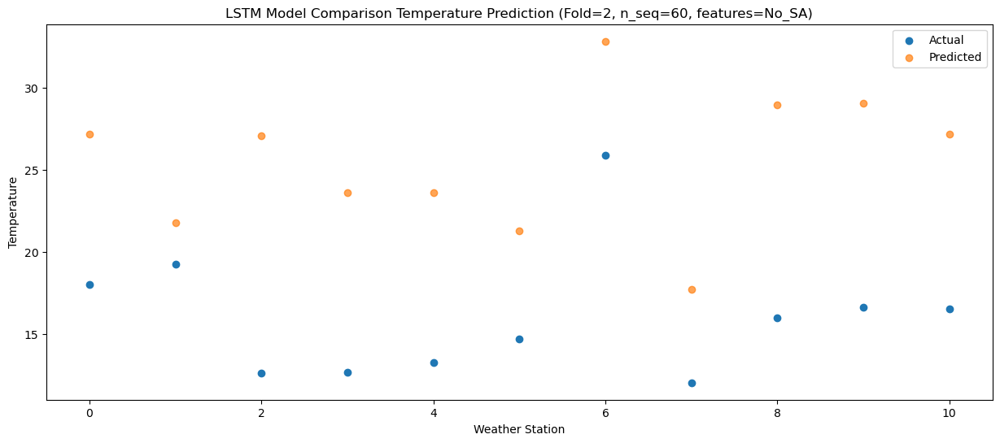

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.85  21.089756
1                 1   10.21  15.719760
2                 2    9.01  20.989770
3                 3    7.61  17.519757
4                 4    7.08  17.559762
5                 5    6.78  15.229757
6                 6   17.17  26.769763
7                 7    5.28  11.629763
8                 8   14.39  22.889758
9                 9   11.35  22.999762
10               10   10.48  21.089763


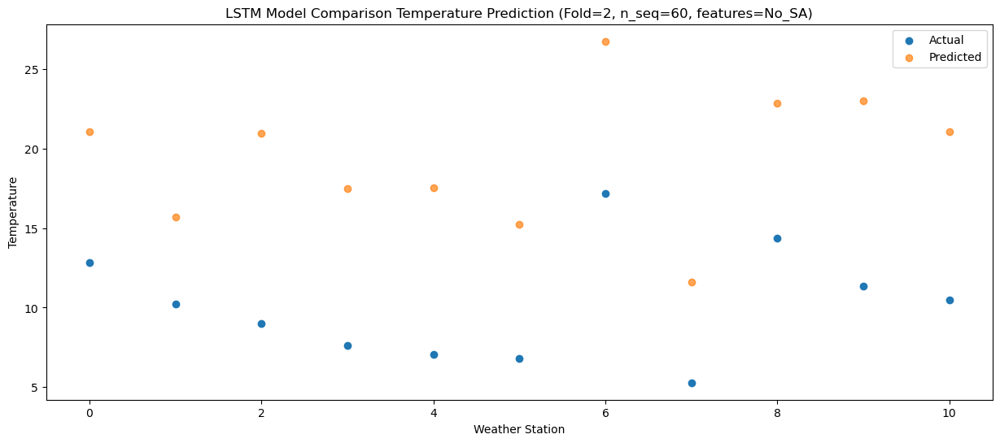

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    5.74  14.477734
1                 1    3.49   9.107738
2                 2    5.03  14.377747
3                 3   -0.37  10.907735
4                 4    1.97  10.947740
5                 5    0.50   8.617735
6                 6   11.83  20.157741
7                 7   -1.83   5.017740
8                 8   10.00  16.277737
9                 9    5.45  16.387739
10               10    4.27  14.477740


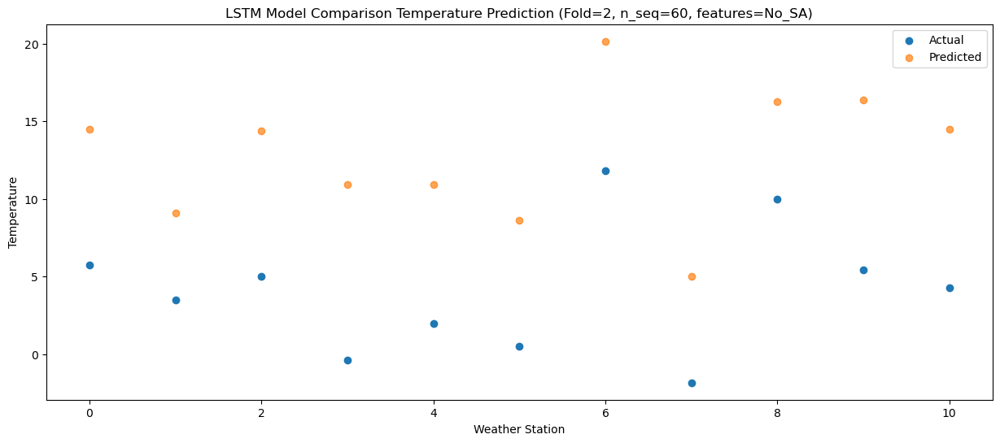

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    2.68  12.817488
1                 1   -0.18   7.447492
2                 2    3.10  12.717500
3                 3   -1.11   9.247487
4                 4   -0.63   9.287494
5                 5   -1.61   6.957488
6                 6    8.85  18.497495
7                 7   -6.87   3.357493
8                 8    7.67  14.617489
9                 9    2.98  14.727492
10               10    1.42  12.817494


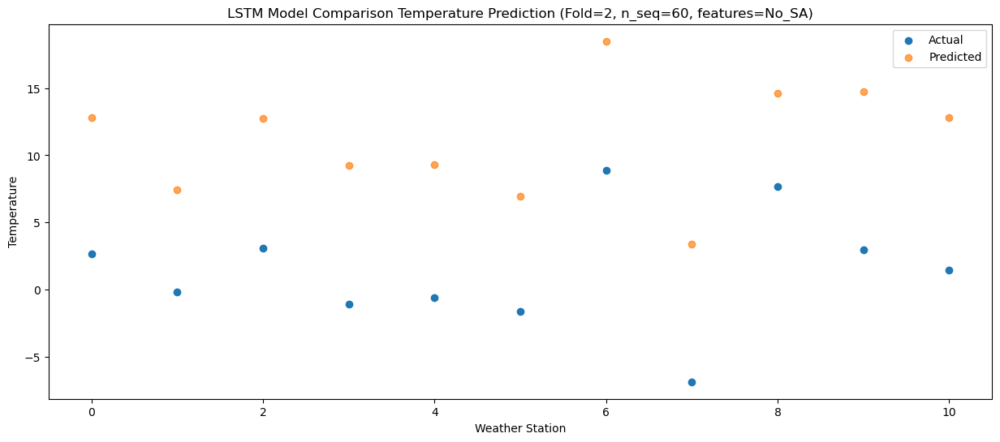

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.11   8.281600
1                 1   -5.27   2.911605
2                 2    1.10   8.181613
3                 3   -5.28   4.711599
4                 4   -2.71   4.751607
5                 5   -5.76   2.421601
6                 6    3.67  13.961608
7                 7   -7.20  -1.178395
8                 8    5.87  10.081602
9                 9    1.13  10.191604
10               10   -1.90   8.281607


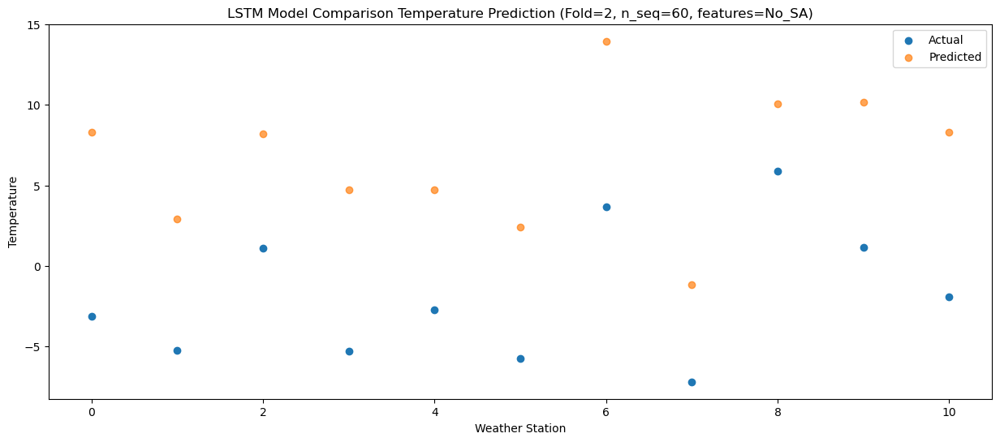

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.21  13.266590
1                 1    2.21   7.896595
2                 2    1.58  13.166603
3                 3   -4.60   9.696589
4                 4    1.45   9.736597
5                 5    1.00   7.406591
6                 6   11.93  18.946598
7                 7   -3.99   3.806595
8                 8    6.40  15.066592
9                 9    4.35  15.176594
10               10    2.64  13.266597


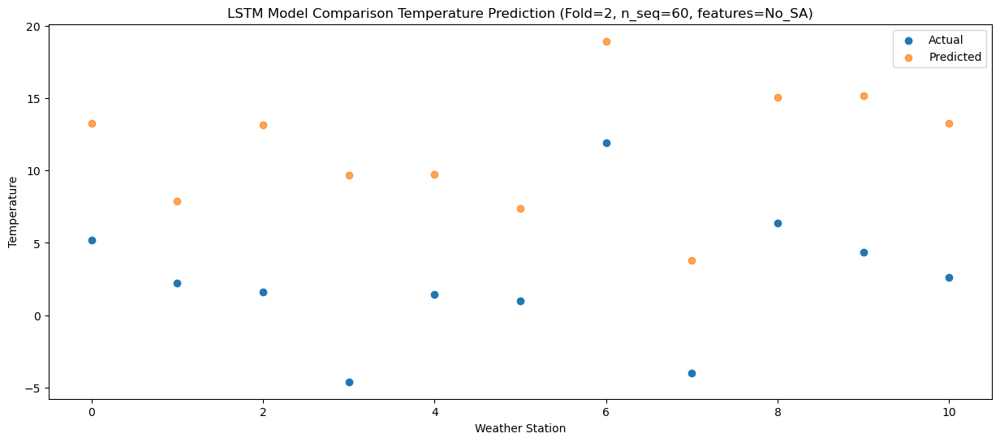

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.10  16.671218
1                 1    4.98  11.301223
2                 2    6.00  16.571229
3                 3   -0.20  13.101215
4                 4    4.12  13.141225
5                 5    3.37  10.811219
6                 6   14.28  22.351226
7                 7   -1.42   7.211221
8                 8    7.34  18.471220
9                 9    7.91  18.581220
10               10    6.81  16.671225


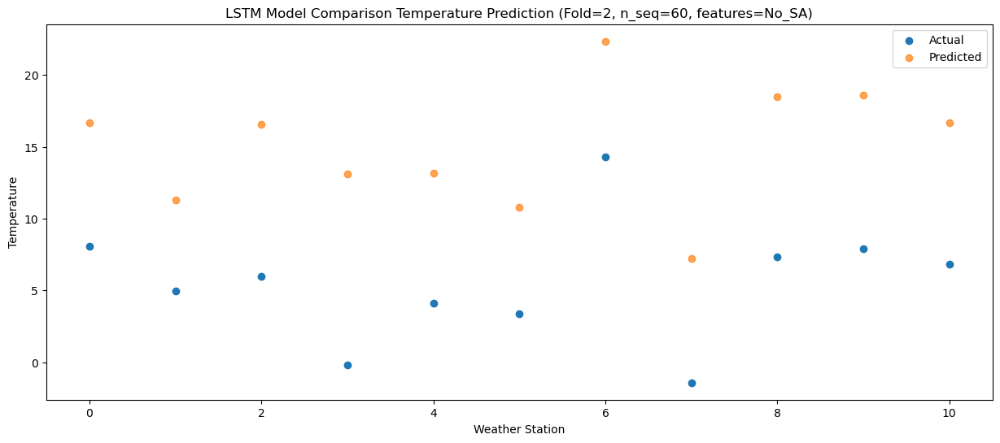

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.86  21.402582
1                 1   10.39  16.032586
2                 2    7.39  21.302592
3                 3    2.23  17.832579
4                 4    7.78  17.872588
5                 5    7.11  15.542583
6                 6   17.73  27.082589
7                 7    2.99  11.942584
8                 8    9.45  23.202584
9                 9   11.97  23.312583
10               10   10.79  21.402588


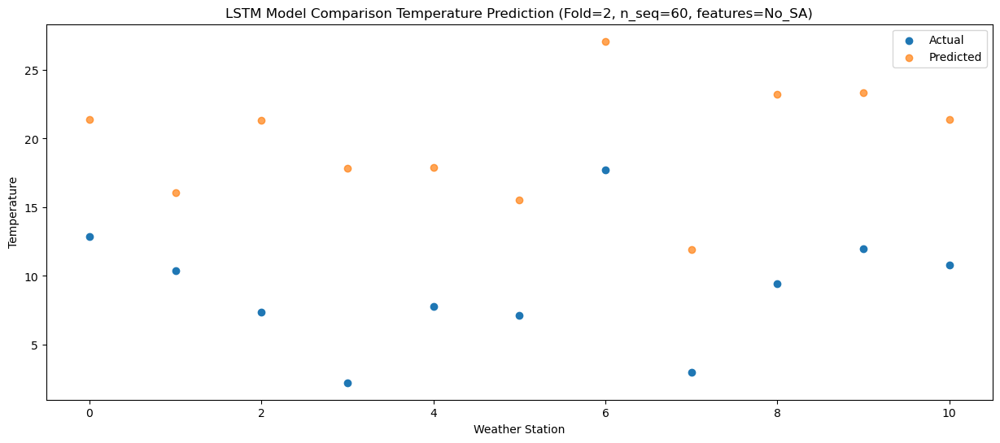

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.79  26.971196
1                 1   15.00  21.601200
2                 2   12.24  26.871204
3                 3    8.02  23.401191
4                 4   12.83  23.441202
5                 5   10.81  21.111197
6                 6   22.62  32.651203
7                 7    8.81  17.511196
8                 8   11.25  28.771196
9                 9   16.35  28.881195
10               10   15.25  26.971200


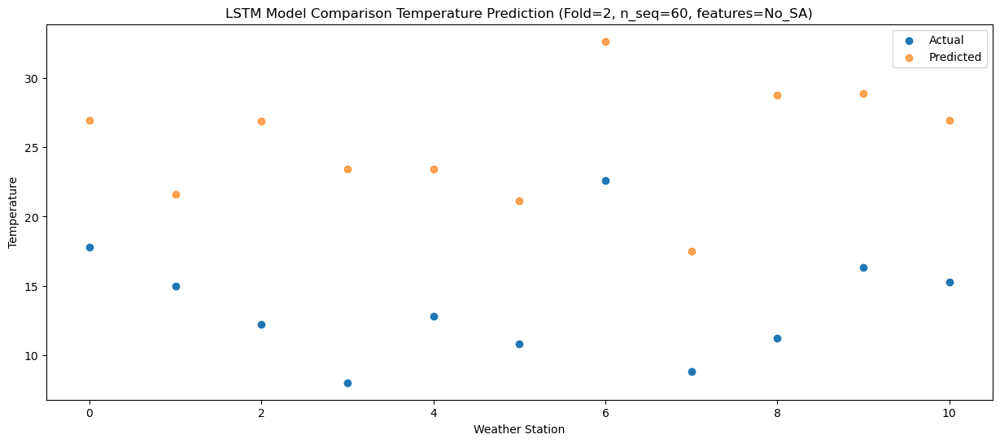

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   20.87  31.822423
1                 1   21.17  26.452428
2                 2   13.15  31.722432
3                 3   13.99  28.252418
4                 4   14.66  28.292430
5                 5   14.04  25.962424
6                 6   26.12  37.502431
7                 7   15.23  22.362424
8                 8   15.93  33.622423
9                 9   20.23  33.732423
10               10   19.60  31.822428


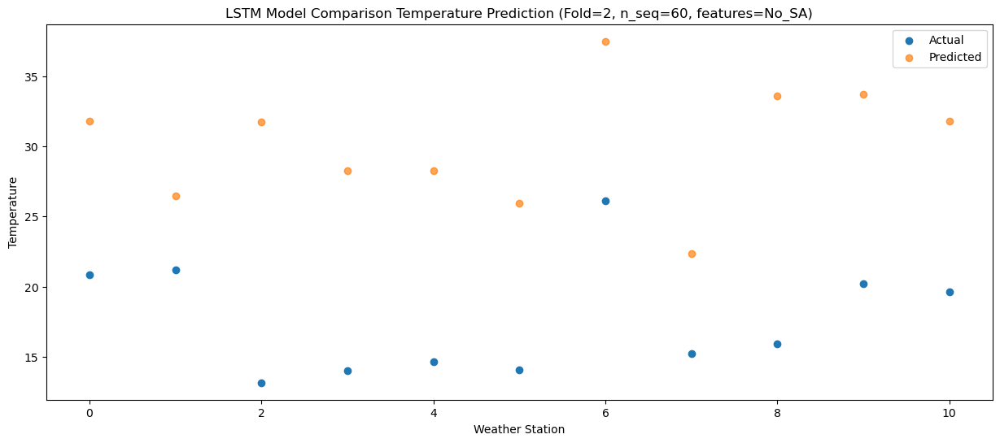

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   21.36  33.462945
1                 1   21.72  28.092950
2                 2   13.99  33.362954
3                 3   16.77  29.892940
4                 4   15.27  29.932952
5                 5   12.52  27.602946
6                 6   26.43  39.142953
7                 7   14.70  24.002946
8                 8   19.66  35.262945
9                 9   21.62  35.372945
10               10   20.83  33.462950


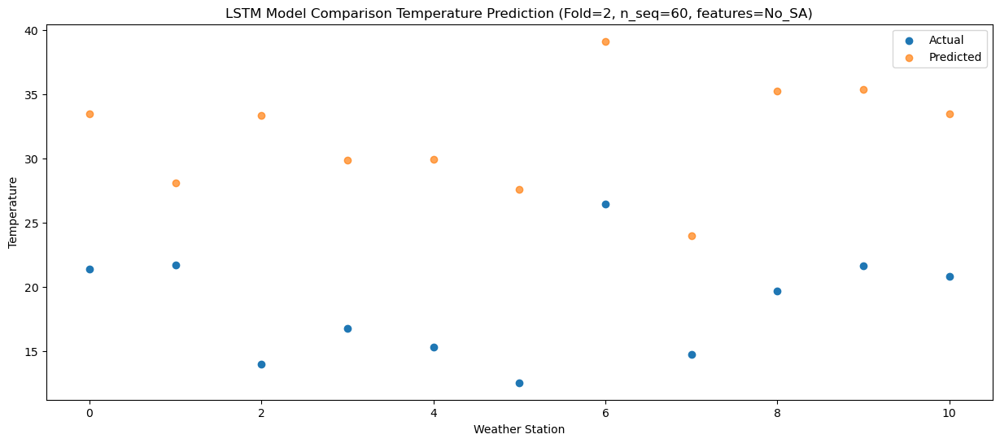

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   21.59  32.799212
1                 1   21.77  27.429217
2                 2   13.95  32.699221
3                 3   15.06  29.229208
4                 4   15.62  29.269219
5                 5   14.17  26.939214
6                 6   28.23  38.479220
7                 7   15.09  23.339213
8                 8   19.24  34.599213
9                 9   19.60  34.709212
10               10   19.21  32.799217


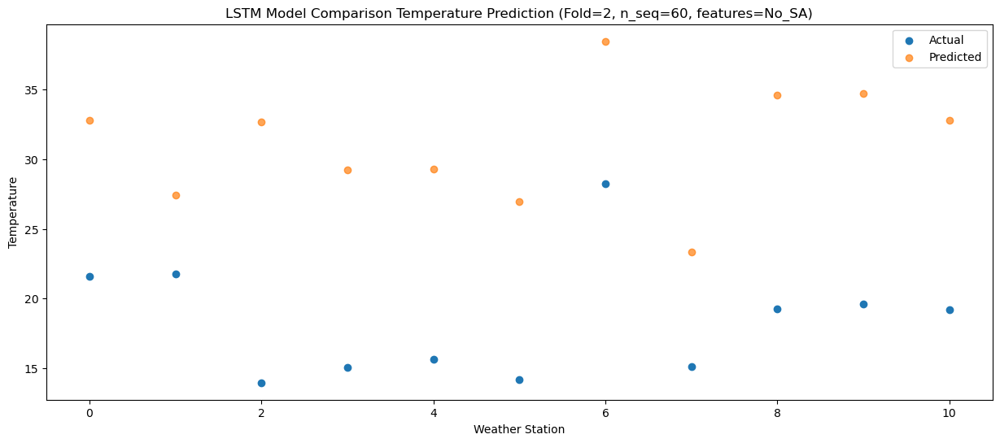

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   17.61  29.768094
1                 1   18.04  24.398099
2                 2   13.63  29.668103
3                 3   11.54  26.198089
4                 4   12.82  26.238101
5                 5   11.44  23.908095
6                 6   24.00  35.448102
7                 7   11.06  20.308095
8                 8   17.39  31.568094
9                 9   16.64  31.678094
10               10   16.62  29.768099


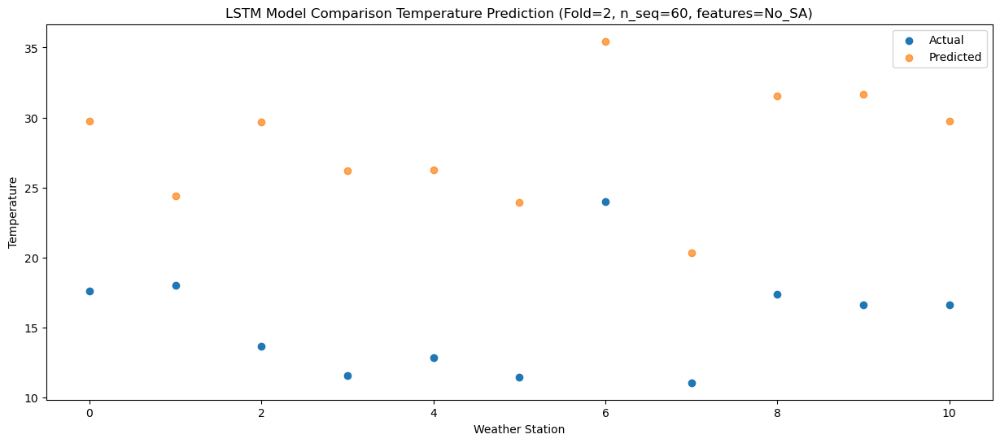

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   13.34  24.540832
1                 1   13.07  19.170836
2                 2   10.16  24.440840
3                 3    6.28  20.970827
4                 4    8.13  21.010838
5                 5    8.79  18.680833
6                 6   21.03  30.220839
7                 7    6.80  15.080832
8                 8   14.40  26.340832
9                 9   11.42  26.450831
10               10   10.20  24.540836


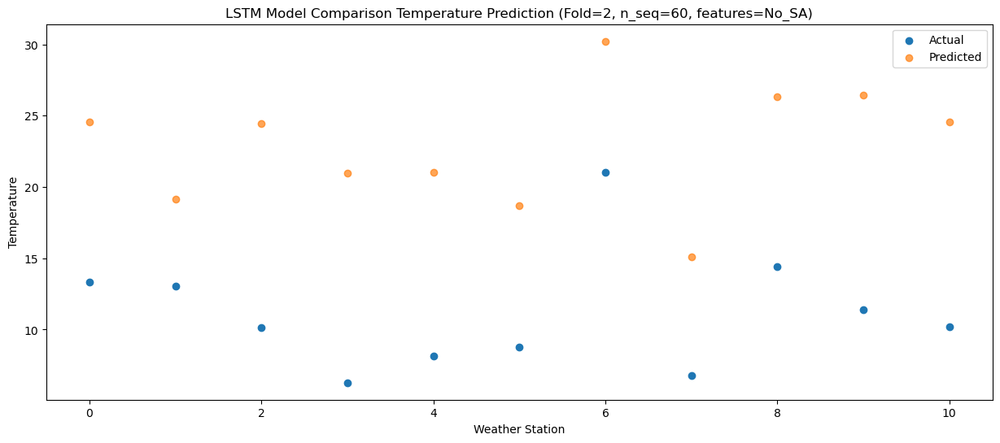

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_14 (LSTM)              (1, 1, 512)               4767744   
                                                                 
 dropout_14 (Dropout)        (1, 1, 512)               0         
                                                                 
 lstm_15 (LSTM)              (1, 512)                  2099200   
                                                                 
 dropout_15 (Dropout)        (1, 512)                  0         
                                                                 
 dense_21 (Dense)            (1, 256)                  131328    
                                                                 
 dense_22 (Dense)            (1, 128)                  32896     
                                                                 
 dense_23 (Dense)            (1, 60)                  

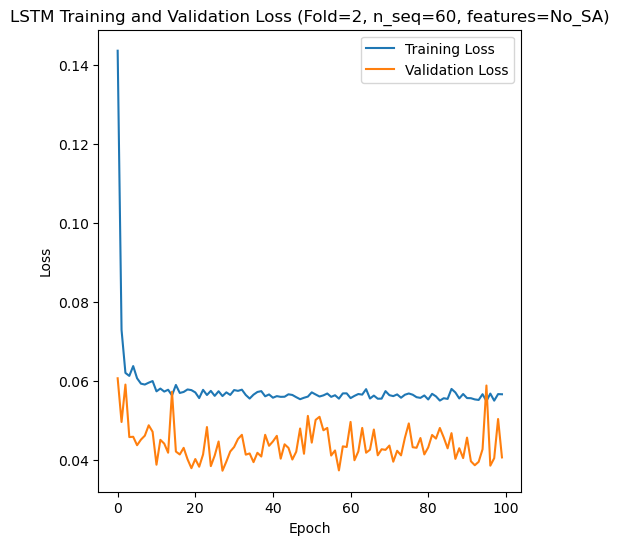

Epoch 1/100
84/84 [==============================] - 7s 39ms/step - loss: 0.1462 - accuracy: 0.3214 - mae: 0.1200 - rmse: 0.1462 - mape: 27.6019 - pearson: 0.5940 - val_loss: 0.0844 - val_accuracy: 0.1000 - val_mae: 0.0672 - val_rmse: 0.0844 - val_mape: 15.3354 - val_pearson: 0.7198
Epoch 2/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0717 - accuracy: 0.4524 - mae: 0.0570 - rmse: 0.0717 - mape: 13.0628 - pearson: 0.8306 - val_loss: 0.0754 - val_accuracy: 0.5000 - val_mae: 0.0595 - val_rmse: 0.0754 - val_mape: 13.4702 - val_pearson: 0.7739
Epoch 3/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0617 - accuracy: 0.5833 - mae: 0.0494 - rmse: 0.0617 - mape: 11.5984 - pearson: 0.8485 - val_loss: 0.0732 - val_accuracy: 0.5000 - val_mae: 0.0580 - val_rmse: 0.0732 - val_mape: 12.9285 - val_pearson: 0.7771
Epoch 4/100
84/84 [==============================] - 2s 24ms/step - loss: 0.0613 - accuracy: 0.5952 - mae: 0.0488 - rmse: 0.0613 - mape: 11.5631 - p

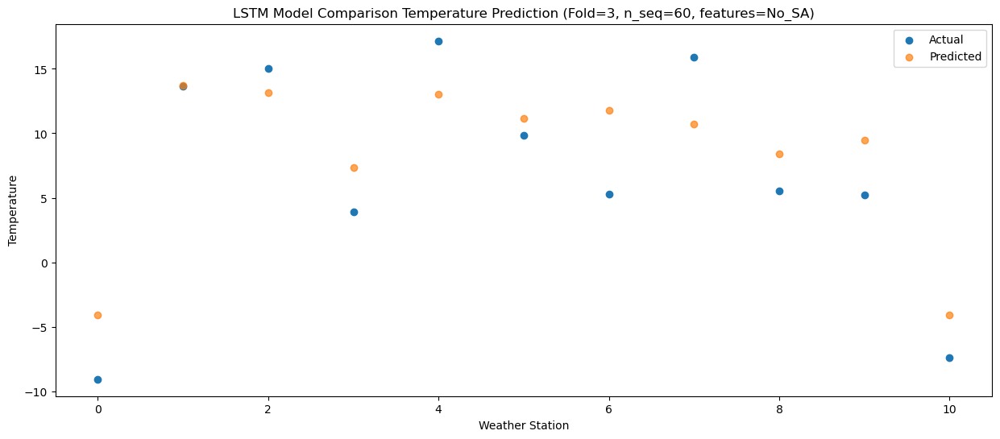

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   -3.75   2.053041
1                 1   20.76  19.863041
2                 2   18.39  19.333042
3                 3    9.74  13.493041
4                 4   24.22  19.193041
5                 5   16.86  17.313041
6                 6    9.52  17.943042
7                 7   19.34  16.863042
8                 8    8.10  14.543042
9                 9   12.19  15.623041
10               10   -0.69   2.053042


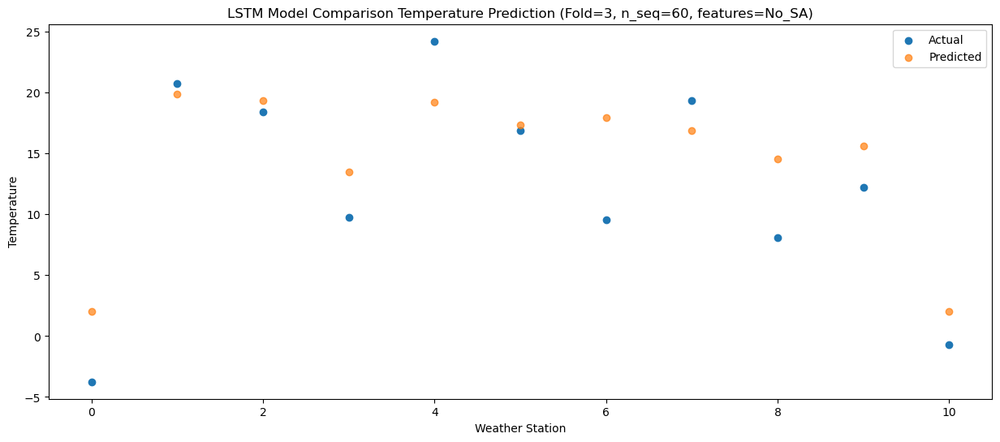

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   -0.89   4.233443
1                 1   22.62  22.043443
2                 2   21.17  21.513444
3                 3   13.54  15.673443
4                 4   25.68  21.373443
5                 5   18.75  19.493443
6                 6   11.51  20.123444
7                 7   23.57  19.043444
8                 8    7.29  16.723444
9                 9   16.14  17.803443
10               10    3.08   4.233444


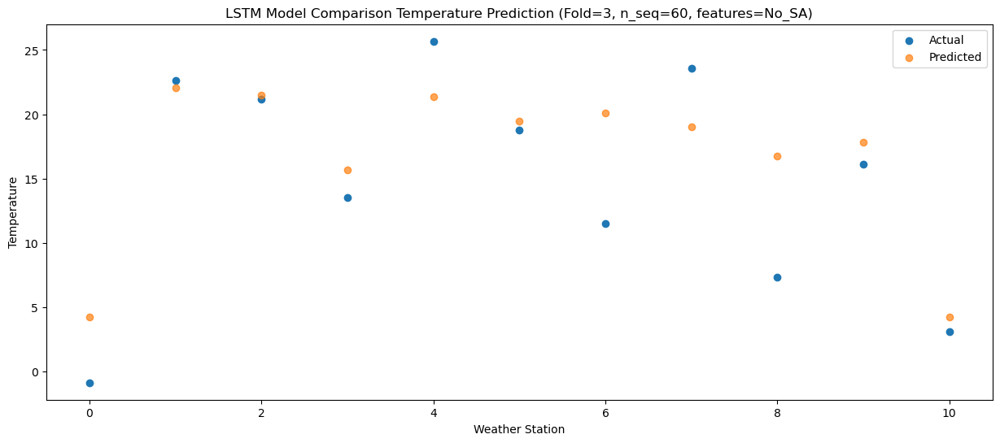

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   -2.12   1.899398
1                 1   20.76  19.709398
2                 2   21.70  19.179399
3                 3   11.12  13.339398
4                 4   23.12  19.039398
5                 5   16.24  17.159398
6                 6   12.26  17.789399
7                 7   23.68  16.709399
8                 8    9.17  14.389399
9                 9   14.96  15.469398
10               10    1.21   1.899399


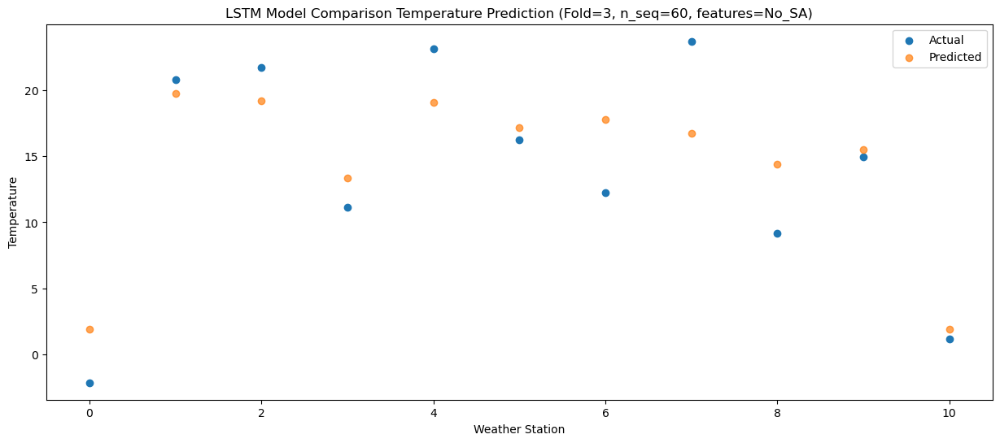

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   -6.09  -2.155392
1                 1   17.09  15.654608
2                 2   17.37  15.124609
3                 3    7.06   9.284608
4                 4   19.05  14.984608
5                 5   12.61  13.104608
6                 6    6.76  13.734609
7                 7   18.87  12.654609
8                 8    8.59  10.334609
9                 9   10.62  11.414608
10               10   -3.76  -2.155391


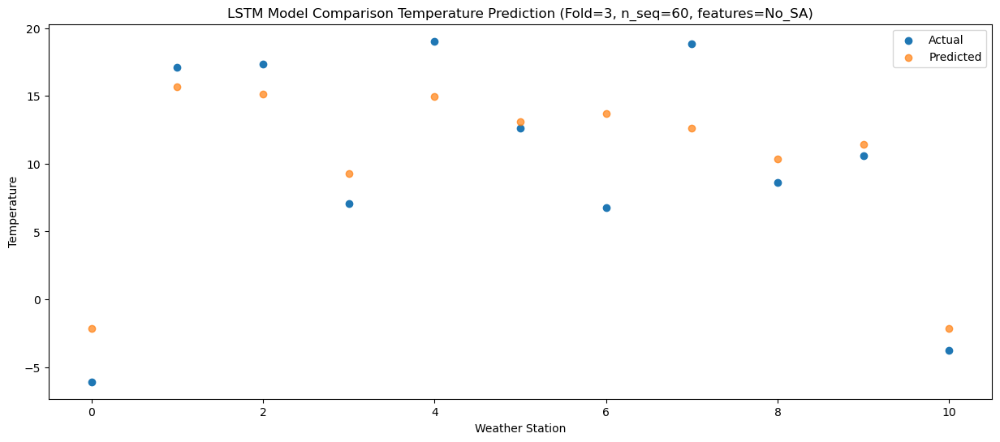

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   -9.66  -8.819912
1                 1    9.98   8.990088
2                 2   11.88   8.460089
3                 3    1.64   2.620088
4                 4   11.32   8.320088
5                 5    6.61   6.440088
6                 6    3.02   7.070089
7                 7   11.93   5.990089
8                 8    6.37   3.670089
9                 9    5.30   4.750088
10               10   -9.25  -8.819911


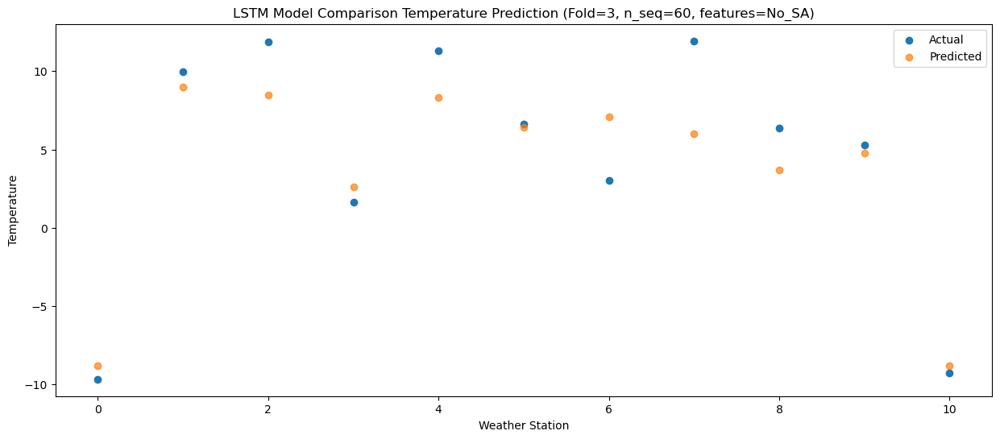

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0  -14.08 -12.121533
1                 1    7.16   5.688467
2                 2    3.23   5.158468
3                 3   -2.28  -0.681533
4                 4    8.50   5.018467
5                 5    2.67   3.138467
6                 6   -4.17   3.768468
7                 7    3.12   2.688468
8                 8   -0.79   0.368468
9                 9    1.23   1.448467
10               10  -13.53 -12.121532


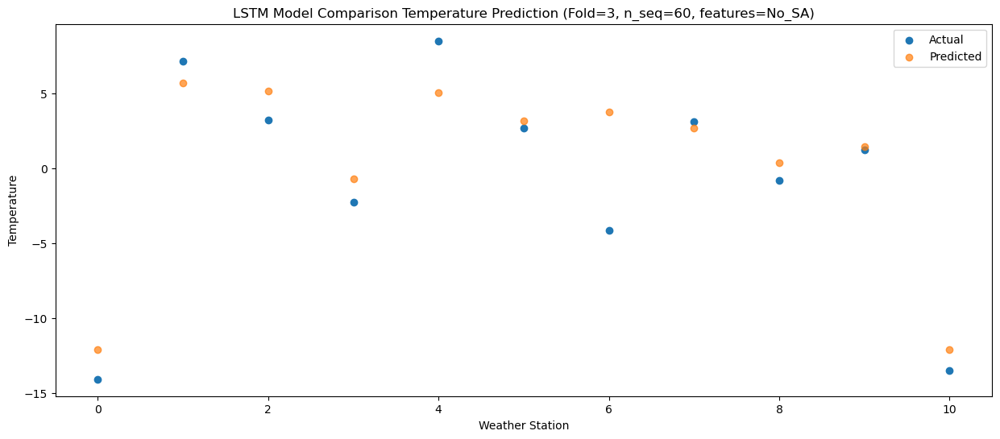

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0  -21.26 -19.499238
1                 1    0.61  -1.689238
2                 2    0.03  -2.219237
3                 3   -9.48  -8.059238
4                 4    1.33  -2.359238
5                 5   -4.94  -4.239238
6                 6   -9.87  -3.609237
7                 7   -2.57  -4.689237
8                 8   -2.84  -7.009237
9                 9   -5.11  -5.929238
10               10  -20.35 -19.499237


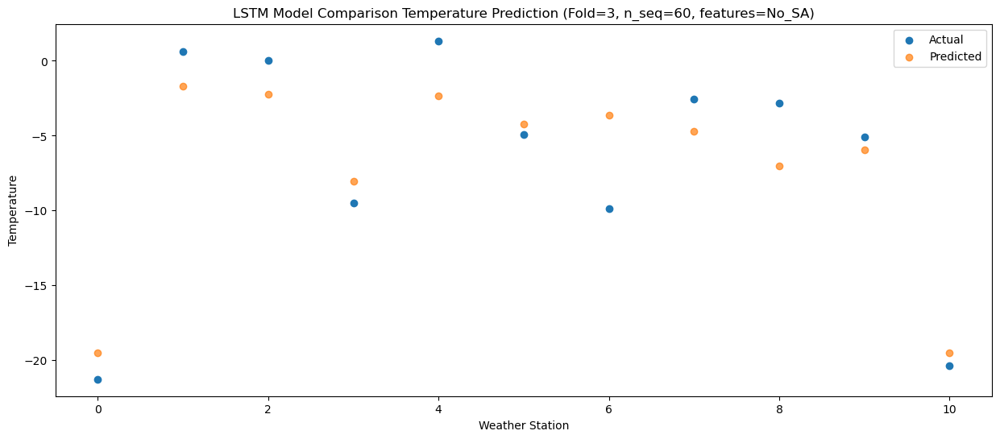

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -21.54 -20.707529
1                 1   -0.54  -2.897529
2                 2    1.29  -3.427528
3                 3  -10.94  -9.267529
4                 4   -0.14  -3.567529
5                 5   -6.39  -5.447529
6                 6   -9.60  -4.817528
7                 7   -2.02  -5.897528
8                 8   -1.62  -8.217528
9                 9   -8.13  -7.137529
10               10  -21.91 -20.707528


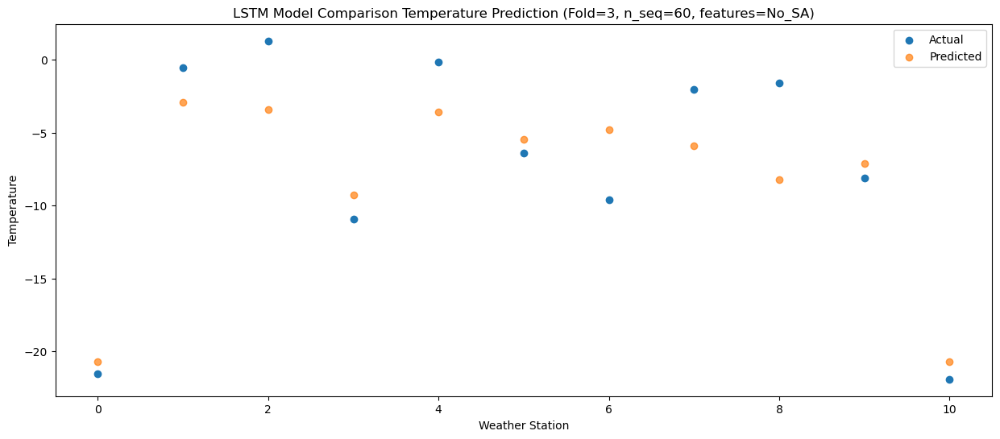

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -21.17 -24.063858
1                 1   -4.26  -6.253858
2                 2    3.59  -6.783857
3                 3  -12.26 -12.623858
4                 4   -4.01  -6.923858
5                 5   -9.11  -8.803858
6                 6   -9.50  -8.173857
7                 7    0.83  -9.253857
8                 8   -0.69 -11.573857
9                 9   -8.25 -10.493858
10               10  -22.71 -24.063857


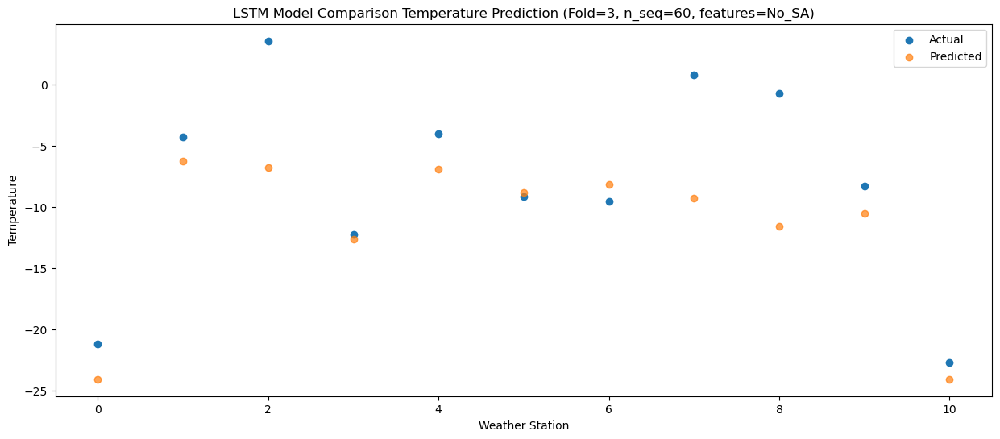

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0  -14.37 -12.860292
1                 1    7.71   4.949708
2                 2    4.74   4.419709
3                 3   -2.05  -1.420292
4                 4    9.07   4.279708
5                 5    2.22   2.399708
6                 6   -6.53   3.029709
7                 7    2.43   1.949709
8                 8   -0.91  -0.370291
9                 9   -3.25   0.709708
10               10  -15.52 -12.860291


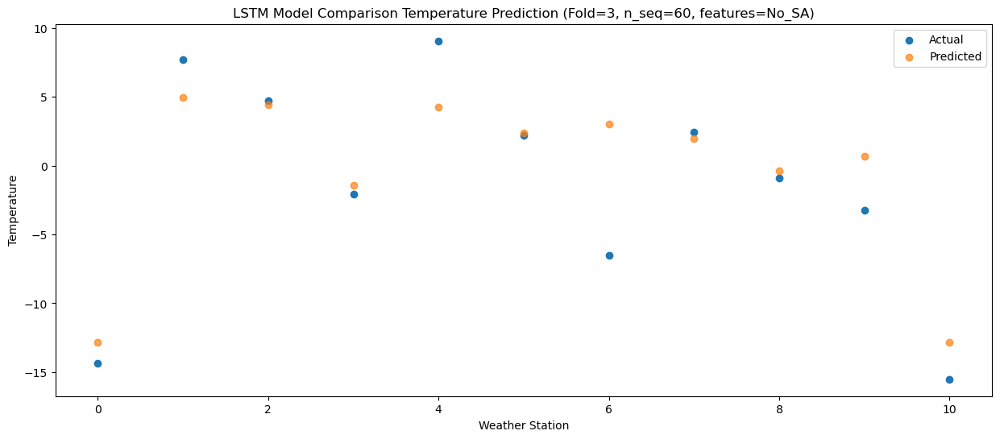

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0  -11.21  -9.569488
1                 1    9.57   8.240512
2                 2   10.47   7.710513
3                 3    0.30   1.870512
4                 4   12.36   7.570512
5                 5    5.67   5.690512
6                 6   -1.75   6.320513
7                 7   10.40   5.240513
8                 8    1.28   2.920513
9                 9    1.37   4.000512
10               10  -10.65  -9.569487


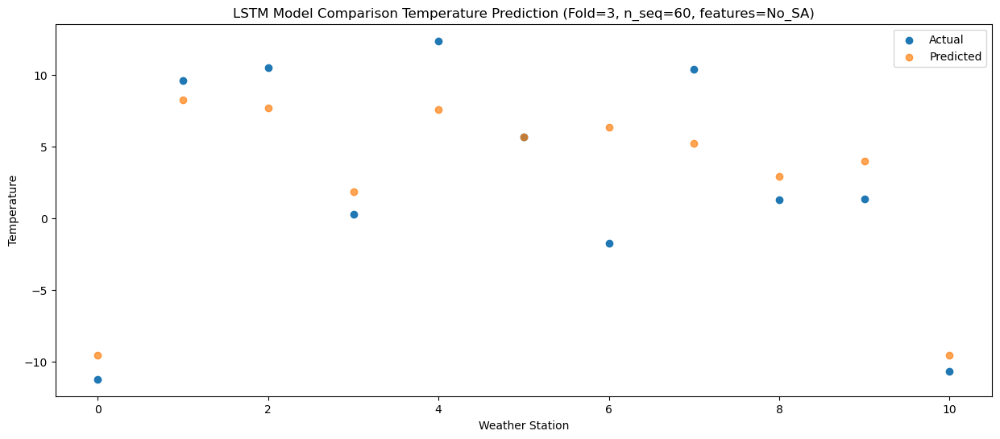

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   -7.55  -5.125358
1                 1   13.79  12.684642
2                 2   15.27  12.154643
3                 3    4.37   6.314642
4                 4   16.93  12.014642
5                 5    9.95  10.134642
6                 6    3.30  10.764643
7                 7   14.83   9.684643
8                 8    5.57   7.364643
9                 9    6.20   8.444642
10               10   -6.39  -5.125357


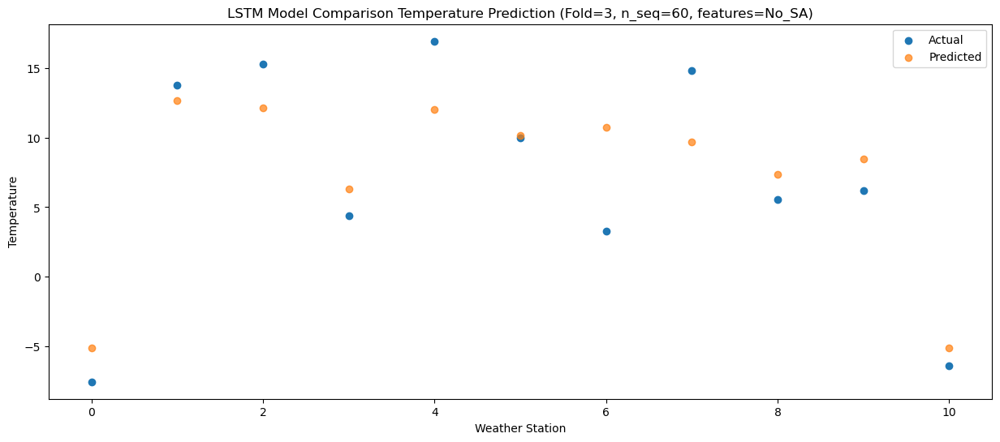

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   -3.49   1.588238
1                 1   20.50  19.398238
2                 2   20.12  18.868238
3                 3   10.29  13.028238
4                 4   24.41  18.728238
5                 5   16.66  16.848238
6                 6   10.69  17.478238
7                 7   22.47  16.398238
8                 8    7.27  14.078238
9                 9   12.07  15.158238
10               10   -0.22   1.588238


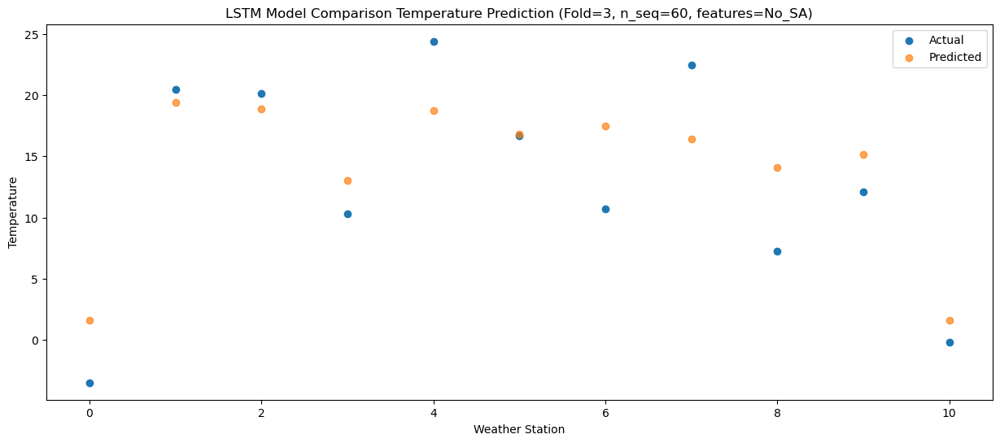

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   -1.78   2.081814
1                 1   21.81  19.891814
2                 2   23.25  19.361815
3                 3   11.28  13.521814
4                 4   24.41  19.221814
5                 5   17.04  17.341814
6                 6   12.53  17.971815
7                 7   23.55  16.891815
8                 8    6.45  14.571815
9                 9   14.21  15.651814
10               10    1.42   2.081815


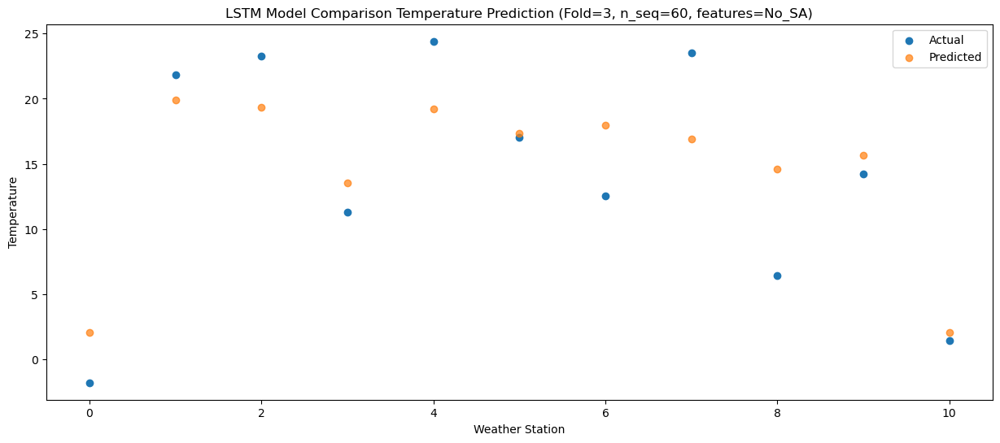

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   -1.56   2.769757
1                 1   22.38  20.579757
2                 2   21.05  20.049759
3                 3   11.80  14.209757
4                 4   24.53  19.909757
5                 5   17.36  18.029757
6                 6   10.61  18.659759
7                 7   22.32  17.579759
8                 8    7.00  15.259759
9                 9   14.83  16.339757
10               10    1.15   2.769759


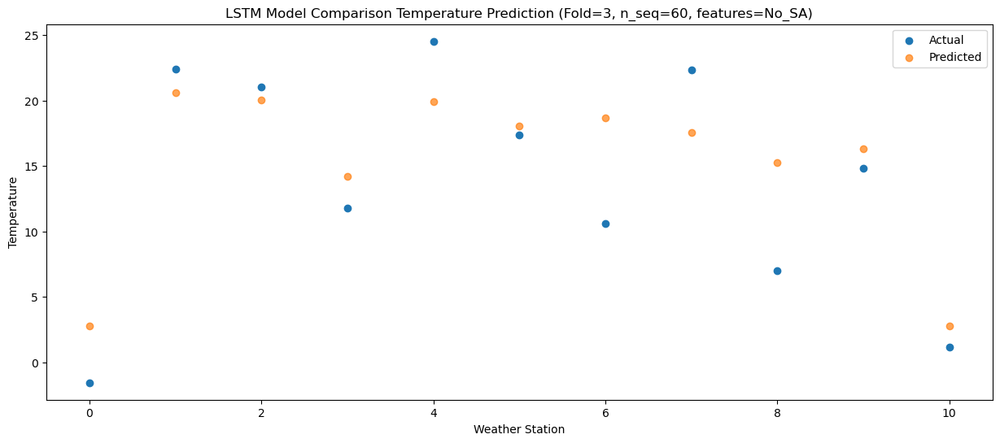

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   -5.55  -0.738935
1                 1   19.65  17.071065
2                 2   17.74  16.541068
3                 3    7.67  10.701065
4                 4   21.17  16.401065
5                 5   14.10  14.521065
6                 6    8.74  15.151068
7                 7   18.35  14.071068
8                 8    6.45  11.751068
9                 9   11.51  12.831065
10               10   -3.11  -0.738932


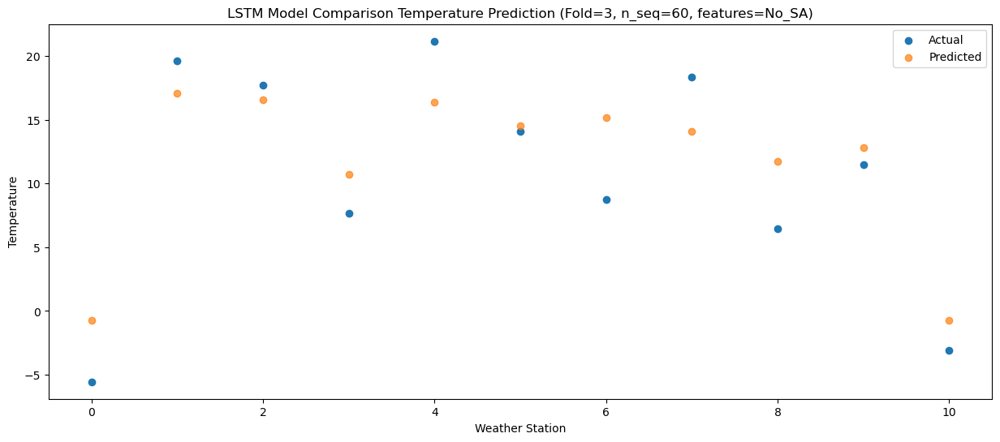

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   -8.78  -5.528169
1                 1   13.05  12.281831
2                 2    9.08  11.751833
3                 3    4.09   5.911831
4                 4   15.75  11.611831
5                 5    9.52   9.731831
6                 6    0.77  10.361833
7                 7    8.00   9.281833
8                 8    3.69   6.961833
9                 9    7.07   8.041831
10               10   -7.23  -5.528167


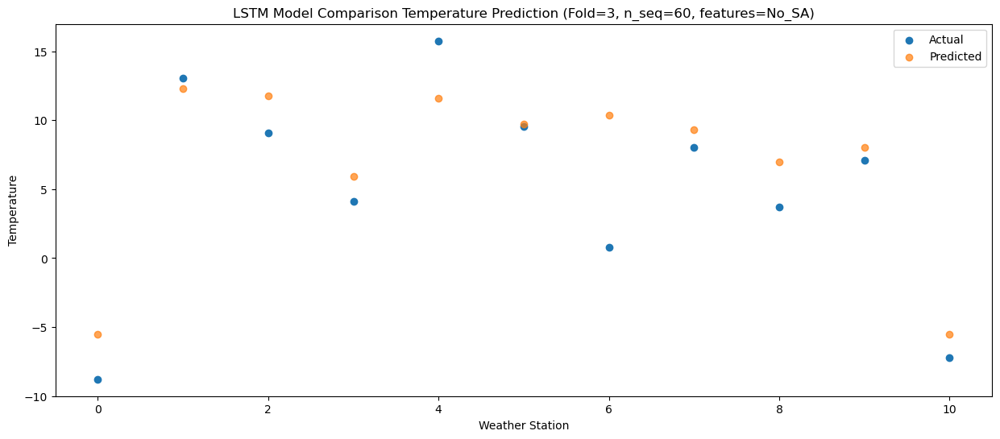

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0  -17.54 -15.178073
1                 1    5.34   2.631927
2                 2    4.74   2.101930
3                 3   -5.57  -3.738073
4                 4    6.01   1.961927
5                 5   -1.33   0.081927
6                 6   -1.97   0.711930
7                 7    5.48  -0.368070
8                 8    0.87  -2.688070
9                 9   -1.85  -1.608073
10               10  -17.45 -15.178070


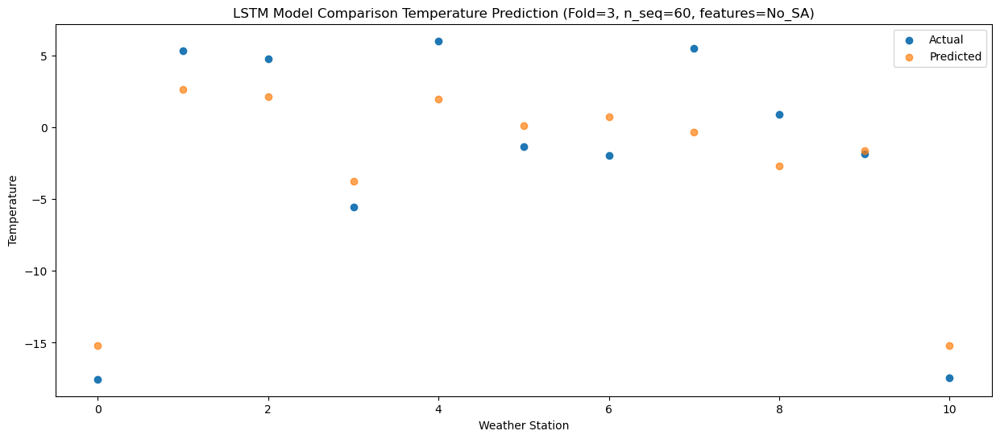

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0  -15.58 -15.338532
1                 1    6.65   2.471468
2                 2    0.82   1.941471
3                 3   -4.08  -3.898532
4                 4    5.65   1.801468
5                 5   -0.28  -0.078532
6                 6   -6.73   0.551471
7                 7   -1.79  -0.528529
8                 8   -2.83  -2.848529
9                 9   -3.45  -1.768532
10               10  -17.86 -15.338529


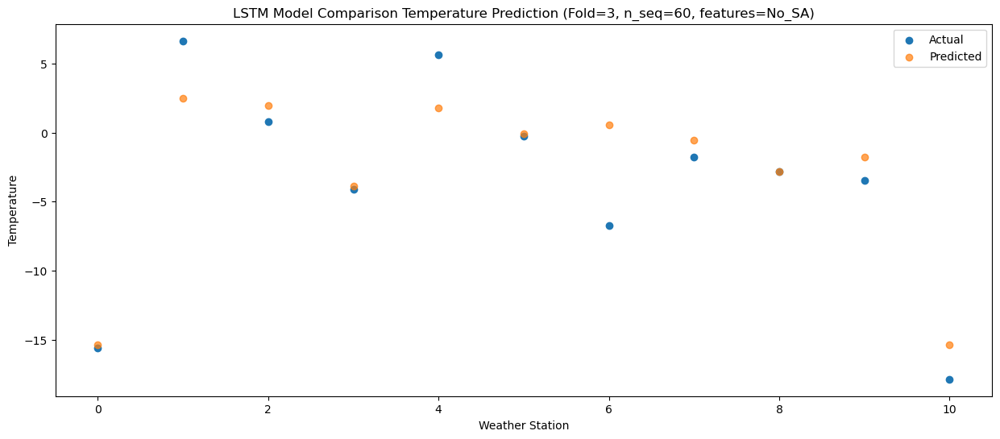

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -22.42 -24.131228
1                 1   -2.18  -6.321228
2                 2    0.49  -6.851225
3                 3  -13.03 -12.691228
4                 4   -3.82  -6.991228
5                 5   -9.10  -8.871228
6                 6   -9.02  -8.241225
7                 7   -1.86  -9.321225
8                 8   -2.21 -11.641225
9                 9  -10.00 -10.561228
10               10  -24.84 -24.131225


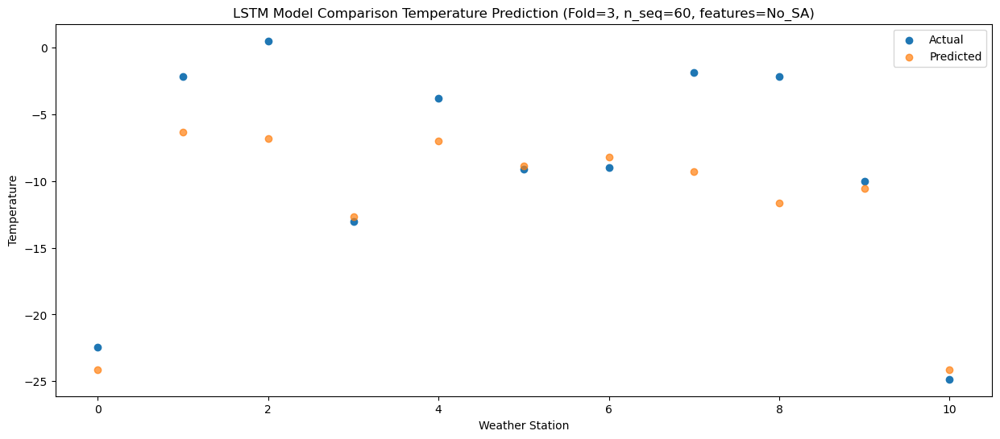

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0  -18.04 -21.848595
1                 1   -0.96  -4.038595
2                 2    2.19  -4.568592
3                 3   -8.51 -10.408595
4                 4   -1.30  -4.708595
5                 5   -5.91  -6.588595
6                 6  -10.74  -5.958592
7                 7    0.18  -7.038592
8                 8   -1.25  -9.358592
9                 9   -7.24  -8.278595
10               10  -21.03 -21.848592


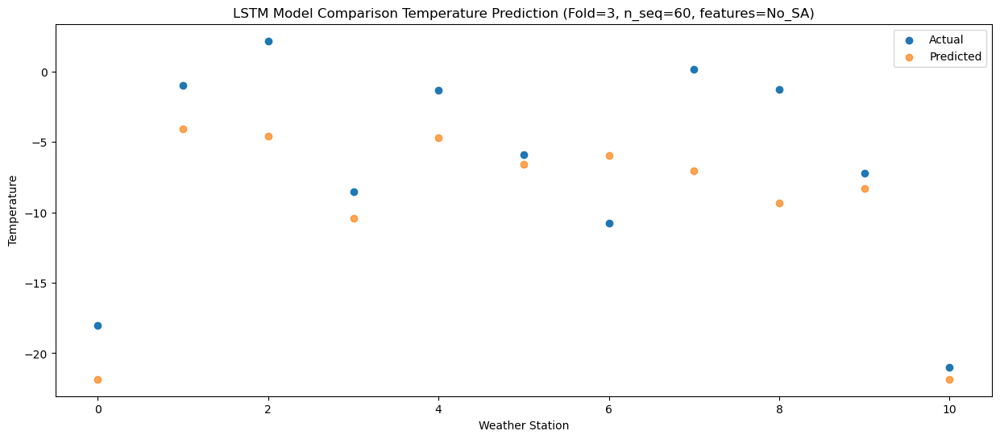

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0  -13.98 -15.041915
1                 1    5.82   2.768085
2                 2    6.90   2.238087
3                 3   -2.76  -3.601915
4                 4    7.16   2.098085
5                 5    1.05   0.218085
6                 6   -6.20   0.848087
7                 7    4.89  -0.231913
8                 8    0.98  -2.551913
9                 9   -3.28  -1.471915
10               10  -15.85 -15.041913


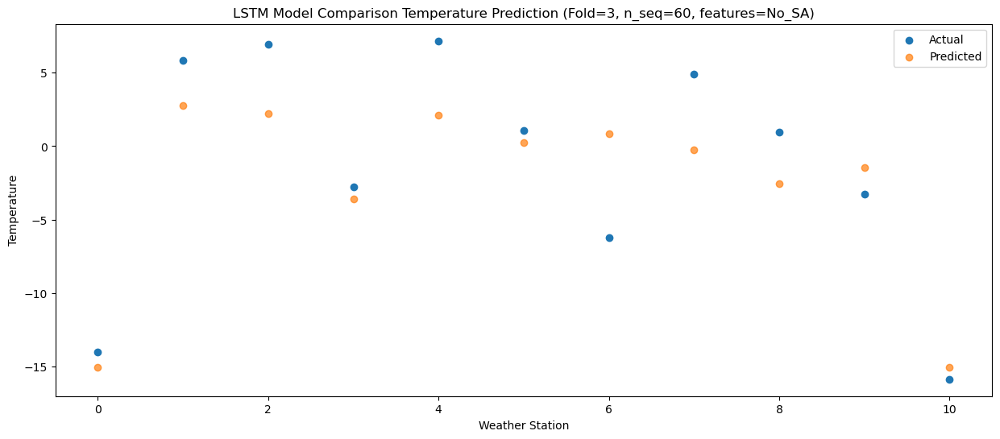

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0  -10.88 -10.397069
1                 1   10.67   7.412931
2                 2    9.97   6.882934
3                 3    0.25   1.042931
4                 4   11.29   6.742931
5                 5    4.90   4.862931
6                 6   -1.88   5.492934
7                 7    9.52   4.412934
8                 8    2.42   2.092934
9                 9    1.01   3.172931
10               10  -12.03 -10.397066


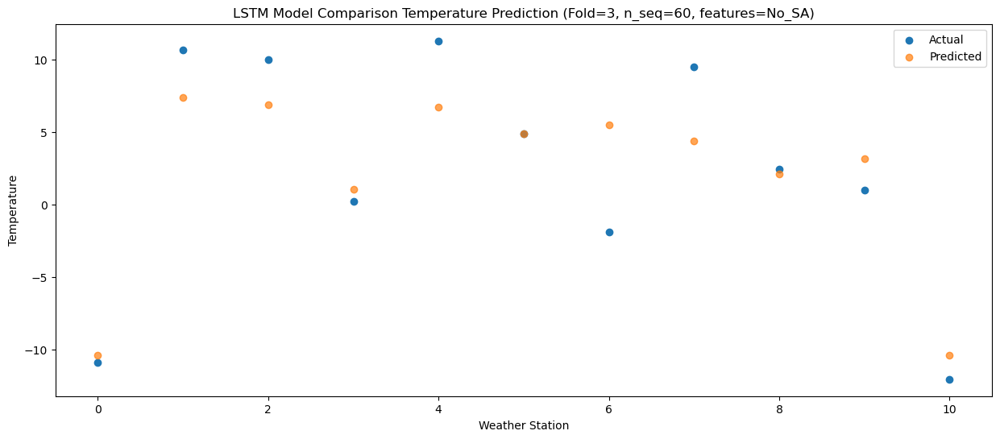

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   -6.04  -2.947396
1                 1   16.10  14.862604
2                 2   14.21  14.332607
3                 3    7.03   8.492604
4                 4   18.86  14.192604
5                 5   12.70  12.312604
6                 6    4.03  12.942607
7                 7   14.19  11.862607
8                 8    5.41   9.542607
9                 9    6.80  10.622604
10               10   -5.25  -2.947393


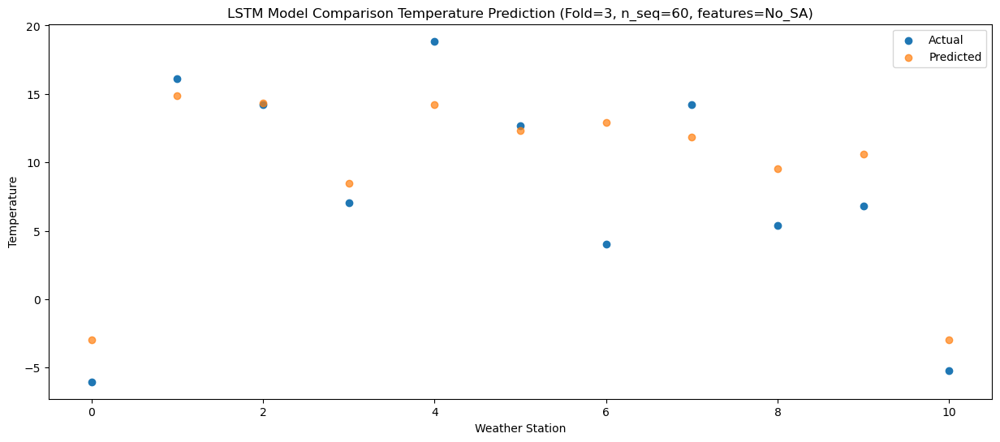

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   -2.08   1.358339
1                 1   21.25  19.168339
2                 2   19.60  18.638340
3                 3   10.51  12.798339
4                 4   24.31  18.498339
5                 5   16.64  16.618339
6                 6    9.80  17.248342
7                 7   20.67  16.168340
8                 8    8.56  13.848342
9                 9   11.12  14.928339
10               10   -1.26   1.358342


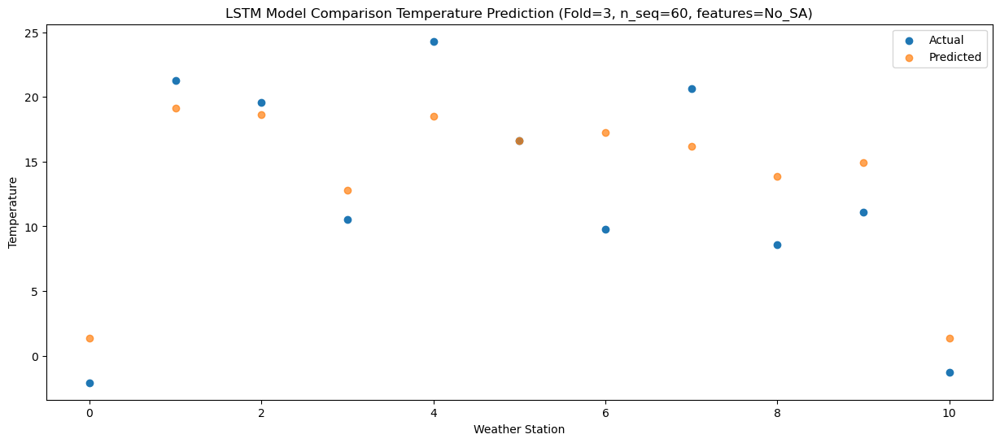

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   -1.31   3.368135
1                 1   25.29  21.178135
2                 2   22.17  20.648136
3                 3   12.06  14.808135
4                 4   25.43  20.508135
5                 5   18.63  18.628135
6                 6   11.72  19.258138
7                 7   22.90  18.178136
8                 8    6.91  15.858138
9                 9   15.67  16.938135
10               10    2.52   3.368138


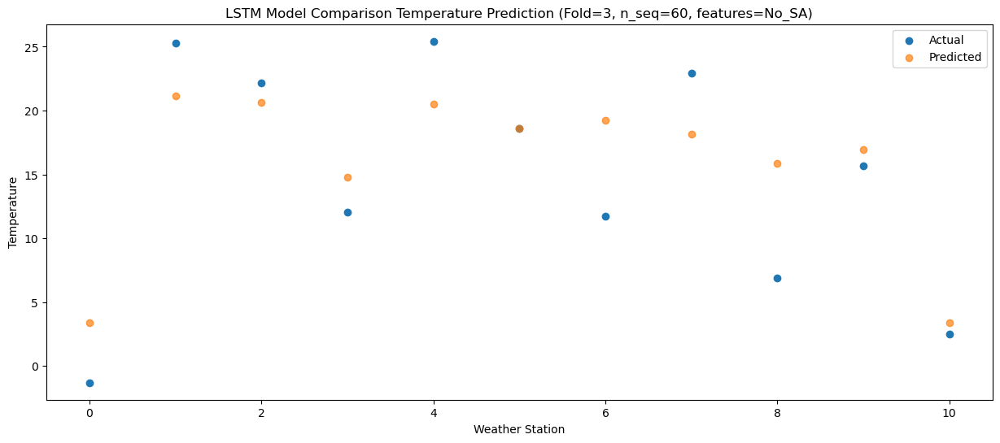

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   -2.22   1.362891
1                 1   22.21  19.172891
2                 2   22.35  18.642892
3                 3   10.99  12.802891
4                 4   23.61  18.502891
5                 5   16.98  16.622891
6                 6   10.96  17.252894
7                 7   21.31  16.172892
8                 8    8.33  13.852894
9                 9   15.59  14.932891
10               10    1.65   1.362894


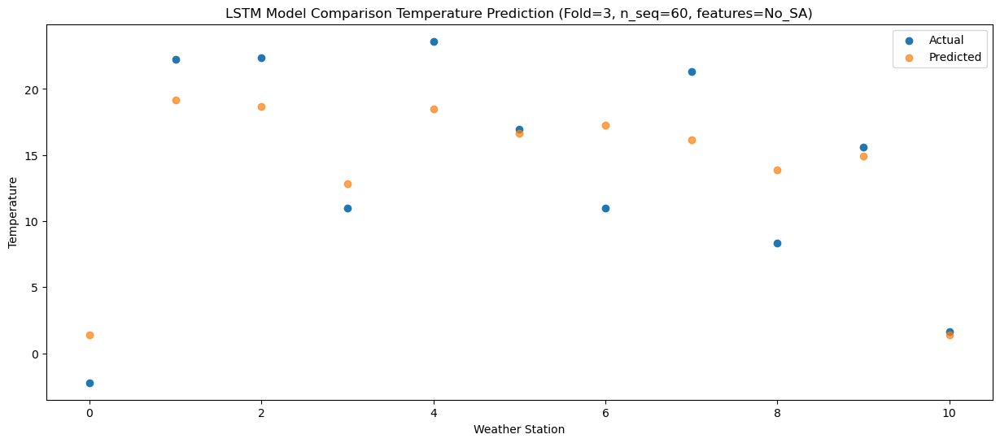

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   -5.43  -2.311285
1                 1   18.35  15.498715
2                 2   19.53  14.968716
3                 3    7.01   9.128715
4                 4   19.29  14.828715
5                 5   13.03  12.948715
6                 6    8.80  13.578718
7                 7   18.95  12.498716
8                 8    8.56  10.178718
9                 9   10.68  11.258715
10               10   -3.58  -2.311282


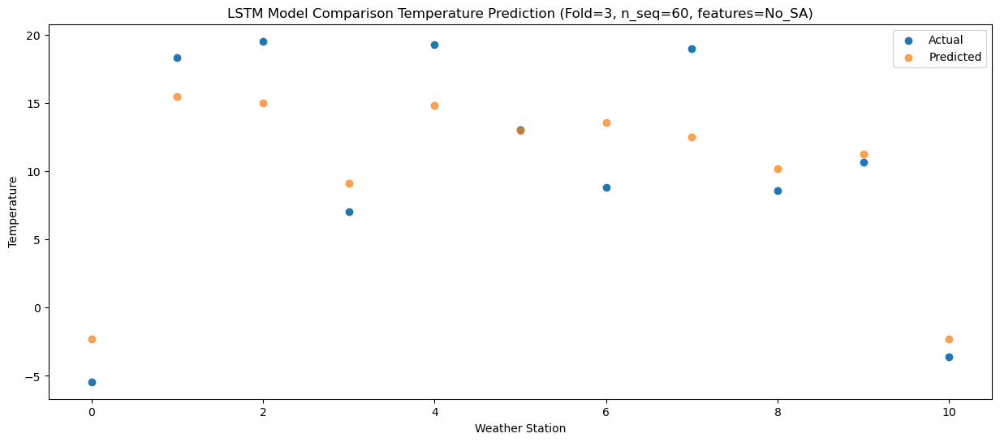

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0  -12.44  -9.580149
1                 1   11.80   8.229851
2                 2   12.35   7.699852
3                 3   -0.26   1.859851
4                 4   12.02   7.559851
5                 5    6.99   5.679851
6                 6    0.54   6.309854
7                 7   11.06   5.229852
8                 8    3.83   2.909854
9                 9    4.42   3.989851
10               10  -11.19  -9.580146


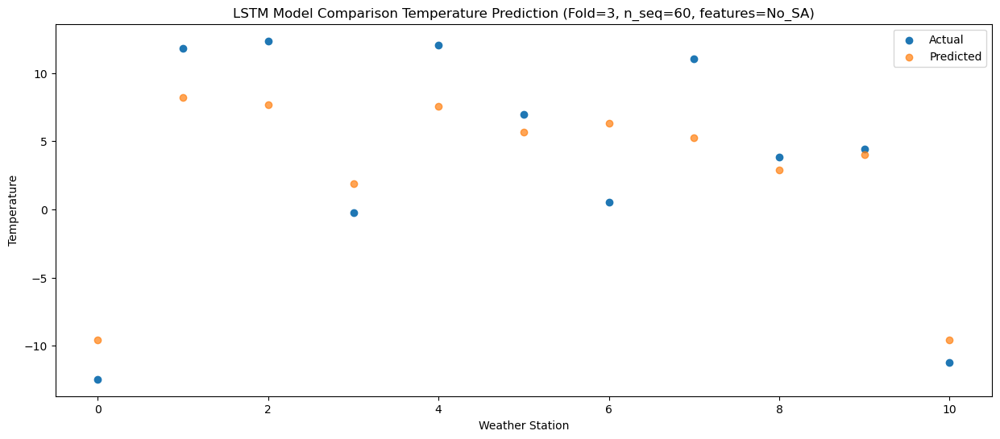

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0  -14.47 -15.404712
1                 1    4.57   2.405288
2                 2    1.62   1.875290
3                 3   -3.38  -3.964712
4                 4    6.13   1.735289
5                 5    0.44  -0.144712
6                 6   -7.14   0.485292
7                 7   -0.36  -0.594710
8                 8   -1.90  -2.914708
9                 9    0.46  -1.834711
10               10  -14.31 -15.404708


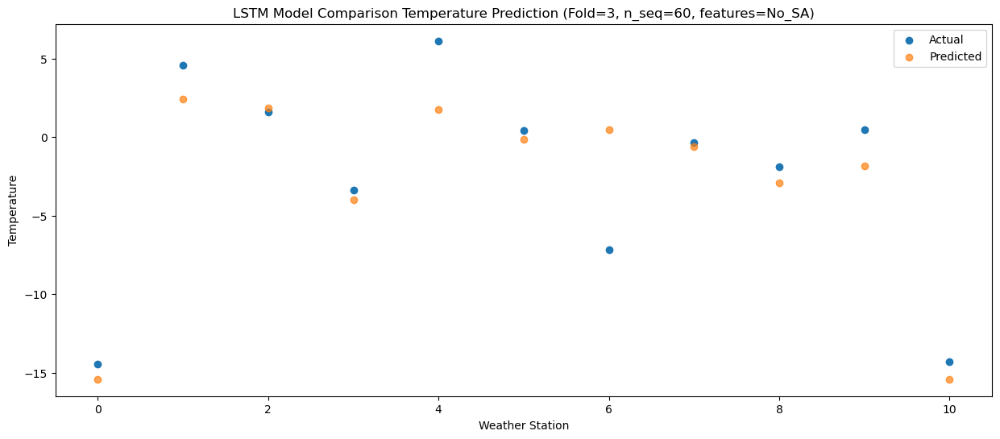

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0  -21.35 -20.442661
1                 1    0.52  -2.632661
2                 2    0.66  -3.162659
3                 3   -8.65  -9.002661
4                 4    0.16  -3.302660
5                 5   -5.10  -5.182661
6                 6   -9.31  -4.552657
7                 7   -2.69  -5.632659
8                 8   -3.10  -7.952657
9                 9   -5.90  -6.872660
10               10  -21.34 -20.442657


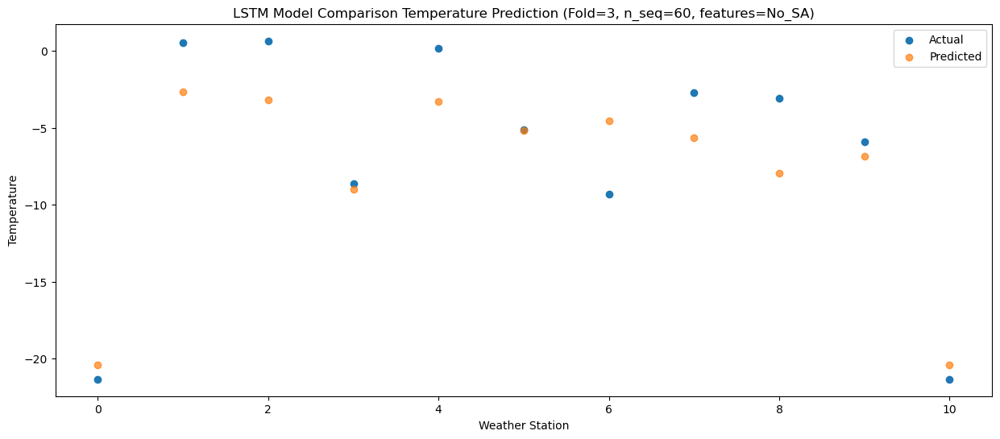

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0  -17.93 -18.997460
1                 1    1.22  -1.187460
2                 2    2.05  -1.717458
3                 3   -6.90  -7.557460
4                 4    1.88  -1.857459
5                 5   -2.96  -3.737460
6                 6  -10.04  -3.107456
7                 7   -3.20  -4.187458
8                 8   -1.43  -6.507456
9                 9   -3.92  -5.427459
10               10  -18.69 -18.997456


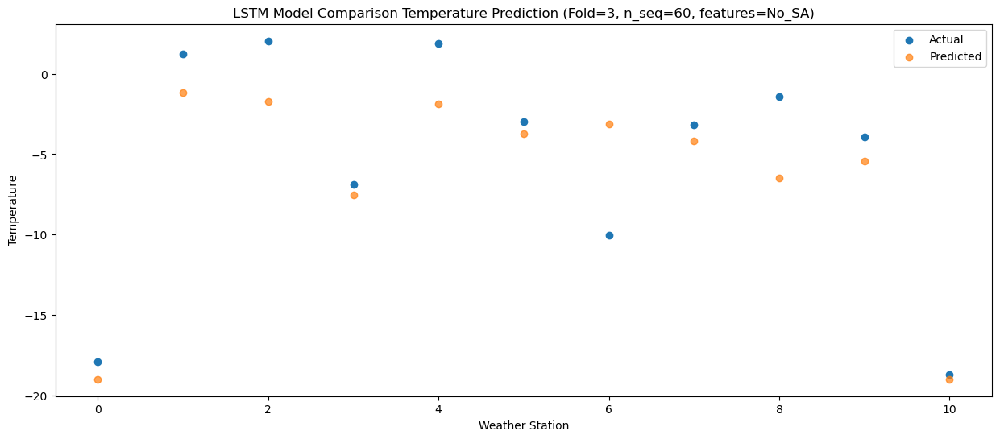

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0  -15.11 -17.601083
1                 1    3.18   0.208917
2                 2    1.20  -0.321081
3                 3   -4.56  -6.161083
4                 4    8.40  -0.461082
5                 5   -1.24  -2.341083
6                 6  -10.01  -1.711079
7                 7   -2.29  -2.791081
8                 8   -3.23  -5.111079
9                 9   -5.65  -4.031082
10               10  -18.48 -17.601079


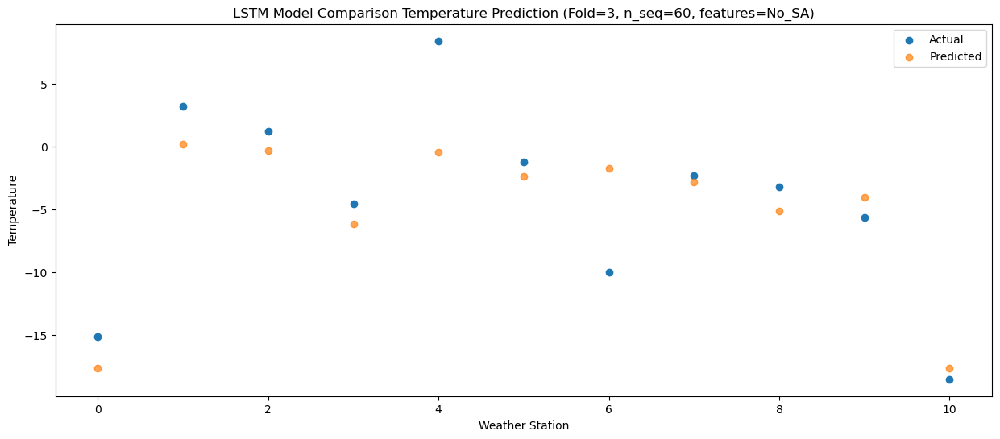

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0  -14.64 -15.079683
1                 1    5.78   2.730317
2                 2    4.07   2.200319
3                 3   -4.32  -3.639683
4                 4    5.44   2.060318
5                 5   -0.34   0.180317
6                 6   -8.22   0.810321
7                 7    0.54  -0.269681
8                 8   -1.77  -2.589679
9                 9   -3.68  -1.509682
10               10  -16.92 -15.079679


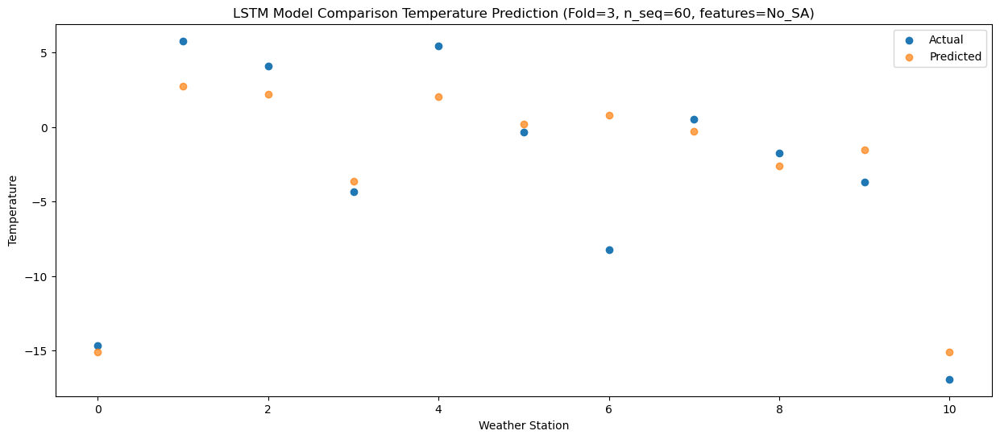

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0  -10.97  -8.812779
1                 1   10.83   8.997221
2                 2    9.70   8.467223
3                 3    1.92   2.627221
4                 4   12.65   8.327222
5                 5    5.89   6.447221
6                 6   -2.88   7.077225
7                 7    8.49   5.997223
8                 8    2.31   3.677225
9                 9    2.37   4.757222
10               10   -9.35  -8.812775


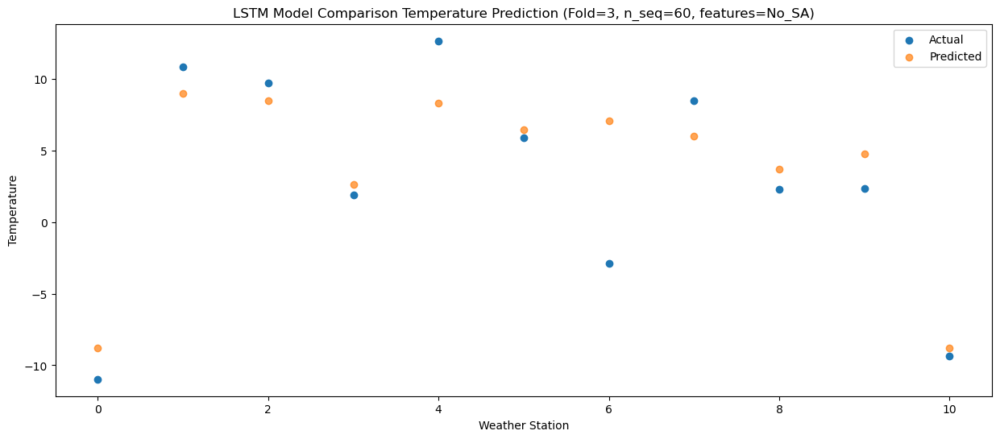

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   -8.61  -3.448425
1                 1   16.14  14.361575
2                 2   14.14  13.831577
3                 3    4.61   7.991575
4                 4   18.65  13.691576
5                 5   11.30  11.811575
6                 6    4.33  12.441579
7                 7   14.29  11.361577
8                 8    3.34   9.041579
9                 9    6.01  10.121576
10               10   -6.88  -3.448421


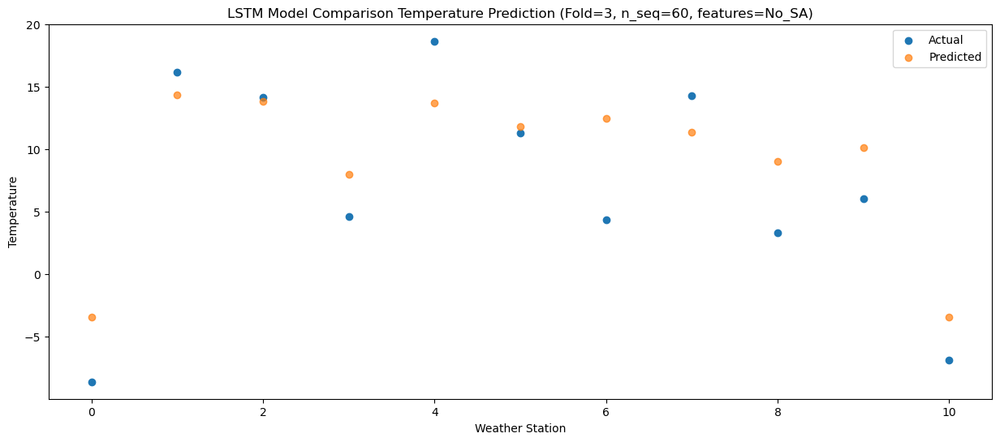

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   -4.84   0.551090
1                 1   20.47  18.361090
2                 2   16.94  17.831094
3                 3    8.35  11.991090
4                 4   22.75  17.691091
5                 5   14.76  15.811090
6                 6    8.91  16.441096
7                 7   16.79  15.361094
8                 8    5.24  13.041096
9                 9   10.00  14.121091
10               10   -2.95   0.551094


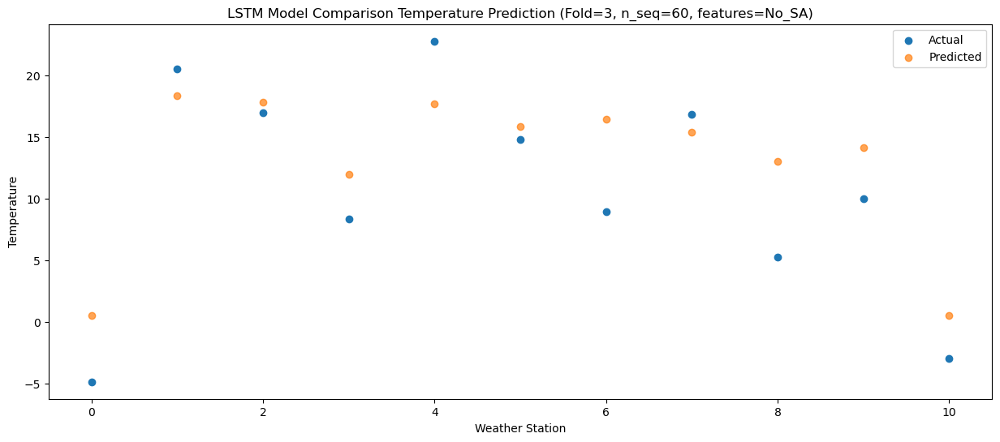

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   -1.06   2.934833
1                 1   22.73  20.744833
2                 2   22.60  20.214837
3                 3   11.97  14.374833
4                 4   24.45  20.074834
5                 5   18.02  18.194833
6                 6   15.05  18.824839
7                 7   25.15  17.744837
8                 8    8.25  15.424839
9                 9   15.68  16.504834
10               10    1.89   2.934837


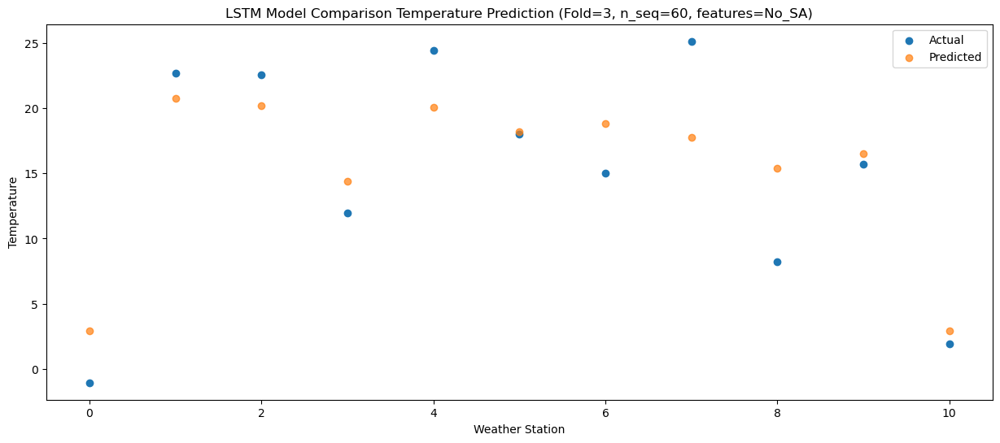

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   -1.57   2.558107
1                 1   22.91  20.368107
2                 2   20.91  19.838110
3                 3   10.86  13.998107
4                 4   23.16  19.698108
5                 5   16.47  17.818107
6                 6   12.46  18.448112
7                 7   20.52  17.368110
8                 8    9.28  15.048112
9                 9   13.43  16.128108
10               10   -0.08   2.558110


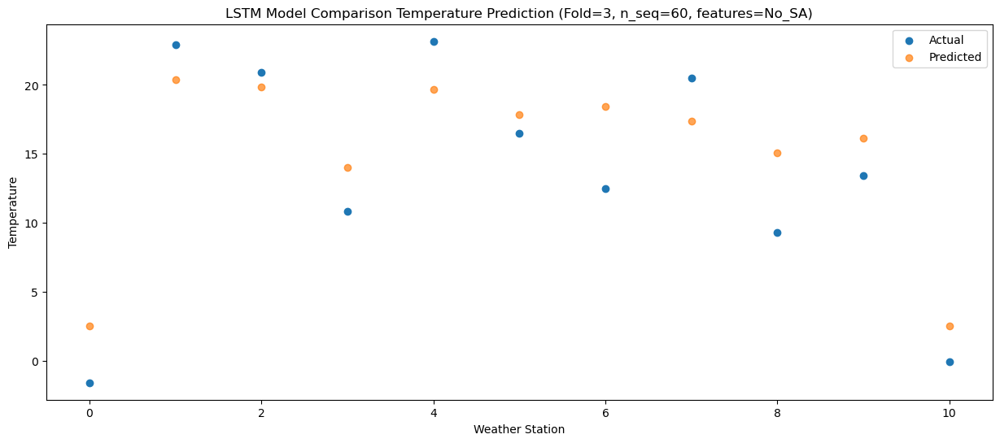

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   -5.71  -0.665169
1                 1   18.86  17.144831
2                 2   17.14  16.614835
3                 3    8.13  10.774831
4                 4   19.80  16.474832
5                 5   13.01  14.594831
6                 6    8.31  15.224837
7                 7   15.82  14.144835
8                 8    6.67  11.824837
9                 9   10.86  12.904832
10               10   -3.37  -0.665165


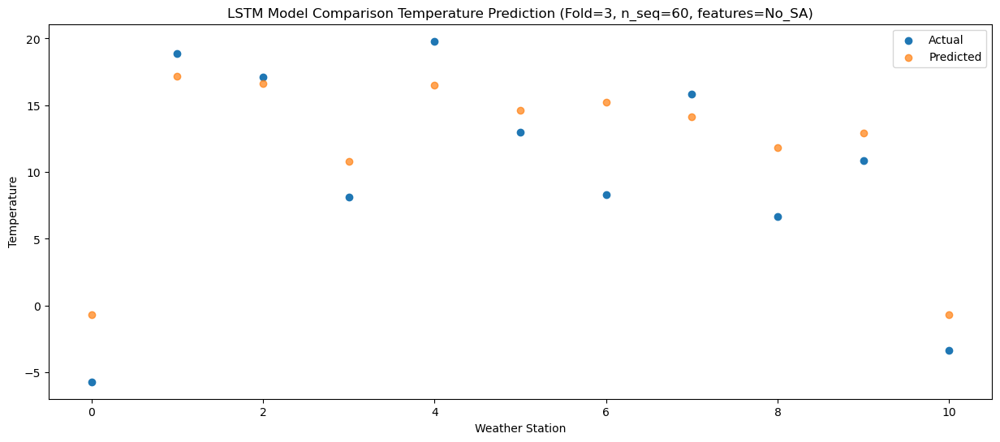

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0  -10.74  -7.137441
1                 1   11.92  10.672559
2                 2   11.83  10.142562
3                 3    2.69   4.302559
4                 4   13.34  10.002560
5                 5    7.36   8.122559
6                 6    2.18   8.752564
7                 7   10.53   7.672562
8                 8    5.21   5.352564
9                 9    5.43   6.432560
10               10   -8.66  -7.137438


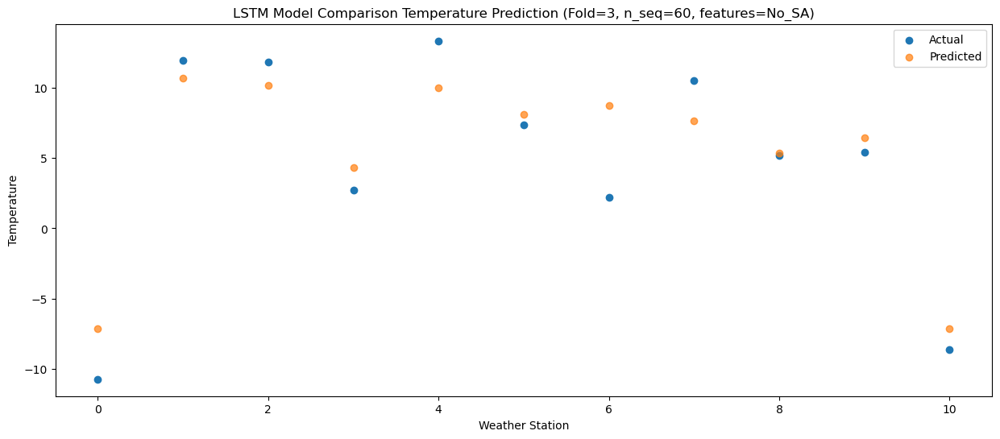

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0  -16.40 -14.119360
1                 1    6.14   3.690640
2                 2    4.92   3.160644
3                 3   -3.70  -2.679360
4                 4    6.39   3.020641
5                 5    0.88   1.140641
6                 6   -3.68   1.770645
7                 7    2.39   0.690644
8                 8    1.17  -1.629355
9                 9   -2.42  -0.549359
10               10  -16.93 -14.119356


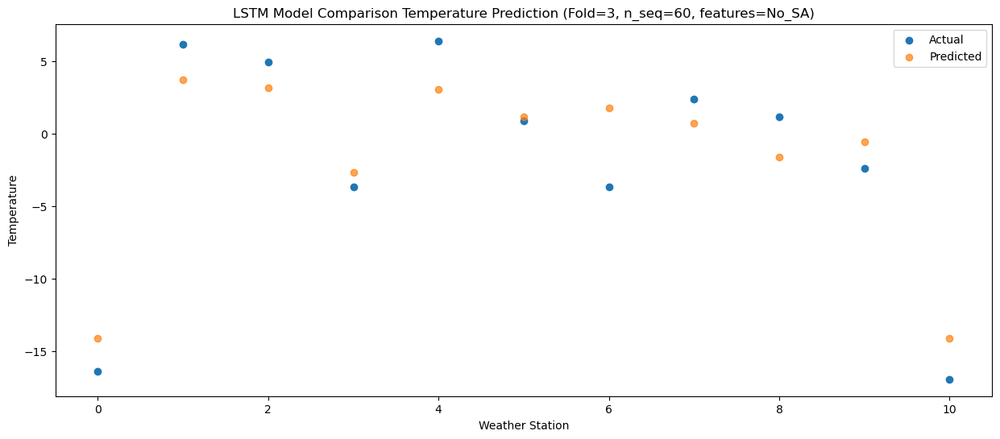

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0  -18.45 -16.321444
1                 1    2.79   1.488556
2                 2    3.08   0.958560
3                 3   -5.53  -4.881444
4                 4    3.58   0.818557
5                 5   -1.58  -1.061443
6                 6   -7.31  -0.431438
7                 7   -0.74  -1.511440
8                 8   -0.67  -3.831438
9                 9   -3.15  -2.751443
10               10  -17.68 -16.321440


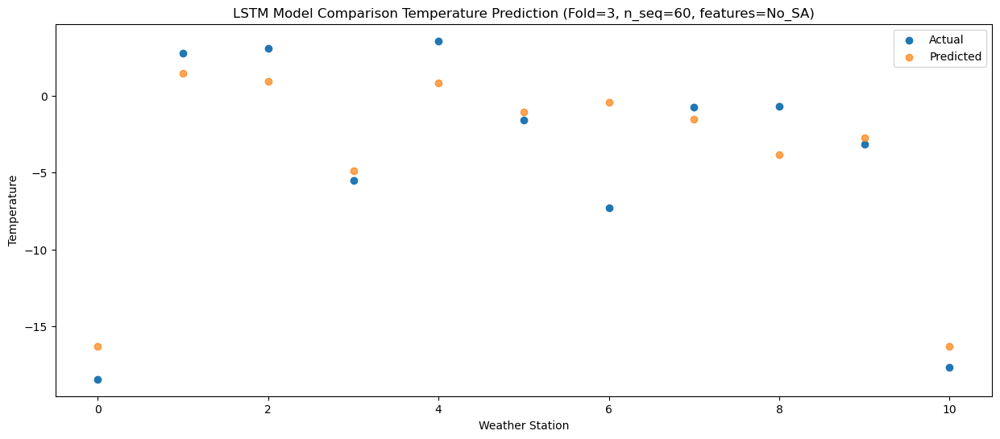

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -20.76 -22.079541
1                 1   -3.82  -4.269541
2                 2    2.87  -4.799537
3                 3  -10.69 -10.639541
4                 4   -2.92  -4.939540
5                 5   -7.74  -6.819540
6                 6   -9.45  -6.189535
7                 7   -2.46  -7.269537
8                 8   -0.36  -9.589535
9                 9   -7.14  -8.509540
10               10  -20.70 -22.079537


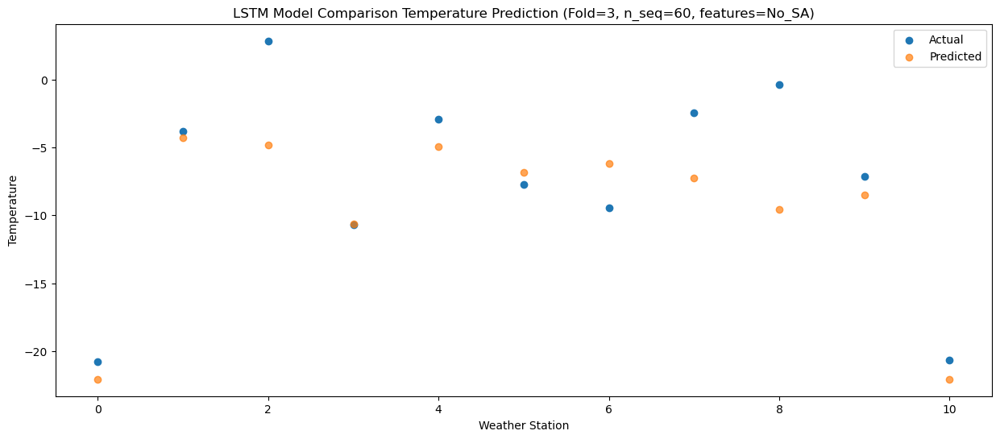

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0  -17.62 -15.670600
1                 1    5.83   2.139400
2                 2    4.36   1.609404
3                 3   -5.01  -4.230600
4                 4    4.89   1.469401
5                 5   -1.11  -0.410599
6                 6   -7.29   0.219406
7                 7   -0.10  -0.860596
8                 8   -0.65  -3.180594
9                 9   -6.57  -2.100599
10               10  -18.66 -15.670596


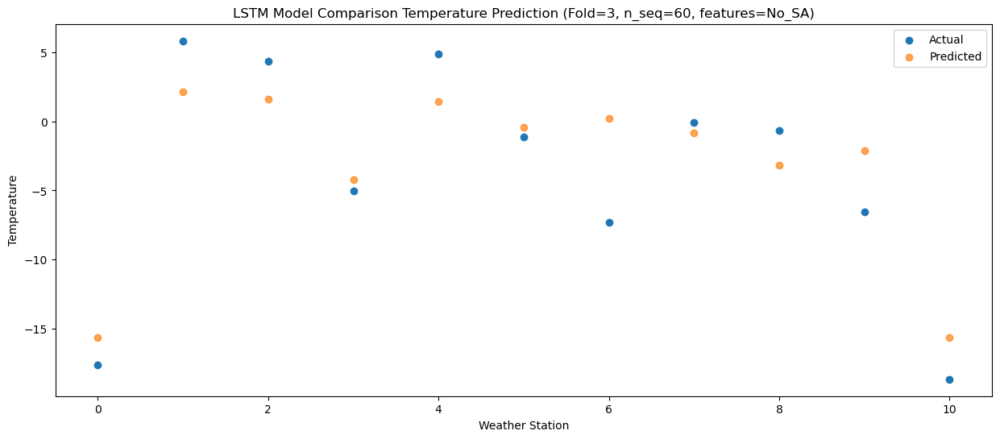

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0  -13.95 -11.949860
1                 1    8.31   5.860140
2                 2    6.39   5.330144
3                 3   -1.36  -0.509860
4                 4    9.00   5.190141
5                 5    2.96   3.310141
6                 6   -5.55   3.940146
7                 7    3.26   2.860144
8                 8    0.28   0.540146
9                 9   -1.87   1.620141
10               10  -14.00 -11.949856


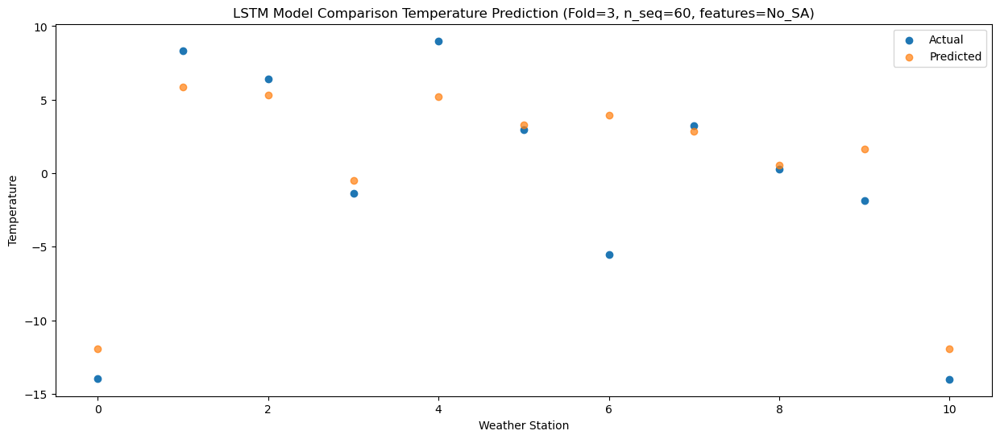

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -9.93  -7.192355
1                 1   12.48  10.617645
2                 2    9.58  10.087649
3                 3    3.70   4.247645
4                 4   13.75   9.947646
5                 5    7.93   8.067646
6                 6   -0.57   8.697651
7                 7    8.76   7.617649
8                 8    2.51   5.297651
9                 9    1.00   6.377646
10               10   -9.42  -7.192351


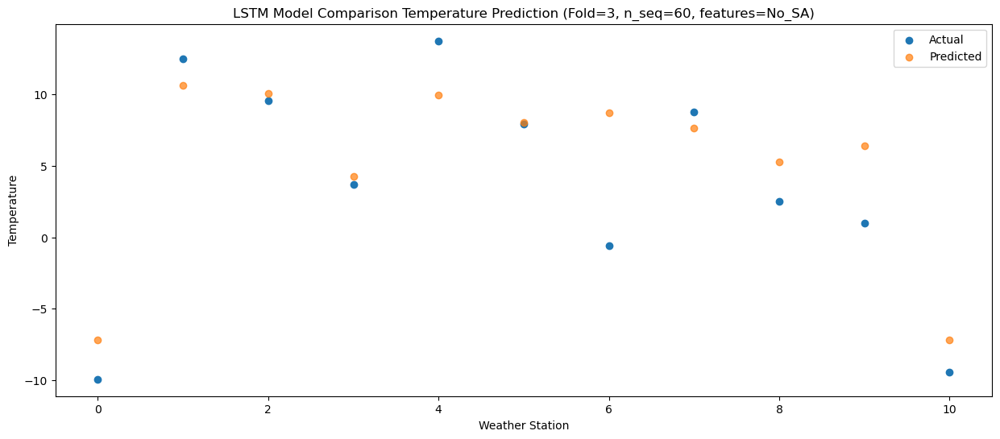

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   -5.66  -1.300637
1                 1   17.25  16.509363
2                 2   14.97  15.979366
3                 3    7.89  10.139363
4                 4   19.91  15.839364
5                 5   13.45  13.959364
6                 6    2.54  14.589368
7                 7   14.39  13.509366
8                 8    5.48  11.189368
9                 9    6.55  12.269364
10               10   -3.75  -1.300634


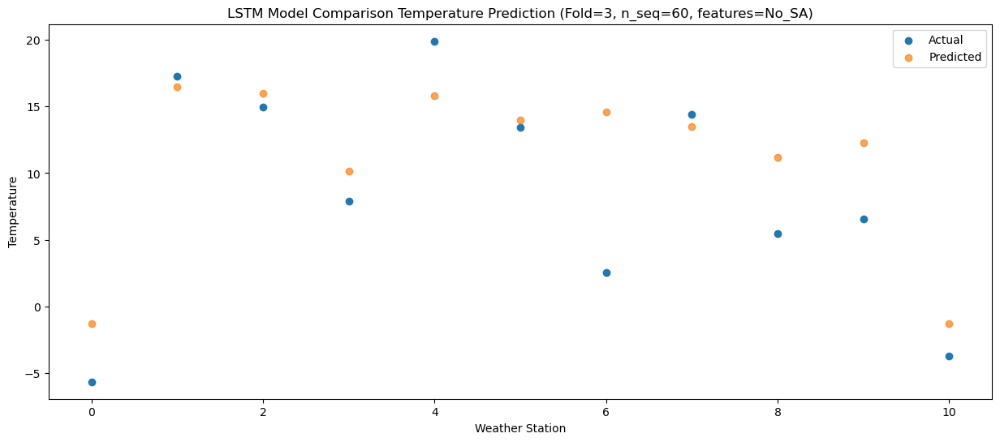

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   -2.00   2.409677
1                 1   21.81  20.219677
2                 2   20.92  19.689680
3                 3   11.79  13.849677
4                 4   24.78  19.549677
5                 5   16.68  17.669677
6                 6   11.69  18.299682
7                 7   22.57  17.219680
8                 8    8.39  14.899682
9                 9   13.02  15.979677
10               10    1.62   2.409680


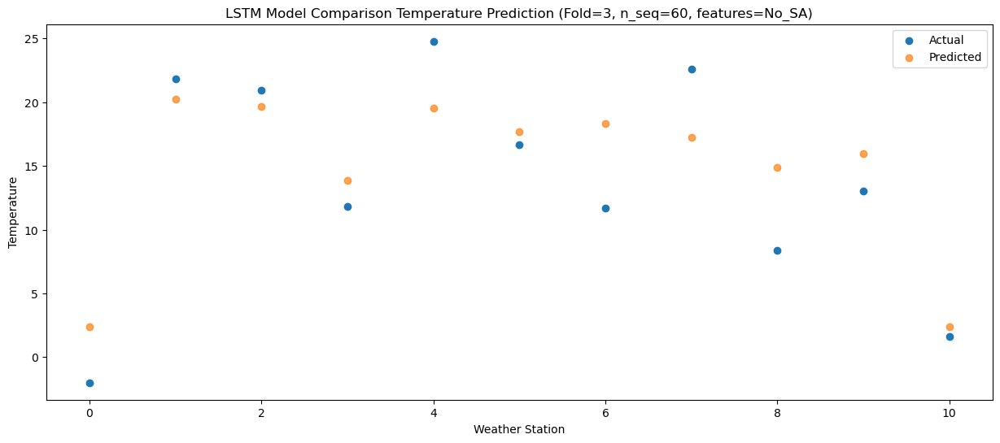

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   -1.11   2.416516
1                 1   22.33  20.226516
2                 2   24.49  19.696520
3                 3   13.50  13.856516
4                 4   23.94  19.556517
5                 5   17.23  17.676517
6                 6   12.44  18.306522
7                 7   25.65  17.226520
8                 8    9.65  14.906522
9                 9   15.58  15.986517
10               10    4.28   2.416520


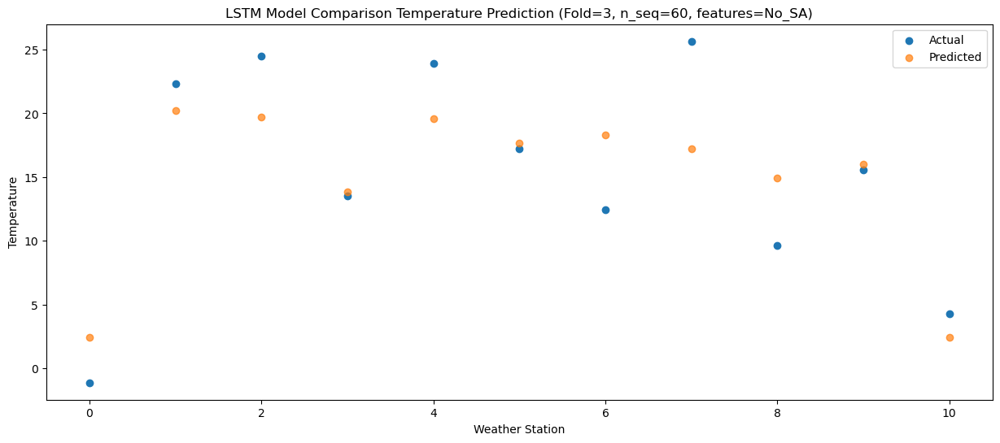

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   -2.51   2.348799
1                 1   22.61  20.158799
2                 2   21.52  19.628803
3                 3   12.48  13.788799
4                 4   23.39  19.488800
5                 5   16.68  17.608800
6                 6   12.15  18.238805
7                 7   22.79  17.158803
8                 8    8.37  14.838805
9                 9   13.86  15.918800
10               10    1.14   2.348803


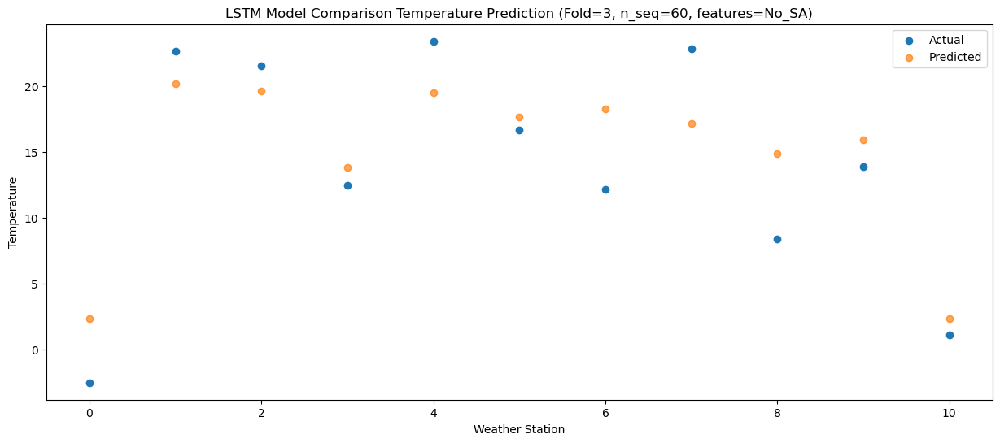

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   -5.20   0.018547
1                 1   18.57  17.828547
2                 2   18.49  17.298551
3                 3    9.51  11.458547
4                 4   20.13  17.158548
5                 5   13.99  15.278548
6                 6    8.53  15.908553
7                 7   18.84  14.828551
8                 8    6.93  12.508553
9                 9    9.85  13.588548
10               10   -2.45   0.018551


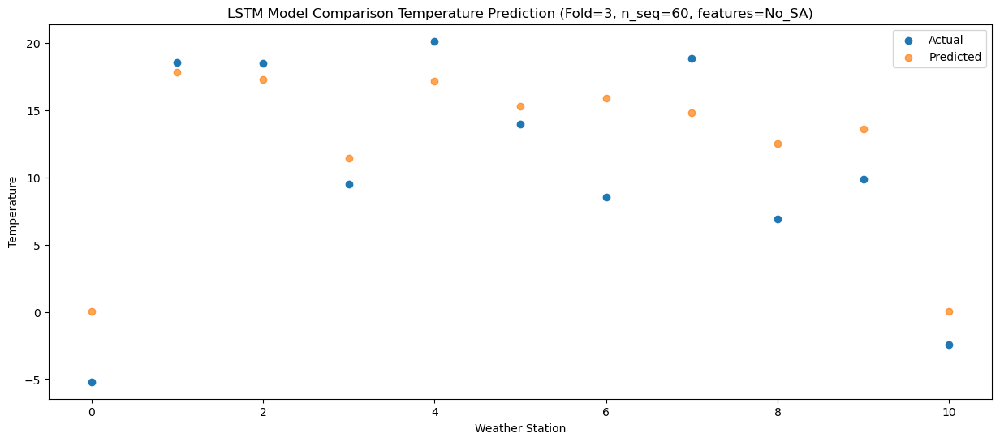

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0  -10.51  -5.685723
1                 1   15.18  12.124277
2                 2   13.46  11.594281
3                 3    3.01   5.754277
4                 4   14.50  11.454278
5                 5    8.11   9.574278
6                 6    4.30  10.204283
7                 7   12.95   9.124281
8                 8    6.47   6.804283
9                 9    5.32   7.884278
10               10   -7.69  -5.685719


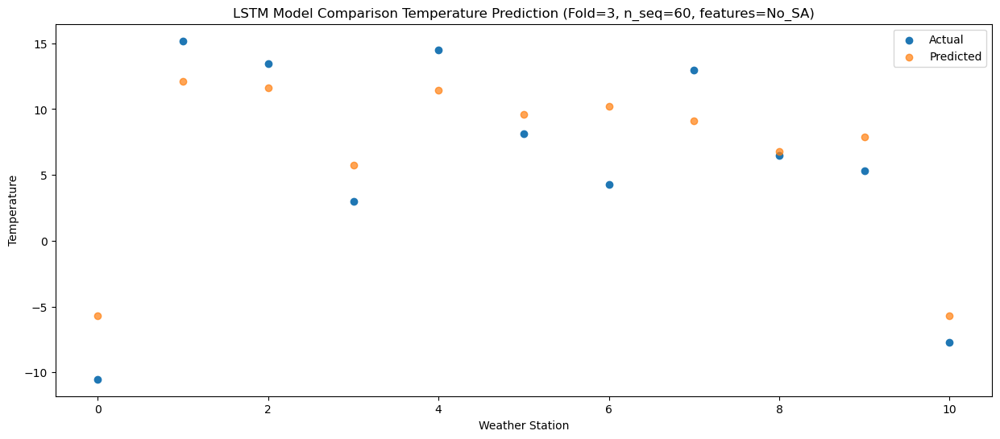

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_16 (LSTM)              (1, 1, 512)               4767744   
                                                                 
 dropout_16 (Dropout)        (1, 1, 512)               0         
                                                                 
 lstm_17 (LSTM)              (1, 512)                  2099200   
                                                                 
 dropout_17 (Dropout)        (1, 512)                  0         
                                                                 
 dense_24 (Dense)            (1, 256)                  131328    
                                                                 
 dense_25 (Dense)            (1, 128)                  32896     
                                                                 
 dense_26 (Dense)            (1, 60)                  

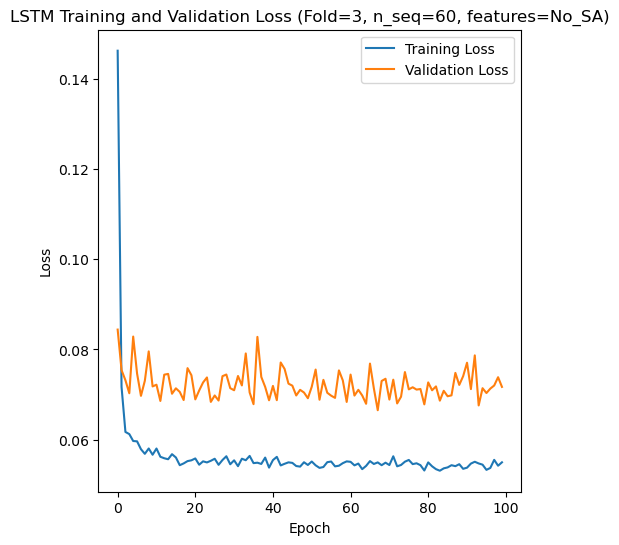

Epoch 1/100
84/84 [==============================] - 8s 38ms/step - loss: 0.1505 - accuracy: 0.1905 - mae: 0.1234 - rmse: 0.1505 - mape: inf - pearson: 0.5574 - val_loss: 0.0936 - val_accuracy: 0.1000 - val_mae: 0.0744 - val_rmse: 0.0936 - val_mape: 16.2516 - val_pearson: 0.7268
Epoch 2/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0750 - accuracy: 0.3452 - mae: 0.0598 - rmse: 0.0750 - mape: inf - pearson: 0.7869 - val_loss: 0.0768 - val_accuracy: 0.6000 - val_mae: 0.0621 - val_rmse: 0.0768 - val_mape: 15.1722 - val_pearson: 0.8041
Epoch 3/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0628 - accuracy: 0.4524 - mae: 0.0499 - rmse: 0.0628 - mape: inf - pearson: 0.8311 - val_loss: 0.0703 - val_accuracy: 0.6000 - val_mae: 0.0574 - val_rmse: 0.0703 - val_mape: 13.3968 - val_pearson: 0.8335
Epoch 4/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0603 - accuracy: 0.4643 - mae: 0.0477 - rmse: 0.0603 - mape: inf - pearson: 0.8369 -

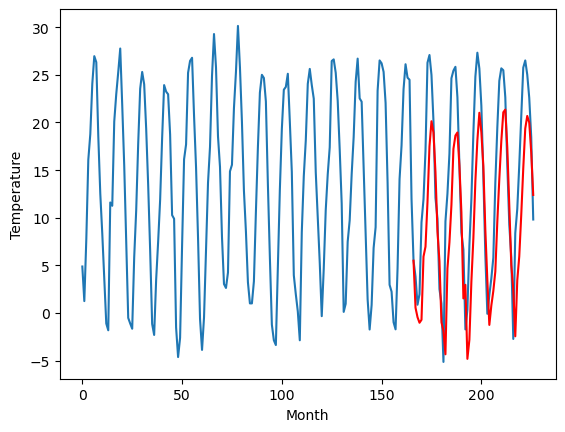

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.37		-1.11		-1.48
0.19		-2.11		-2.30
-1.27		-2.69		-1.42
0.28		-2.38		-2.66
4.35		4.25		-0.10
6.03		5.29		-0.74
7.43		9.98		2.55
9.19		15.81		6.62
9.51		18.45		8.94
9.36		17.28		7.92
8.78		13.11		4.33
7.28		6.89		-0.39
3.89		3.76		-0.13
-3.86		-2.64		1.22
-3.16		-3.55		-0.39
0.27		-6.00		-6.27
1.87		3.01		1.14
3.31		5.73		2.42
7.35		9.67		2.32
8.98		15.54		6.56
9.35		16.95		7.60
9.63		17.27		7.64
8.34		13.80		5.46
6.50		8.88		2.38
-0.66		-0.14		0.52
1.14		1.29		0.15
-3.62		-6.48		-2.86
-0.19		-4.47		-4.28
2.63		1.63		-1.00
4.97		6.19		1.22
7.79		12.16		4.37
9.51		16.44		6.93
9.88		19.34		9.46
9.83		17.27		7.44
8.39		13.75		5.36
4.56		7.01		2.45
3.10		1.77		-1.33
-1.75		-2.92		-1.17
-1.90		-0.88		1.02
1.40		0.65		-0.75
3.12		2.68		-0.44
5.84		7.94		2.10
6.62		12.38		5.76
8.83		16.36		7.53
10.44		19.39		8.95
10.95		19.67		8.72
8.85		15.69		6.84
5.20		9.60		4.40
1.49		3.38		1.89
-0.63		0.81		1.

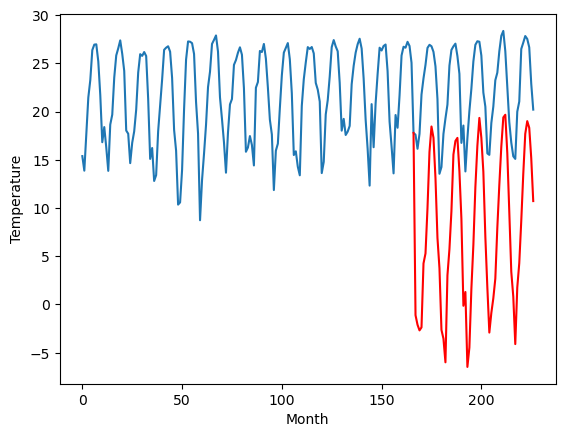

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.37		-4.49		-0.12
-4.31		-5.49		-1.18
-4.50		-6.07		-1.57
-4.24		-5.76		-1.52
3.56		0.87		-2.69
2.61		1.91		-0.70
6.49		6.60		0.11
10.58		12.43		1.85
12.15		15.07		2.92
11.32		13.90		2.58
9.22		9.73		0.51
3.88		3.51		-0.37
-0.12		0.38		0.50
-6.37		-6.02		0.35
-6.34		-6.93		-0.59
-8.26		-9.38		-1.12
1.07		-0.37		-1.44
2.14		2.35		0.21
6.61		6.29		-0.32
10.87		12.16		1.29
11.53		13.57		2.04
12.18		13.89		1.71
9.06		10.42		1.36
5.67		5.50		-0.17
-3.00		-3.52		-0.52
0.51		-2.09		-2.60
-7.77		-9.86		-2.09
-5.41		-7.85		-2.44
-0.67		-1.75		-1.08
3.54		2.81		-0.73
9.34		8.78		-0.56
12.63		13.06		0.43
12.83		15.96		3.13
11.29		13.89		2.60
9.22		10.37		1.15
3.09		3.63		0.54
-1.50		-1.61		-0.11
-3.93		-6.30		-2.37
-3.52		-4.26		-0.74
-1.58		-2.73		-1.15
0.57		-0.70		-1.27
2.32		4.56		2.24
7.18		9.00		1.82
10.77		12.98		2.21
12.55		16.01		3.46
14.63		16.29		1.66
10.88		12.31		1.43
4.77		6.22		1.45
-2.

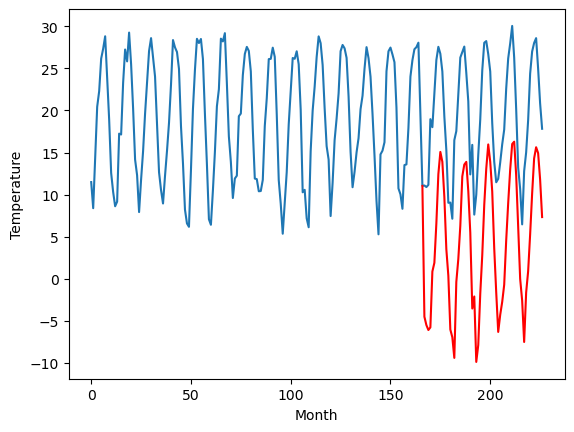

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.64		-5.13		-1.49
-5.29		-6.13		-0.84
-5.05		-6.71		-1.66
-5.38		-6.40		-1.02
2.08		0.23		-1.85
2.74		1.27		-1.47
7.87		5.96		-1.91
12.83		11.79		-1.04
14.69		14.43		-0.26
14.44		13.26		-1.18
8.66		9.09		0.43
2.93		2.87		-0.06
0.32		-0.26		-0.58
-5.96		-6.66		-0.70
-6.88		-7.57		-0.69
-10.34		-10.02		0.32
0.62		-1.01		-1.63
2.31		1.71		-0.60
6.47		5.65		-0.82
12.15		11.52		-0.63
13.74		12.93		-0.81
14.11		13.25		-0.86
11.32		9.78		-1.54
6.67		4.86		-1.81
-1.33		-4.16		-2.83
0.67		-2.73		-3.40
-7.80		-10.50		-2.70
-7.54		-8.49		-0.95
-1.36		-2.39		-1.03
4.69		2.17		-2.52
9.40		8.14		-1.26
13.95		12.42		-1.53
17.25		15.32		-1.93
14.52		13.25		-1.27
11.09		9.73		-1.36
4.22		2.99		-1.23
-2.83		-2.25		0.58
-5.52		-6.94		-1.42
-4.53		-4.90		-0.37
-4.47		-3.37		1.10
0.06		-1.34		-1.40
2.66		3.92		1.26
8.34		8.36		0.02
12.53		12.34		-0.19
15.08		15.37		0.29
17.63		15.65		-1.98
12.93		11.67		-1.26
4

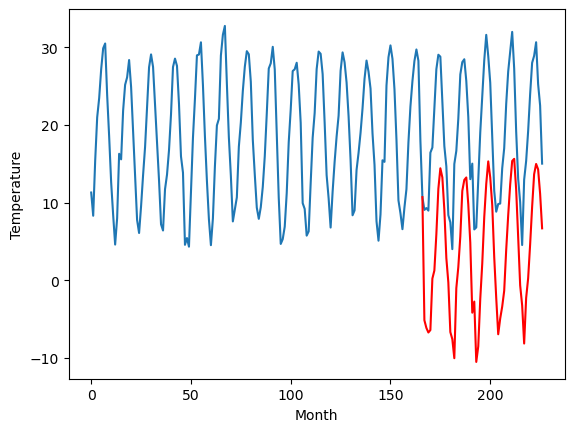

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.77		-3.86		-1.09
-4.55		-4.86		-0.31
-3.93		-5.44		-1.51
-4.31		-5.13		-0.82
3.57		1.50		-2.07
4.26		2.54		-1.72
9.91		7.23		-2.68
14.62		13.06		-1.56
17.06		15.70		-1.36
16.38		14.53		-1.85
10.08		10.36		0.28
4.33		4.14		-0.19
1.57		1.01		-0.56
-5.00		-5.39		-0.39
-5.60		-6.30		-0.70
-9.49		-8.75		0.74
1.43		0.26		-1.17
3.61		2.98		-0.63
7.14		6.92		-0.22
13.99		12.79		-1.20
15.48		14.20		-1.28
15.85		14.52		-1.33
12.42		11.05		-1.37
7.55		6.13		-1.42
-0.29		-2.89		-2.60
1.45		-1.46		-2.91
-7.45		-9.23		-1.78
-6.83		-7.22		-0.39
0.09		-1.12		-1.21
6.78		3.44		-3.34
11.61		9.41		-2.20
16.28		13.69		-2.59
19.70		16.59		-3.11
16.86		14.52		-2.34
12.77		11.00		-1.77
5.62		4.26		-1.36
-1.47		-0.98		0.49
-4.44		-5.67		-1.23
-3.67		-3.63		0.04
-3.44		-2.10		1.34
1.41		-0.07		-1.48
4.06		5.19		1.13
10.22		9.63		-0.59
15.33		13.61		-1.72
18.41		16.64		-1.77
20.28		16.92		-3.36
15.19		12.94		-2.25


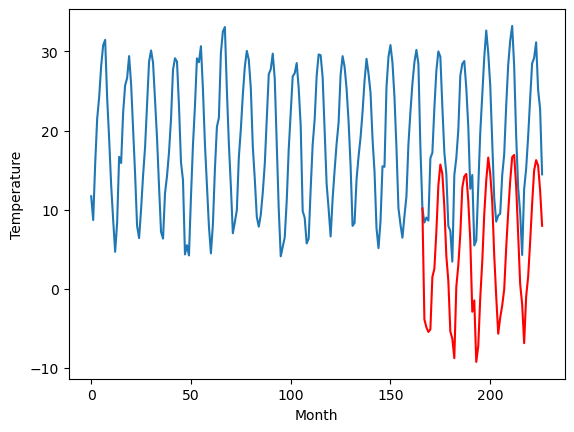

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.81		6.63		-2.18
7.17		5.63		-1.54
6.44		5.05		-1.39
5.68		5.36		-0.32
13.24		11.99		-1.25
16.21		13.03		-3.18
22.78		17.72		-5.06
26.11		23.55		-2.56
28.94		26.19		-2.75
28.32		25.02		-3.30
20.59		20.85		0.26
16.63		14.63		-2.00
12.75		11.50		-1.25
5.77		5.10		-0.67
4.67		4.19		-0.48
3.10		1.74		-1.36
12.35		10.75		-1.60
14.58		13.47		-1.11
20.07		17.41		-2.66
25.03		23.28		-1.75
24.77		24.69		-0.08
25.09		25.01		-0.08
24.40		21.54		-2.86
18.70		16.62		-2.08
11.76		7.60		-4.16
12.17		9.03		-3.14
4.80		1.26		-3.54
4.60		3.27		-1.33
11.92		9.37		-2.55
19.43		13.93		-5.50
25.12		19.90		-5.22
27.49		24.18		-3.31
29.39		27.08		-2.31
26.09		25.01		-1.08
23.19		21.49		-1.70
16.38		14.75		-1.63
8.53		9.51		0.98
6.93		4.82		-2.11
7.30		6.86		-0.44
7.47		8.39		0.92
12.54		10.42		-2.12
16.76		15.68		-1.08
21.68		20.12		-1.56
28.16		24.10		-4.06
29.62		27.13		-2.49
29.71		27.41		-2.30
26.23		23.43		-2.

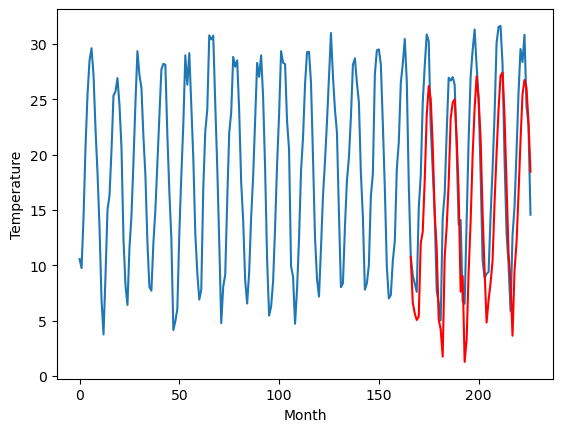

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.79		2.74		0.95
1.44		1.74		0.30
1.27		1.16		-0.11
1.74		1.47		-0.27
7.35		8.10		0.75
8.62		9.14		0.52
11.41		13.83		2.42
16.00		19.66		3.66
19.04		22.30		3.26
17.84		21.13		3.29
14.04		16.96		2.92
10.22		10.74		0.52
5.91		7.61		1.70
-1.34		1.21		2.55
-1.11		0.30		1.41
-0.44		-2.15		-1.71
5.96		6.86		0.90
8.69		9.58		0.89
12.14		13.52		1.38
16.16		19.39		3.23
17.90		20.80		2.90
18.03		21.12		3.09
14.06		17.65		3.59
10.26		12.73		2.47
2.10		3.71		1.61
4.01		5.14		1.13
-2.05		-2.63		-0.58
2.23		-0.62		-2.85
5.79		5.48		-0.31
8.45		10.04		1.59
14.43		16.01		1.58
17.64		20.29		2.65
18.91		23.19		4.28
17.39		21.12		3.73
14.30		17.60		3.30
7.43		10.86		3.43
4.73		5.62		0.89
-1.22		0.93		2.15
1.80		2.97		1.17
5.22		4.50		-0.72
5.70		6.53		0.83
8.81		11.79		2.98
11.43		16.23		4.80
15.07		20.21		5.14
18.94		23.24		4.30
18.38		23.52		5.14
14.54		19.54		5.00
9.10		13.45		4.35
3.37		7.23		3.86
1.16		4.6

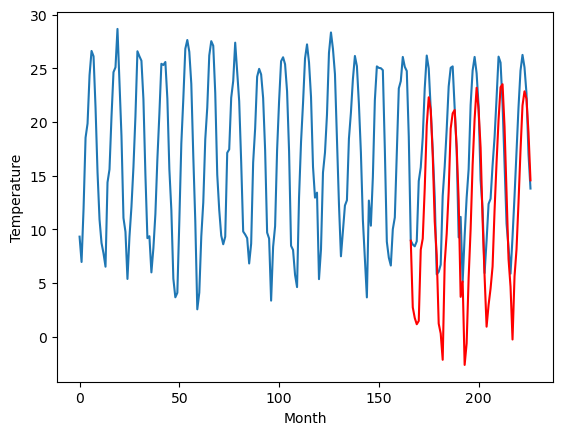

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.00		2.56		-1.44
3.19		1.56		-1.63
1.54		0.98		-0.56
2.11		1.29		-0.82
9.04		7.92		-1.12
10.62		8.96		-1.66
14.72		13.65		-1.07
21.07		19.48		-1.59
23.61		22.12		-1.49
21.62		20.95		-0.67
18.04		16.78		-1.26
11.11		10.56		-0.55
8.56		7.43		-1.13
2.03		1.03		-1.00
0.36		0.12		-0.24
-3.25		-2.33		0.92
9.02		6.68		-2.34
10.92		9.40		-1.52
14.96		13.34		-1.62
21.26		19.21		-2.05
22.55		20.62		-1.93
23.07		20.94		-2.13
20.03		17.47		-2.56
14.26		12.55		-1.71
6.32		3.53		-2.79
7.78		4.96		-2.82
-1.29		-2.81		-1.52
0.77		-0.80		-1.57
7.43		5.30		-2.13
11.29		9.86		-1.43
16.96		15.83		-1.13
22.28		20.11		-2.17
25.98		23.01		-2.97
22.46		20.94		-1.52
18.87		17.42		-1.45
12.50		10.68		-1.82
5.95		5.44		-0.51
1.10		0.75		-0.35
2.75		2.79		0.04
4.89		4.32		-0.57
6.61		6.35		-0.26
12.23		11.61		-0.62
17.01		16.05		-0.96
21.09		20.03		-1.06
23.05		23.06		0.01
22.86		23.34		0.48
18.92		19.36		0.44
13.02		1

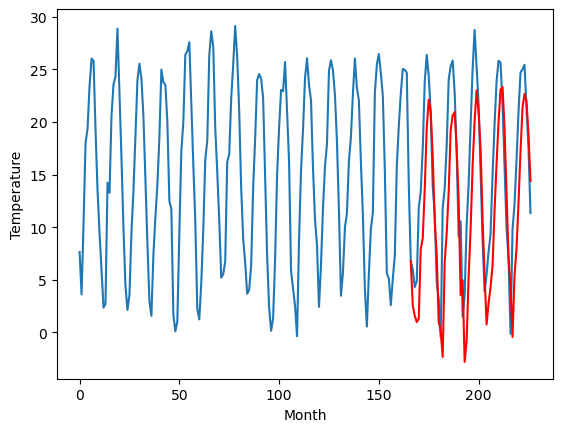

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.41		2.94		1.53
0.59		1.94		1.35
-0.34		1.36		1.70
-1.17		1.67		2.84
5.65		8.30		2.65
8.64		9.34		0.70
14.22		14.03		-0.19
21.51		19.86		-1.65
23.55		22.50		-1.05
21.35		21.33		-0.02
17.59		17.16		-0.43
10.75		10.94		0.19
6.91		7.81		0.90
-0.60		1.41		2.01
-2.18		0.50		2.68
-5.54		-1.95		3.59
6.43		7.06		0.63
10.08		9.78		-0.30
14.49		13.72		-0.77
21.73		19.59		-2.14
22.30		21.00		-1.30
23.16		21.32		-1.84
19.67		17.85		-1.82
14.32		12.93		-1.39
3.46		3.91		0.45
3.78		5.34		1.56
-5.06		-2.43		2.63
-2.04		-0.42		1.62
5.43		5.68		0.25
9.21		10.24		1.03
17.71		16.21		-1.50
22.19		20.49		-1.70
24.13		23.39		-0.74
21.90		21.32		-0.58
17.99		17.80		-0.19
10.50		11.06		0.56
4.71		5.82		1.11
-1.07		1.13		2.20
0.89		3.17		2.28
2.48		4.70		2.22
3.75		6.73		2.98
10.25		11.99		1.74
15.96		16.43		0.47
19.84		20.41		0.57
22.57		23.44		0.87
21.41		23.72		2.31
18.32		19.74		1.42
12.18		13.65		1.47
5.11		7.4

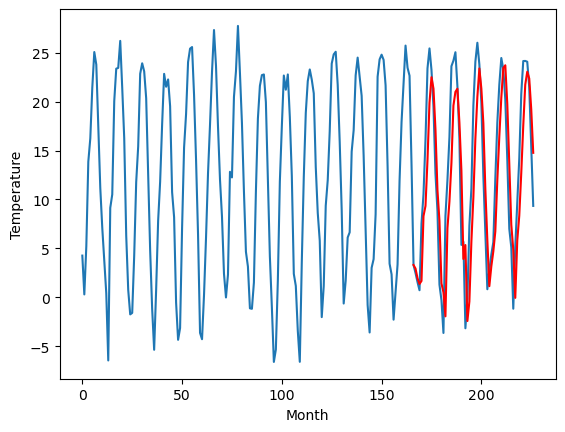

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.42		1.81		0.39
1.10		0.81		-0.29
-1.34		0.23		1.57
-1.59		0.54		2.13
6.01		7.17		1.16
9.12		8.21		-0.91
15.00		12.90		-2.10
22.73		18.73		-4.00
23.94		21.37		-2.57
21.34		20.20		-1.14
17.44		16.03		-1.41
10.10		9.81		-0.29
7.46		6.68		-0.78
-0.42		0.28		0.70
-2.45		-0.63		1.82
-6.89		-3.08		3.81
6.97		5.93		-1.04
10.68		8.65		-2.03
15.46		12.59		-2.87
22.85		18.46		-4.39
22.56		19.87		-2.69
22.84		20.19		-2.65
19.73		16.72		-3.01
14.27		11.80		-2.47
3.96		2.78		-1.18
3.71		4.21		0.50
-5.77		-3.56		2.21
-2.94		-1.55		1.39
5.27		4.55		-0.72
9.39		9.11		-0.28
17.92		15.08		-2.84
22.53		19.36		-3.17
23.35		22.26		-1.09
22.05		20.19		-1.86
17.91		16.67		-1.24
10.44		9.93		-0.51
4.90		4.69		-0.21
-1.83		0.00		1.83
0.41		2.04		1.63
1.60		3.57		1.97
4.14		5.60		1.46
11.47		10.86		-0.61
17.23		15.30		-1.93
21.54		19.28		-2.26
23.07		22.31		-0.76
21.81		22.59		0.78
18.77		18.61		-0.16
12.36		12.52		

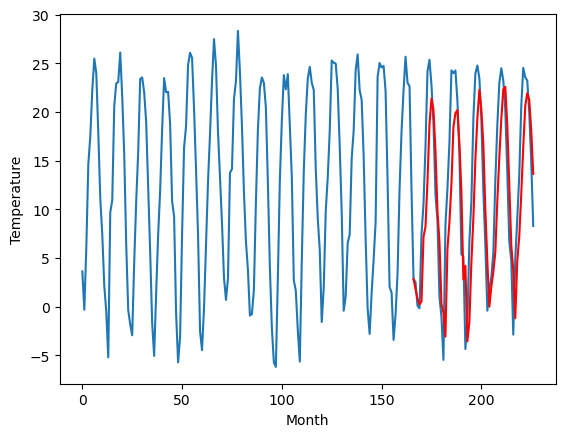

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.09		0.57		1.66
-1.87		-0.43		1.44
-3.07		-1.01		2.06
-3.88		-0.70		3.18
2.28		5.93		3.65
3.66		6.97		3.31
10.40		11.66		1.26
16.89		17.49		0.60
20.33		20.13		-0.20
17.92		18.96		1.04
13.93		14.79		0.86
7.77		8.57		0.80
4.54		5.44		0.90
-3.02		-0.96		2.06
-4.94		-1.87		3.07
-7.18		-4.32		2.86
2.71		4.69		1.98
6.51		7.41		0.90
11.04		11.35		0.31
17.93		17.22		-0.71
18.09		18.63		0.54
19.29		18.95		-0.34
15.00		15.48		0.48
11.47		10.56		-0.91
1.07		1.54		0.47
0.21		2.97		2.76
-8.62		-4.80		3.82
-5.06		-2.79		2.27
0.91		3.31		2.40
4.91		7.87		2.96
13.49		13.84		0.35
16.76		18.12		1.36
19.36		21.02		1.66
18.29		18.95		0.66
14.24		15.43		1.19
7.38		8.69		1.31
3.30		3.45		0.15
-3.41		-1.24		2.17
-1.78		0.80		2.58
-1.64		2.33		3.97
-0.76		4.36		5.12
7.71		9.62		1.91
11.40		14.06		2.66
15.71		18.04		2.33
18.80		21.07		2.27
17.47		21.35		3.88
15.13		17.37		2.24
9.87		11.28		1.41
2.48		5.06		2.58
1.

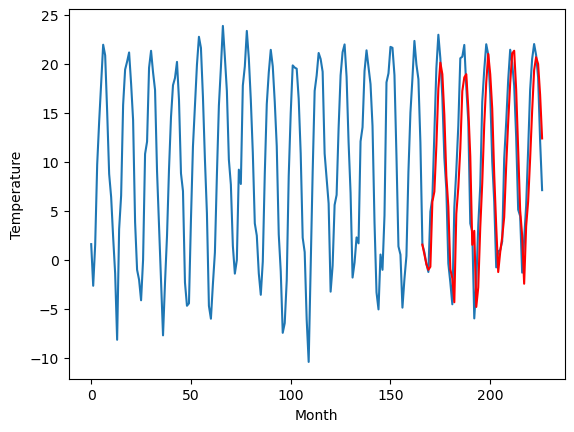

RangeIndex(start=1, stop=12, step=1)
[2.839999999999999, 0.3700000000000001, -4.370000000000001, -3.639999999999999, -2.7700000000000005, 8.81, 1.7899999999999991, 4.0, 1.4099999999999984, 1.42, -1.0899999999999999]
[0.5650666427612308, -1.1149333572387699, -4.49493335723877, -5.134933357238769, -3.86493335723877, 6.625066642761231, 2.7350666427612307, 2.555066642761231, 2.93506664276123, 1.805066642761231, 0.5650666427612308]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.84   0.565067
1                 1    0.37  -1.114933
2                 2   -4.37  -4.494933
3                 3   -3.64  -5.134933
4                 4   -2.77  -3.864933
5                 5    8.81   6.625067
6                 6    1.79   2.735067
7                 7    4.00   2.555067
8                 8    1.41   2.935067
9                 9    1.42   1.805067
10               10   -1.09   0.565067


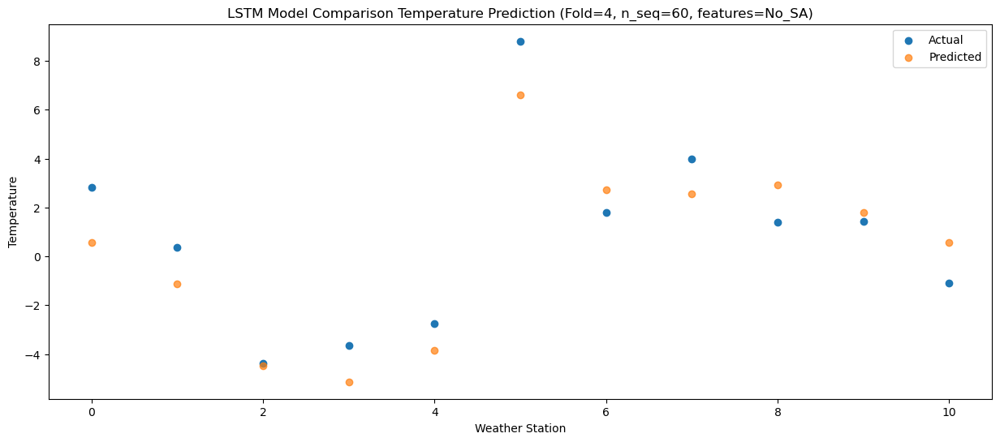

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -0.426518
1                 1    0.19  -2.106518
2                 2   -4.31  -5.486517
3                 3   -5.29  -6.126518
4                 4   -4.55  -4.856518
5                 5    7.17   5.633483
6                 6    1.44   1.743483
7                 7    3.19   1.563483
8                 8    0.59   1.943482
9                 9    1.10   0.813482
10               10   -1.87  -0.426518


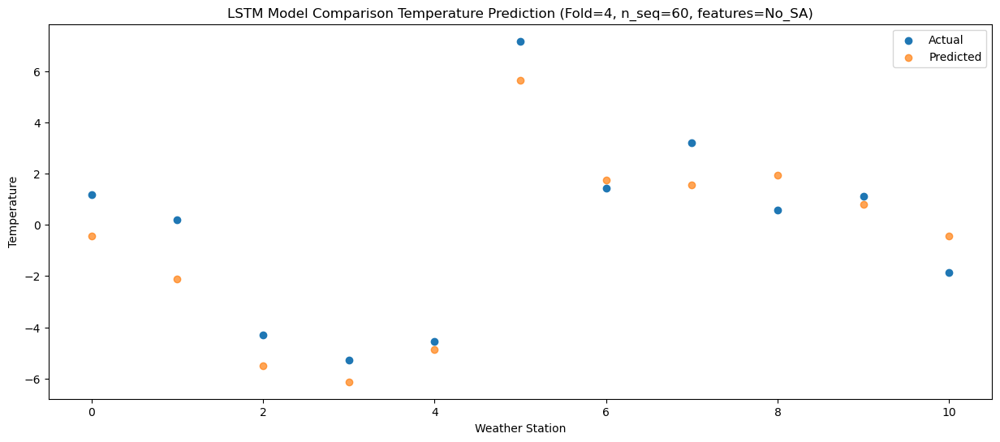

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -1.010847
1                 1   -1.27  -2.690848
2                 2   -4.50  -6.070847
3                 3   -5.05  -6.710848
4                 4   -3.93  -5.440848
5                 5    6.44   5.049153
6                 6    1.27   1.159153
7                 7    1.54   0.979153
8                 8   -0.34   1.359152
9                 9   -1.34   0.229152
10               10   -3.07  -1.010848


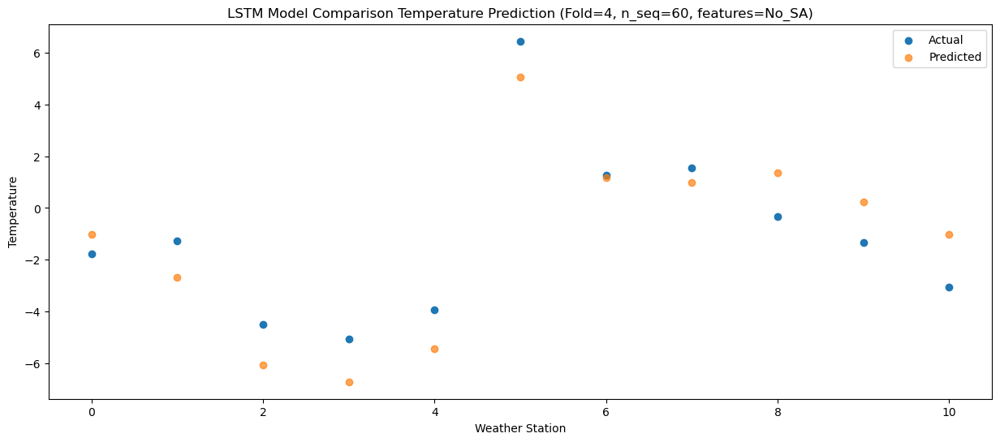

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.67  -0.699350
1                 1    0.28  -2.379351
2                 2   -4.24  -5.759350
3                 3   -5.38  -6.399351
4                 4   -4.31  -5.129351
5                 5    5.68   5.360650
6                 6    1.74   1.470650
7                 7    2.11   1.290650
8                 8   -1.17   1.670649
9                 9   -1.59   0.540649
10               10   -3.88  -0.699351


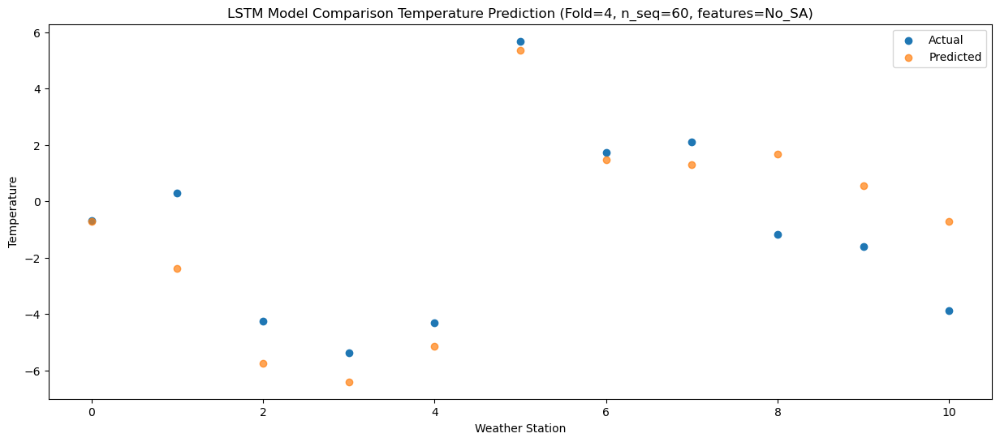

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.86   5.928961
1                 1    4.35   4.248960
2                 2    3.56   0.868961
3                 3    2.08   0.228960
4                 4    3.57   1.498960
5                 5   13.24  11.988961
6                 6    7.35   8.098961
7                 7    9.04   7.918961
8                 8    5.65   8.298960
9                 9    6.01   7.168960
10               10    2.28   5.928960


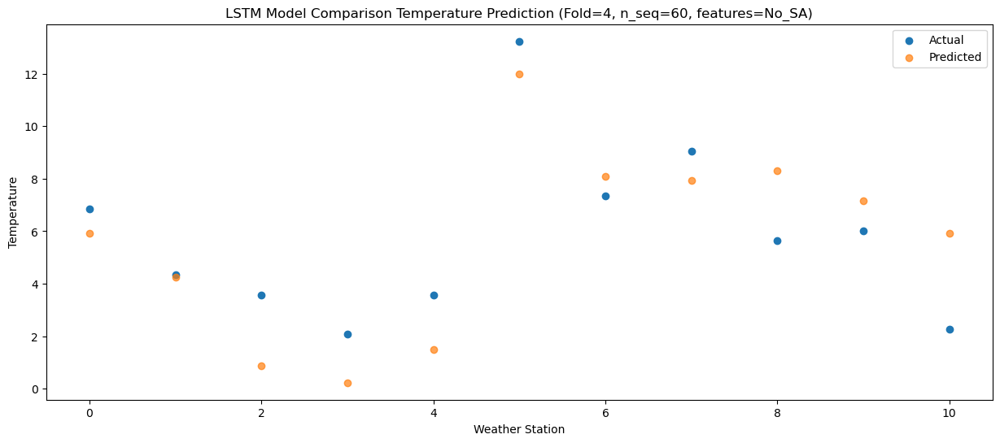

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    9.29   6.966981
1                 1    6.03   5.286980
2                 2    2.61   1.906981
3                 3    2.74   1.266980
4                 4    4.26   2.536980
5                 5   16.21  13.026981
6                 6    8.62   9.136981
7                 7   10.62   8.956981
8                 8    8.64   9.336980
9                 9    9.12   8.206980
10               10    3.66   6.966980


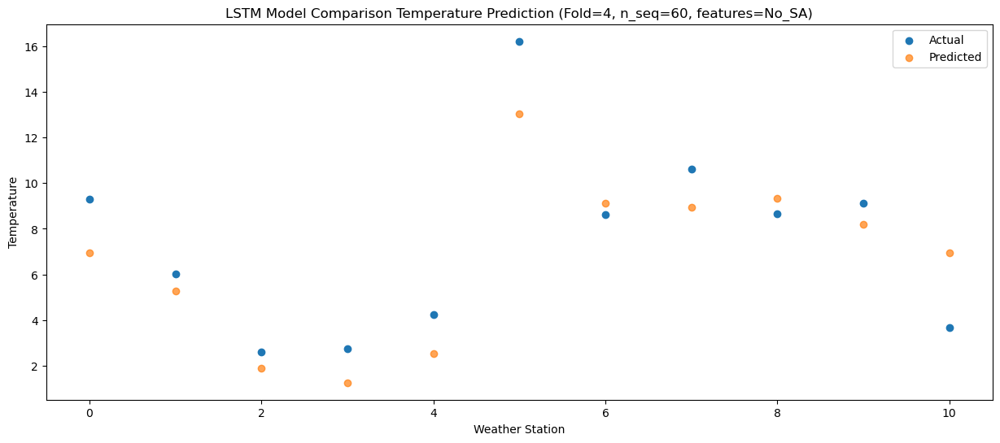

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   14.36  11.658879
1                 1    7.43   9.978878
2                 2    6.49   6.598877
3                 3    7.87   5.958878
4                 4    9.91   7.228878
5                 5   22.78  17.718879
6                 6   11.41  13.828877
7                 7   14.72  13.648879
8                 8   14.22  14.028878
9                 9   15.00  12.898878
10               10   10.40  11.658878


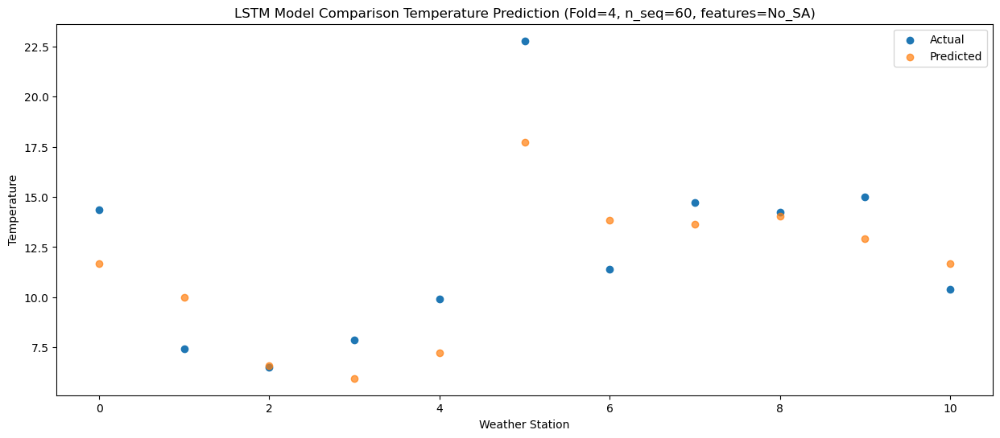

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   23.61  17.493971
1                 1    9.19  15.813970
2                 2   10.58  12.433969
3                 3   12.83  11.793970
4                 4   14.62  13.063970
5                 5   26.11  23.553971
6                 6   16.00  19.663969
7                 7   21.07  19.483971
8                 8   21.51  19.863970
9                 9   22.73  18.733970
10               10   16.89  17.493970


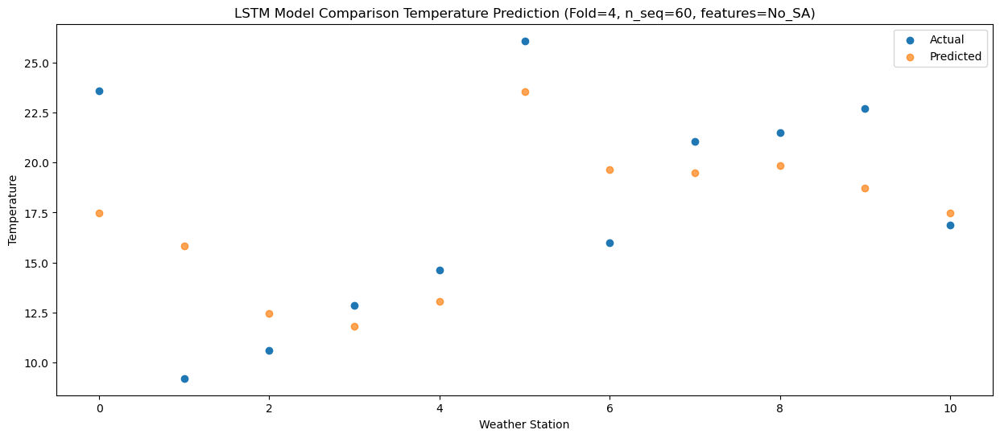

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   24.42  20.129719
1                 1    9.51  18.449722
2                 2   12.15  15.069721
3                 3   14.69  14.429720
4                 4   17.06  15.699720
5                 5   28.94  26.189723
6                 6   19.04  22.299721
7                 7   23.61  22.119721
8                 8   23.55  22.499720
9                 9   23.94  21.369720
10               10   20.33  20.129722


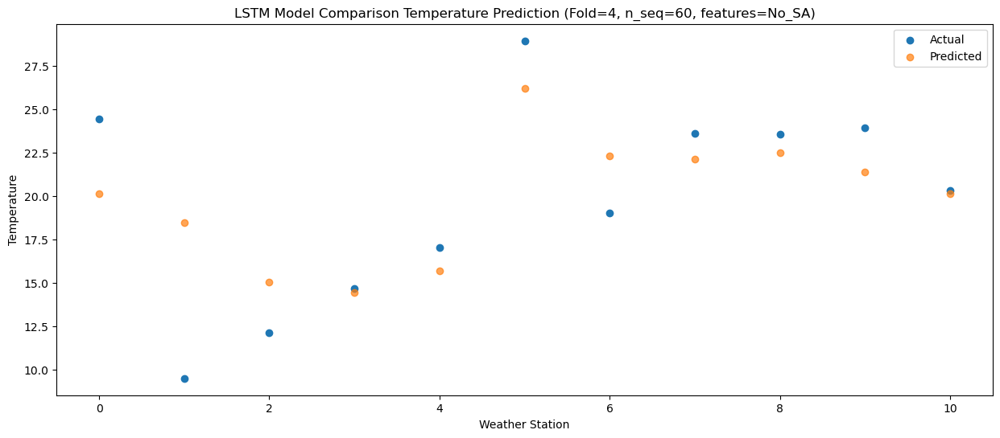

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   22.32  18.957626
1                 1    9.36  17.277627
2                 2   11.32  13.897628
3                 3   14.44  13.257627
4                 4   16.38  14.527627
5                 5   28.32  25.017630
6                 6   17.84  21.127628
7                 7   21.62  20.947628
8                 8   21.35  21.327627
9                 9   21.34  20.197627
10               10   17.92  18.957628


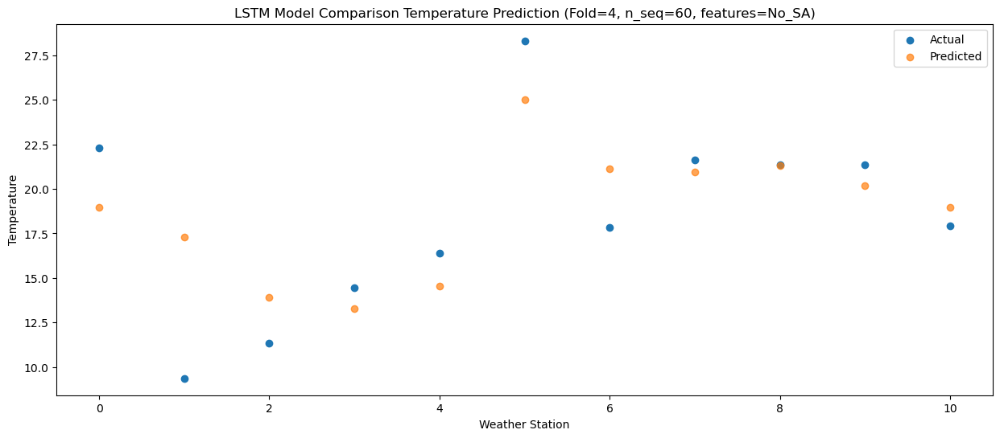

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   17.48  14.794654
1                 1    8.78  13.114657
2                 2    9.22   9.734658
3                 3    8.66   9.094656
4                 4   10.08  10.364656
5                 5   20.59  20.854659
6                 6   14.04  16.964658
7                 7   18.04  16.784657
8                 8   17.59  17.164656
9                 9   17.44  16.034656
10               10   13.93  14.794658


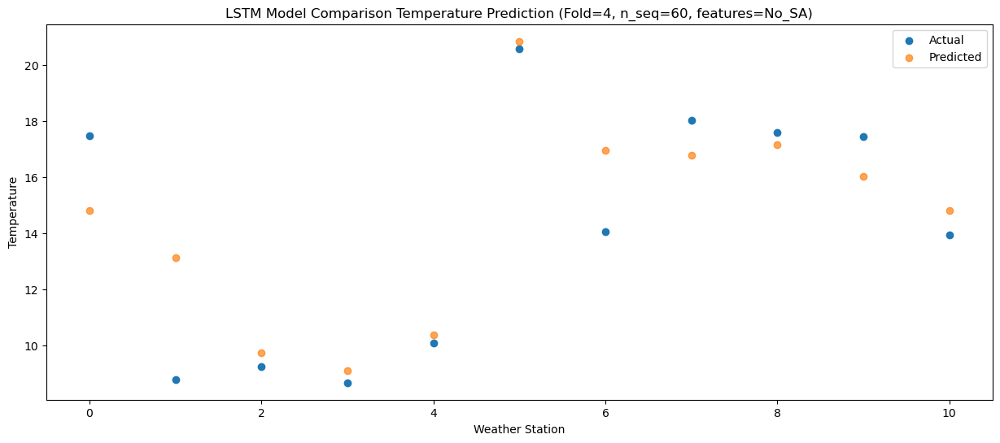

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    9.43   8.574368
1                 1    7.28   6.894370
2                 2    3.88   3.514371
3                 3    2.93   2.874370
4                 4    4.33   4.144370
5                 5   16.63  14.634372
6                 6   10.22  10.744371
7                 7   11.11  10.564370
8                 8   10.75  10.944370
9                 9   10.10   9.814370
10               10    7.77   8.574371


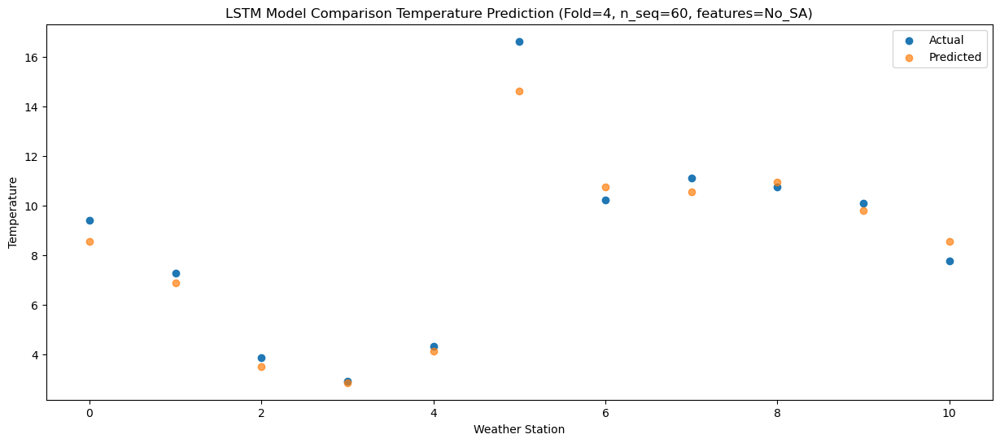

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    7.24   5.436259
1                 1    3.89   3.756262
2                 2   -0.12   0.376263
3                 3    0.32  -0.263739
4                 4    1.57   1.006261
5                 5   12.75  11.496264
6                 6    5.91   7.606263
7                 7    8.56   7.426262
8                 8    6.91   7.806261
9                 9    7.46   6.676261
10               10    4.54   5.436263


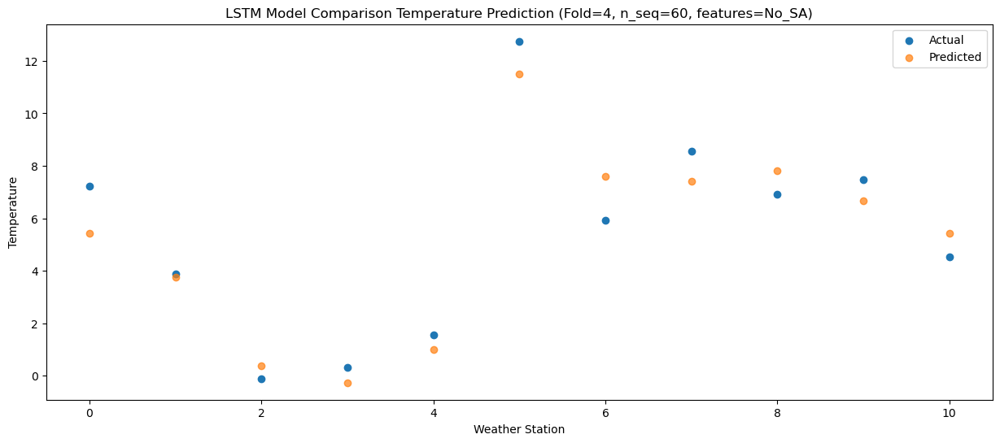

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -0.955275
1                 1   -3.86  -2.635273
2                 2   -6.37  -6.015272
3                 3   -5.96  -6.655273
4                 4   -5.00  -5.385273
5                 5    5.77   5.104729
6                 6   -1.34   1.214728
7                 7    2.03   1.034729
8                 8   -0.60   1.414726
9                 9   -0.42   0.284726
10               10   -3.02  -0.955271


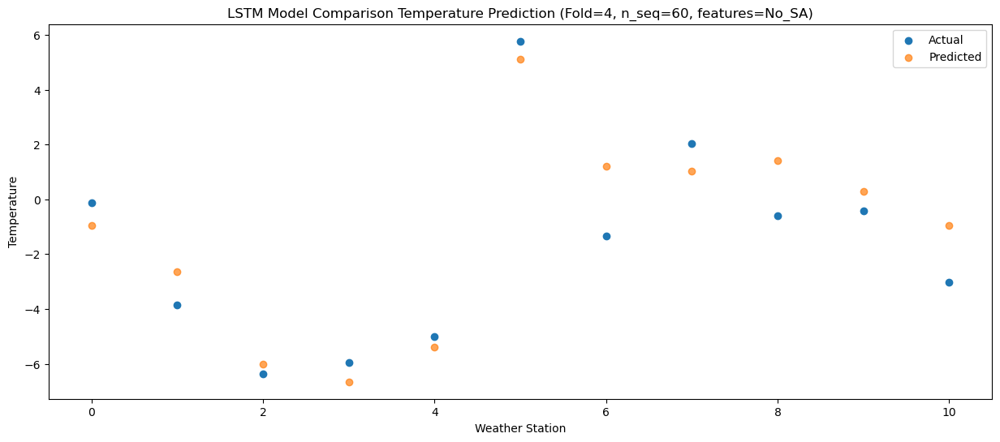

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -1.868115
1                 1   -3.16  -3.548115
2                 2   -6.34  -6.928113
3                 3   -6.88  -7.568115
4                 4   -5.60  -6.298115
5                 5    4.67   4.191888
6                 6   -1.11   0.301887
7                 7    0.36   0.121888
8                 8   -2.18   0.501886
9                 9   -2.45  -0.628114
10               10   -4.94  -1.868113


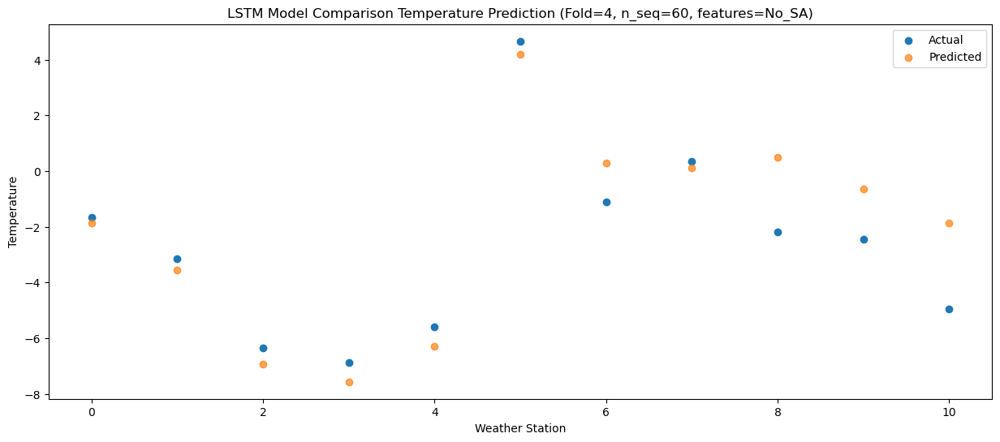

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -7.78  -4.321029
1                 1    0.27  -6.001028
2                 2   -8.26  -9.381026
3                 3  -10.34 -10.021028
4                 4   -9.49  -8.751028
5                 5    3.10   1.738975
6                 6   -0.44  -2.151026
7                 7   -3.25  -2.331025
8                 8   -5.54  -1.951028
9                 9   -6.89  -3.081028
10               10   -7.18  -4.321026


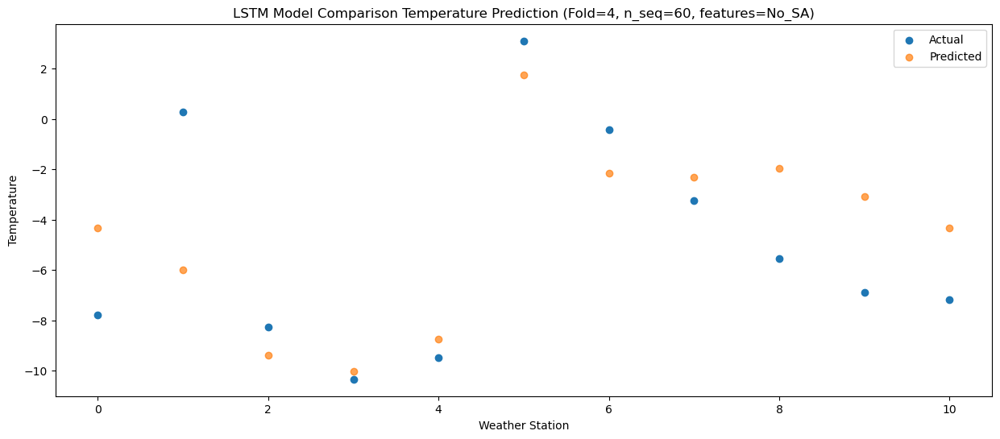

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    6.95   4.694495
1                 1    1.87   3.014496
2                 2    1.07  -0.365502
3                 3    0.62  -1.005502
4                 4    1.43   0.264498
5                 5   12.35  10.754499
6                 6    5.96   6.864498
7                 7    9.02   6.684499
8                 8    6.43   7.064496
9                 9    6.97   5.934496
10               10    2.71   4.694498


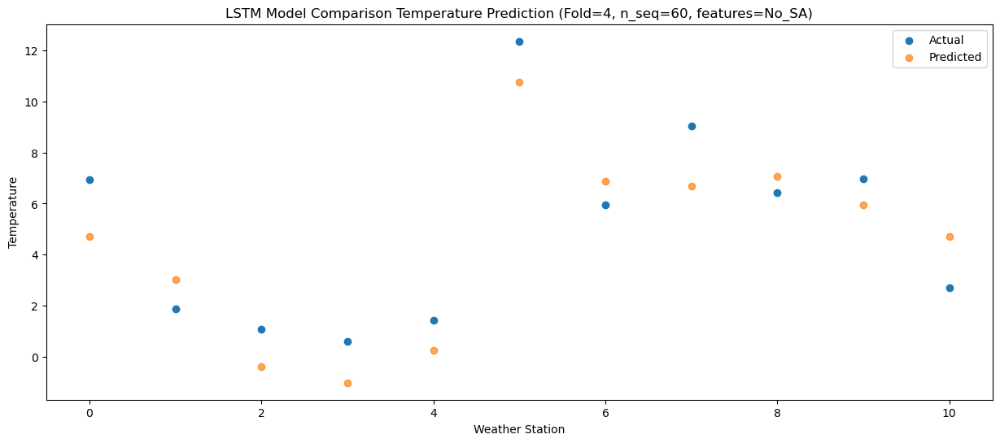

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    9.86   7.412998
1                 1    3.31   5.732999
2                 2    2.14   2.353001
3                 3    2.31   1.713001
4                 4    3.61   2.983001
5                 5   14.58  13.473002
6                 6    8.69   9.583001
7                 7   10.92   9.403002
8                 8   10.08   9.782999
9                 9   10.68   8.652999
10               10    6.51   7.413001


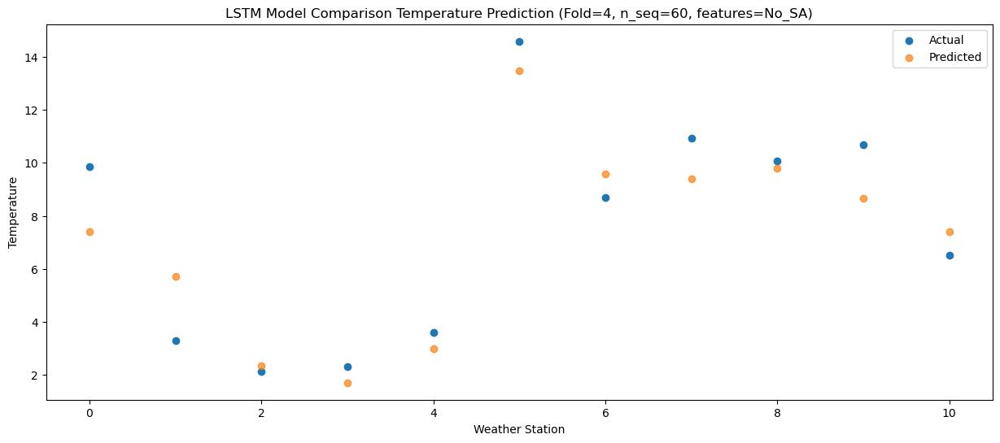

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   14.07  11.354141
1                 1    7.35   9.674142
2                 2    6.61   6.294144
3                 3    6.47   5.654144
4                 4    7.14   6.924144
5                 5   20.07  17.414145
6                 6   12.14  13.524144
7                 7   14.96  13.344145
8                 8   14.49  13.724142
9                 9   15.46  12.594142
10               10   11.04  11.354144


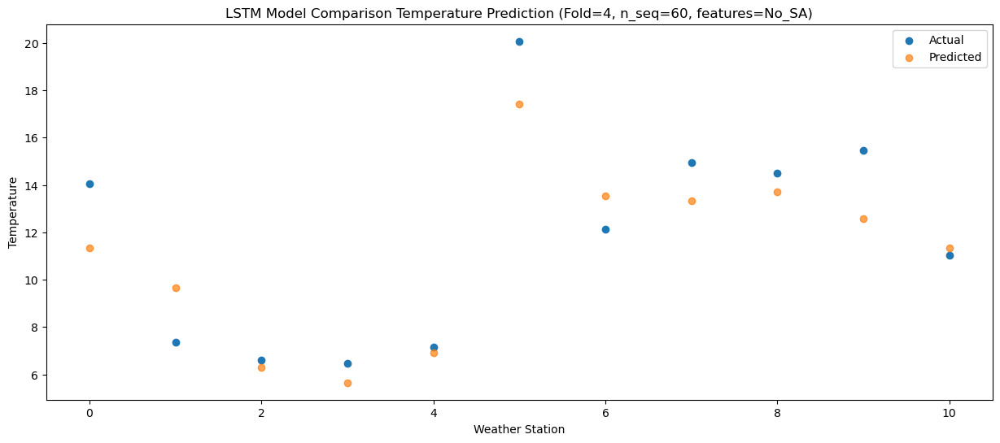

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   21.98  17.223120
1                 1    8.98  15.543123
2                 2   10.87  12.163125
3                 3   12.15  11.523123
4                 4   13.99  12.793123
5                 5   25.03  23.283126
6                 6   16.16  19.393125
7                 7   21.26  19.213124
8                 8   21.73  19.593123
9                 9   22.85  18.463121
10               10   17.93  17.223125


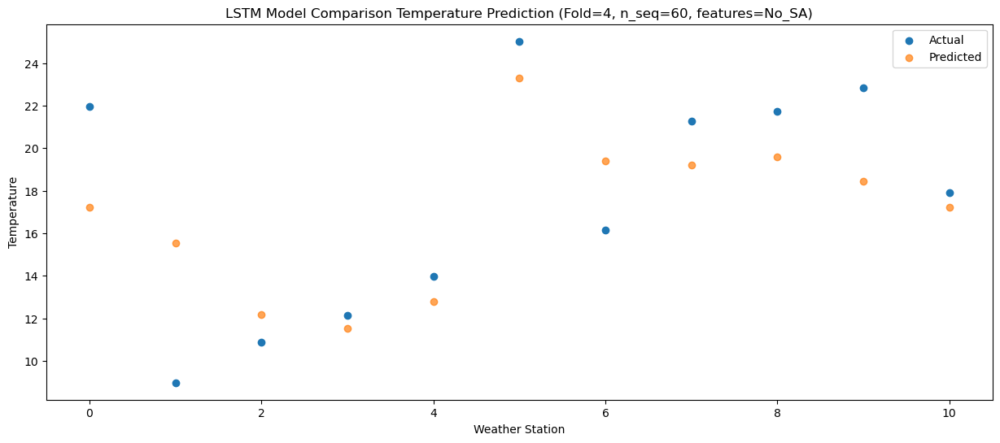

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   22.78  18.630972
1                 1    9.35  16.950977
2                 2   11.53  13.570977
3                 3   13.74  12.930975
4                 4   15.48  14.200975
5                 5   24.77  24.690978
6                 6   17.90  20.800977
7                 7   22.55  20.620976
8                 8   22.30  21.000975
9                 9   22.56  19.870973
10               10   18.09  18.630977


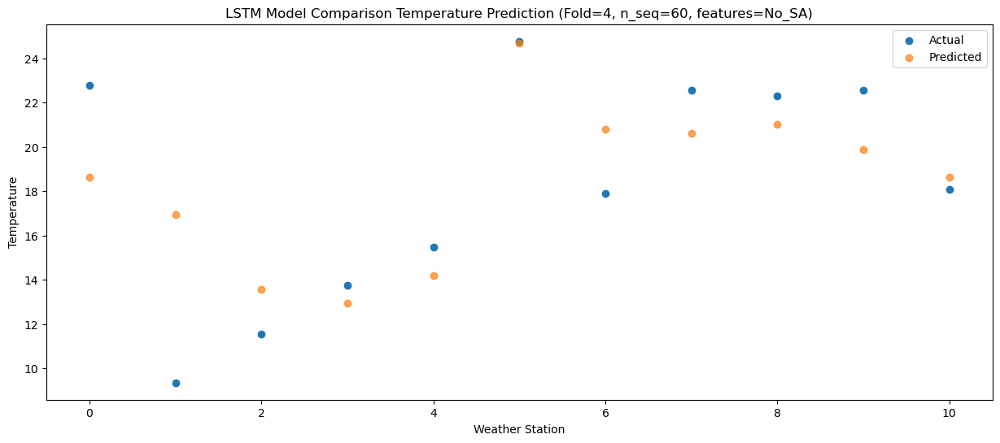

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   23.18  18.949541
1                 1    9.63  17.269544
2                 2   12.18  13.889544
3                 3   14.11  13.249544
4                 4   15.85  14.519544
5                 5   25.09  25.009545
6                 6   18.03  21.119544
7                 7   23.07  20.939545
8                 8   23.16  21.319542
9                 9   22.84  20.189542
10               10   19.29  18.949544


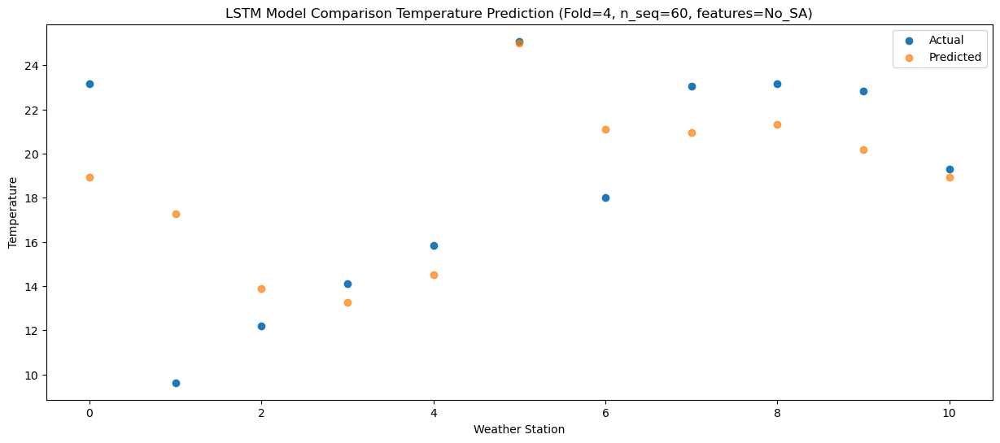

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.99  15.479429
1                 1    8.34  13.799431
2                 2    9.06  10.419431
3                 3   11.32   9.779431
4                 4   12.42  11.049431
5                 5   24.40  21.539432
6                 6   14.06  17.649431
7                 7   20.03  17.469432
8                 8   19.67  17.849429
9                 9   19.73  16.719430
10               10   15.00  15.479430


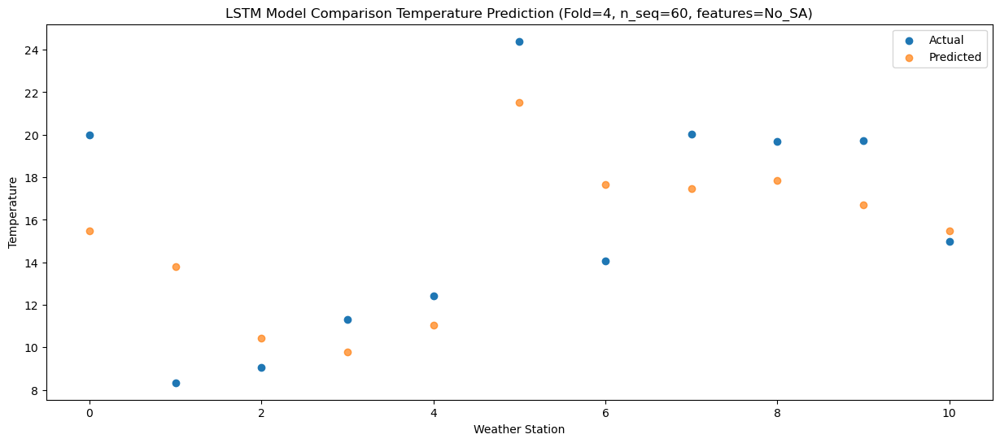

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   12.86  10.560396
1                 1    6.50   8.880398
2                 2    5.67   5.500399
3                 3    6.67   4.860399
4                 4    7.55   6.130399
5                 5   18.70  16.620400
6                 6   10.26  12.730399
7                 7   14.26  12.550400
8                 8   14.32  12.930397
9                 9   14.27  11.800397
10               10   11.47  10.560398


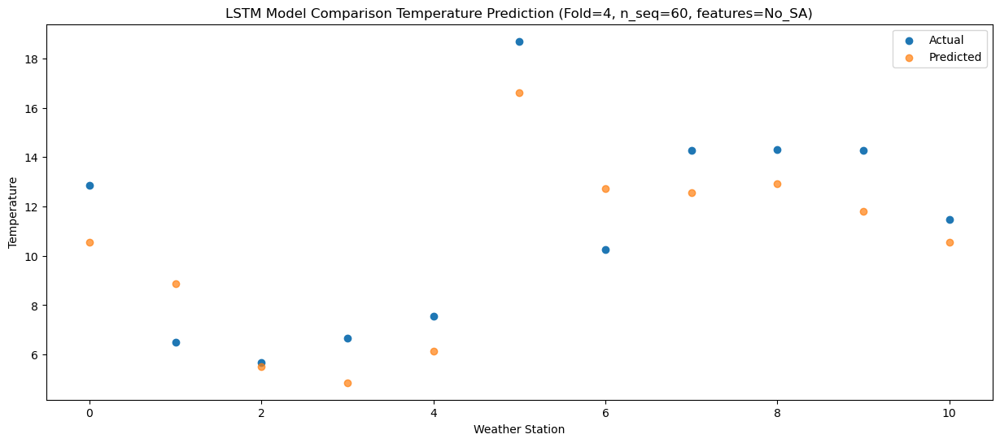

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    5.80   1.541810
1                 1   -0.66  -0.138188
2                 2   -3.00  -3.518187
3                 3   -1.33  -4.158187
4                 4   -0.29  -2.888187
5                 5   11.76   7.601814
6                 6    2.10   3.711813
7                 7    6.32   3.531814
8                 8    3.46   3.911811
9                 9    3.96   2.781811
10               10    1.07   1.541812


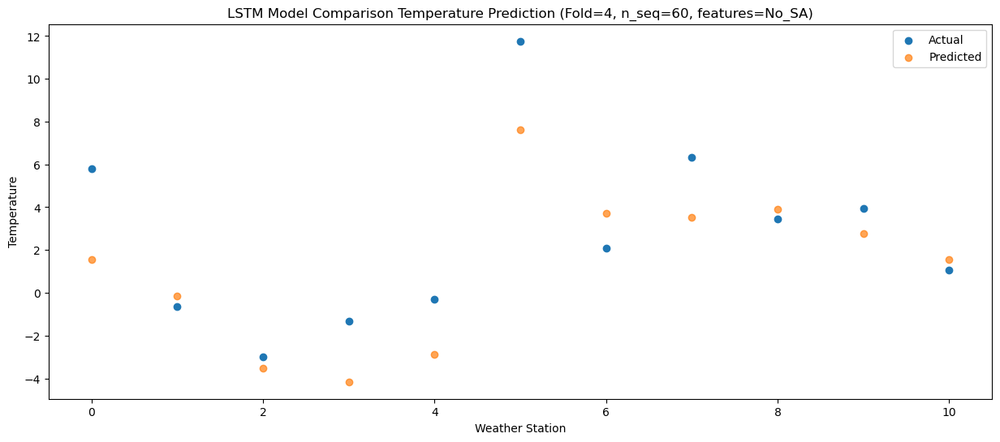

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.01   2.969657
1                 1    1.14   1.289659
2                 2    0.51  -2.090341
3                 3    0.67  -2.730341
4                 4    1.45  -1.460341
5                 5   12.17   9.029660
6                 6    4.01   5.139659
7                 7    7.78   4.959660
8                 8    3.78   5.339658
9                 9    3.71   4.209658
10               10    0.21   2.969658


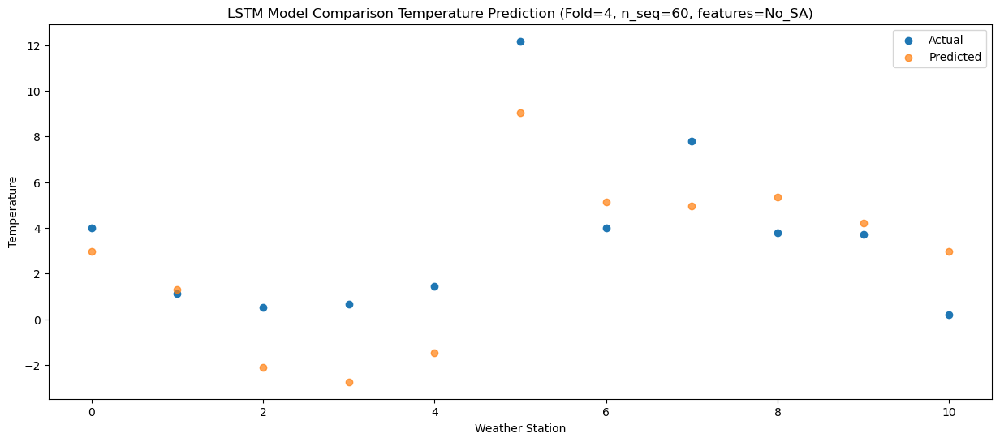

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.37  -4.799596
1                 1   -3.62  -6.479595
2                 2   -7.77  -9.859593
3                 3   -7.80 -10.499593
4                 4   -7.45  -9.229593
5                 5    4.80   1.260408
6                 6   -2.05  -2.629593
7                 7   -1.29  -2.809591
8                 8   -5.06  -2.429595
9                 9   -5.77  -3.559596
10               10   -8.62  -4.799594


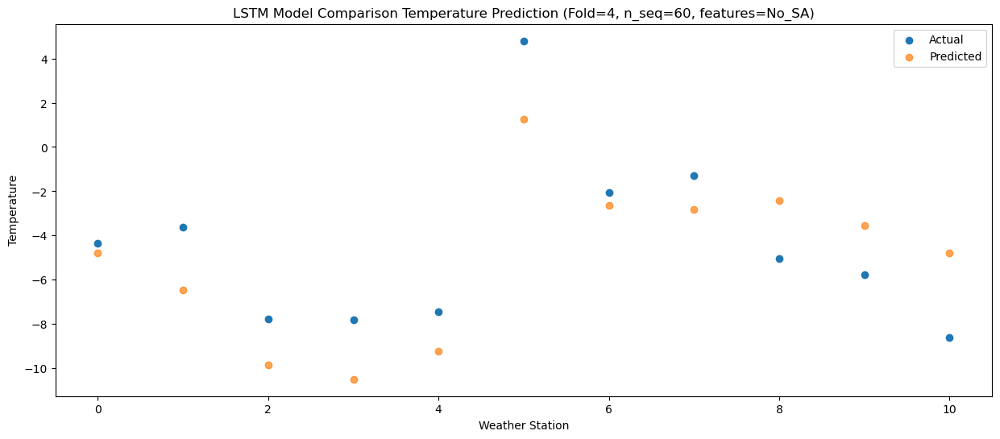

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.30  -2.792985
1                 1   -0.19  -4.472986
2                 2   -5.41  -7.852984
3                 3   -7.54  -8.492984
4                 4   -6.83  -7.222984
5                 5    4.60   3.267017
6                 6    2.23  -0.622984
7                 7    0.77  -0.802982
8                 8   -2.04  -0.422984
9                 9   -2.94  -1.552987
10               10   -5.06  -2.792985


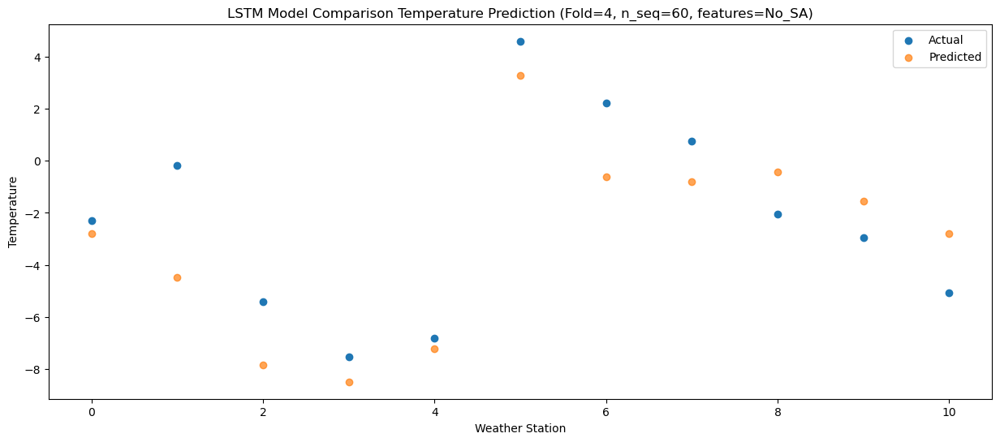

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    4.41   3.305835
1                 1    2.63   1.625834
2                 2   -0.67  -1.754164
3                 3   -1.36  -2.394164
4                 4    0.09  -1.124164
5                 5   11.92   9.365837
6                 6    5.79   5.475836
7                 7    7.43   5.295838
8                 8    5.43   5.675838
9                 9    5.27   4.545833
10               10    0.91   3.305835


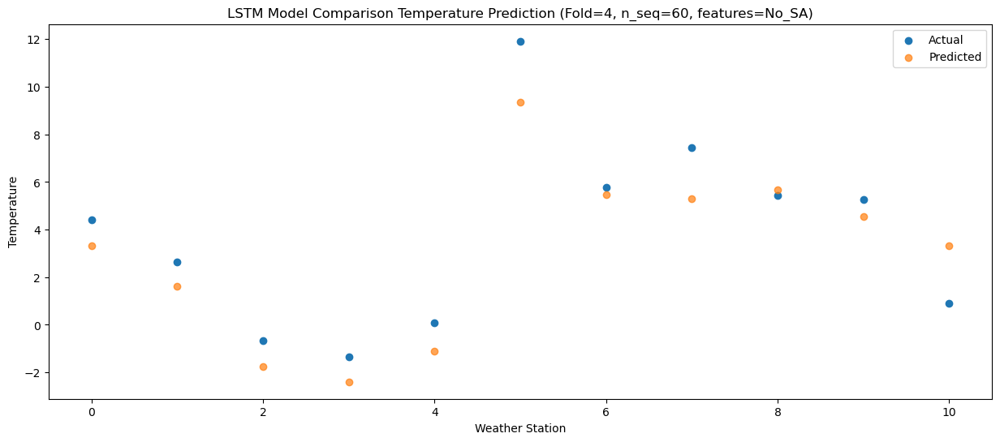

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    9.29   7.866516
1                 1    4.97   6.186513
2                 2    3.54   2.806517
3                 3    4.69   2.166517
4                 4    6.78   3.436517
5                 5   19.43  13.926518
6                 6    8.45  10.036517
7                 7   11.29   9.856519
8                 8    9.21  10.236519
9                 9    9.39   9.106514
10               10    4.91   7.866516


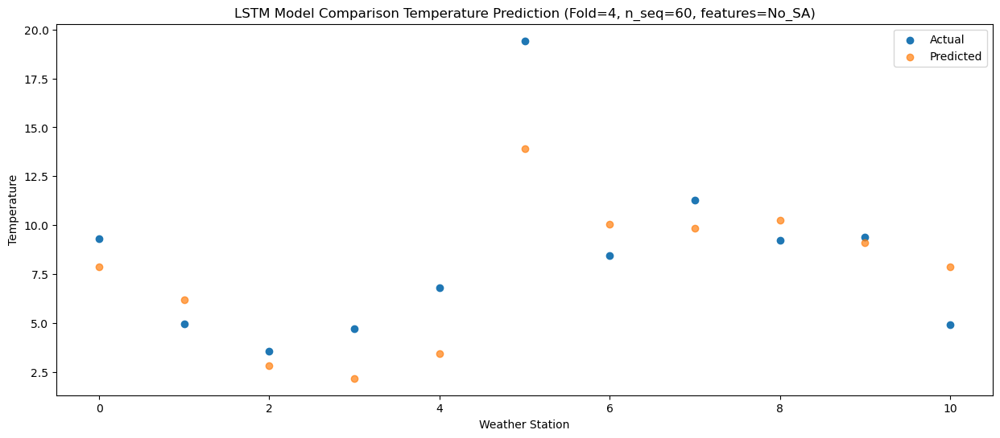

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   16.23  13.842260
1                 1    7.79  12.162257
2                 2    9.34   8.782260
3                 3    9.40   8.142260
4                 4   11.61   9.412260
5                 5   25.12  19.902261
6                 6   14.43  16.012260
7                 7   16.96  15.832262
8                 8   17.71  16.212263
9                 9   17.92  15.082258
10               10   13.49  13.842259


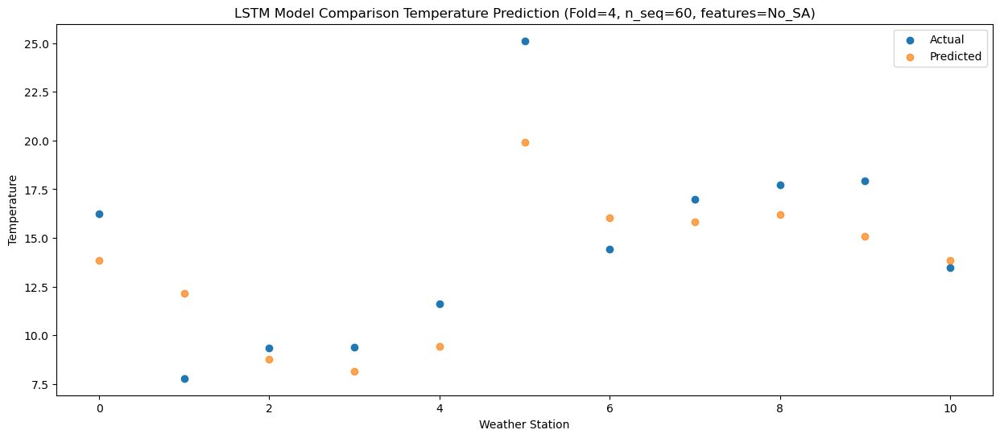

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   22.14  18.116295
1                 1    9.51  16.436294
2                 2   12.63  13.056297
3                 3   13.95  12.416297
4                 4   16.28  13.686297
5                 5   27.49  24.176298
6                 6   17.64  20.286297
7                 7   22.28  20.106299
8                 8   22.19  20.486300
9                 9   22.53  19.356295
10               10   16.76  18.116296


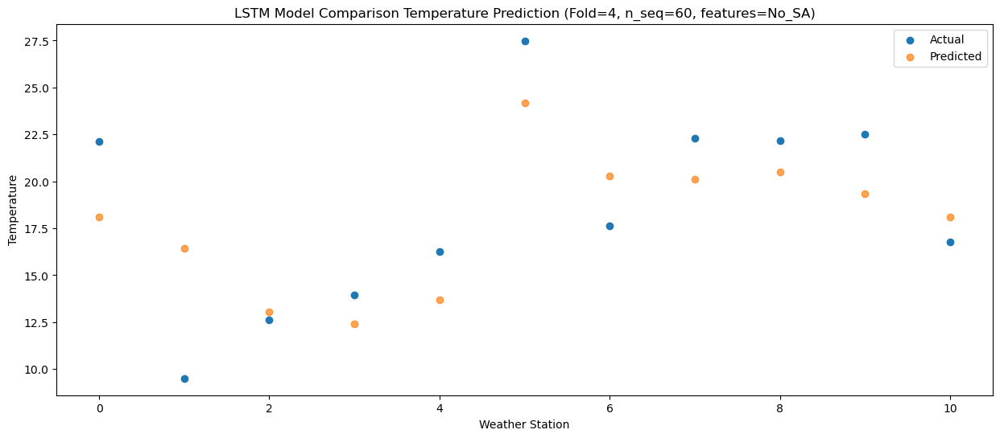

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.66  21.019555
1                 1    9.88  19.339554
2                 2   12.83  15.959558
3                 3   17.25  15.319558
4                 4   19.70  16.589558
5                 5   29.39  27.079559
6                 6   18.91  23.189558
7                 7   25.98  23.009560
8                 8   24.13  23.389560
9                 9   23.35  22.259555
10               10   19.36  21.019557


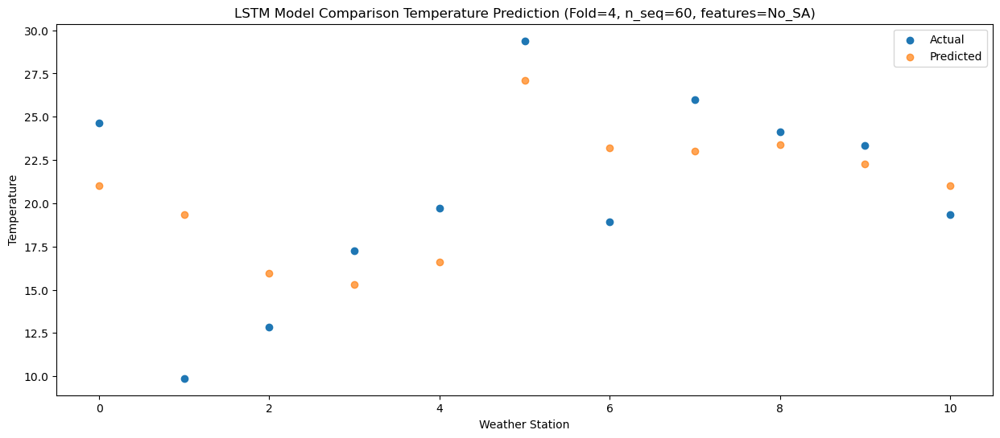

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   23.00  18.953623
1                 1    9.83  17.273621
2                 2   11.29  13.893624
3                 3   14.52  13.253626
4                 4   16.86  14.523626
5                 5   26.09  25.013627
6                 6   17.39  21.123625
7                 7   22.46  20.943628
8                 8   21.90  21.323629
9                 9   22.05  20.193623
10               10   18.29  18.953624


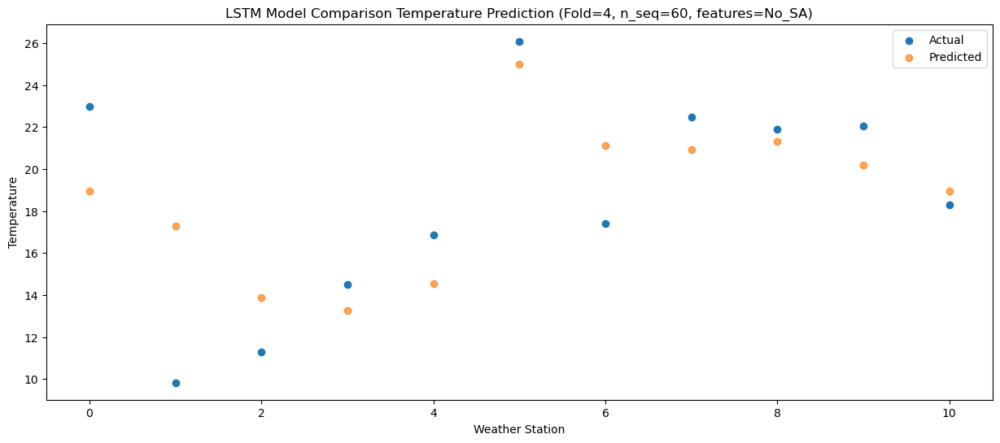

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.09  15.428587
1                 1    8.39  13.748585
2                 2    9.22  10.368589
3                 3   11.09   9.728589
4                 4   12.77  10.998589
5                 5   23.19  21.488591
6                 6   14.30  17.598589
7                 7   18.87  17.418591
8                 8   17.99  17.798593
9                 9   17.91  16.668588
10               10   14.24  15.428588


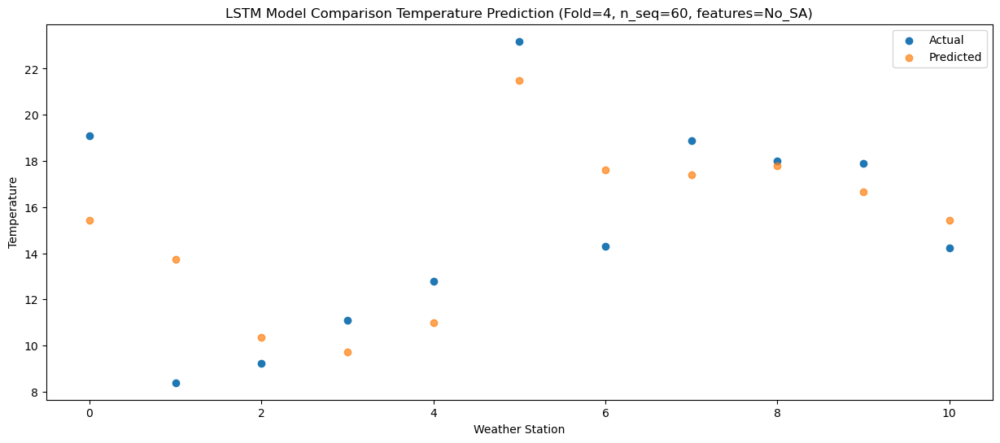

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.74   8.692219
1                 1    4.56   7.012217
2                 2    3.09   3.632221
3                 3    4.22   2.992221
4                 4    5.62   4.262222
5                 5   16.38  14.752223
6                 6    7.43  10.862222
7                 7   12.50  10.682224
8                 8   10.50  11.062226
9                 9   10.44   9.932219
10               10    7.38   8.692221


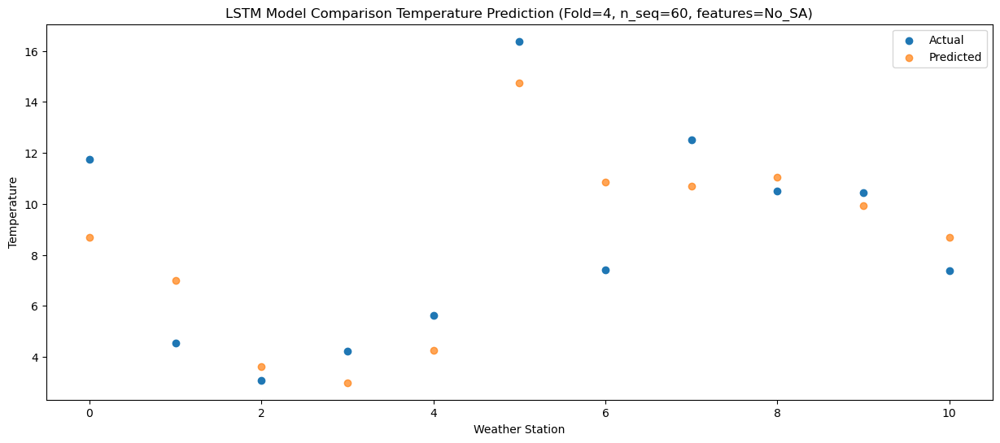

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.41   3.453067
1                 1    3.10   1.773066
2                 2   -1.50  -1.606930
3                 3   -2.83  -2.246930
4                 4   -1.47  -0.976929
5                 5    8.53   9.513072
6                 6    4.73   5.623071
7                 7    5.95   5.443073
8                 8    4.71   5.823074
9                 9    4.90   4.693068
10               10    3.30   3.453070


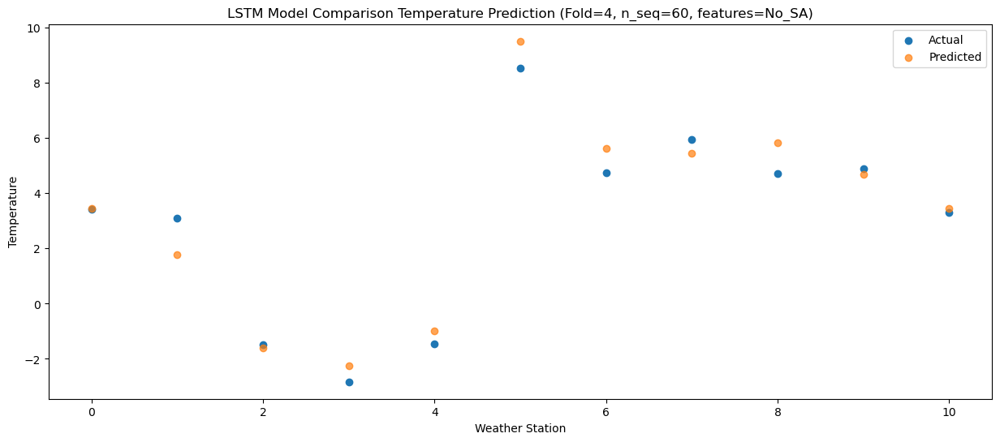

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -2.73  -1.238070
1                 1   -1.75  -2.918072
2                 2   -3.93  -6.298067
3                 3   -5.52  -6.938067
4                 4   -4.44  -5.668066
5                 5    6.93   4.821935
6                 6   -1.22   0.931934
7                 7    1.10   0.751936
8                 8   -1.07   1.131937
9                 9   -1.83   0.001931
10               10   -3.41  -1.238067


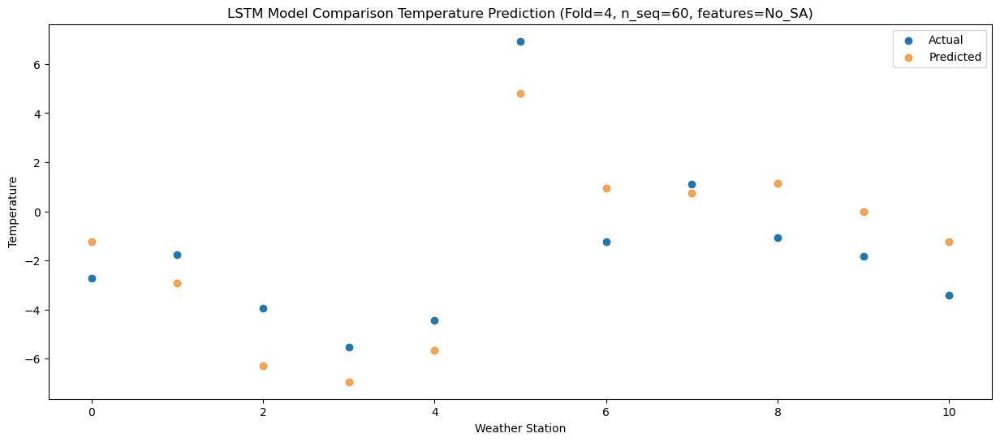

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.77   0.795829
1                 1   -1.90  -0.884171
2                 2   -3.52  -4.264168
3                 3   -4.53  -4.904168
4                 4   -3.67  -3.634167
5                 5    7.30   6.855834
6                 6    1.80   2.965833
7                 7    2.75   2.785835
8                 8    0.89   3.165836
9                 9    0.41   2.035830
10               10   -1.78   0.795832


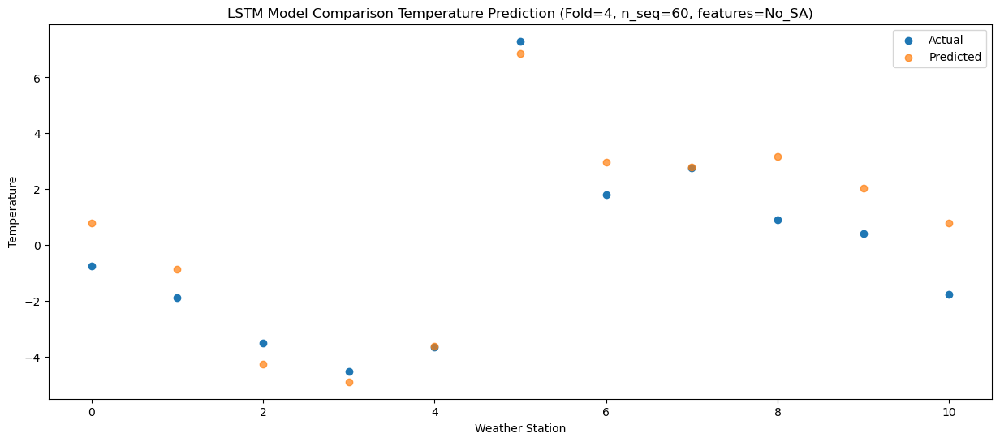

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.98   2.326804
1                 1    1.40   0.646806
2                 2   -1.58  -2.733191
3                 3   -4.47  -3.373191
4                 4   -3.44  -2.103190
5                 5    7.47   8.386811
6                 6    5.22   4.496810
7                 7    4.89   4.316810
8                 8    2.48   4.696814
9                 9    1.60   3.566805
10               10   -1.64   2.326809


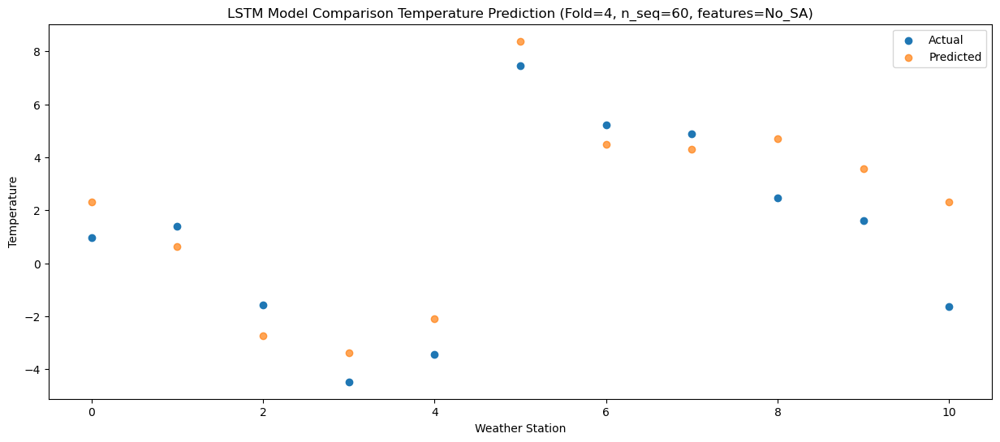

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.16   4.364420
1                 1    3.12   2.684422
2                 2    0.57  -0.695575
3                 3    0.06  -1.335574
4                 4    1.41  -0.065573
5                 5   12.54  10.424428
6                 6    5.70   6.534426
7                 7    6.61   6.354427
8                 8    3.75   6.734429
9                 9    4.14   5.604423
10               10   -0.76   4.364425


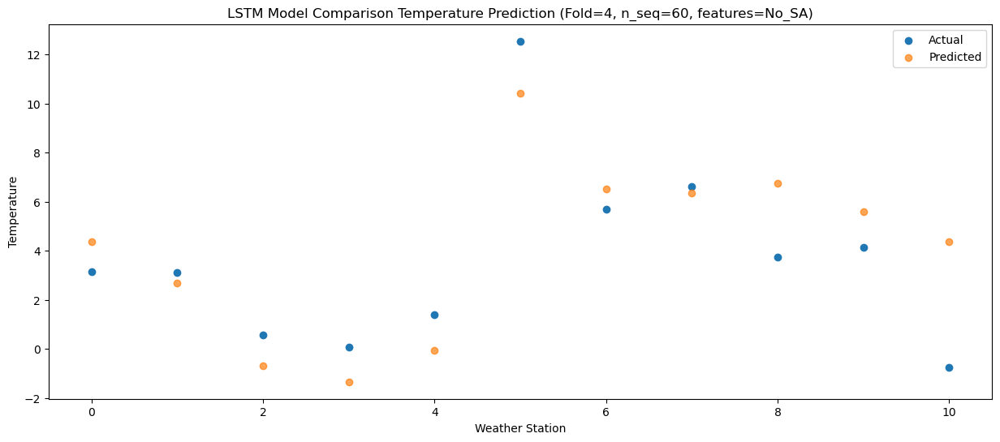

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   10.99   9.615144
1                 1    5.84   7.935146
2                 2    2.32   4.555149
3                 3    2.66   3.915151
4                 4    4.06   5.185152
5                 5   16.76  15.675153
6                 6    8.81  11.785150
7                 7   12.23  11.605152
8                 8   10.25  11.985153
9                 9   11.47  10.855147
10               10    7.71   9.615149


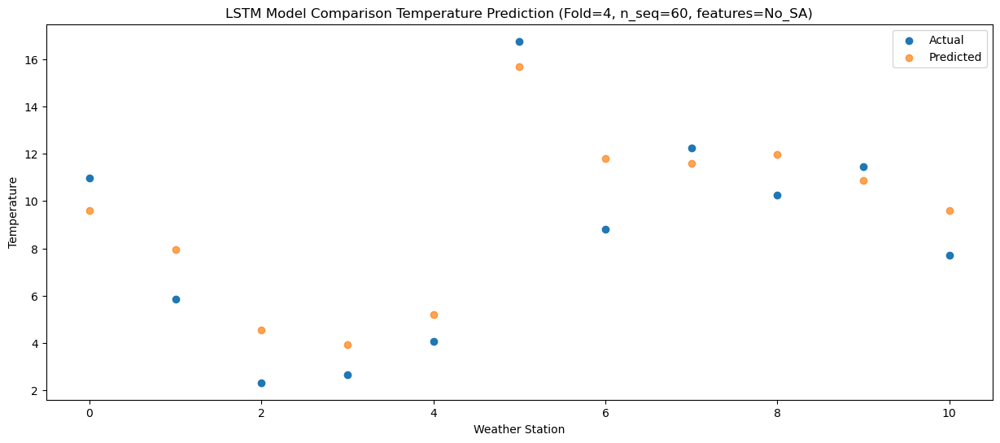

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   16.80  14.063115
1                 1    6.62  12.383117
2                 2    7.18   9.003120
3                 3    8.34   8.363122
4                 4   10.22   9.633123
5                 5   21.68  20.123124
6                 6   11.43  16.233121
7                 7   17.01  16.053123
8                 8   15.96  16.433124
9                 9   17.23  15.303118
10               10   11.40  14.063120


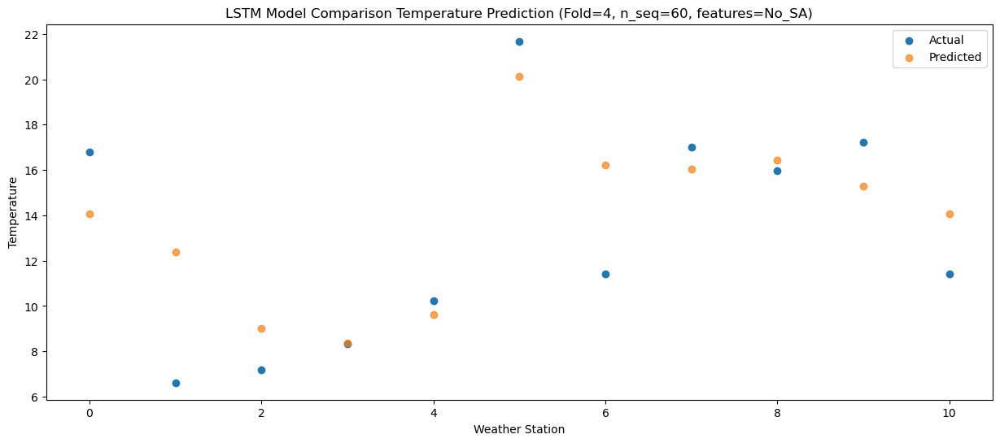

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   21.71  18.038623
1                 1    8.83  16.358627
2                 2   10.77  12.978632
3                 3   12.53  12.338630
4                 4   15.33  13.608631
5                 5   28.16  24.098634
6                 6   15.07  20.208633
7                 7   21.09  20.028631
8                 8   19.84  20.408634
9                 9   21.54  19.278626
10               10   15.71  18.038632


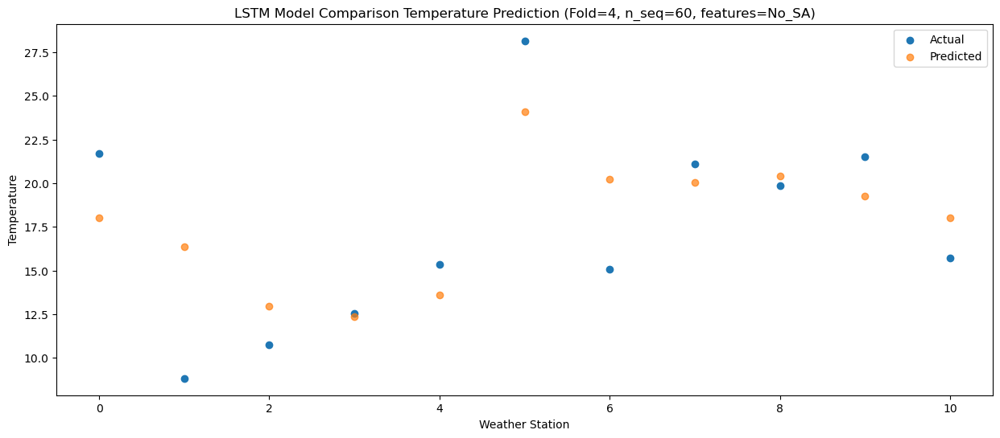

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   23.02  21.070572
1                 1   10.44  19.390576
2                 2   12.55  16.010581
3                 3   15.08  15.370578
4                 4   18.41  16.640579
5                 5   29.62  27.130582
6                 6   18.94  23.240579
7                 7   23.05  23.060579
8                 8   22.57  23.440583
9                 9   23.07  22.310575
10               10   18.80  21.070578


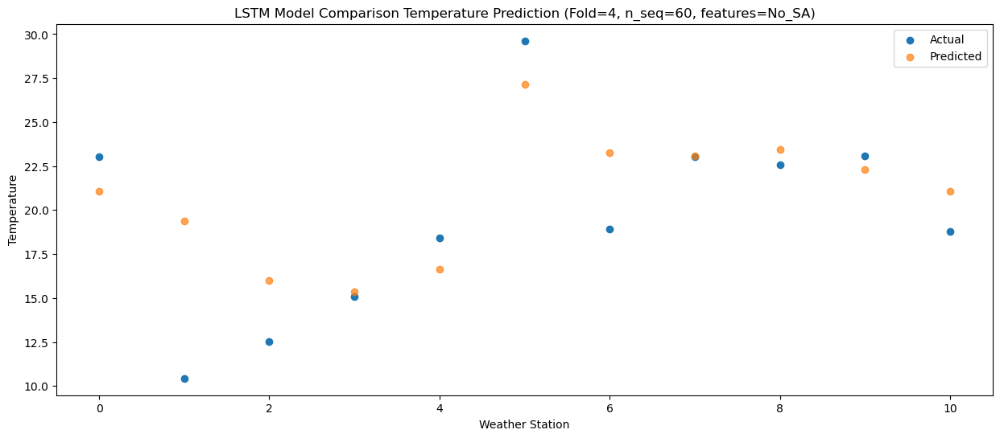

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   22.82  21.347518
1                 1   10.95  19.667524
2                 2   14.63  16.287527
3                 3   17.63  15.647525
4                 4   20.28  16.917526
5                 5   29.71  27.407529
6                 6   18.38  23.517526
7                 7   22.86  23.337526
8                 8   21.41  23.717530
9                 9   21.81  22.587521
10               10   17.47  21.347525


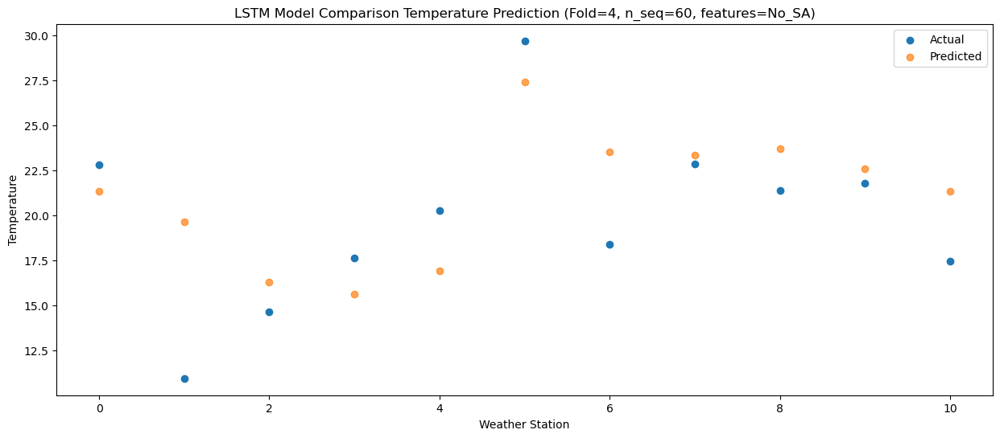

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   19.99  17.371345
1                 1    8.85  15.691351
2                 2   10.88  12.311354
3                 3   12.93  11.671352
4                 4   15.19  12.941353
5                 5   26.23  23.431356
6                 6   14.54  19.541353
7                 7   18.92  19.361353
8                 8   18.32  19.741356
9                 9   18.77  18.611348
10               10   15.13  17.371352


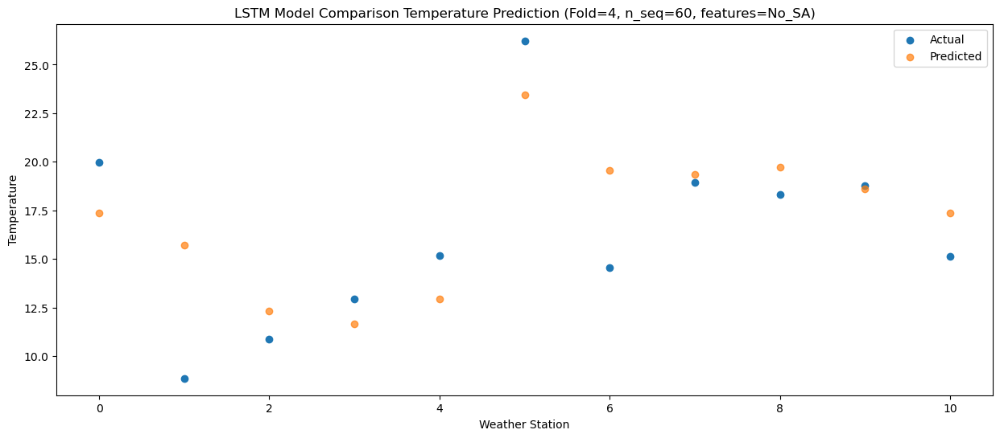

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.87  11.275088
1                 1    5.20   9.595094
2                 2    4.77   6.215097
3                 3    4.80   5.575095
4                 4    6.36   6.845096
5                 5   17.70  17.335098
6                 6    9.10  13.445096
7                 7   13.02  13.265095
8                 8   12.18  13.645099
9                 9   12.36  12.515091
10               10    9.87  11.275095


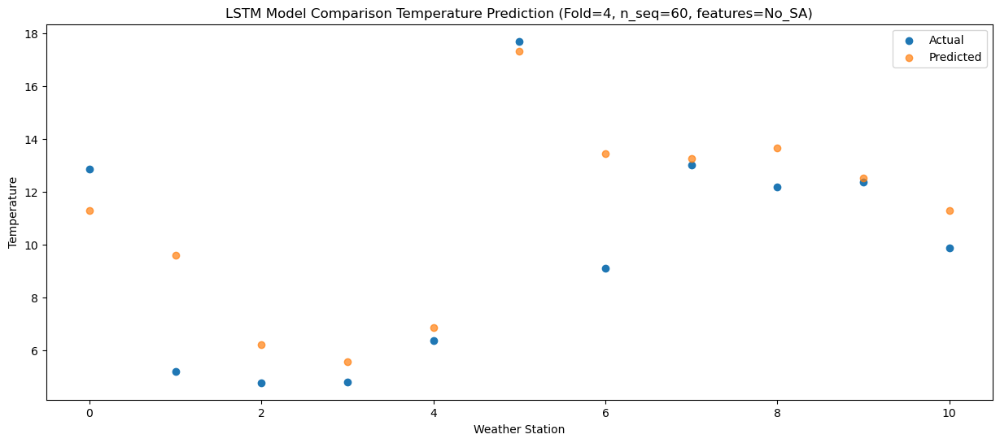

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    6.62   5.058991
1                 1    1.49   3.378996
2                 2   -2.19  -0.001000
3                 3   -1.27  -0.641001
4                 4   -0.17   0.629000
5                 5   10.99  11.119003
6                 6    3.37   7.228999
7                 7    7.12   7.048999
8                 8    5.11   7.429002
9                 9    5.27   6.298994
10               10    2.48   5.058997


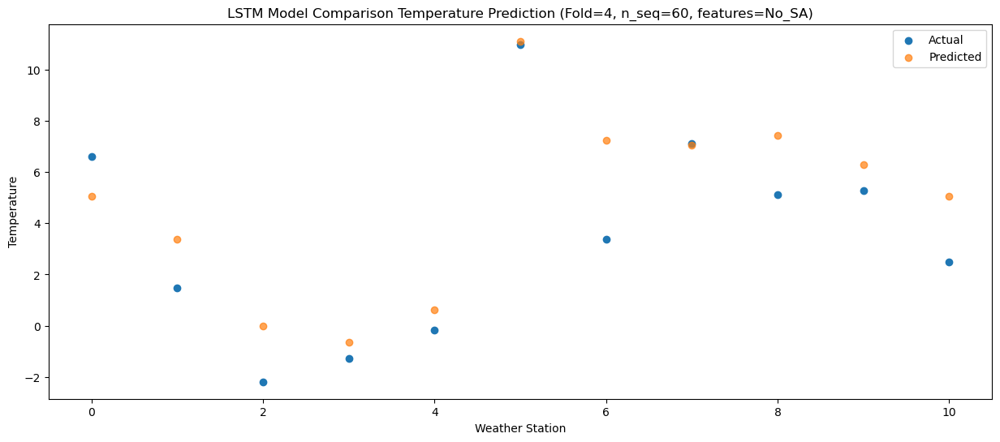

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.22   2.486227
1                 1   -0.63   0.806232
2                 2   -4.74  -2.573764
3                 3   -4.29  -3.213764
4                 4   -3.30  -1.943764
5                 5    8.19   8.546239
6                 6    1.16   4.656235
7                 7    4.24   4.476235
8                 8    3.22   4.856238
9                 9    3.28   3.726230
10               10    1.82   2.486234


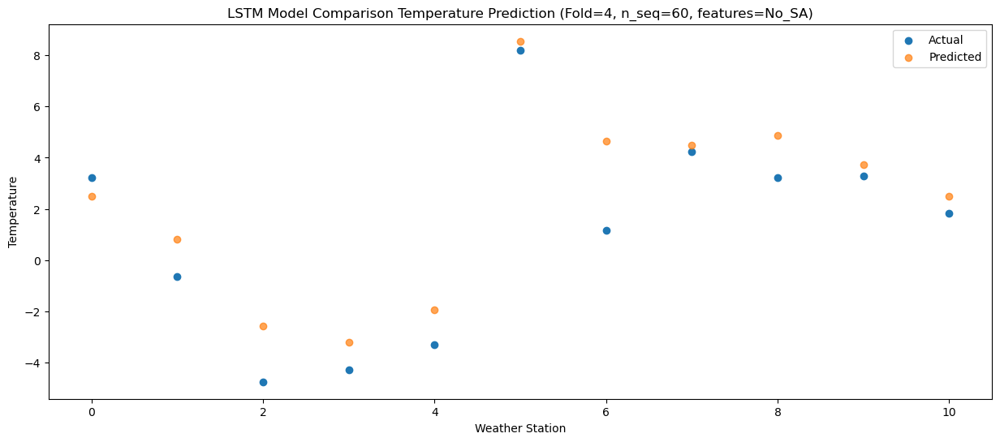

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -5.37  -2.431757
1                 1   -2.05  -4.111754
2                 2   -8.93  -7.491749
3                 3   -9.81  -8.131749
4                 4   -8.65  -6.861749
5                 5    3.94   3.628254
6                 6   -1.28  -0.261750
7                 7   -2.92  -0.441750
8                 8   -3.06  -0.061747
9                 9   -4.30  -1.191755
10               10   -3.95  -2.431751


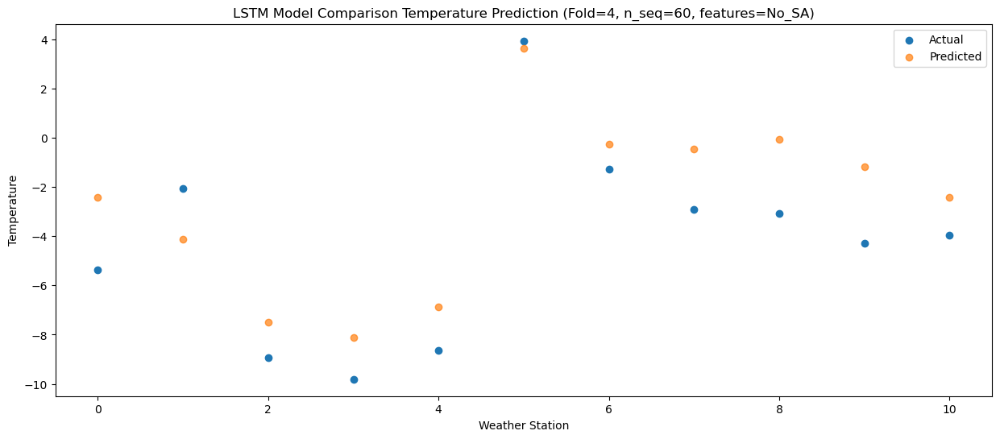

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.74   3.439987
1                 1   -2.32   1.759990
2                 2   -2.61  -1.620005
3                 3   -1.40  -2.260005
4                 4   -0.33  -0.990005
5                 5   10.76   9.499998
6                 6    2.13   5.609994
7                 7    6.99   5.429994
8                 8    3.28   5.809997
9                 9    3.47   4.679989
10               10   -0.47   3.439993


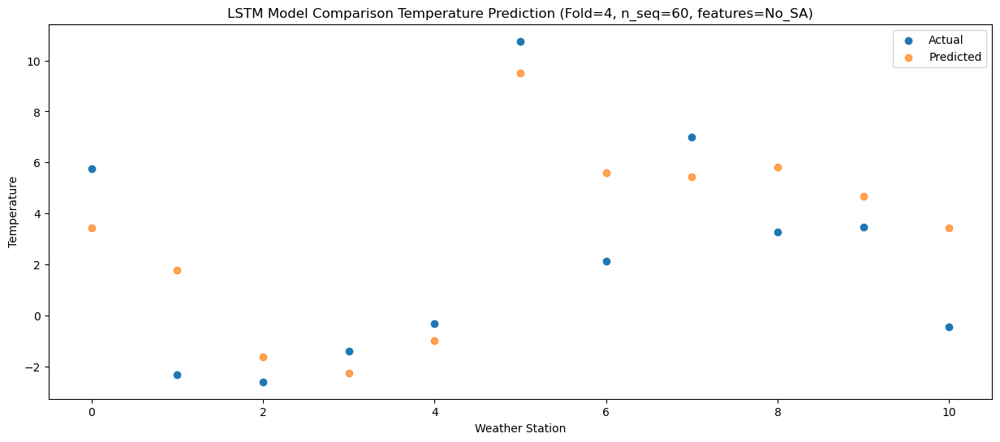

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.27   5.968041
1                 1    2.58   4.288046
2                 2   -0.38   0.908049
3                 3    1.01   0.268048
4                 4    2.24   1.538048
5                 5   13.36  12.028053
6                 6    5.92   8.138048
7                 7    9.42   7.958047
8                 8    7.72   8.338051
9                 9    7.62   7.208043
10               10    2.88   5.968046


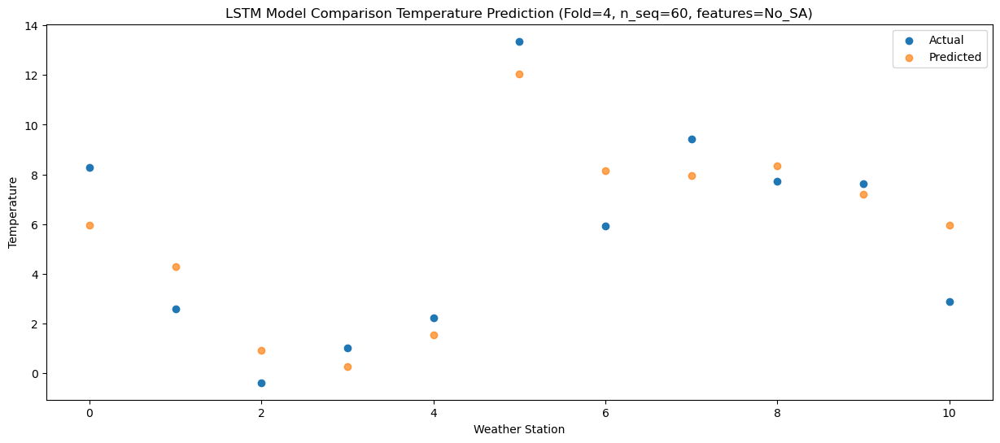

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.89  10.338282
1                 1    3.63   8.658285
2                 2    3.44   5.278288
3                 3    4.86   4.638290
4                 4    6.29   5.908290
5                 5   18.32  16.398294
6                 6   10.15  12.508289
7                 7   13.56  12.328289
8                 8   12.30  12.708290
9                 9   12.11  11.578284
10               10    8.60  10.338286


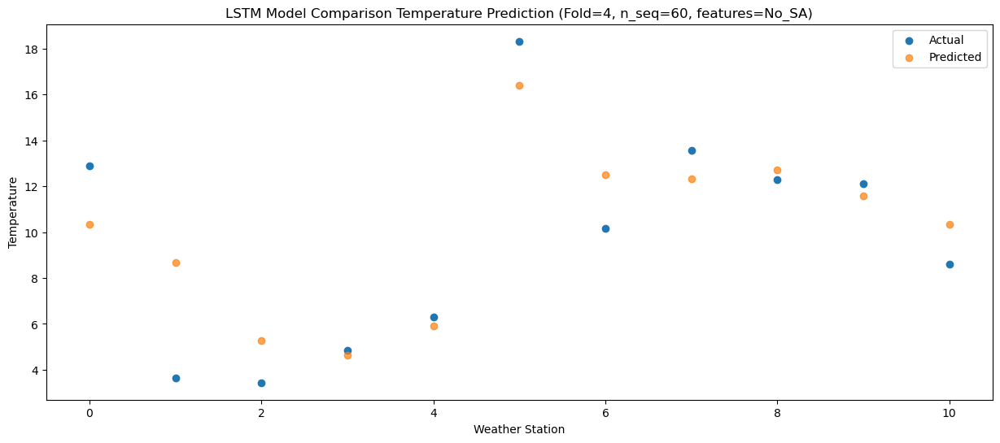

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.90  15.177012
1                 1    9.08  13.497015
2                 2    8.96  10.117018
3                 3    9.62   9.477020
4                 4   11.09  10.747020
5                 5   23.61  21.237025
6                 6   14.22  17.347019
7                 7   18.21  17.167019
8                 8   18.90  17.547020
9                 9   19.14  16.417014
10               10   14.70  15.177016


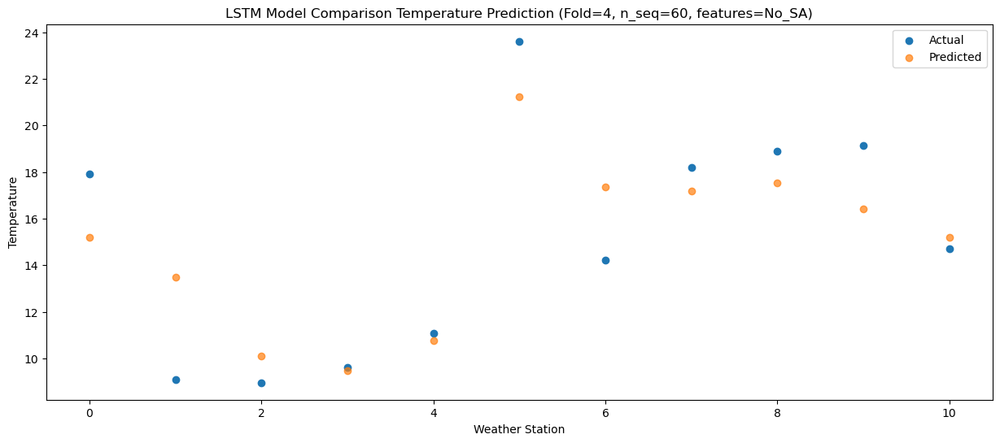

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   23.09  19.366144
1                 1    9.73  17.686147
2                 2   11.59  14.306150
3                 3   13.65  13.666151
4                 4   15.54  14.936151
5                 5   27.62  25.426156
6                 6   17.64  21.536150
7                 7   21.93  21.356150
8                 8   22.26  21.736152
9                 9   23.11  20.606145
10               10   17.86  19.366147


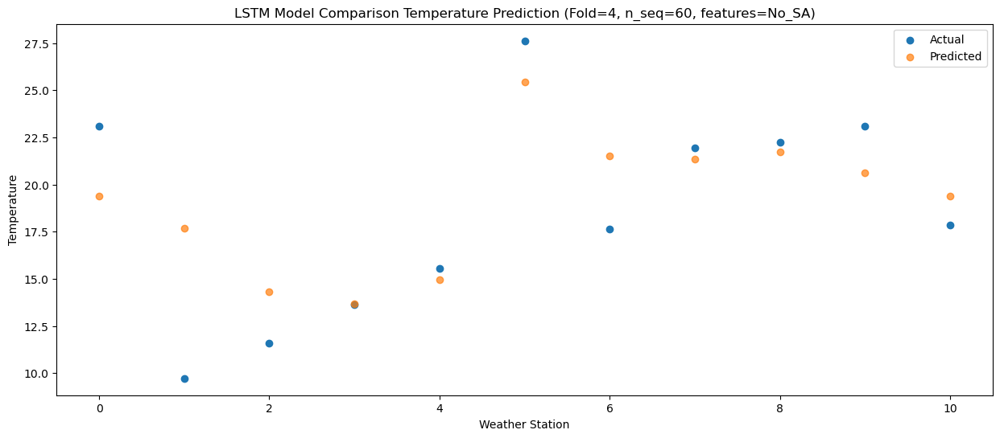

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   23.85  20.687777
1                 1   10.42  19.007780
2                 2   12.61  15.627783
3                 3   14.55  14.987785
4                 4   16.25  16.257785
5                 5   26.45  26.747790
6                 6   19.10  22.857784
7                 7   22.23  22.677784
8                 8   22.27  23.057785
9                 9   22.14  21.927779
10               10   19.38  20.687781


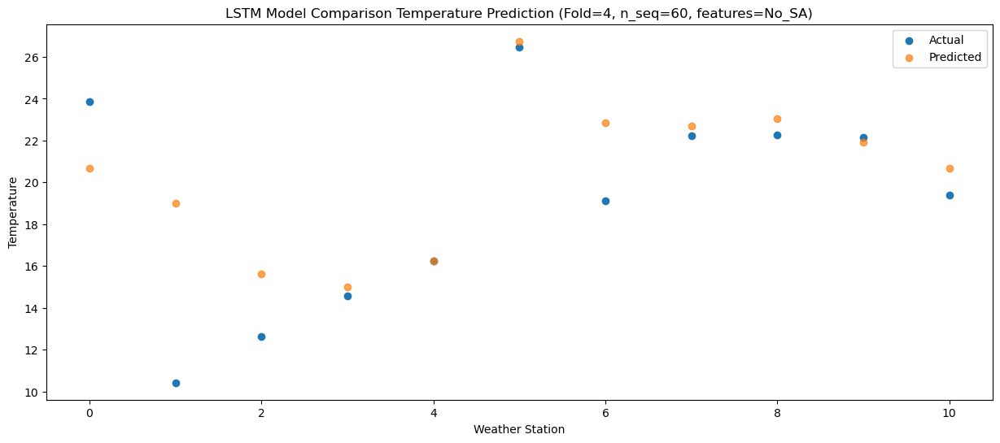

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   22.36  19.992821
1                 1   10.12  18.312823
2                 2   13.18  14.932826
3                 3   16.30  14.292829
4                 4   18.21  15.562829
5                 5   28.91  26.052833
6                 6   17.94  22.162827
7                 7   22.67  21.982828
8                 8   22.19  22.362829
9                 9   21.80  21.232822
10               10   18.24  19.992824


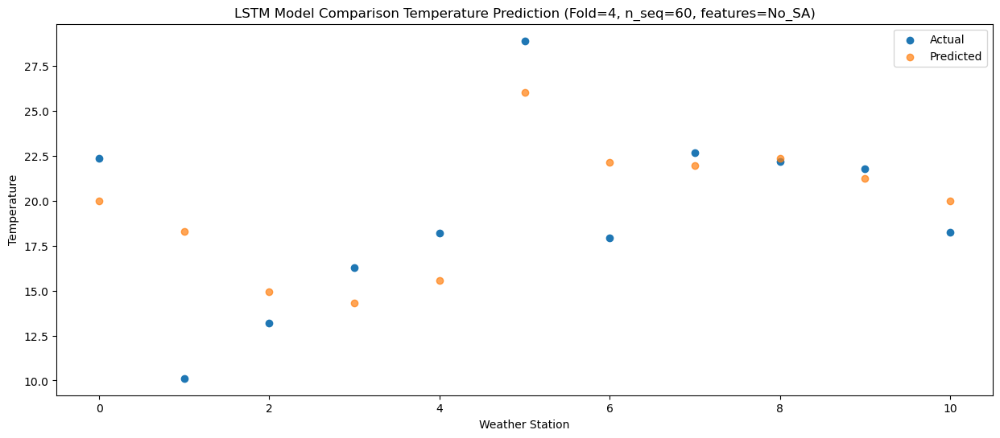

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   19.93  16.856814
1                 1    9.25  15.176816
2                 2    9.57  11.796819
3                 3   10.91  11.156822
4                 4   12.20  12.426822
5                 5   22.46  22.916826
6                 6   15.50  19.026820
7                 7   18.53  18.846821
8                 8   19.58  19.226822
9                 9   18.57  18.096815
10               10   15.97  16.856817


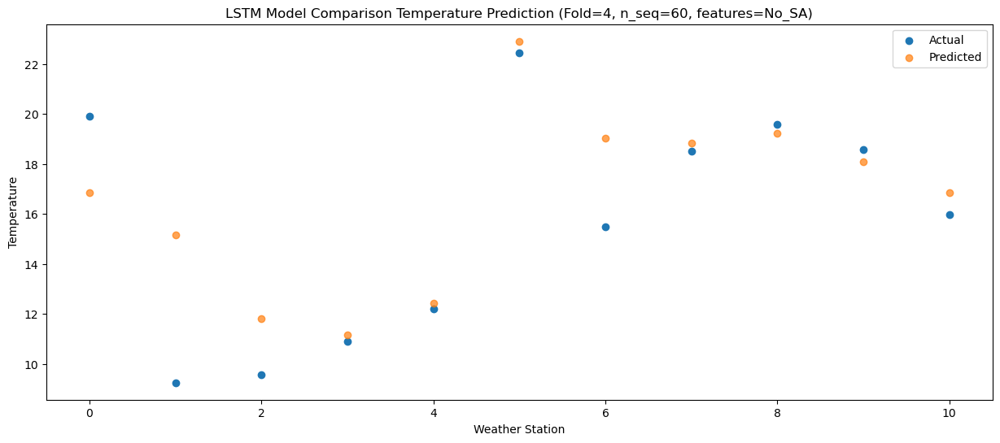

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   15.80  12.396776
1                 1    5.48  10.716776
2                 2    5.43   7.336781
3                 3    8.16   6.696783
4                 4    9.78   7.966783
5                 5   20.75  18.456787
6                 6    9.88  14.566781
7                 7   14.85  14.386782
8                 8   13.65  14.766782
9                 9   13.50  13.636777
10               10    9.50  12.396777


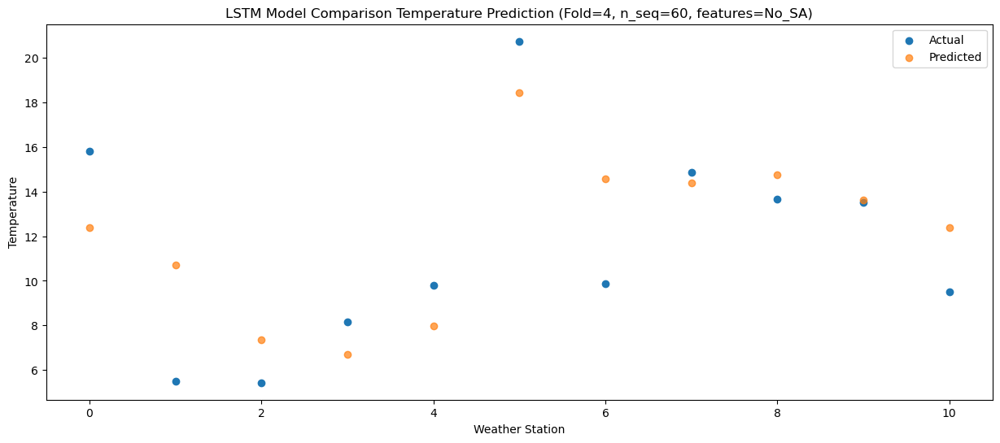

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_18 (LSTM)              (1, 1, 512)               4767744   
                                                                 
 dropout_18 (Dropout)        (1, 1, 512)               0         
                                                                 
 lstm_19 (LSTM)              (1, 512)                  2099200   
                                                                 
 dropout_19 (Dropout)        (1, 512)                  0         
                                                                 
 dense_27 (Dense)            (1, 256)                  131328    
                                                                 
 dense_28 (Dense)            (1, 128)                  32896     
                                                                 
 dense_29 (Dense)            (1, 60)                  

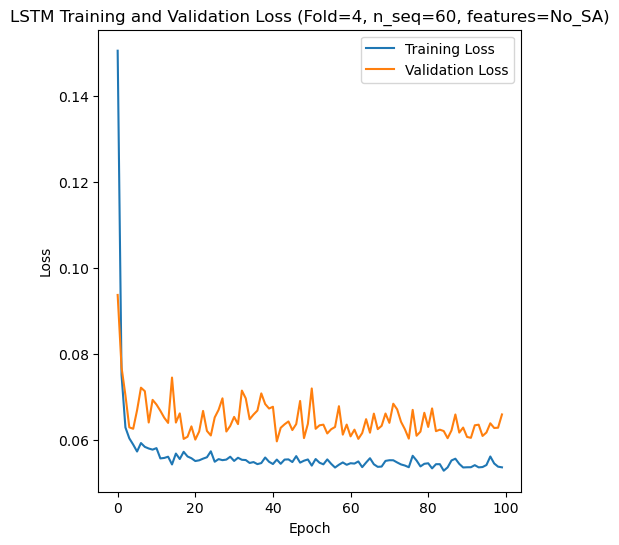

[[1.893679935946296, 1.4367620517783115, 1.6701902222364464, 1.7702921410161567, 2.1272401134103847, 2.5025535722284307, 3.6973129095006683, 4.872018625486286, 4.568929414876425, 3.9937598780613754, 3.4190971820807587, 1.8101213074530358, 1.7571200373992522, 1.8010238677240458, 2.225382410866764, 2.109675433142891, 2.417730329733885, 2.9451508708472445, 3.6448123396894974, 5.0615745917560515, 5.045536603334401, 4.630928736680207, 5.030498211514197, 3.3563071163740297, 3.661828496336048, 2.1887203088346197, 2.3406314716695142, 1.494270949290463, 1.3940543053509076, 2.334184846465461, 2.8334690087211487, 3.971624267468519, 4.883404771927406, 4.3541966073419305, 4.001262406641795, 3.4489401097284245, 0.9866785676177907, 2.2563523748808247, 1.7103870735483246, 1.2987802539983093, 2.298491684382557, 2.4495949786017452, 4.319624613286599, 4.14187077553799, 4.207681024110833, 4.130456400167162, 3.8733294921547667, 3.146012941668415, 2.681456198977915, 2.509896821391685, 1.5762937230091556, 2.

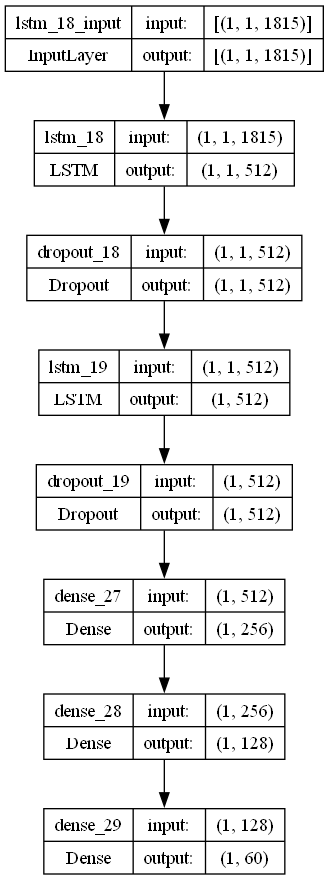

In [4]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr =  0.003786634333593054 
    optimizer = Adam(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.19620543896566228

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with an LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperature)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_CV_S60_No_SA.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)